### Environment Setup

In [1]:
import pandas as pd
import datetime
import yfinance as yf
import backtrader as bt
import numpy as np
import warnings
import riskfolio as rp
import matplotlib.pyplot as plt

warnings.filterwarnings("ignore")

In [2]:
from Data_Preprocess import IAM_data_setup, download_IAM, SelectIndex, generate_interval
from Data_Preprocess import calculate_returns, calculate_date_range

### Different Ticker sets from US and Hong Kong among equity/Bond, etc

In [3]:
# def IAM_data_setup():
#     product_master = pd.read_csv("IAM_product.txt")
    
#     product_master.dropna(axis='index', how='any', inplace=True)
#     display(product_master.head())
    
#     asset_classes = product_master[['Assets','Class','Sector','Type']]
#     # display(asset_classes.Type.unique())
#     # display(asset_classes.Sector.unique())

#     assets = product_master.Assets.to_list()
#     assets.sort()
#     # display(f'{len(assets)} assets')

#     return assets, asset_classes

In [4]:
def sample_markets(i):
    # Tickers of assets
    stocks_=[]
    sector_=[]
    class_=[]
    stocks_.append( ['JCI', 'TGT', 'CMCSA', 'CPB', 'MO', 'APA', 'MMC', 'JPM',
              'ZION', 'PSA', 'BAX', 'BMY', 'LUV', 'PCAR', 'TXT', 'TMO',
              'DE', 'MSFT', 'HPQ', 'SEE', 'VZ', 'CNP', 'NI', 'T', 'BA',
               ])
    sector_.append(['Consumer Discretionary','Consumer Discretionary',
                                  'Consumer Discretionary', 'Consumer Staples',
                                  'Consumer Staples','Energy','Financials',
                                  'Financials','Financials','Financials',
                                  'Health Care','Health Care','Industrials','Industrials',
                                  'Industrials','Health Care','Industrials',
                                  'Information Technology','Information Technology',
                                  'Materials','Telecommunications Services','Utilities',
                                  'Utilities','Telecommunications Services','Financials',
                    ])
    class_.append([
                'Equity','Equity','Equity','Equity','Equity',
                'Equity','Equity','Equity','Equity','Equity',
                'Equity','Equity','Equity','Equity','Equity',
                'Equity','Equity','Equity','Equity','Equity',
                'Equity','Equity','Equity','Equity','Equity',
                ])
               
    stocks_.append(['JCI', 'TGT', 'CMCSA', 'CPB', 'MO', 'APA', 'MMC', 'JPM',
                  'ZION', 'PSA', 'BAX', 'BMY', 'LUV', 'PCAR', 'TXT', 'TMO',
                  'DE', 'MSFT', 'HPQ', 'SEE', 'VZ', 'CNP', 'NI', 'T', 'BA',
                    'HYG','LQD','TLT'
                  ])
    sector_.append(['Consumer Discretionary','Consumer Discretionary',
                      'Consumer Discretionary', 'Consumer Staples',
                      'Consumer Staples','Energy','Financials',
                      'Financials','Financials','Financials',
                      'Health Care','Health Care','Industrials','Industrials',
                      'Industrials','Health Care','Industrials',
                      'Information Technology','Information Technology',
                      'Materials','Telecommunications Services','Utilities',
                      'Utilities','Telecommunications Services','Financials',
                         'Corporate','Corporate','Treasury',
                    ])
    class_.append([
                    'Equity','Equity','Equity','Equity','Equity',
                    'Equity','Equity','Equity','Equity','Equity',
                    'Equity','Equity','Equity','Equity','Equity',
                    'Equity','Equity','Equity','Equity','Equity',
                    'Equity','Equity','Equity','Equity','Equity',
                   'Fixed Income','Fixed Income','Fixed Income', 
                ])

    stocks_.append([
                    'AMAT', 'AMD','AVGO',  
                    'BAC','BKR','BMY','BSX',
                    'C','CMCSA',
                    'CSCO','CSX','CVS','CVX',
                    'DIS','DVN',
                    'FCX','FNF','GEN','GILD',
                    'GM','HAL','HPQ','INTC',
                    'IPG','JNJ','KDP',
                    'KKR','KMI','KO',
                    'MDLZ','MO','MRK','MRO',
                    'MRVL','MSFT','MU','NEM',
                ])
    
    sector_.append([
                    'Technology','Technology','Technology',
                    'Financial Services','Energy','Healthcare','Healthcare',
                    'Financial Services','Communication Services',
                    'Technology','Industrials','Healthcare','Energy',
                    'Communication Services','Energy',
                    'Basic Materials','Financial Services','Technology','Healthcare',
                    'Consumer Cyclical','Energy','Technology','Technology',
                    'Communication Services','Healthcare','Consumer Defensive',
                    'Financial Services','Energy','Consumer Defensive',
                    'Consumer Defensive','Consumer Defensive','Healthcare','Energy',
                    'Technology','Technology','Technology','Basic Materials',
            ])
    class_.append([
                    'Equity', 'Equity','Equity',  
                    'Equity','Equity','Equity','Equity',
                    'Equity','Equity',
                    'Equity','Equity','Equity','Equity',
                    'Equity','Equity',
                    'Equity','Equity','Equity','Equity',
                    'Equity','Equity','Equity','Equity',
                    'Equity','Equity','Equity',
                    'Equity','Equity','Equity',
                    'Equity','Equity','Equity','Equity',
                    'Equity','Equity','Equity','Equity',
                ])

    ETF_BOND = ['HYG','LQD','TLT',
               ]
    industry_BOND = ['Bond','Bond','Bond',
                    ]
    
    ETF_COMM = [
        'DBA','GLD','SLV','XLE','XME','XOP',
    ]
    
    industry_COMM=[
        'Commodity','Commodity','Commodity','Commodity','Commodity','Commodity',
    ]
    
    ETF_list = ['HYG','LQD','TLT',
               'DBA',
               'GLD','SLV','XLE','XME','XOP',
                'XBI',
                'EFA','EWW','EWZ',
                'VNQ','XHB',
                'IWM','QQQ']
    type_etf =  ['Bond','Bond','Bond',
                   'Commodity',
                   'Commodity','Commodity','Commodity','Commodity','Commodity',
                   'Healthcare',
                   'International','International','International',
                   'Real Estate','Real Estate',
                   'US Major','US Major',
                   ]
    industry_etf =  ['Corporate','Corporate','Treasury',
                   'Agriculture',
                   'Metal','Metal','Energy','Metal','ETF',
                   'Healthcare',
                   'International','International','International',
                   'Real Estate','Real Estate',
                   'US Major','US Major',
                   ]
    if i=="IAM":
        return IAM_data_setup()
        
    assets = stocks_[i]
    asset_classes_dict = {'Assets': assets,  
                     'Class': class_[i],
                     'Sector': sector_[i],
                    }
    
    asset_classes = pd.DataFrame(asset_classes_dict)
    asset_classes = asset_classes.sort_values(by=['Assets'])
    assets.sort()

    return assets, asset_classes

### Parameters Setup

In [5]:
# Date range
start = '2013-01-01'
end = '2024-09-30'

assets_selection = "IAM"
# assets_selection = 2
constraints_selection = 3

assets, asset_classes = sample_markets(assets_selection)

display(asset_classes['Sector'].unique())
display(asset_classes['Class'].unique())

print(assets)
display(asset_classes.T)
display(asset_classes.shape)

array(['Consumer Defensive', 'Real Estate', 'Industrials', 'Technology',
       'Cash', 'Municipal', 'Financial Services', 'Energy', 'Index',
       'Corporate', 'Healthcare', 'Consumer Cyclical', 'International',
       'Treasury', 'Ultrashort', 'Basic Materials', 'High Yield', 'ETF',
       'Agency'], dtype=object)

array(['Equity', 'Cash', 'Fixed Income', 'Commodity ', 'Commodity',
       'Crypto'], dtype=object)

['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']


,0,1,2,3,4,5,6,7,8,9,...,45,46,47,48,49,50,51,52,53,54
Assets,0341.HK,0405.HK,0737.HK,0P00001DU6,0P00002C5C,0P00006OXK.T,0P0000UIC0,0P0000VP5F,0P0000YVJG,0P0000Z5AZ,...,IWRD.L,JDN.MX,LQDE.L,METV,PAVE,SDHY.L,SHV,TFLO,USO,ZM
Class,Equity,Equity,Equity,Equity,Cash,Equity,Fixed Income,Fixed Income,Fixed Income,Equity,...,Equity,Equity,Fixed Income,Equity,Equity,Fixed Income,Fixed Income,Fixed Income,Commodity,Equity
Sector,Consumer Defensive,Real Estate,Industrials,Technology,Cash,Industrials,Municipal,Financial Services,Energy,Index,...,Technology,Consumer Defensive,Corporate,Technology,Industrials,High Yield,Treasury,Treasury,Energy,Technology
Type,Stock,RIT,Stock,Fund,Fund,Fund,Fund,Fund,Fund,Fund,...,ETF,Stock,ETF,ETF,ETF,ETF,ETF,ETF,ETF,Stock
Currency,HKD,HKD,HKD,USD,USD,JPY,USD,USD,USD,USD,...,USD,MXN,USD,USD,USD,USD,USD,USD,USD,USD
Rate,0.128205,0.128205,0.128205,1.0,1.0,0.0066,1.0,1.0,1.0,1.0,...,1.0,0.05,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


(55, 6)

In [6]:
plotFlag = True
useConstraint = True
useView = True

# Risk Measures available:
#
# 'MV': Standard Deviation.
# 'MAD': Mean Absolute Deviation.
# 'MSV': Semi Standard Deviation.
# 'FLPM': First Lower Partial Moment (Omega Ratio).
# 'SLPM': Second Lower Partial Moment (Sortino Ratio).
# 'CVaR': Conditional Value at Risk.
# 'EVaR': Entropic Value at Risk.
# 'WR': Worst Realization (Minimax)
# 'MDD': Maximum Drawdown of uncompounded cumulative returns (Calmar Ratio).
# 'ADD': Average Drawdown of uncompounded cumulative returns.
# 'CDaR': Conditional Drawdown at Risk of uncompounded cumulative returns.
# 'EDaR': Entropic Drawdown at Risk of uncompounded cumulative returns.
# 'UCI': Ulcer Index of uncompounded cumulative returns.

rms = ['MV', 'MAD', 'MSV', 'FLPM', 'SLPM', 'CVaR',
       'EVaR', 'WR', 'MDD', 'ADD', 'CDaR', 'UCI', 'EDaR']
# rms = ['MV','WR']

# Objective Functions 
objectives = ['Sharpe', 'MinRisk', 'MaxRet']
# objectives = [ 'MaxRet']

# rebalance interval: Monthly, Quarterly, Semiannually
# reb_interval = ["M","Q","S"]
reb_interval = ["Q","S"]

In [7]:
# assets = assets + benchmark_symbols
# display(len(assets))

### Setup constraints and Views

In [8]:
###########################################################
# Building Constraints
############################################################
def Gen_Constraints():
    constraints = []
    constraints.append(pd.DataFrame({'Disabled': [False, True, False,False,True],
                   'Type': ['All Assets', 'All Classes', 'Classes','Classes','All Assets'],
                   'Set': ['', 'Sector', 'Class','Class',''],
                   'Position': ['', '', 'Equity','Fixed Income',''],
                   'Sign': ['<=', '<=', '<=','<=','>='],
                   'Weight': [0.10, 0.20, 0.6, 0.4, 0.02],
                   'Type Relative': ['', '', '','',''],
                   'Relative Set': ['', '', '','',''],
                   'Relative': ['', '', '','',''],
                   'Factor': ['', '', '','','']}))
    
    constraints.append(pd.DataFrame({'Disabled': [False, False,False],
                   'Type': ['All Assets', 'Classes','Classes'],
                   'Set': ['', 'Class','Class'],
                   'Position': ['', 'Equity','Fixed Income'],
                   'Sign': ['<=', '<=','<='],
                   'Weight': [0.10, 0.6, 0.4],
                   'Type Relative': ['', '', ''],
                   'Relative Set': ['', '', ''],
                   'Relative': ['', '', ''],
                   'Factor': ['', '', '']}))
    
    constraints.append(pd.DataFrame({'Disabled': [False, False, False],
                   'Type': ['All Assets', 'All Classes', 'All Classes'],
                   'Set': ['', 'Sector', 'Sector'],
                   'Position': ['', '', ''],
                   'Sign': ['<=', '<=', '>='],
                   'Weight': [0.10, 0.20, 0.03],
                   'Type Relative': ['', '', ''],
                   'Relative Set': ['', '', ''],
                   'Relative': ['', '', ''],
                   'Factor': ['', '', '']}))
    
    constraints.append(pd.DataFrame({'Disabled': [False],
                   'Type': ['All Assets'],
                   'Set': [''],
                   'Position': [''],
                   'Sign': ['<='],
                   'Weight': [0.10],
                   'Type Relative': [''],
                   'Relative Set': [''],
                   'Relative': [''],
                   'Factor': ['']
                  }))

    return constraints

global_constraint_list = Gen_Constraints()
max_g_const = len(global_constraint_list)
print(f"Total {max_g_const} constraints for selection")
constraints = global_constraint_list[constraints_selection]
display("Current selected constraints:")
display(constraints)

Total 4 constraints for selection


'Current selected constraints:'

,Disabled,Type,Set,Position,Sign,Weight,Type Relative,Relative Set,Relative,Factor
0,False,All Assets,,,<=,0.1,,,,


In [9]:
############################################################
# Building View for Black Litterman
############################################################
views = {'Disabled': [False, False, False],
         'Type': ['Classes', 'Classes', 'Classes'],
         'Set': ['Sector', 'Sector', 'Sector'],
         'Position': ['Technology', 'Energy', 'Healthcare'],
         'Sign': ['>=', '>=', '>='],
         'Weight': [0.20, 0.1, 0.09], # Annual terms 
         'Type Relative': ['Classes', 'Classes', 'Classes'],
         'Relative Set': ['Sector', 'Sector', 'Sector'],
         'Relative': ['Financial Services', 'Commodity', 'Consumer Defensive']}

views = pd.DataFrame(views)

display(views)

,Disabled,Type,Set,Position,Sign,Weight,Type Relative,Relative Set,Relative
0,False,Classes,Sector,Technology,>=,0.20,Classes,Sector,Financial Services
1,False,Classes,Sector,Energy,>=,0.10,Classes,Sector,Commodity
2,False,Classes,Sector,Healthcare,>=,0.09,Classes,Sector,Consumer Defensive


In [10]:
# Methods to create Constraint and Views by a subset of tickers

def get_Constraint(subSet):
    sub_asset_classes = asset_classes.loc[asset_classes['Assets'].isin(subSet)]
    # print(f'Constraint-> subSet={subSet}, sub_asset_classes={sub_asset_classes}\n')
    return rp.assets_constraints(constraints, sub_asset_classes)


def get_Views(subSet):
    sub_asset_classes = asset_classes.loc[asset_classes['Assets'].isin(subSet)]
    # print(f'subSet={subSet}, sub_asset_classes={sub_asset_classes}\n')
    return rp.assets_views(views, sub_asset_classes)
    

### Download Data
Full data download from yfinance to **prices** dataframe

In [11]:
# Downloading data
display(len(assets))
if assets_selection == "IAM":
    prices = download_IAM()
    # prices = pd.read_csv("IAM_full_data.txt", header=[0,1], index_col=[0])
    # prices.index = pd.to_datetime(prices.index)
else:
    prices = yf.download(assets, start=start, end=end)
# prices = prices.dropna()

55

In [12]:
print(prices.shape)
prices.columns[prices.isna().sum()==prices.shape[0]]

(3030, 330)


MultiIndex([], names=['Price', 'Ticker'])

In [13]:
display(prices.index[0], prices.index[-1])
display(prices.info())
display(prices.head())

Timestamp('2013-01-02 00:00:00+0000', tz='UTC')

Timestamp('2024-09-27 00:00:00+0000', tz='UTC')

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 3030 entries, 2013-01-02 00:00:00+00:00 to 2024-09-27 00:00:00+00:00
Columns: 330 entries, ('Adj Close', '0341.HK') to ('Volume', 'ZM')
dtypes: float64(330)
memory usage: 7.7 MB


None

Price                     Adj Close                                        \
Ticker                      0341.HK 0405.HK 0737.HK 0P00001DU6 0P00002C5C   
Date                                                                        
2013-01-02 00:00:00+00:00   15.0428  1.6463  1.8862        NaN        NaN   
2013-01-03 00:00:00+00:00   15.1463  1.6507  1.8949        NaN        NaN   
2013-01-04 00:00:00+00:00   15.1118  1.6507  1.8906        NaN        NaN   
2013-01-07 00:00:00+00:00   15.1118  1.6906  1.9123        NaN        NaN   
2013-01-08 00:00:00+00:00   15.2153  1.6817  1.9036        NaN        NaN   

Price                                                                    \
Ticker                    0P00006OXK.T 0P0000UIC0 0P0000VP5F 0P0000YVJG   
Date                                                                      
2013-01-02 00:00:00+00:00          NaN        NaN        NaN        NaN   
2013-01-03 00:00:00+00:00          NaN        NaN        NaN        NaN   
2013-01-04 00:00:00+00:00          NaN        NaN        NaN        NaN   
2013-01-07 00:00:00+00:00          NaN        NaN        NaN        NaN   
2013-01-08 00:00:00+00:00          NaN        NaN        NaN        NaN   

Price                                 ...     Volume                        \
Ticker                    0P0000Z5AZ  ...     IWRD.L JDN.MX    LQDE.L METV   
Date                                  ...                                    
2013-01-02 00:00:00+00:00        NaN  ...   502324.0    NaN   22658.0  NaN   
2013-01-03 00:00:00+00:00        NaN  ...   190327.0    NaN   71159.0  NaN   
2013-01-04 00:00:00+00:00        NaN  ...  1066404.0    NaN   80771.0  NaN   
2013-01-07 00:00:00+00:00        NaN  ...   716990.0    NaN   54127.0  NaN   
2013-01-08 00:00:00+00:00        NaN  ...   712517.0    NaN  141965.0  NaN   

Price                                                               
Ticker                    PAVE SDHY.L       SHV TFLO       USO  ZM  
Date                                                                
2013-01-02 00:00:00+00:00  NaN    NaN  259200.0  NaN  693100.0 NaN  
2013-01-03 00:00:00+00:00  NaN    NaN  357500.0  NaN  489425.0 NaN  
2013-01-04 00:00:00+00:00  NaN    NaN  303100.0  NaN  742613.0 NaN  
2013-01-07 00:00:00+00:00  NaN    NaN  288400.0  NaN  356675.0 NaN  
2013-01-08 00:00:00+00:00  NaN    NaN  140900.0  NaN  480188.0 NaN  

[5 rows x 330 columns]

In [14]:
############################################################
# Calculate assets returns
############################################################

# # pd.options.display.float_format = '{:.4%}'.format

# data = prices.loc[:, ('Adj Close', slice(None))]
# data.columns = assets
# # data = data.drop(columns=benchmark_symbols)
# # data = data.drop(columns=[benchmark_symbol]).dropna()

# #
# #  Build completed set of returns 
# #
# returns = data.pct_change().round(4)

# returns.index = pd.to_datetime(returns.index.date)
# returns.index.names = ['Date']

# # returns = data.pct_change().dropna()
# # returns.replace(np.nan, 0, inplace=True)

returns = calculate_returns(prices)

display(returns.index[0], returns.index[-1])
display(returns)
returns.reset_index().to_csv("Full_Returns.csv", index=False)


Timestamp('2013-01-02 00:00:00+0000', tz='UTC')

Timestamp('2024-09-27 00:00:00+0000', tz='UTC')

,0341.HK,0405.HK,0737.HK,0P00001DU6,0P00002C5C,0P00006OXK.T,0P0000UIC0,0P0000VP5F,0P0000YVJG,0P0000Z5AZ,...,IWRD.L,JDN.MX,LQDE.L,METV,PAVE,SDHY.L,SHV,TFLO,USO,ZM
Date,,,,,,,,,,,,,,,,,,,,,
2013-01-02 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-03 00:00:00+00:00,0.0069,0.0027,0.0046,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0113,NaN,0.0003,NaN,NaN,NaN,0.0000,NaN,-0.0024,NaN
2013-01-04 00:00:00+00:00,-0.0023,0.0000,-0.0023,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0056,NaN,-0.0027,NaN,NaN,NaN,0.0000,NaN,0.0041,NaN
2013-01-07 00:00:00+00:00,0.0000,0.0242,0.0115,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-0.0028,NaN,0.0032,NaN,NaN,NaN,-0.0001,NaN,0.0012,NaN
2013-01-08 00:00:00+00:00,0.0068,-0.0053,-0.0045,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-0.0039,NaN,0.0006,NaN,NaN,NaN,0.0000,NaN,0.0012,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-09-23 00:00:00+00:00,-0.0026,-0.0206,0.0137,0.0059,0.0004,0.0000,0.0064,0.0006,0.0007,0.0010,...,0.0005,0.0471,0.0010,0.0092,0.0025,0.0021,0.0002,0.0002,-0.0092,0.0187
2024-09-24 00:00:00+00:00,0.0039,0.0316,0.0000,0.0281,0.0002,-0.0066,0.0000,0.0005,0.0000,0.0034,...,0.0000,0.1298,0.0022,0.0182,0.0027,-0.0023,0.0001,0.0002,0.0144,0.0093
2024-09-25 00:00:00+00:00,0.0142,0.0306,-0.0161,0.0034,0.0002,-0.0049,0.0000,-0.0005,0.0000,0.0018,...,0.0026,-0.0056,-0.0035,-0.0045,-0.0057,0.0012,0.0002,0.0002,-0.0247,-0.0213


In [15]:
print(returns.shape)
print(returns.isna().sum())
returns.columns[returns.isna().sum()==returns.shape[0]]

(3030, 55)
0341.HK            1
0405.HK            1
0737.HK            1
0P00001DU6      1547
0P00002C5C      1547
0P00006OXK.T    2368
0P0000UIC0      1555
0P0000VP5F      1547
0P0000YVJG      1547
0P0000Z5AZ      2368
0P0000ZJFK      2369
0P00013N6C      2368
0P0001DFIZ      2369
0P0001DHN3      1547
0P0001Q87U      2569
1186.HK            1
1810.HK         1422
3175.HK          856
3187.HK         2008
9988.HK         1780
ADDYY              1
AGGU.L          1261
ARKG             474
ARKK             474
BABA             444
CSBGU7.SW          2
ERND.L           204
GLD                1
GOVT               1
HYGH             363
HYLD.L             1
HYMB               1
IAGG             739
IBIT            2845
IBTS.SW            2
IDEV            1091
IDTL.L           530
IDTM.L             1
IEMB.L             1
IGIL.L             1
IGSB               1
IHYU.L             1
ISAG.L             1
ISTB               1
IVE                1
IWRD.L             1
JDN.MX           576
LQ

Index([], dtype='object')

In [16]:
#  all test is from the 1004th day and finish at the last testdata day.
#
start_test = 1004
end_test = prices.shape[0] - 1
test_size = 1000
print(f" Testing data from {start_test} to {end_test}")

 Testing data from 1004 to 3029


In [17]:
#
# from the full pricess datafraes, create the intercepted date/index for each ticker
#
assets_dt_range = calculate_date_range(prices, returns.columns.to_list())
display(assets_dt_range)

,start,i_start,end,i_end
Symbol,,,,
0341.HK,2013-01-02 00:00:00+00:00,0,2024-09-27 00:00:00+00:00,3029
0405.HK,2013-01-02 00:00:00+00:00,0,2024-09-27 00:00:00+00:00,3029
0737.HK,2013-01-02 00:00:00+00:00,0,2024-09-27 00:00:00+00:00,3029
0P00001DU6,2019-01-02 00:00:00+00:00,1546,2024-09-27 00:00:00+00:00,3029
0P00002C5C,2019-01-02 00:00:00+00:00,1546,2024-09-27 00:00:00+00:00,3029
0P00006OXK.T,2022-03-07 00:00:00+00:00,2367,2024-09-27 00:00:00+00:00,3029
0P0000UIC0,2019-01-14 00:00:00+00:00,1554,2024-09-27 00:00:00+00:00,3029
0P0000VP5F,2019-01-02 00:00:00+00:00,1546,2024-09-27 00:00:00+00:00,3029
0P0000YVJG,2019-01-02 00:00:00+00:00,1546,2024-09-27 00:00:00+00:00,3029


### Building the Backtest Function with Backtrader

In [18]:
############################################################
# Defining the backtest function 
############################################################

def backtest(datas, strategy, start, end, plot=False, **kwargs):
    cerebro = bt.Cerebro()

    # print(datas)
    print(f"backtest:  start={start} - end={end}\n")
    # Here we add transaction costs and other broker costs
    cerebro.broker.setcash(1000000.0)
    cerebro.broker.setcommission(commission=0.005) # Commission 0.5%
    cerebro.broker.set_slippage_perc(0.005, # Slippage 0.5%
                                     slip_open=True,
                                     slip_limit=True,
                                     slip_match=True,
                                     slip_out=False)
    # for data in datas:
    for data in datas:
        # print(f"setting {data}")
        cerebro.adddata(data['data'], name=data['name'])

    # Here we add the indicators that we are going to store
    cerebro.addanalyzer(bt.analyzers.TimeReturn, timeframe=bt.TimeFrame.Days)
    cerebro.addanalyzer(bt.analyzers.SharpeRatio, riskfreerate=0.0)
    cerebro.addanalyzer(bt.analyzers.Returns)
    cerebro.addanalyzer(bt.analyzers.DrawDown)
    cerebro.addstrategy(strategy, **kwargs)
    cerebro.addobserver(bt.observers.Value)
    cerebro.addobserver(bt.observers.DrawDown)
    results = cerebro.run(stdstats=False)
    if plot:
        print(f"backtest.plot: {start}-{end}")
        cerebro.plot(iplot=False, start=start, end=end)
        plt.show()
    return results[0]


In [19]:
def caldays(cur_date, start_date):
    return (cur_date-start_date).days

### Building Data Feeds for Backtesting
**asset_prices** = list of all asset except 'SPY' in the bt.feeds of *OHLC + Volume*    
**benchmark**  = 'SPY' *OHLC+Volume* in bt.feeds

In [20]:
############################################################
# Create objects that contain the prices of assets
############################################################
# Creating Assets bt.feeds
assets_prices = []
for i in assets:
    # if i not in benchmark_symbols:
    
    # prices_ = prices.drop(columns='Adj Close').loc[:, (slice(None), i)].dropna()
    prices_ = prices.drop(columns='Adj Close').loc[:, (slice(None), i)]
    prices_.columns = ['Close', 'High', 'Low', 'Open', 'Volume']
    prices_.index = pd.to_datetime(prices_.index.date)
    prices_.index.names = ['Date']
    nan_cnt = prices_.isna().sum().sum()
    display(f'{i}, nan_cnt={nan_cnt} , {prices_.index[0]}, {prices_.index[-1]}')
    display(prices_)
    assets_prices.append({'data': bt.feeds.PandasData(dataname=prices_, name=i, plot=False), 'name':i})
        
print(assets_prices)

'0341.HK, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,21.80,22.15,21.70,22.00,1298000.0
2013-01-03,21.95,22.00,21.85,21.95,246000.0
2013-01-04,21.90,22.00,21.90,21.95,396000.0
2013-01-07,21.90,22.10,21.85,21.95,148000.0
2013-01-08,22.05,22.15,21.85,21.85,260000.0
...,...,...,...,...,...
2024-09-23,7.73,7.78,7.69,7.75,493203.0
2024-09-24,7.76,7.79,7.69,7.78,1246000.0
2024-09-25,7.87,7.95,7.80,7.80,2154001.0


'0405.HK, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,3.6779,3.6878,3.6383,3.6383,8265569.0
2013-01-03,3.6878,3.6878,3.6680,3.6779,7148539.0
2013-01-04,3.6878,3.6977,3.6680,3.6878,7226193.0
2013-01-07,3.7768,3.8064,3.6977,3.6977,17962684.0
2013-01-08,3.7570,3.7965,3.7372,3.7768,9059890.0
...,...,...,...,...,...
2024-09-23,0.9500,0.9700,0.9500,0.9700,1925637.0
2024-09-24,0.9800,0.9800,0.9600,0.9600,2636255.0
2024-09-25,1.0100,1.0200,0.9900,1.0000,9546278.0


'0737.HK, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,4.34,4.37,4.30,4.31,1843160.0
2013-01-03,4.36,4.37,4.33,4.34,2132180.0
2013-01-04,4.35,4.37,4.34,4.35,1893644.0
2013-01-07,4.40,4.42,4.34,4.36,3520844.0
2013-01-08,4.38,4.40,4.37,4.40,2658400.0
...,...,...,...,...,...
2024-09-23,1.86,1.88,1.81,1.88,111781.0
2024-09-24,1.86,1.89,1.83,1.86,301250.0
2024-09-25,1.83,1.92,1.82,1.86,391750.0


'0P00001DU6, nan_cnt=7730 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,83.57,83.57,83.57,83.57,0.0
2024-09-24,85.92,85.92,85.92,85.92,0.0
2024-09-25,86.21,86.21,86.21,86.21,0.0


'0P00002C5C, nan_cnt=7730 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,1.9333,1.9333,1.9333,1.9333,0.0
2024-09-24,1.9336,1.9336,1.9336,1.9336,0.0
2024-09-25,1.9339,1.9339,1.9339,1.9339,0.0


'0P00006OXK.T, nan_cnt=11835 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,2895.0,2895.0,2895.0,2895.0,0.0
2024-09-24,2876.0,2876.0,2876.0,2876.0,0.0
2024-09-25,2862.0,2862.0,2862.0,2862.0,0.0


'0P0000UIC0, nan_cnt=7770 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,19.1797,19.1797,19.1797,19.1797,0.0
2024-09-24,19.1797,19.1797,19.1797,19.1797,0.0
2024-09-25,19.1797,19.1797,19.1797,19.1797,0.0


'0P0000VP5F, nan_cnt=7730 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,18.19,18.19,18.19,18.19,0.0
2024-09-24,18.20,18.20,18.20,18.20,0.0
2024-09-25,18.19,18.19,18.19,18.19,0.0


'0P0000YVJG, nan_cnt=7730 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,15.33,15.33,15.33,15.33,0.0
2024-09-24,15.33,15.33,15.33,15.33,0.0
2024-09-25,15.33,15.33,15.33,15.33,0.0


'0P0000Z5AZ, nan_cnt=11835 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,289.84,289.84,289.84,289.84,0.0
2024-09-24,290.82,290.82,290.82,290.82,0.0
2024-09-25,291.34,291.34,291.34,291.34,0.0


'0P0000ZJFK, nan_cnt=11840 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,33.178,33.178,33.178,33.178,0.0
2024-09-24,32.883,32.883,32.883,32.883,0.0
2024-09-25,33.168,33.168,33.168,33.168,0.0


'0P00013N6C, nan_cnt=11835 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,135.84,135.84,135.84,135.84,0.0
2024-09-24,135.92,135.92,135.92,135.92,0.0
2024-09-25,135.90,135.90,135.90,135.90,0.0


'0P0001DFIZ, nan_cnt=11840 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,12.4289,12.4289,12.4289,12.4289,0.0
2024-09-24,12.4151,12.4151,12.4151,12.4151,0.0
2024-09-25,12.4199,12.4199,12.4199,12.4199,0.0


'0P0001DHN3, nan_cnt=7730 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,120.95,120.95,120.95,120.95,0.0
2024-09-24,121.77,121.77,121.77,121.77,0.0
2024-09-25,122.04,122.04,122.04,122.04,0.0


'0P0001Q87U, nan_cnt=12840 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,12.401,12.401,12.401,12.401,0.0
2024-09-24,12.482,12.482,12.482,12.482,0.0
2024-09-25,12.614,12.614,12.614,12.614,0.0


'1186.HK, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,8.95,9.00,8.83,8.88,13887654.0
2013-01-03,8.77,9.07,8.73,9.05,15423260.0
2013-01-04,9.16,9.32,8.78,8.83,39693926.0
2013-01-07,9.17,9.40,9.16,9.20,16565000.0
2013-01-08,9.09,9.36,9.02,9.20,12541051.0
...,...,...,...,...,...
2024-09-23,4.49,4.49,4.42,4.44,8476696.0
2024-09-24,4.67,4.68,4.49,4.49,14267000.0
2024-09-25,4.82,5.09,4.80,4.80,43939500.0


'1810.HK, nan_cnt=7105 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,20.55,20.80,19.84,19.88,196007468.0
2024-09-24,21.20,21.45,20.80,20.90,231382970.0
2024-09-25,20.55,21.85,20.40,21.85,295113558.0


'3175.HK, nan_cnt=4275 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,6.620,6.66,6.600,6.655,119600.0
2024-09-24,6.665,6.68,6.600,6.605,356300.0
2024-09-25,6.650,6.68,6.650,6.665,148800.0


'3187.HK, nan_cnt=10035 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,16.89,16.97,16.89,16.97,2745.0
2024-09-24,17.00,17.00,16.95,16.95,1000.0
2024-09-25,17.03,17.03,17.00,17.00,13000.0


'9988.HK, nan_cnt=8895 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,86.75,88.70,86.55,86.90,69609537.0
2024-09-24,92.00,92.20,88.05,89.15,141958511.0
2024-09-25,91.30,95.00,90.60,95.00,159777709.0


'ADDYY, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,44.70,44.75,44.45,44.72,28000.0
2013-01-03,43.89,44.16,43.87,44.11,21000.0
2013-01-04,43.86,43.87,43.45,43.49,35700.0
2013-01-07,43.59,43.60,43.27,43.35,24300.0
2013-01-08,43.64,43.65,43.31,43.46,25000.0
...,...,...,...,...,...
2024-09-23,121.73,122.04,120.54,121.60,13900.0
2024-09-24,123.41,123.71,122.70,123.07,16000.0
2024-09-25,123.91,125.80,123.58,124.69,27800.0


'AGGU.L, nan_cnt=6300 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,5.596,5.620,5.584,5.620,711824.0
2024-09-24,5.595,5.618,5.584,5.618,372870.0
2024-09-25,5.596,5.626,5.593,5.600,114148.0


'ARKG, nan_cnt=2365 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,25.35,26.460,25.340,26.37,2383800.0
2024-09-24,25.36,25.580,25.075,25.44,1052100.0
2024-09-25,24.84,25.480,24.760,25.35,1860400.0


'ARKK, nan_cnt=2365 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,46.94,47.36,46.86,47.095,3530600.0
2024-09-24,47.45,47.54,46.53,47.240,3826000.0
2024-09-25,46.86,47.57,46.79,47.350,4347600.0


'BABA, nan_cnt=2215 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,90.09,91.15,89.32,89.47,19744100.0
2024-09-24,97.19,97.50,94.40,96.07,47423200.0
2024-09-25,95.46,96.18,94.06,94.38,18816600.0


'CSBGU7.SW, nan_cnt=5 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,117.870,117.970,117.800,117.970,13152.0
2013-01-04,117.460,117.460,117.310,117.450,279.0
2013-01-07,117.510,117.510,117.510,117.510,410.0
2013-01-08,117.600,117.670,117.520,117.520,5165.0
...,...,...,...,...,...
2024-09-23,136.740,137.180,136.740,137.100,3960.0
2024-09-24,137.025,137.140,136.650,136.650,6301.0
2024-09-25,137.065,137.240,136.950,137.020,17642.0


'ERND.L, nan_cnt=1015 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,101.300,101.30,101.2300,101.28,3276.0
2024-09-24,101.270,101.36,101.2508,101.30,3112.0
2024-09-25,101.330,101.40,101.2832,101.31,4582.0


'GLD, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,163.17,164.14,163.14,163.49,10431800.0
2013-01-03,161.20,162.88,160.83,162.48,16117500.0
2013-01-04,160.44,160.63,158.89,159.52,19179800.0
2013-01-07,159.43,159.96,159.15,159.36,9361800.0
2013-01-08,160.56,160.99,160.01,160.46,7694800.0
...,...,...,...,...,...
2024-09-23,242.68,243.46,242.59,242.97,5426200.0
2024-09-24,246.07,246.19,243.15,243.39,8386300.0
2024-09-25,245.73,246.47,244.79,246.19,7393400.0


'GOVT, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,25.12,25.13,25.09,25.12,85100.0
2013-01-03,25.05,25.10,25.03,25.09,23800.0
2013-01-04,25.06,25.06,25.00,25.01,37100.0
2013-01-07,25.04,25.07,25.04,25.06,44600.0
2013-01-08,25.10,25.10,25.06,25.09,43200.0
...,...,...,...,...,...
2024-09-23,23.50,23.53,23.43,23.48,4912600.0
2024-09-24,23.52,23.53,23.43,23.45,3933500.0
2024-09-25,23.45,23.49,23.44,23.49,4989400.0


'HYGH, nan_cnt=1810 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,85.93,86.22,85.900,85.96,43100.0
2024-09-24,85.75,85.94,85.750,85.81,38300.0
2024-09-25,85.78,85.86,85.695,85.78,16200.0


'HYLD.L, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,104.400,104.750,104.050,104.750,3034.0
2013-01-03,104.545,104.545,104.545,104.545,0.0
2013-01-04,104.780,104.960,104.760,104.760,64326.0
2013-01-07,105.110,105.230,105.170,105.170,1373.0
2013-01-08,104.890,105.420,105.180,105.360,391.0
...,...,...,...,...,...
2024-09-23,87.760,87.780,87.430,87.760,2287.0
2024-09-24,87.745,88.230,87.080,88.230,2107.0
2024-09-25,87.770,88.220,87.770,87.820,5750.0


'HYMB, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,29.225,29.360,29.075,29.195,439000.0
2013-01-03,29.240,29.245,29.015,29.220,575600.0
2013-01-04,29.200,29.230,29.185,29.230,52200.0
2013-01-07,29.250,29.250,29.075,29.110,111000.0
2013-01-08,29.315,29.315,29.190,29.265,31800.0
...,...,...,...,...,...
2024-09-23,26.070,26.240,26.070,26.230,3222700.0
2024-09-24,26.080,26.150,26.070,26.120,2230100.0
2024-09-25,26.080,26.220,26.080,26.220,408600.0


'IAGG, nan_cnt=3690 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,51.890,51.89,51.760,51.79,380500.0
2024-09-24,51.930,51.95,51.835,51.86,314200.0
2024-09-25,51.800,51.86,51.775,51.86,206300.0


'IBIT, nan_cnt=14220 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,36.04,36.355,35.890,36.060,17294800.0
2024-09-24,36.64,36.690,35.690,36.140,19764100.0
2024-09-25,35.97,36.450,35.830,36.150,13547100.0


'IBTS.SW, nan_cnt=5 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,132.140,132.150,132.080,132.090,40858.0
2013-01-04,132.110,132.110,132.010,132.080,861.0
2013-01-07,132.060,132.180,132.060,132.180,23222.0
2013-01-08,132.090,132.180,132.070,132.180,26507.0
...,...,...,...,...,...
2024-09-23,128.210,128.315,128.090,128.090,3825.0
2024-09-24,128.365,128.365,128.250,128.275,10089.0
2024-09-25,128.325,128.380,128.325,128.365,40543.0


'IDEV, nan_cnt=5450 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,69.97,70.045,69.782,69.84,322700.0
2024-09-24,70.37,70.410,70.015,70.14,552700.0
2024-09-25,69.98,70.520,69.955,70.49,618400.0


'IDTL.L, nan_cnt=2645 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,3.6590,3.6730,3.6370,3.662,2576231.0
2024-09-24,3.6540,3.6615,3.6260,3.659,495956.0
2024-09-25,3.6435,3.6725,3.6400,3.660,505820.0


'IDTM.L, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,199.015,199.43,199.09,199.27,12473.0
2013-01-03,198.715,199.31,198.70,199.31,2915.0
2013-01-04,197.440,197.72,197.21,197.40,1225.0
2013-01-07,197.965,198.40,197.89,198.40,4449.0
2013-01-08,198.470,198.56,197.90,198.17,28503.0
...,...,...,...,...,...
2024-09-23,180.040,180.67,179.82,180.65,18792.0
2024-09-24,180.490,180.60,179.79,180.55,11780.0
2024-09-25,180.230,180.85,180.08,180.67,77607.0


'IEMB.L, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,92.2800,91.9500,91.6100,91.6100,5604.0
2013-01-03,93.1300,93.1700,93.1700,93.1700,315.0
2013-01-04,93.3500,93.6500,93.2400,93.6500,4471.0
2013-01-07,92.8500,93.5100,93.3300,93.4800,860.0
2013-01-08,92.6900,92.7700,92.6800,92.7100,2219.0
...,...,...,...,...,...
2024-09-23,90.3350,90.3350,90.3350,90.3350,0.0
2024-09-24,90.3914,90.3914,90.3914,90.3914,0.0
2024-09-25,90.3707,90.3707,90.3707,90.3707,0.0


'IGIL.L, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,150.555,153.00,150.65,153.00,45789.0
2013-01-03,149.660,150.50,149.77,150.50,535.0
2013-01-04,148.280,148.97,147.77,148.97,2381.0
2013-01-07,148.860,149.10,148.70,149.10,4745.0
2013-01-08,149.120,149.26,149.15,149.26,5179.0
...,...,...,...,...,...
2024-09-23,161.730,162.40,161.27,161.72,2933.0
2024-09-24,162.465,162.60,161.54,162.59,6153.0
2024-09-25,161.680,162.75,161.83,162.65,1537.0


'IGSB, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,52.750,52.760,52.720,52.720,1267200.0
2013-01-03,52.745,52.760,52.705,52.725,1497000.0
2013-01-04,52.770,52.770,52.700,52.720,953200.0
2013-01-07,52.805,52.815,52.725,52.745,1621000.0
2013-01-08,52.825,52.835,52.770,52.770,2825600.0
...,...,...,...,...,...
2024-09-23,52.660,52.720,52.640,52.640,3521800.0
2024-09-24,52.730,52.740,52.640,52.670,2559100.0
2024-09-25,52.640,52.720,52.640,52.720,4468900.0


'IHYU.L, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,112.88,113.70,112.05,113.70,17029.0
2013-01-03,112.59,112.97,112.31,112.77,11622.0
2013-01-04,112.83,112.91,112.43,112.88,18089.0
2013-01-07,112.90,113.01,112.67,112.87,6562.0
2013-01-08,113.00,113.10,112.70,113.10,27785.0
...,...,...,...,...,...
2024-09-23,96.43,96.69,96.36,96.69,92543.0
2024-09-24,96.39,97.09,96.25,97.09,52170.0
2024-09-25,96.42,96.78,96.28,96.30,47906.0


'ISAG.L, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,27.680,27.79,27.66,27.79,670.0
2013-01-03,27.680,27.71,27.70,27.70,228.0
2013-01-04,27.640,27.65,27.57,27.59,5228.0
2013-01-07,27.600,27.79,27.58,27.70,4082.0
2013-01-08,27.610,27.75,27.66,27.75,2926.0
...,...,...,...,...,...
2024-09-23,45.505,45.54,45.30,45.37,12580.0
2024-09-24,45.960,46.07,45.48,45.74,12941.0
2024-09-25,45.535,45.88,45.47,45.68,1730.0


'ISTB, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,50.045,50.045,50.045,50.045,0.0
2013-01-03,50.045,50.160,50.045,50.160,3400.0
2013-01-04,50.020,50.020,50.020,50.020,400.0
2013-01-07,50.020,50.030,50.015,50.025,14600.0
2013-01-08,50.050,50.050,49.980,49.980,1600.0
...,...,...,...,...,...
2024-09-23,48.700,48.720,48.640,48.670,630100.0
2024-09-24,48.750,48.750,48.650,48.700,204500.0
2024-09-25,48.690,48.720,48.680,48.700,166100.0


'IVE, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,67.98,68.00,67.43,67.70,1117500.0
2013-01-03,67.91,68.20,67.73,67.96,959200.0
2013-01-04,68.39,68.48,67.95,68.04,691900.0
2013-01-07,68.15,68.21,67.88,68.14,550200.0
2013-01-08,67.86,68.05,67.63,68.02,1302900.0
...,...,...,...,...,...
2024-09-23,197.15,197.26,196.52,196.84,301800.0
2024-09-24,197.15,197.60,196.64,197.24,1036600.0
2024-09-25,194.76,196.35,194.44,196.11,447200.0


'IWRD.L, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,1776.0,1848.0000,1766.92,1765.0,502324.0
2013-01-03,1796.0,1797.0000,1787.30,1789.0,190327.0
2013-01-04,1806.0,1809.0000,1798.80,1801.0,1066404.0
2013-01-07,1801.0,1806.0000,1796.00,1806.0,716990.0
2013-01-08,1794.0,1801.5500,1792.00,1794.0,712517.0
...,...,...,...,...,...
2024-09-23,5882.0,5906.5098,5876.00,5896.0,15022.0
2024-09-24,5882.0,5898.2441,5856.00,5895.0,13535.0
2024-09-25,5897.0,5900.0000,5862.00,5883.0,19582.0


'JDN.MX, nan_cnt=2875 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,578.00,578.99,567.00,567.00,667.0
2024-09-24,653.00,653.00,615.00,628.70,3002.0
2024-09-25,649.36,655.99,629.21,649.98,1316.0


'LQDE.L, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,114.825,115.600,113.99,115.60,22658.0
2013-01-03,114.860,115.136,114.48,114.48,71159.0
2013-01-04,114.555,114.720,114.11,114.11,80771.0
2013-01-07,114.920,115.180,114.55,114.55,54127.0
2013-01-08,114.985,115.070,114.85,114.90,141965.0
...,...,...,...,...,...
2024-09-23,105.910,106.430,105.69,106.00,20396.0
2024-09-24,106.140,106.480,105.56,105.85,272396.0
2024-09-25,105.770,106.670,105.65,106.65,128626.0


'METV, nan_cnt=10945 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,13.20,13.215,13.120,13.13,215800.0
2024-09-24,13.44,13.445,13.194,13.29,143000.0
2024-09-25,13.38,13.520,13.355,13.37,260900.0


'PAVE, nan_cnt=5385 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,40.58,40.810,40.340,40.57,628600.0
2024-09-24,40.69,40.880,40.530,40.71,586100.0
2024-09-25,40.46,40.870,40.395,40.80,1364500.0


'SDHY.L, nan_cnt=1015 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,88.810,88.93,88.25,88.25,1364.0
2024-09-24,88.610,89.35,88.20,89.35,1697.0
2024-09-25,88.715,89.00,88.70,89.00,10793.0


'SHV, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,110.24,110.25,110.24,110.24,259200.0
2013-01-03,110.24,110.25,110.23,110.24,357500.0
2013-01-04,110.24,110.24,110.23,110.23,303100.0
2013-01-07,110.23,110.24,110.22,110.23,288400.0
2013-01-08,110.23,110.23,110.22,110.22,140900.0
...,...,...,...,...,...
2024-09-23,110.55,110.55,110.53,110.53,3188200.0
2024-09-24,110.56,110.57,110.55,110.55,3068800.0
2024-09-25,110.58,110.59,110.57,110.57,3090200.0


'TFLO, nan_cnt=1405 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,50.56,50.56,50.55,50.55,1797400.0
2024-09-24,50.57,50.57,50.56,50.56,1876900.0
2024-09-25,50.58,50.58,50.57,50.57,975800.0


'USO, nan_cnt=0 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,270.56,272.72,269.60,272.00,693100.0
2013-01-03,269.92,271.60,269.60,270.80,489425.0
2013-01-04,271.04,271.12,268.56,269.60,742613.0
2013-01-07,271.36,271.76,269.04,269.76,356675.0
2013-01-08,271.68,272.24,269.84,272.08,480188.0
...,...,...,...,...,...
2024-09-23,72.25,73.53,71.17,72.96,2837700.0
2024-09-24,73.29,73.86,72.83,73.85,2387000.0
2024-09-25,71.48,72.80,70.94,72.35,3469200.0


'ZM, nan_cnt=8110 , 2013-01-02 00:00:00, 2024-09-27 00:00:00'

,Close,High,Low,Open,Volume
Date,,,,,
2013-01-02,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2024-09-23,68.79,68.96,67.510,67.66,2526600.0
2024-09-24,69.43,70.17,68.651,69.41,2294700.0
2024-09-25,67.95,69.36,67.785,68.96,2479900.0


[{'data': <backtrader.feeds.pandafeed.PandasData object at 0x7f7a75ffe890>, 'name': '0341.HK'}, {'data': <backtrader.feeds.pandafeed.PandasData object at 0x7f7a75fbd690>, 'name': '0405.HK'}, {'data': <backtrader.feeds.pandafeed.PandasData object at 0x7f7a75fbd510>, 'name': '0737.HK'}, {'data': <backtrader.feeds.pandafeed.PandasData object at 0x7f7a761955d0>, 'name': '0P00001DU6'}, {'data': <backtrader.feeds.pandafeed.PandasData object at 0x7f7a761948d0>, 'name': '0P00002C5C'}, {'data': <backtrader.feeds.pandafeed.PandasData object at 0x7f7a76f049d0>, 'name': '0P00006OXK.T'}, {'data': <backtrader.feeds.pandafeed.PandasData object at 0x7f7a75fb4a50>, 'name': '0P0000UIC0'}, {'data': <backtrader.feeds.pandafeed.PandasData object at 0x7f7a75fb4d10>, 'name': '0P0000VP5F'}, {'data': <backtrader.feeds.pandafeed.PandasData object at 0x7f7a75fb6f10>, 'name': '0P0000YVJG'}, {'data': <backtrader.feeds.pandafeed.PandasData object at 0x7f7a761962d0>, 'name': '0P0000Z5AZ'}, {'data': <backtrader.feeds

In [21]:
# # Creating Benchmark bt.feeds  
# from datetime import datetime
# import pytz

# start_date = datetime.strptime(start, '%Y-%m-%d').replace(tzinfo=pytz.UTC)
# benchmarks = []
# for symbol in benchmark_symbols:
#     print(symbol)
#     prices_ = prices.drop(columns='Adj Close').loc[:, (slice(None), symbol)]
#     # prices_ = prices.drop(columns='Adj Close').loc[:, (slice(None), symbol)].dropna()
#     prices_.columns = ['Close', 'High', 'Low', 'Open', 'Volume']
#     # prices_.index = pd.to_datetime(prices_.index.date)
#     # prices_.index.names = ['Date']
#     nan_data = prices_[prices_.isna().any(axis=1)]
#     display(prices_)
#     display(symbol, prices_.index[0], prices_.index[-1])
#     benchmarks.append({'data': bt.feeds.PandasData(dataname=prices_, name=symbol, plot=False), 'name': symbol})
# display(benchmarks)

### Buy and Hold for the BenchMark 

In [22]:
############################################################
# Building the Buy and Hold strategy
############################################################

class BuyAndHold(bt.Strategy):

    def log(self, txt, dt=None):
        dt = dt or self.datas[0].datetime.date(0)
        print('%s %s' % (dt.isoformat(), txt))
        
    def __init__(self):
        self.counter = 0

    def next(self):
        if self.counter >= start_test:
            tc = self.data.close[0]
            th = self.data.high[0]
            td = self.data.datetime.datetime()
            if self.getposition(self.data).size == 0:
                print(f'BUY @ {self.counter} - close:{tc}, high:{th} - date:{td} - name:{self.data._name}')
                self.order_target_percent(self.data, target=0.99)
        self.counter += 1 

In [23]:
############################################################
# Run the backtest for the bench mark(s)
############################################################
%matplotlib inline
# # Creating Benchmark bt.feeds  
# from datetime import datetime
# import pytz

benchmark_results = {}
bm_list = ["SPY", "^HSI","QQQ"]


In [24]:
def Backtest_BenchMark(symbol):

    plt.rcParams["figure.figsize"] = (10, 6) # (w, h)
    plt.plot() # We need to do this to avoid errors in inline plot

    print(symbol)
    bm_prices = yf.download(symbol, start=start, end=end)
    prices_ = bm_prices.drop(columns='Adj Close')
    # prices_ = prices.drop(columns='Adj Close').loc[:, (slice(None), symbol)].dropna()
    prices_.columns = ['Close', 'High', 'Low', 'Open', 'Volume']
    # prices_.index = pd.to_datetime(prices_.index.date)
    # prices_.index.names = ['Date']
    display(symbol, prices_.index[0], prices_.index[-1])
    # display(prices_)
    print("==>", start_test, end_test)
    in_data = {}
    in_data['data'] = bt.feeds.PandasData(dataname=prices_, name=symbol, plot=False)
    in_data['name'] = symbol
    result = backtest([in_data],
                    BuyAndHold,
                    start=start_test,
                    end=end_test,
                    plot=True)
    return result


SPY


[*********************100%***********************]  1 of 1 completed


'SPY'

Timestamp('2013-01-02 00:00:00')

Timestamp('2024-09-27 00:00:00')

==> 1004 3029
backtest:  start=1004 - end=3029

BUY @ 1004 - close:226.02000427246094, high:226.72999572753906 - date:2016-12-27 00:00:00 - name:SPY
backtest.plot: 1004-3029


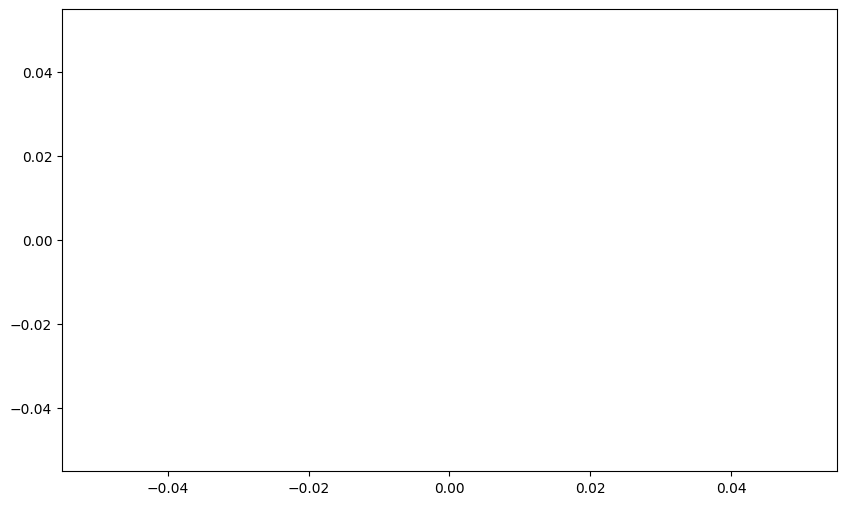

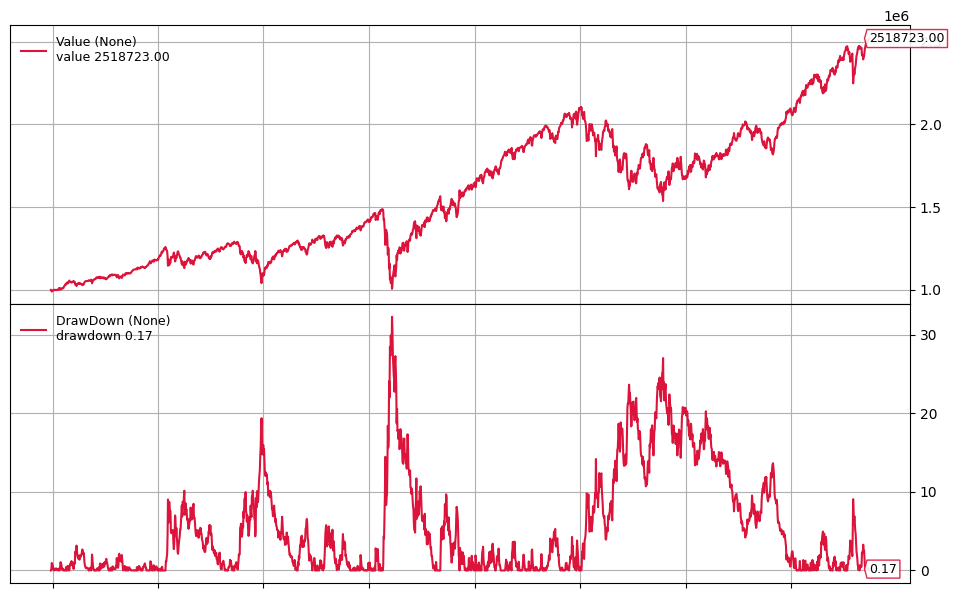

[*********************100%***********************]  1 of 1 completed

^HSI


'^HSI'

Timestamp('2013-01-02 00:00:00')

Timestamp('2024-09-27 00:00:00')

==> 1004 3029
backtest:  start=1004 - end=3029

BUY @ 1004 - close:23216.970703125, high:23226.919921875 - date:2017-02-03 00:00:00 - name:^HSI
backtest.plot: 1004-3029


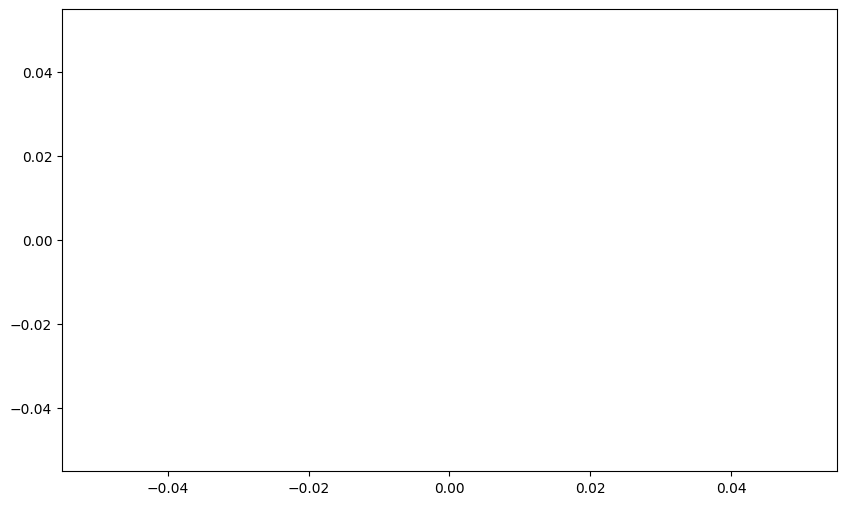

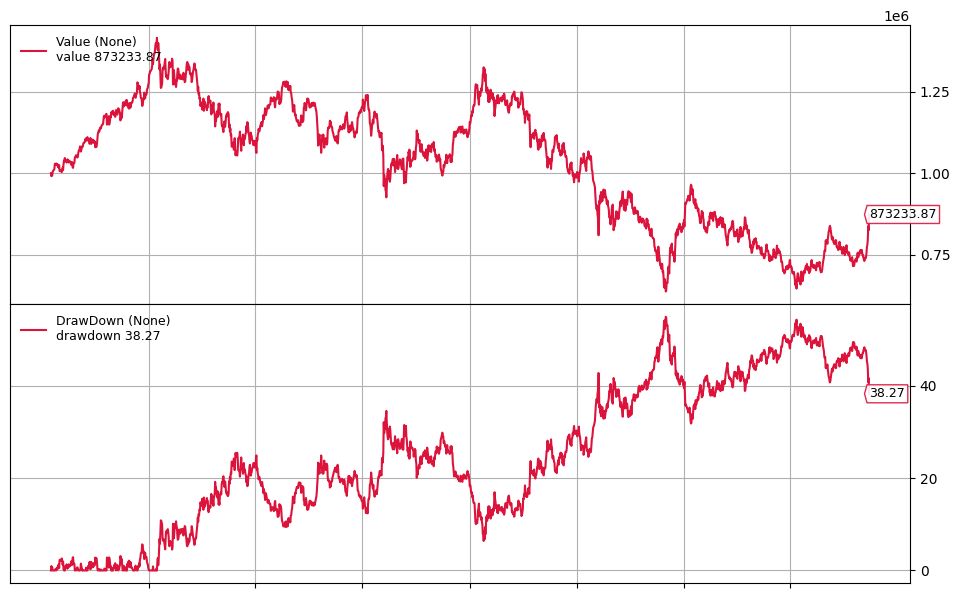

QQQ


[*********************100%***********************]  1 of 1 completed


'QQQ'

Timestamp('2013-01-02 00:00:00')

Timestamp('2024-09-27 00:00:00')

==> 1004 3029
backtest:  start=1004 - end=3029

BUY @ 1004 - close:120.45999908447266, high:121.5199966430664 - date:2016-12-27 00:00:00 - name:QQQ
backtest.plot: 1004-3029


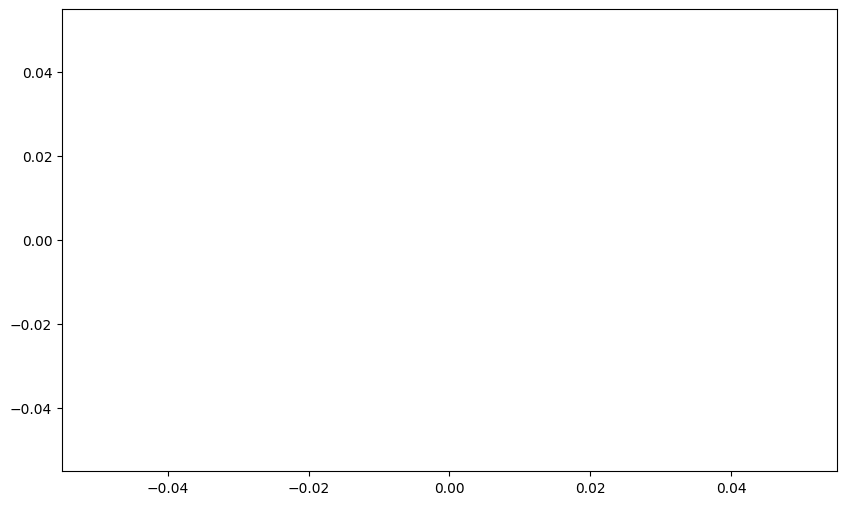

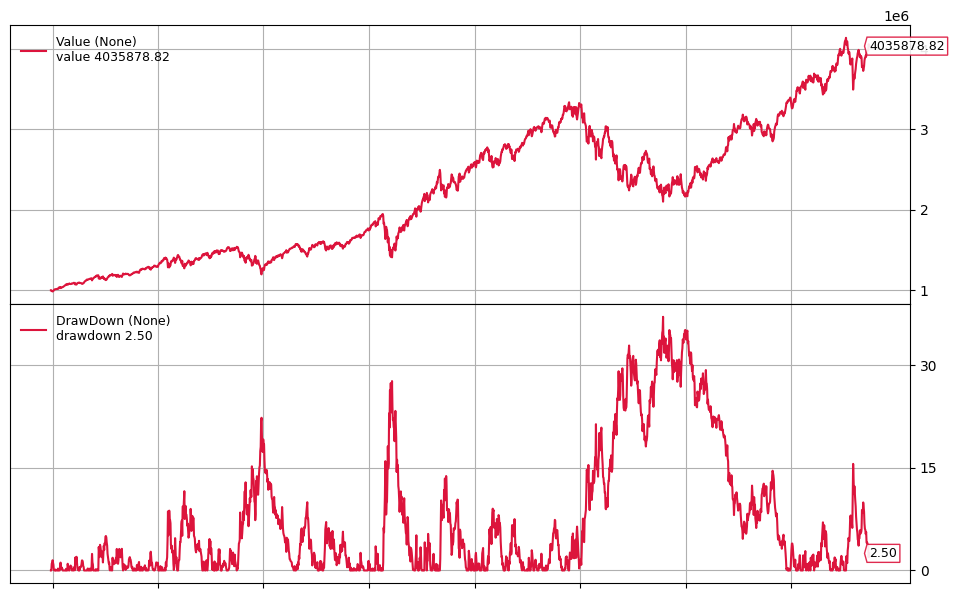

In [25]:
for sym in bm_list:
    benchmark_results[sym] = Backtest_BenchMark(sym)


In [26]:
display(start_test, end_test, benchmark_results )

1004

3029

{'SPY': <__main__.BuyAndHold at 0x7f7a756aefd0>,
 '^HSI': <__main__.BuyAndHold at 0x7f7a74d06d50>,
 'QQQ': <__main__.BuyAndHold at 0x7f7a74b71dd0>}

In [27]:
def RetreiveStats(bt_result, rm, obj, r_int):
    dd = bt_result.analyzers.drawdown.get_analysis()['max']['drawdown']
    cagr= bt_result.analyzers.returns.get_analysis()['rnorm100']
    sharpe =bt_result.analyzers.sharperatio.get_analysis()['sharperatio']

    return {'Risk_measure':rm, 'Objective':obj, 'R_Interval': r_int, 'Max DrawDown':dd/100.0, 'CAGR': cagr/100.0, 'Sharpe Ratio':sharpe}

In [28]:
#
# Retreive Daily Return from bt
#
def RetreiveDailyReturn(bt_result, s_name):
    tret_analyzer = bt_result.analyzers.getbyname('timereturn')
    ret_ = tret_analyzer.get_analysis()
    return pd.DataFrame(ret_.items(), columns=['Date', s_name])


In [29]:
BM_metric_list = []

for symbol in bm_list:
    print(symbol)
    BM_metric_list.append(RetreiveStats(benchmark_results[symbol], symbol, 'N/A', 'N/A'))
    BM_ret = RetreiveDailyReturn(benchmark_results[symbol], symbol)
    print(BM_ret)
    BM_ret.round(4).to_csv(f"{symbol}_ret.csv", index=False)


SPY
           Date       SPY
0    2013-01-02  0.000000
1    2013-01-03  0.000000
2    2013-01-04  0.000000
3    2013-01-07  0.000000
4    2013-01-08  0.000000
...         ...       ...
2950 2024-09-23  0.002634
2951 2024-09-24  0.001996
2952 2024-09-25  0.001154
2953 2024-09-26  0.005656
2954 2024-09-27 -0.001719

[2955 rows x 2 columns]
^HSI
           Date      ^HSI
0    2013-01-02  0.000000
1    2013-01-03  0.000000
2    2013-01-04  0.000000
3    2013-01-07  0.000000
4    2013-01-08  0.000000
...         ...       ...
2883 2024-09-23  0.009128
2884 2024-09-24  0.018109
2885 2024-09-25  0.053837
2886 2024-09-26 -0.014539
2887 2024-09-27  0.058236

[2888 rows x 2 columns]
QQQ
           Date       QQQ
0    2013-01-02  0.000000
1    2013-01-03  0.000000
2    2013-01-04  0.000000
3    2013-01-07  0.000000
4    2013-01-08  0.000000
...         ...       ...
2950 2024-09-23  0.000952
2951 2024-09-24  0.003123
2952 2024-09-25  0.000577
2953 2024-09-26  0.017781
2954 2024-09-27 -0.005810



In [30]:
display(BM_metric_list)

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.3228743946348118,
  'CAGR': 0.08196282546187791,
  'Sharpe Ratio': 0.605347150704247},
 {'Risk_measure': '^HSI',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.5494292603503544,
  'CAGR': -0.01175825798599421,
  'Sharpe Ratio': -0.024920167720875627},
 {'Risk_measure': 'QQQ',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.37031081594835447,
  'CAGR': 0.12635141897178034,
  'Sharpe Ratio': 0.6157275175540328}]

### Rebalancing Monthly, Quarterly, Semiannually using Riskfolio-Lib

In [31]:
############################################################
# Selecting Dates for Rebalancing
############################################################

# def SelectIndex(price_in, mode="Q"):
#     # Selecting last day of month of available data
#     index_Month = price_in.groupby([price_in.index.year, price_in.index.month]).tail(1).index
#     # print("Monthly: ", index_Month)
#     index_daily = price_in.index
#     # print("Daily: ", index_daily)

#     # Quarterly Dates
#     index_Quater = [x for x in index_Month if float(x.month) % 3.0 == 0 ] 
#     # print("Quarterly: ", index_Quater)

#     # Semi-Annually Dates
#     index_Semi = [x for x in index_Month if float(x.month) % 6.0 == 0 ] 
#     # print("Semi-Annually: ", index_Semi)

#     match mode:
#         case "Q": index=index_Quater
#         case "M": index = index_Month
#         case "D": index = index_daily
#         case "S": index = index_Semi
#     # Dates where the strategy will be backtested
#     index_ = [index_daily.get_loc(x) for x in index if index_daily.get_loc(x) >= start_test]
#     return index_

In [32]:
rebalance_index = {}
rebalance_index["M"] = SelectIndex(returns, "M", start_test)
rebalance_index["Q"] = SelectIndex(returns, "Q", start_test)
rebalance_index["S"] = SelectIndex(returns, "S", start_test)


In [33]:
# def generate_interval(idx_list, fn):
#     ret = returns.reset_index()
#     df = ret.iloc[idx_list]['Date'].reset_index()
#     df.to_csv(fn, index=False)
#     return df.set_index('index')


r_index={}
r_index["M"] = generate_interval(returns, rebalance_index["M"], "rebalance_index_M.csv")
r_index["Q"] = generate_interval(returns, rebalance_index["Q"], "rebalance_index_Q.csv")
r_index["S"] = generate_interval(returns, rebalance_index["S"], "rebalance_index_S.csv")

# display(ret.iloc[rebalance_index["M"]]['Date'].reset_index())

In [34]:
r_index["S"]

,Date
index,
1030,2016-12-30 00:00:00+00:00
1158,2017-06-30 00:00:00+00:00
1287,2017-12-29 00:00:00+00:00
1415,2018-06-29 00:00:00+00:00
1545,2018-12-31 00:00:00+00:00
1672,2019-06-28 00:00:00+00:00
1803,2019-12-31 00:00:00+00:00
1931,2020-06-30 00:00:00+00:00
2062,2020-12-31 00:00:00+00:00


In [35]:
df = pd.DataFrame(columns=returns.columns.to_list())
display(df)


,0341.HK,0405.HK,0737.HK,0P00001DU6,0P00002C5C,0P00006OXK.T,0P0000UIC0,0P0000VP5F,0P0000YVJG,0P0000Z5AZ,...,IWRD.L,JDN.MX,LQDE.L,METV,PAVE,SDHY.L,SHV,TFLO,USO,ZM


In [36]:
data = {'col_1': [3, 2, 1, 0], 'col_2': ['a', 'b', 'c', 'd']}
data = {'0341.HK':[1], '0P0000VP5F': [10]}
Set1 = pd.DataFrame.from_dict(data)
print(Set1)
df = pd.concat([df, Set1], axis = 0)
display(df)
data = {'0P0000Z5AZ':[33], '0P00006OXK': [10]}
Set1 = pd.DataFrame.from_dict(data)
df = pd.concat([df, Set1], axis = 0)
display(df)

   0341.HK  0P0000VP5F
0        1          10


,0341.HK,0405.HK,0737.HK,0P00001DU6,0P00002C5C,0P00006OXK.T,0P0000UIC0,0P0000VP5F,0P0000YVJG,0P0000Z5AZ,...,IWRD.L,JDN.MX,LQDE.L,METV,PAVE,SDHY.L,SHV,TFLO,USO,ZM
0,1,NaN,NaN,NaN,NaN,NaN,NaN,10,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


,0341.HK,0405.HK,0737.HK,0P00001DU6,0P00002C5C,0P00006OXK.T,0P0000UIC0,0P0000VP5F,0P0000YVJG,0P0000Z5AZ,...,JDN.MX,LQDE.L,METV,PAVE,SDHY.L,SHV,TFLO,USO,ZM,0P00006OXK
0,1,NaN,NaN,NaN,NaN,NaN,NaN,10,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.0


In [37]:
def get_return_set(ret, s_i, e_i):
    # i_ret = ret.reset_index()
    i_ret = ret.iloc[s_i: e_i,:].dropna(axis=1)
    return i_ret

nY = get_return_set(returns, 40, 1040)
display(nY)

,0341.HK,0405.HK,0737.HK,1186.HK,ADDYY,CSBGU7.SW,GLD,GOVT,HYLD.L,HYMB,...,IGIL.L,IGSB,IHYU.L,ISAG.L,ISTB,IVE,IWRD.L,LQDE.L,SHV,USO
Date,,,,,,,,,,,,,,,,,,,,,
2013-02-27 00:00:00+00:00,-0.0085,0.0024,0.0119,0.0090,0.0128,0.0012,-0.0106,-0.0012,0.0015,-0.0025,...,0.0009,-0.0003,0.0023,0.0134,0.0016,0.0140,0.0114,-0.0011,0.0000,0.0021
2013-02-28 00:00:00+00:00,-0.0022,0.0024,0.0095,0.0330,-0.0015,0.0000,-0.0102,0.0008,0.0015,0.0020,...,0.0022,-0.0001,0.0009,0.0086,-0.0010,-0.0025,0.0056,-0.0001,0.0000,-0.0102
2013-03-01 00:00:00+00:00,-0.0108,-0.0024,0.0094,0.0086,0.0048,0.0006,-0.0037,0.0011,0.0007,0.0011,...,-0.0010,0.0003,0.0011,-0.0043,0.0003,0.0032,0.0051,0.0004,0.0000,-0.0097
2013-03-04 00:00:00+00:00,0.0022,0.0024,0.0023,-0.0232,-0.0011,-0.0003,-0.0009,-0.0008,-0.0001,-0.0024,...,0.0018,-0.0003,0.0002,-0.0039,-0.0002,0.0045,-0.0025,-0.0007,-0.0001,-0.0104
2013-03-05 00:00:00+00:00,0.0109,-0.0024,0.0046,0.0100,0.0137,-0.0025,0.0005,-0.0008,0.0011,0.0026,...,-0.0008,0.0001,0.0021,0.0168,0.0000,0.0085,0.0137,-0.0016,0.0000,0.0090
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-01-09 00:00:00+00:00,0.0058,-0.0048,0.0024,-0.0039,-0.0020,0.0007,0.0082,0.0020,0.0002,0.0014,...,-0.0013,0.0007,0.0027,0.0019,-0.0004,-0.0070,0.0107,0.0036,0.0002,-0.0317
2017-01-10 00:00:00+00:00,0.0116,0.0048,0.0000,0.0039,0.0016,0.0013,0.0043,-0.0004,0.0021,0.0009,...,0.0014,0.0005,0.0000,-0.0010,0.0006,0.0009,0.0019,-0.0014,-0.0001,-0.0212
2017-01-11 00:00:00+00:00,-0.0019,-0.0048,0.0000,0.0137,0.0084,-0.0008,0.0031,0.0008,-0.0039,0.0032,...,0.0013,0.0005,-0.0010,-0.0024,0.0006,0.0030,0.0005,0.0004,0.0000,0.0271


* The optimization is based on the returns of previous 1000 days from last date of each quarter, which is about 4 years

In [38]:
import multiprocessing
import time

def opt_worker(d_cnt, data):
    created = multiprocessing.Process()
    current = multiprocessing.current_process()
    print(f' running: {current.name}, {current._identity}\n created: {created.name}, {created._identity}\n')

    results=[]
    for i in range(len(data)):
        obj, r, rm = data[i]['keys']
        print(f'started for {obj}, {r}, {rm} == {i}/{d_cnt} {current.name}\n')

        result={}
        result['keys'] = data[i]['keys']
        
        start_time = time.time()
        weights = pd.DataFrame(columns=returns.columns.to_list())
        # for j in rebalance_index[r]:
        for j, dt in r_index[r].iterrows():

            try:
                # Y = returns.iloc[j-test_size:j,:] # taking last 4 years (250 trading days per year)
                Y = get_return_set(returns, j-test_size, j)
                orig_size = len(Y.columns.to_list())
                # filter holidays i.e. all ticker has no data at 'all'
                # Y = Y.dropna(axis=0, how='all')
                # then filter out ticker that cannot supply full data set
                # Y = Y.dropna(axis=1, how='any')
                aSet = Y.columns.to_list()
                col_num = len(Y.columns.to_list())
               
                # Building the portfolio object
                # print(f'Create Port: {obj}, {r}, {rm} == {i}/{d_cnt} {current.name}, Y cols={col_num}/{orig_size}\n')
                port = rp.Portfolio(returns=Y)
                
                port.alpha = 0.05
                model='BL' # Could be Classic (historical), BL (Black Litterman) or FM (Factor Model)
                hist = False # Use historical scenarios for risk measures that depend on scenarios
                rf = 0 # Risk free rate
                l = 0 # Risk aversion factor, only useful when obj is 'Utility'
                
                # Add portfolio constraints
                if useView:
                    P,Q = get_Views(aSet)
                if useConstraint:
                    A, B = get_Constraint(aSet)
                    port.ainequality = A
                    port.binequality = B
                
                # Calculating optimum portfolio
                
                # Select method and estimate input parameters:
                
                method_mu='hist' # Method to estimate expected returns based on historical data.
                method_cov='hist' # Method to estimate covariance matrix based on historical data.
                
                # print(f'assets_stats: {obj}, {r}, {rm} == {i}/{d_cnt} {current.name}\n')
                port.assets_stats(method_mu=method_mu, method_cov=method_cov)
                
                # Estimate optimal portfolio:
                # print(f'optimization(Classic): {obj}, {r}, {rm} == {i}/{d_cnt} {current.name}\n')
                out_w = port.optimization(model='Classic', rm=rm, obj=obj, rf=rf, l=l, hist=True)
                # print(f"opt result for {obj}, {r}, {rm} == {i}/{d_cnt} {current.name}--out_w: {len(out_w)}:{out_w}\n")
                w = out_w
                
                # # Estimate Black Litterman inputs:
                # print(f'blacklitterman_stats: {obj}, {r}, {rm} == {i}/{len(data)} {current.name}\n')
                # port.blacklitterman_stats(P, Q/252, rf=rf, w=w, delta=None, eq=True)
                
                # if rm == 'MV':
                #     hist = False
                # else:
                #     hist = True
                # print(f'optimization({model}): {obj}, {r}, {rm} == {i}/{len(data)} {current.name}\n')
                # w = port.optimization(model=model, rm=rm, obj=obj, rf=rf, l=l, hist=hist)
            except Exception as e:
                print(f'Exception:{e} -- {obj}, {r}, {rm} == {i}/{d_cnt} {current.name}\n')
                w = None
            
            if w is None:
                w = weights.tail(1).T
            weights = pd.concat([weights, w.T], axis = 0)
     
        totalt = time.time()-start_time
        print(f"Finished for {obj}, {r}, {rm} == {i}/{d_cnt} {current.name}--{totalt} sec--\n")
        # if len(weights) == len(rebalance_index[r]):
        #     weights.index = rebalance_index[r]
        if len(weights) == len(r_index[r]):
            weights.index = r_index[r].index  
            weights.insert(0, 'Date', r_index[r]['Date'])
             
        result['weights'] = weights
        results.append(result) 
    print(f'Existing: {current.name}, {current._identity}\n')
    return results

In [39]:
##
# Generate a list of parameters for the multi-processing optimization function
##

models = {}
data_chunks = []
for obj in objectives:
    models[obj] = {}
    for r in reb_interval:
        models[obj][r] = {}
        for rm in rms:
            print(obj, ",", r, ",", rm)
            weights = pd.DataFrame([])
            data_chunks.append({"keys":(obj, r, rm)})

display(data_chunks)

Sharpe , Q , MV
Sharpe , Q , MAD
Sharpe , Q , MSV
Sharpe , Q , FLPM
Sharpe , Q , SLPM
Sharpe , Q , CVaR
Sharpe , Q , EVaR
Sharpe , Q , WR
Sharpe , Q , MDD
Sharpe , Q , ADD
Sharpe , Q , CDaR
Sharpe , Q , UCI
Sharpe , Q , EDaR
Sharpe , S , MV
Sharpe , S , MAD
Sharpe , S , MSV
Sharpe , S , FLPM
Sharpe , S , SLPM
Sharpe , S , CVaR
Sharpe , S , EVaR
Sharpe , S , WR
Sharpe , S , MDD
Sharpe , S , ADD
Sharpe , S , CDaR
Sharpe , S , UCI
Sharpe , S , EDaR
MinRisk , Q , MV
MinRisk , Q , MAD
MinRisk , Q , MSV
MinRisk , Q , FLPM
MinRisk , Q , SLPM
MinRisk , Q , CVaR
MinRisk , Q , EVaR
MinRisk , Q , WR
MinRisk , Q , MDD
MinRisk , Q , ADD
MinRisk , Q , CDaR
MinRisk , Q , UCI
MinRisk , Q , EDaR
MinRisk , S , MV
MinRisk , S , MAD
MinRisk , S , MSV
MinRisk , S , FLPM
MinRisk , S , SLPM
MinRisk , S , CVaR
MinRisk , S , EVaR
MinRisk , S , WR
MinRisk , S , MDD
MinRisk , S , ADD
MinRisk , S , CDaR
MinRisk , S , UCI
MinRisk , S , EDaR
MaxRet , Q , MV
MaxRet , Q , MAD
MaxRet , Q , MSV
MaxRet , Q , FLPM
MaxRet

[{'keys': ('Sharpe', 'Q', 'MV')},
 {'keys': ('Sharpe', 'Q', 'MAD')},
 {'keys': ('Sharpe', 'Q', 'MSV')},
 {'keys': ('Sharpe', 'Q', 'FLPM')},
 {'keys': ('Sharpe', 'Q', 'SLPM')},
 {'keys': ('Sharpe', 'Q', 'CVaR')},
 {'keys': ('Sharpe', 'Q', 'EVaR')},
 {'keys': ('Sharpe', 'Q', 'WR')},
 {'keys': ('Sharpe', 'Q', 'MDD')},
 {'keys': ('Sharpe', 'Q', 'ADD')},
 {'keys': ('Sharpe', 'Q', 'CDaR')},
 {'keys': ('Sharpe', 'Q', 'UCI')},
 {'keys': ('Sharpe', 'Q', 'EDaR')},
 {'keys': ('Sharpe', 'S', 'MV')},
 {'keys': ('Sharpe', 'S', 'MAD')},
 {'keys': ('Sharpe', 'S', 'MSV')},
 {'keys': ('Sharpe', 'S', 'FLPM')},
 {'keys': ('Sharpe', 'S', 'SLPM')},
 {'keys': ('Sharpe', 'S', 'CVaR')},
 {'keys': ('Sharpe', 'S', 'EVaR')},
 {'keys': ('Sharpe', 'S', 'WR')},
 {'keys': ('Sharpe', 'S', 'MDD')},
 {'keys': ('Sharpe', 'S', 'ADD')},
 {'keys': ('Sharpe', 'S', 'CDaR')},
 {'keys': ('Sharpe', 'S', 'UCI')},
 {'keys': ('Sharpe', 'S', 'EDaR')},
 {'keys': ('MinRisk', 'Q', 'MV')},
 {'keys': ('MinRisk', 'Q', 'MAD')},
 {'keys': (

In [40]:
import random

random.shuffle(data_chunks)
display(data_chunks)

[{'keys': ('MinRisk', 'S', 'MAD')},
 {'keys': ('Sharpe', 'Q', 'ADD')},
 {'keys': ('MaxRet', 'Q', 'SLPM')},
 {'keys': ('MinRisk', 'S', 'MV')},
 {'keys': ('Sharpe', 'S', 'EVaR')},
 {'keys': ('Sharpe', 'S', 'EDaR')},
 {'keys': ('Sharpe', 'S', 'SLPM')},
 {'keys': ('MinRisk', 'Q', 'EDaR')},
 {'keys': ('Sharpe', 'Q', 'FLPM')},
 {'keys': ('MinRisk', 'Q', 'UCI')},
 {'keys': ('MinRisk', 'Q', 'WR')},
 {'keys': ('MaxRet', 'S', 'MSV')},
 {'keys': ('Sharpe', 'Q', 'MSV')},
 {'keys': ('Sharpe', 'S', 'MAD')},
 {'keys': ('MaxRet', 'Q', 'ADD')},
 {'keys': ('Sharpe', 'S', 'WR')},
 {'keys': ('MaxRet', 'S', 'CVaR')},
 {'keys': ('MaxRet', 'Q', 'MDD')},
 {'keys': ('Sharpe', 'Q', 'CDaR')},
 {'keys': ('MinRisk', 'S', 'EVaR')},
 {'keys': ('Sharpe', 'Q', 'UCI')},
 {'keys': ('Sharpe', 'Q', 'SLPM')},
 {'keys': ('MaxRet', 'Q', 'FLPM')},
 {'keys': ('MinRisk', 'S', 'MSV')},
 {'keys': ('MaxRet', 'S', 'CDaR')},
 {'keys': ('Sharpe', 'S', 'CVaR')},
 {'keys': ('MaxRet', 'S', 'MDD')},
 {'keys': ('MaxRet', 'Q', 'WR')},
 {'k

In [41]:
from random import randint
from time import sleep

def myworker(data):
    created = multiprocessing.Process()
    current = multiprocessing.current_process()
    print(f' running: {current.name}, {current._identity}\n created: {created.name}, {created._identity}\n')
    
    print(f'myworker: data.length={len(data)}')
    results = []
    for i in range(len(data)):
        # print('==> ', data[i])
        obj, r, rm = data[i]['keys']
        print(f'started for {obj}, {r}, {rm} == {i}/{len(data)} {current.name}\n')
        totalt = randint(10,100)
        sleep(totalt)
        result={}
        result['keys'] = data[i]['keys']
        result['test'] = f'{obj}-{r}-{rm}'
        print(f'Finished for {obj}, {r}, {rm} == {i}/{len(data)} {current.name}  --{totalt} sec--\n')
        results.append(result)
    return results

In [42]:
%%time

from data_processing_v2 import run_pool_v2, set_debug

set_debug(True)

# Run with a specified number of CPUs

opt_results = run_pool_v2(data_chunks, opt_worker)


MP> set new dbug flag: True
MP> num_cpus is 15
MP> split_data: chunk_size:1 from data.length=78
MP> running: Process-1, (1,)
 created: Process-1:1, (1, 1)

MP> running: Process-2, (2,)
 created: Process-2:1, (2, 1)

MP> running: Process-3, (3,)
 created: Process-3:1, (3, 1)

MP> running: Process-4, (4,)
 created: Process-4:1, (4, 1)

MP> running: Process-5, (5,)
 created: Process-5:1, (5, 1)

MP> running: Process-6, (6,)
 created: Process-6:1, (6, 1)

MP> running: Process-7, (7,)
 created: Process-7:1, (7, 1)

MP> running: Process-8, (8,)
 created: Process-8:1, (8, 1)

MP> running: Process-9, (9,)
 created: Process-9:1, (9, 1)

MP> running: Process-10, (10,)
 created: Process-10:1, (10, 1)

MP> running: Process-11, (11,)
 created: Process-11:1, (11, 1)

MP> running: Process-12, (12,)
 created: Process-12:1, (12, 1)

MP> running: Process-13, (13,)
 created: Process-13:1, (13, 1)

MP> running: Process-14, (14,)
 created: Process-14:1, (14, 1)

 running: Process-2, (2,)
 created: Process-

In [43]:
# pd.options.display.float_format = '{:.4%}'.format

In [44]:
models = []
for batch in opt_results:
    for result in batch:
        obj,r,rm = result['keys']
        # w = result['weights'].fillna(0)
        w = result['weights']
        print(obj,r,rm)
        print('w.shape: ', w.shape)
        print(returns.isna().sum())
        # print(w.columns[w.isna().sum()==w.shape[0]])      
        w.round(4).to_csv(f"weights_{obj}_{r}_{rm}.csv")
        model = {'keys': result['keys'], 'weights': w}
        models.append(model)
        
display(len(models))

MinRisk S MV
w.shape:  (16, 56)
0341.HK            1
0405.HK            1
0737.HK            1
0P00001DU6      1547
0P00002C5C      1547
0P00006OXK.T    2368
0P0000UIC0      1555
0P0000VP5F      1547
0P0000YVJG      1547
0P0000Z5AZ      2368
0P0000ZJFK      2369
0P00013N6C      2368
0P0001DFIZ      2369
0P0001DHN3      1547
0P0001Q87U      2569
1186.HK            1
1810.HK         1422
3175.HK          856
3187.HK         2008
9988.HK         1780
ADDYY              1
AGGU.L          1261
ARKG             474
ARKK             474
BABA             444
CSBGU7.SW          2
ERND.L           204
GLD                1
GOVT               1
HYGH             363
HYLD.L             1
HYMB               1
IAGG             739
IBIT            2845
IBTS.SW            2
IDEV            1091
IDTL.L           530
IDTM.L             1
IEMB.L             1
IGIL.L             1
IGSB               1
IHYU.L             1
ISAG.L             1
ISTB               1
IVE                1
IWRD.L             1
JD

78

In [45]:
models

[{'keys': ('MinRisk', 'S', 'MV'),
  'weights':                            Date       0341.HK       0405.HK       0737.HK  \
  index                                                                       
  1030  2016-12-30 00:00:00+00:00  8.191212e-03  5.012783e-03  1.497186e-02   
  1158  2017-06-30 00:00:00+00:00  8.514232e-03  1.237718e-02  8.974153e-03   
  1287  2017-12-29 00:00:00+00:00  3.627258e-03  6.579041e-03  2.867202e-03   
  1415  2018-06-29 00:00:00+00:00  3.052637e-03  5.776674e-03  3.049358e-03   
  1545  2018-12-31 00:00:00+00:00  1.356736e-03  7.618182e-03  2.216944e-03   
  1672  2019-06-28 00:00:00+00:00  1.032907e-03  7.304383e-03  2.609740e-03   
  1803  2019-12-31 00:00:00+00:00  3.245439e-04  8.191295e-03  2.807886e-03   
  1931  2020-06-30 00:00:00+00:00  5.219227e-04  1.332434e-02  8.765501e-04   
  2062  2020-12-31 00:00:00+00:00  6.076940e-04  1.407720e-02  1.676571e-03   
  2189  2021-06-30 00:00:00+00:00  2.159965e-08  1.488326e-02  1.704068e-03   
  2321 

In [46]:
# create parameters list for process pool
#
parameters=[]
for arg in models:
    param={}
    param['keys'] = arg['keys']
    # display(param['keys'])
    if len(arg['weights'])>0:
        param['weights'] = arg['weights'].round(4)
        # display(param['weights'])
    parameters.append(param)

In [47]:
# parameters[16]['weights']

# # for i in range(len(parameters)):
# i=16
# w = parameters[i]['weights']
# for i in w.index.values:
#     wght = w.loc[i,:].dropna()
#     for i,v in wght.items():
#         print(i," , ", v)

In [48]:
############################################################
# Building the Asset Allocation Class
############################################################

class AssetAllocation(bt.Strategy):

    def log(self, txt, dt=None):
        dt = dt or self.data.datetime[0]
        dt = bt.num2date(dt)
        print('\n{}: {}'.format(dt.isoformat(), txt))

    def __init__(self, **kwargs):
        self._n_assets = len(self.datas)
        self._weights = None
        self._assets = None
        self._data_key = "N/A"
        self.counter = 0
        print(f"length of datas: {self._n_assets}")
        
        for key, value in kwargs.items():
            print(f"init(key: {key})")
            if key=="data_keys":
                self._data_key = value
                
            if key=="assets":
                self._assets = value
                l_assets = len(self._assets)
                print(f"init({self._data_key}) _assets({l_assets}): {self._assets}")
                for i in range(self._n_assets):
                    _n = self.datas[i]._name
                    if _n in self._assets:
                        print(f"init>> assets[{i}]-{_n} in weights")
                        setattr(self, _n, self.datas[i])

            if key=="weights":
                self._weights = value
                w_names = self._weights.columns.to_list()
                l_assets = len(self._assets)
                l_weights = len(self._weights)
                print(f"init(weights, key={self._data_key}).names({l_weights}):  {w_names}")
                print(f"l_assets:{l_assets} == l_weights:{l_weights} : ", l_assets==l_weights)

    def notify_order(self, order):
        if order.status in [bt.Order.Submitted, bt.Order.Accepted]:
            return  # Await further notifications

        if order.status == order.Completed:
            if order.isbuy():
                self.log('BUY COMPLETE, {:.2f}'.format(order.executed.price))
            else:
                selltxt = 'SELL COMPLETE, {:.2f}'.format(order.executed.price)
                self.log(selltxt, order.executed.dt)
        elif order.status in [order.Expired, order.Canceled, order.Margin]:
            self.log('Order Status: {} '.format(order.Status[order.status]))
            pass  # Simply log

        # Allow new orders
        self.orderid = None
         
    def next(self):
        if self.counter in self._weights.index.tolist():
            wght = self._weights.loc[self.counter,:].dropna()
            # print(f'next--> wght({self.counter} is {wght}')
            for i,w in wght.items():
                # print(f"==> Target.order.perc:--> {self.counter},{i},{w}")
                self.order_target_percent(getattr(self, i), target=w)
        self.counter += 1

In [49]:
assets_prices_names=[]
for i in range(len(assets_prices)):
    assets_prices_names.append(assets_prices[i]['name'])
print("length:", len(assets_prices_names))
print(assets_prices_names)

length: 55
['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']


In [50]:
def bt_worker(d_cnt, data):
    created = multiprocessing.Process()
    current = multiprocessing.current_process()
    print(f' running: {current.name}, {current._identity}\n created: {created.name}, {created._identity}\n')    
    # aKey = data['keys']
    # print(f'bt_worker: data.length={len(data)}')
    results = []
    for i in range(len(data)):
        obj, r, rm = data[i]['keys']
        _weights = data[i]['weights'].drop(columns=['Date'])
        w_n = _weights.columns.to_list()
        _assets = assets_prices_names
        print(f"bt_worker: {obj},{r},{rm} == weight.length:{len(_weights)},,{w_n}  {current.name}\n")
        
        start_time = time.time()
        print(f'bt_worker: {obj},{r},{rm} == {i}/{d_cnt} {current.name}\n')
        result={}
        result['keys'] = (obj,r,rm)

        if len(_weights) > 0:
            result0 = backtest(assets_prices,
                            AssetAllocation,
                            start=start_test,
                            end=end_test,
                            plot=plotFlag,
                              assets=_assets,
                              weights=_weights,
                              data_keys=data[i]['keys'])     
        
            result['metric'] = RetreiveStats(result0, rm, obj, r)
            result['Dret'] = RetreiveDailyReturn(result0, 'Return')
        else:
            result['metric'] = None
            result['Dret'] = None
            
        result['w'] = _weights
        totalt = time.time()-start_time
        result['timestamp'] = f"--{totalt}--"

        results.append(result)
    return results

MP> num_cpus is 15
MP> split_data: chunk_size:1 from data.length=78
MP> running: Process-16, (16,)
 created: Process-16:1, (16, 1)

MP> running: Process-17, (17,)
 created: Process-17:1, (17, 1)

MP> running: Process-18, (18,)
 created: Process-18:1, (18, 1)

MP> running: Process-19, (19,)
 created: Process-19:1, (19, 1)

MP> running: Process-20, (20,)
 created: Process-20:1, (20, 1)

MP> running: Process-21, (21,)
 created: Process-21:1, (21, 1)

MP> running: Process-22, (22,)
 created: Process-22:1, (22, 1)

MP> running: Process-23, (23,)
 created: Process-23:1, (23, 1)

MP> running: Process-24, (24,)
 created: Process-24:1, (24, 1)

MP> running: Process-25, (25,)
 created: Process-25:1, (25, 1)

MP> running: Process-26, (26,)
 created: Process-26:1, (26, 1)

MP> running: Process-27, (27,)
 created: Process-27:1, (27, 1)

MP> running: Process-28, (28,)
 created: Process-28:1, (28, 1)

MP> running: Process-29, (29,)
 created: Process-29:1, (29, 1)

MP> running: Process-30, (30,)
 crea

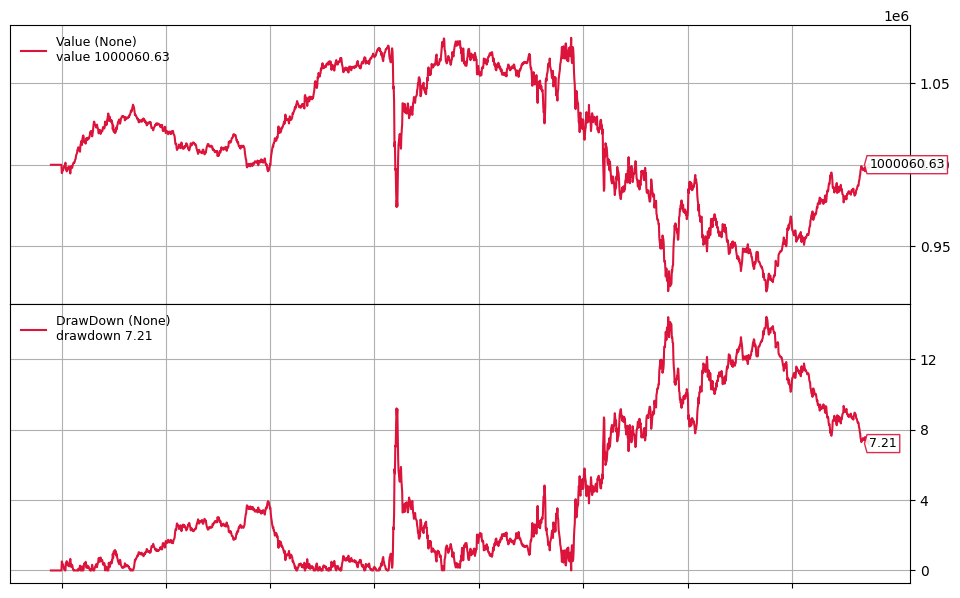


2024-01-02T00:00:00: SELL COMPLETE, 79.80
MP> worker: Process-21 processed 6 data

2020-07-01T00:00:00: SELL COMPLETE, 135.32


2024-01-02T00:00:00: SELL COMPLETE, 15.52 running: Process-21, (21,)
 created: Process-21:3, (21, 3)


2024-01-02T00:00:00: BUY COMPLETE, 32.76

2024-01-02T00:00:00: SELL COMPLETE, 51.54

2024-01-02T00:00:00: BUY COMPLETE, 191.89


2024-01-02T00:00:00: BUY COMPLETE, 63.29

2024-01-02T00:00:00: BUY COMPLETE, 45.96
2020-07-01T00:00:00: SELL COMPLETE, 108.35


2024-01-02T00:00:00: SELL COMPLETE, 173.13
2020-07-01T00:00:00: SELL COMPLETE, 54.61

2024-01-02T00:00:00: SELL COMPLETE, 5291.00


2020-07-01T00:00:00: SELL COMPLETE, 51.32

2024-01-02T00:00:00: SELL COMPLETE, 467.65
bt_worker: MinRisk,S,MSV == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK',

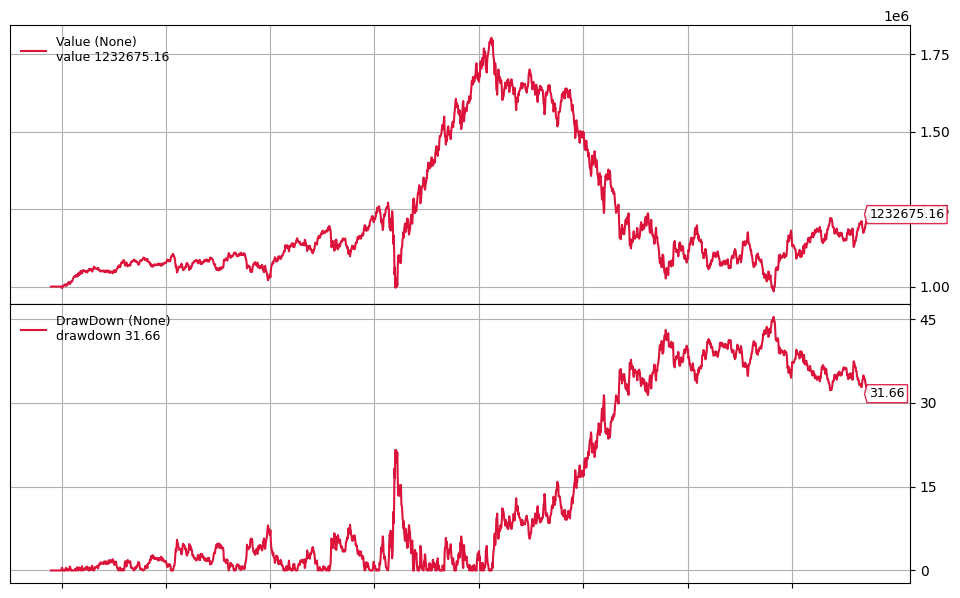


2018-10-01T00:00:00: Order Status: Margin 

2022-01-03T00:00:00: SELL COMPLETE, 110.40
2019-01-02T00:00:00: Order Status: Margin 

MP> worker: Process-19 processed 4 data


2018-07-02T00:00:00: Order Status: Margin 

2019-01-02T00:00:00: Order Status: Margin  running: Process-19, (19,)
 created: Process-19:3, (19, 3)





2018-10-01T00:00:00: Order Status: Margin 
2018-07-02T00:00:00: Order Status: Margin 
2018-10-01T00:00:00: SELL COMPLETE, 10.47


bt_worker: MinRisk,S,EVaR == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN

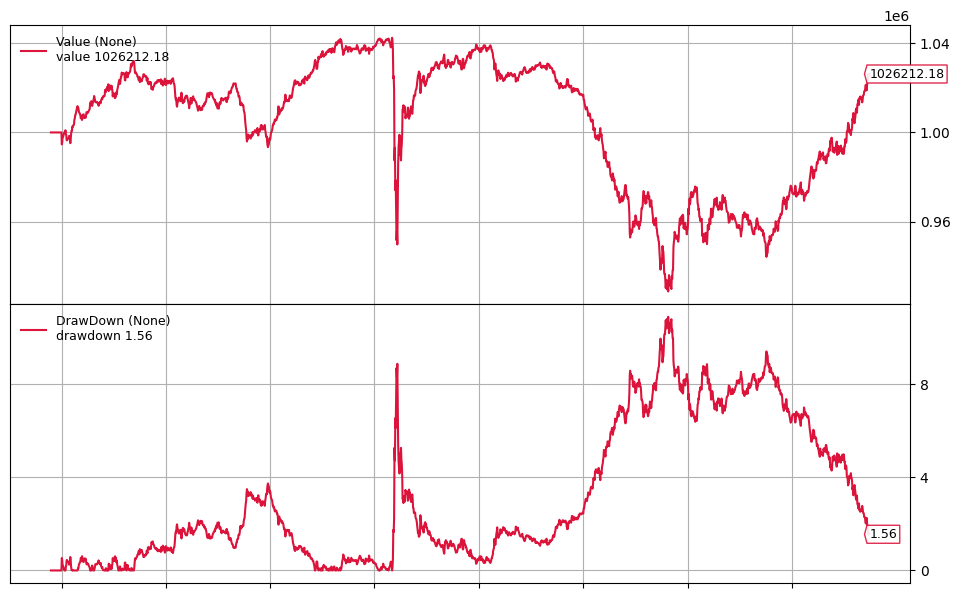



2018-07-02T00:00:00: BUY COMPLETE, 92.07
2019-04-01T00:00:00: SELL COMPLETE, 47.08


2018-07-02T00:00:00: SELL COMPLETE, 110.27
2018-01-02T00:00:00: Order Status: Margin 


2019-04-01T00:00:00: BUY COMPLETE, 100.90
2018-07-02T00:00:00: BUY COMPLETE, 50.25
2018-01-02T00:00:00: Order Status: Margin 


2018-10-01T00:00:00: Order Status: Margin 
2018-01-02T00:00:00: Order Status: Margin 




2018-01-02T00:00:00: Order Status: Margin 
2019-04-01T00:00:00: SELL COMPLETE, 121.79
2020-07-01T00:00:00: BUY COMPLETE, 109.13


2018-01-02T00:00:00: Order Status: Margin 
2020-07-01T00:00:00: BUY COMPLETE, 3785.15


2018-01-02T00:00:00: Order Status: Margin 
2020-07-01T00:00:00: SELL COMPLETE, 1383.05


MP> worker: Process-27 processed 12 data

2018-01-02T00:00:00: SELL COMPLETE, 5.06

2019-04-01T00:00:00: SELL COMPLETE, 25.05

 running: Process-27, (27,)
 created: Process-27:3, (27, 3)

2018-01-02T00:00:00: SELL COMPLETE, 4.96

2019-04-01T00:00:00: Order Status: Margin 


2019-07-01T00:00:00: Orde

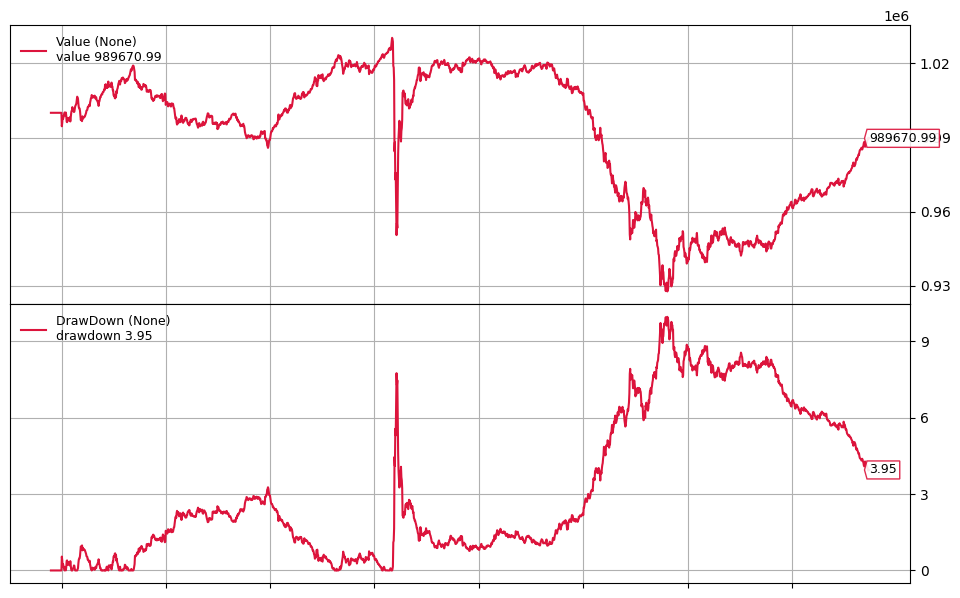


2022-04-01T00:00:00: SELL COMPLETE, 155.42

2022-01-03T00:00:00: Order Status: Margin 
2022-04-01T00:00:00: SELL COMPLETE, 4957.60

2022-04-01T00:00:00: BUY COMPLETE, 1180.00
MP> worker: Process-18 processed 3 data

 running: Process-18, (18,)
 created: Process-18:3, (18, 3)

bt_worker: Sharpe,Q,MSV == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-18

bt_worker: Sharpe,Q,MSV == 0/19 Process-18

backtest:  start=1004 - end=3029

2023-01-03T00:00:0

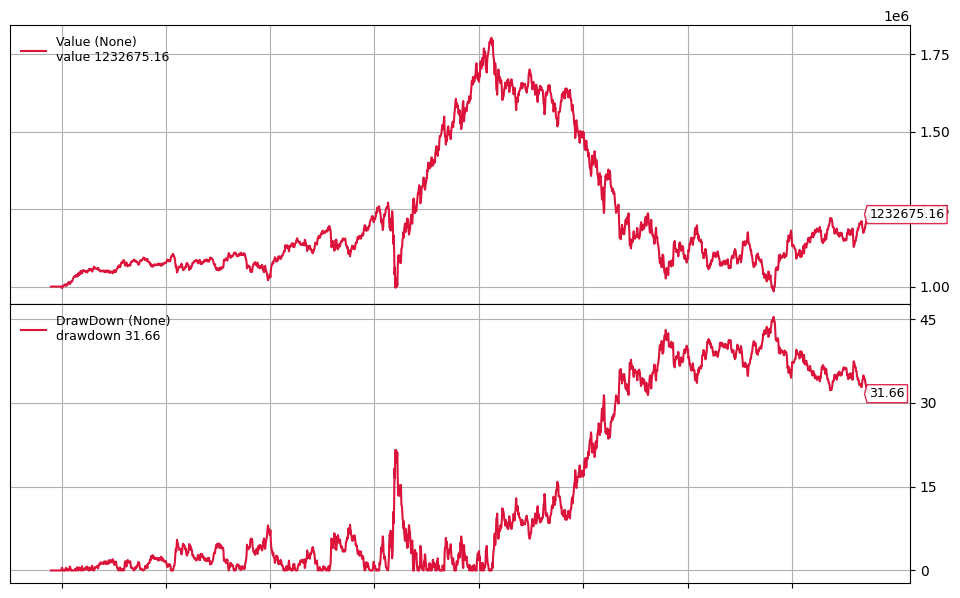


2024-01-02T00:00:00: Order Status: Margin 
2023-01-03T00:00:00: Order Status: Margin 


2024-01-02T00:00:00: SELL COMPLETE, 79.80
2023-10-02T00:00:00: SELL COMPLETE, 70.59
MP> worker: Process-30 processed 15 data



2023-01-03T00:00:00: Order Status: Margin 
2023-10-02T00:00:00: SELL COMPLETE, 11.84


2024-01-02T00:00:00: SELL COMPLETE, 15.52
2023-10-02T00:00:00: BUY COMPLETE, 27.75
 running: Process-30, (30,)
 created: Process-30:3, (30, 3)


2023-10-02T00:00:00: BUY COMPLETE, 39.89

2024-01-02T00:00:00: BUY COMPLETE, 32.76
backtest.plot: 1004-3029bt_worker: Sharpe,S,CVaR == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV

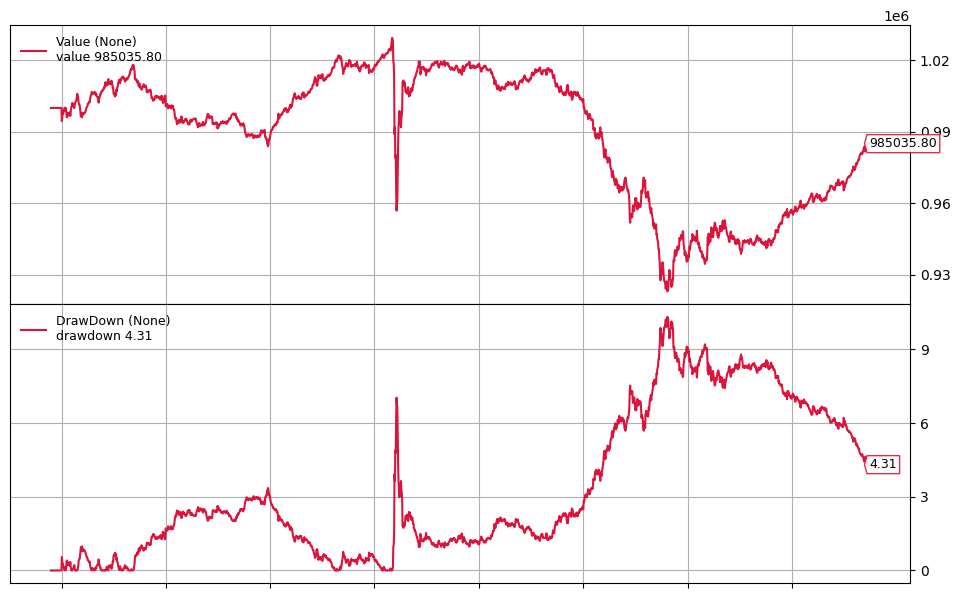



2023-07-03T00:00:00: Order Status: Margin 

2023-07-03T00:00:00: Order Status: Margin 


2023-10-02T00:00:00: BUY COMPLETE, 81.28

2023-07-03T00:00:00: Order Status: Margin 
MP> worker: Process-16 processed 1 data


2024-07-01T00:00:00: BUY COMPLETE, 66.18

2023-07-03T00:00:00: Order Status: Margin 
2024-01-02T00:00:00: BUY COMPLETE, 50.49
2024-07-01T00:00:00: BUY COMPLETE, 44.23

2024-07-01T00:00:00: BUY COMPLETE, 183.30



2023-07-03T00:00:00: Order Status: Margin  running: Process-16, (16,)
 created: Process-16:3, (16, 3)



2024-07-01T00:00:00: BUY COMPLETE, 37.21
2023-07-03T00:00:00: Order Status: Margin bt_worker: MaxRet,S,MDD == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOV

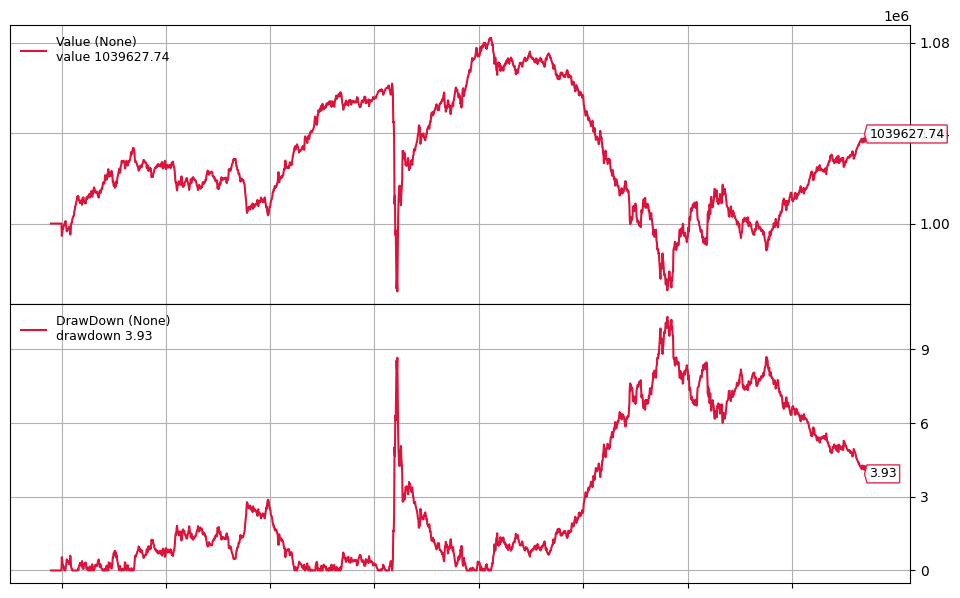



2024-01-02T00:00:00: Order Status: Margin 
MP> worker: Process-23 processed 8 data


2024-01-02T00:00:00: Order Status: Margin  running: Process-23, (23,)
 created: Process-23:3, (23, 3)


bt_worker: MinRisk,S,MDD == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-23

bt_worker: MinRisk,S,MDD == 0/22 Process-23

backtest:  start=1004 - end=3029


2024-01-02T00:00:00: Order Status: Margin 

2024-01-02T00:00:00: Order Status: Margin 

2024-01-02T00:

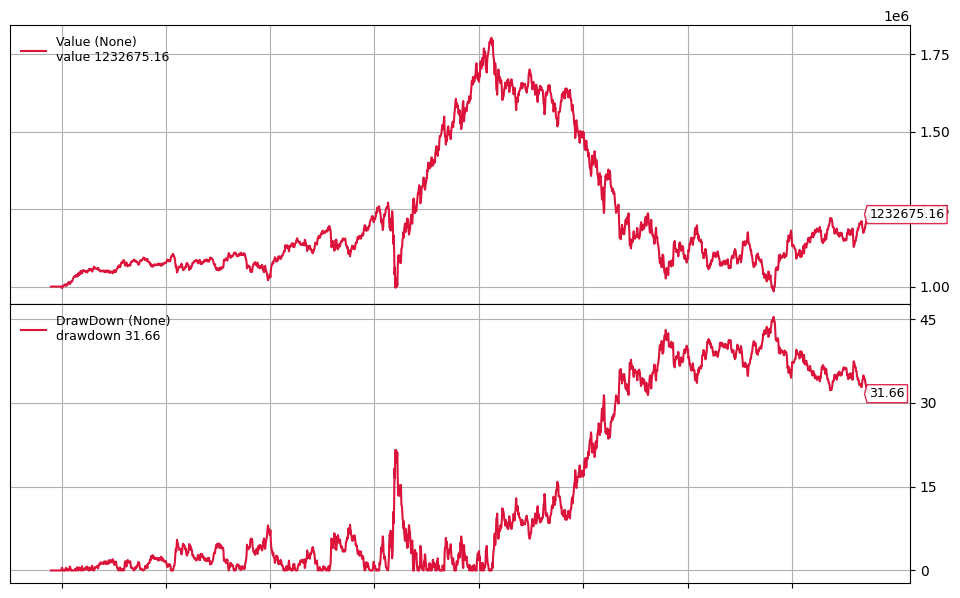


2023-07-03T00:00:00: BUY COMPLETE, 598.00

2023-07-03T00:00:00: SELL COMPLETE, 31.24

2024-01-02T00:00:00: Order Status: Margin MP> worker: Process-17 processed 2 data

2024-07-01T00:00:00: Order Status: Margin 



2024-07-01T00:00:00: Order Status: Margin 

2024-07-01T00:00:00: BUY COMPLETE, 0.94

2024-07-01T00:00:00: SELL COMPLETE, 1.74

2024-07-01T00:00:00: SELL COMPLETE, 1.91

2024-07-01T00:00:00: SELL COMPLETE, 18.42

2024-07-01T00:00:00: SELL COMPLETE, 7.39

2024-07-01T00:00:00: BUY COMPLETE, 99.74

2024-07-01T00:00:00: SELL COMPLETE, 127.24

2024-07-01T00:00:00: SELL COMPLETE, 51.00

2024-07-01T00:00:00: SELL COMPLETE, 110.04

2024-07-01T00:00:00: SELL COMPLETE, 50.45

2024-01-02T00:00:00: Order Status: Margin 

2024-01-02T00:00:00: Order Status: Margin 

2024-01-02T00:00:00: SELL COMPLETE, 1.86

2024-01-02T00:00:00: SELL COMPLETE, 17.50

2024-01-02T00:00:00: BUY COMPLETE, 14.42
2024-07-01T00:00:00: Order Status: Margin 
 running: Process-17, (17,)
 created: Process-17:3, (17, 

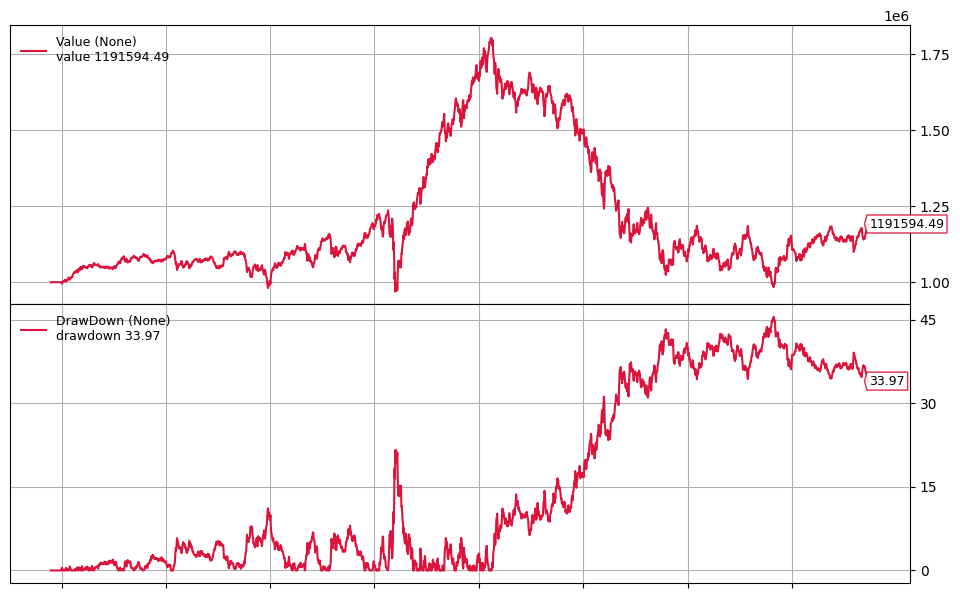



2024-04-01T00:00:00: SELL COMPLETE, 207.64MP> worker: Process-28 processed 13 data

backtest.plot: 1004-3029 running: Process-28, (28,)
 created: Process-28:3, (28, 3)


2023-10-02T00:00:00: Order Status: Margin 

2023-10-02T00:00:00: SELL COMPLETE, 70.59

2023-10-02T00:00:00: SELL COMPLETE, 11.84

2024-04-01T00:00:00: SELL COMPLETE, 85.50
bt_worker: MaxRet,S,EVaR == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-28

bt_worker: MaxRet,S,EVaR == 0

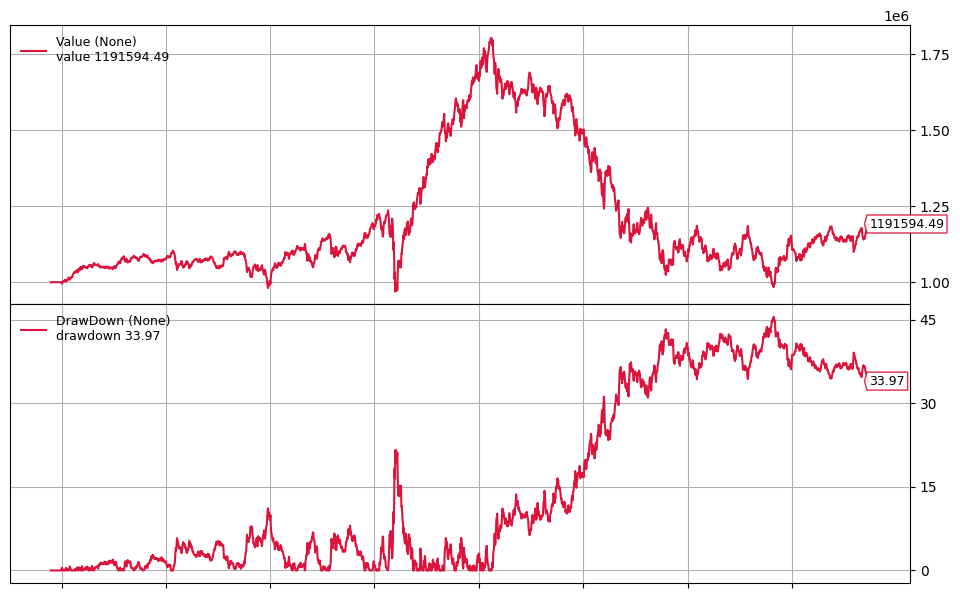


2024-07-01T00:00:00: Order Status: Margin 
2024-04-01T00:00:00: SELL COMPLETE, 46.24
backtest.plot: 1004-3029
MP> worker: Process-22 processed 7 data



2024-07-01T00:00:00: Order Status: Margin 

2024-07-01T00:00:00: Order Status: Margin 


2024-07-01T00:00:00: Order Status: Margin  running: Process-22, (22,)
 created: Process-22:3, (22, 3)



2024-07-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: SELL COMPLETE, 47.16
2024-07-01T00:00:00: Order Status: Margin 
bt_worker: Sharpe,Q,UCI == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', '

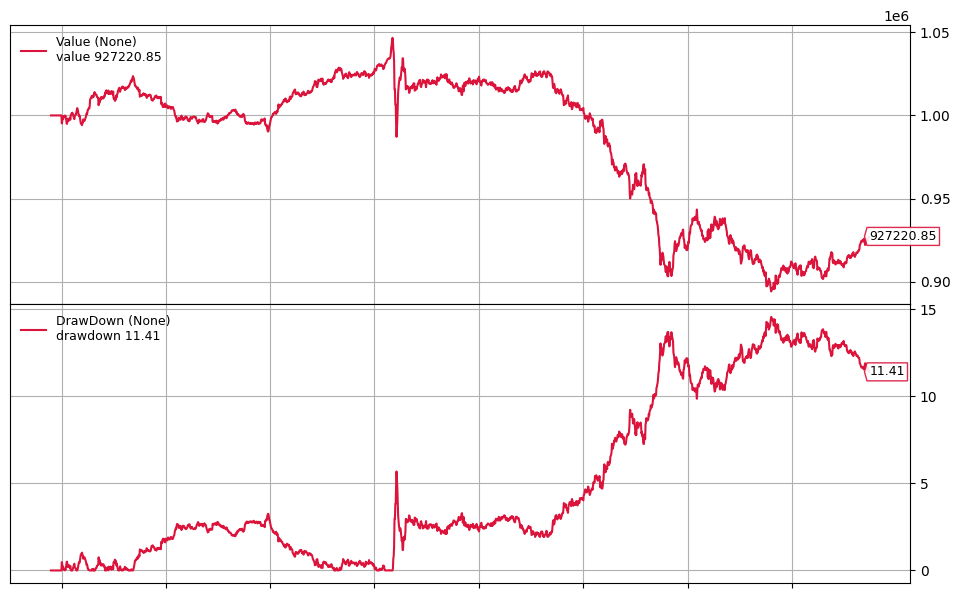

MP> worker: Process-20 processed 5 data


2024-04-01T00:00:00: Order Status: Margin  running: Process-20, (20,)
 created: Process-20:3, (20, 3)


bt_worker: MinRisk,S,WR == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-20

2024-04-01T00:00:00: Order Status: Margin 

bt_worker: MinRisk,S,WR == 0/26 Process-20

backtest:  start=1004 - end=3029


2024-04-01T00:00:00: BUY COMPLETE, 14.77

2024-04-01T00:00:00: BUY COMPLETE, 7.18

2024-04-01T00:00:00: S

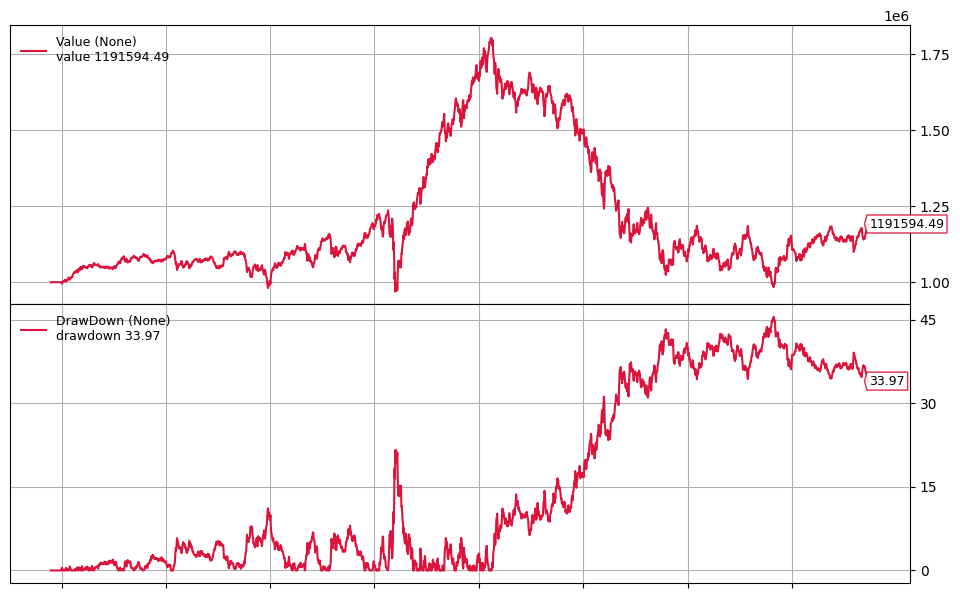

MP> worker: Process-24 processed 9 data

 running: Process-24, (24,)
 created: Process-24:3, (24, 3)

MP> received data 5
MP> received data 9
bt_worker: MaxRet,S,MV == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-24

bt_worker: MaxRet,S,MV == 0/27 Process-24

backtest:  start=1004 - end=3029


2024-07-01T00:00:00: Order Status: Margin 

2024-07-01T00:00:00: BUY COMPLETE, 15.07

2024-07-01T00:00:00: SELL COMPLETE, 16.36

2024-07-01T00:00:00: SELL 

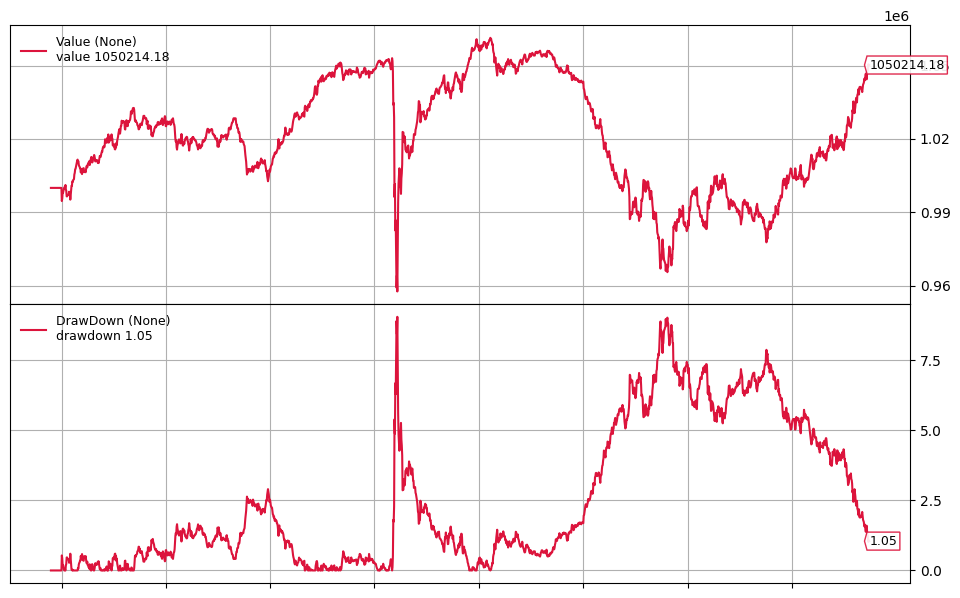

MP> worker: Process-25 processed 10 data

 running: Process-25, (25,)
 created: Process-25:3, (25, 3)

bt_worker: Sharpe,S,FLPM == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-25
backtest.plot: 1004-3029
bt_worker: Sharpe,S,FLPM == 0/28 Process-25

backtest:  start=1004 - end=3029


MP> received data 10


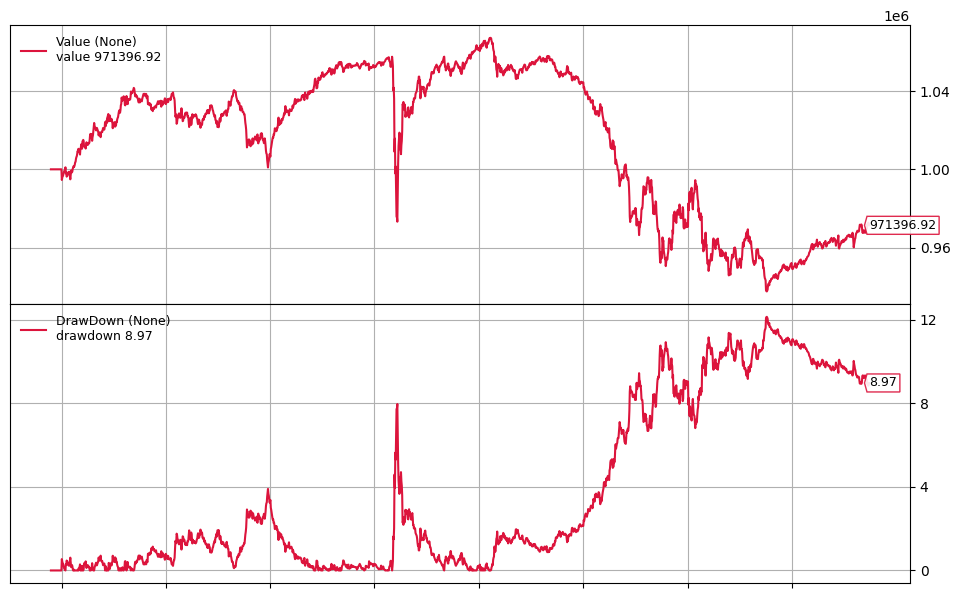

MP> worker: Process-26 processed 11 data

 running: Process-26, (26,)
 created: Process-26:3, (26, 3)

bt_worker: MinRisk,S,SLPM == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-26

bt_worker: MinRisk,S,SLPM == 0/29 Process-26

backtest:  start=1004 - end=3029

MP> received data 11


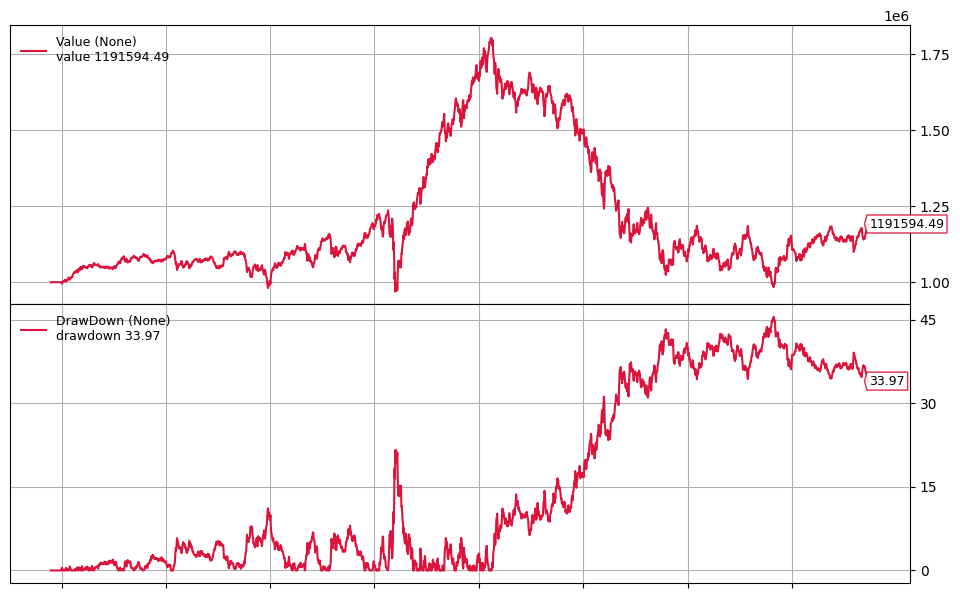

MP> worker: Process-29 processed 14 data

 running: Process-29, (29,)
 created: Process-29:3, (29, 3)

bt_worker: Sharpe,Q,SLPM == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-29

bt_worker: Sharpe,Q,SLPM == 0/30 Process-29

backtest:  start=1004 - end=3029

MP> received data 14
length of datas: 55
init(key: assets)
init(N/A) _assets(55): ['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P

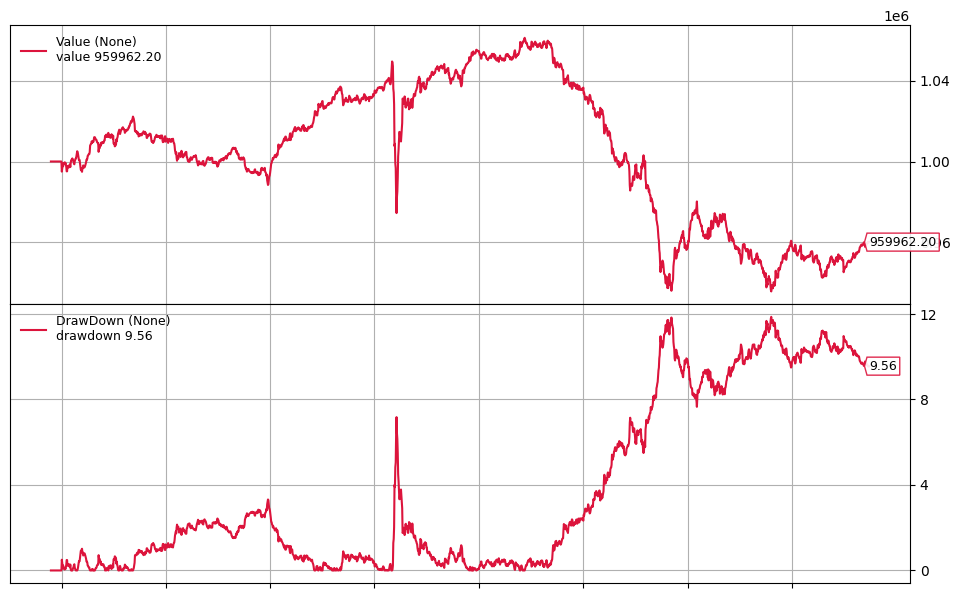



2022-10-03T00:00:00: BUY COMPLETE, 46.48

MP> worker: Process-19 processed 17 data
init>> assets[40]-IGSB in weights
 running: Process-19, (19,)
 created: Process-19:4, (19, 4)

init>> assets[41]-IHYU.L in weightsbt_worker: Sharpe,Q,CDaR == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-19

2022-10-03T00:00:00: BUY COMPLETE, 46.34

bt_worker: Sharpe,Q,CDaR == 0/31 Process-19

2022-10-03T00:00:00: SELL COMPLETE, 109.83


2022-10-03T00:00:00: SELL 

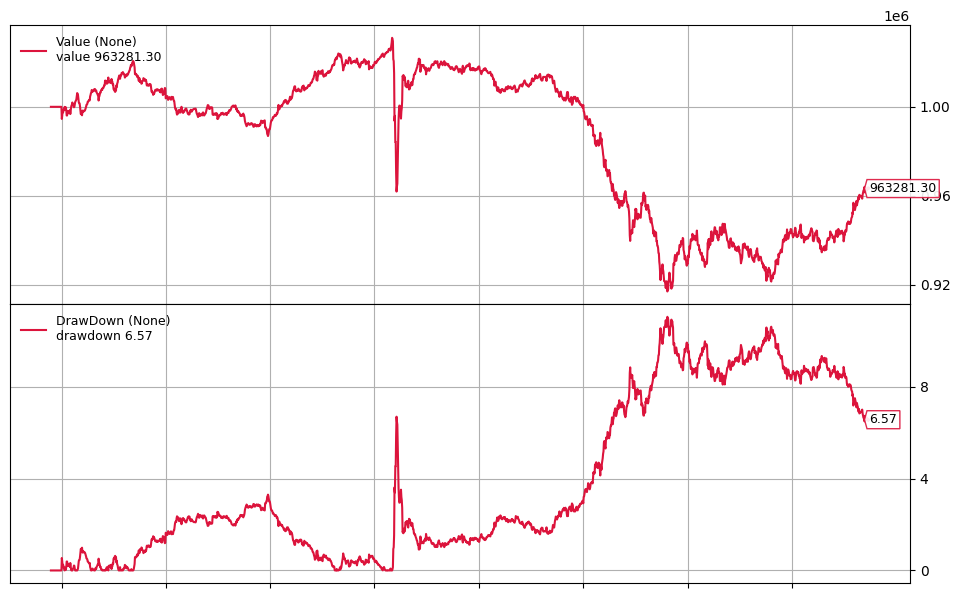

MP> worker: Process-21 processed 16 data

init>> assets[29]-HYGH in weights
init>> assets[30]-HYLD.L in weights
init>> assets[31]-HYMB in weights running: Process-21, (21,)
 created: Process-21:4, (21, 4)


init>> assets[32]-IAGG in weights
2020-01-02T00:00:00: SELL COMPLETE, 5.21

init>> assets[33]-IBIT in weights
init>> assets[34]-IBTS.SW in weightsbt_worker: MinRisk,S,ADD == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-21

init>> assets[35]-ID

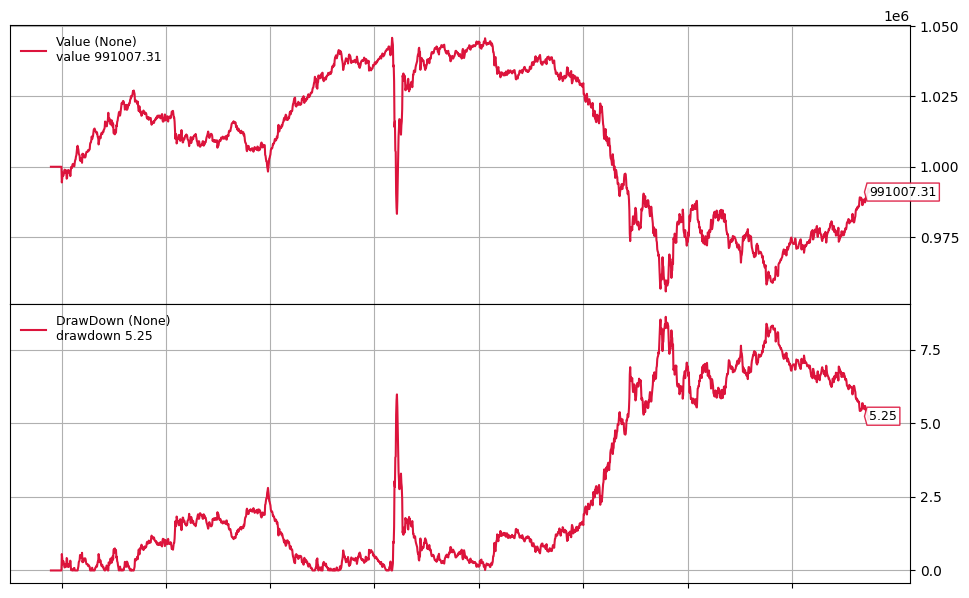



2021-01-04T00:00:00: BUY COMPLETE, 100.01

2021-07-01T00:00:00: Order Status: Margin 
2021-01-04T00:00:00: BUY COMPLETE, 27.40
MP> worker: Process-27 processed 18 data

2021-07-01T00:00:00: Order Status: Margin 




2021-01-04T00:00:00: BUY COMPLETE, 3.76 running: Process-27, (27,)
 created: Process-27:4, (27, 4)


2021-07-01T00:00:00: SELL COMPLETE, 186.80


2021-01-04T00:00:00: SELL COMPLETE, 56.11
2021-01-04T00:00:00: BUY COMPLETE, 94.60


2021-01-04T00:00:00: BUY COMPLETE, 134.70
2021-01-04T00:00:00: SELL COMPLETE, 125.59


2021-07-01T00:00:00: BUY COMPLETE, 93.26
2019-07-01T00:00:00: Order Status: Margin 

2021-01-04T00:00:00: BUY COMPLETE, 141.94

2019-07-01T00:00:00: BUY COMPLETE, 155.98bt_worker: MinRisk,S,FLPM == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', 

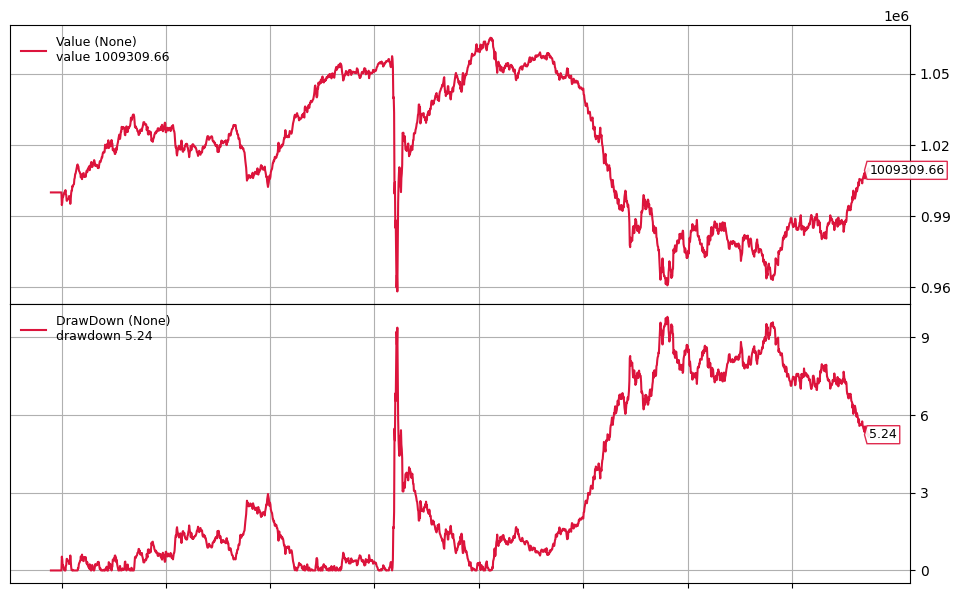



2022-01-03T00:00:00: BUY COMPLETE, 5.13


2020-10-01T00:00:00: Order Status: Margin MP> worker: Process-25 processed 28 data



2020-10-01T00:00:00: Order Status: Margin 
 running: Process-25, (25,)
 created: Process-25:4, (25, 4)

2024-07-01T00:00:00: Order Status: Margin 

2024-07-01T00:00:00: Order Status: Margin 
2022-10-03T00:00:00: Order Status: Margin 


2024-07-01T00:00:00: SELL COMPLETE, 1.91
2022-10-03T00:00:00: SELL COMPLETE, 8.71


2024-07-01T00:00:00: SELL COMPLETE, 18.42
2022-10-03T00:00:00: SELL COMPLETE, 33.08

2024-07-01T00:00:00: SELL COMPLETE, 130.47

2024-07-01T00:00:00: BUY COMPLETE, 99.74

2024-07-01T00:00:00: SELL COMPLETE, 22.37
2024-07-01T00:00:00: Order Status: Margin 


2024-07-01T00:00:00: Order Status: Margin 
2024-07-01T00:00:00: BUY COMPLETE, 85.63

2024-07-01T00:00:00: SELL COMPLETE, 49.75


2024-07-01T00:00:00: Order Status: Margin 
2024-07-01T00:00:00: BUY COMPLETE, 127.33


2024-07-01T00:00:00: Order Status: Margin 
2022-10-03T00:00:00: SELL COMPLET

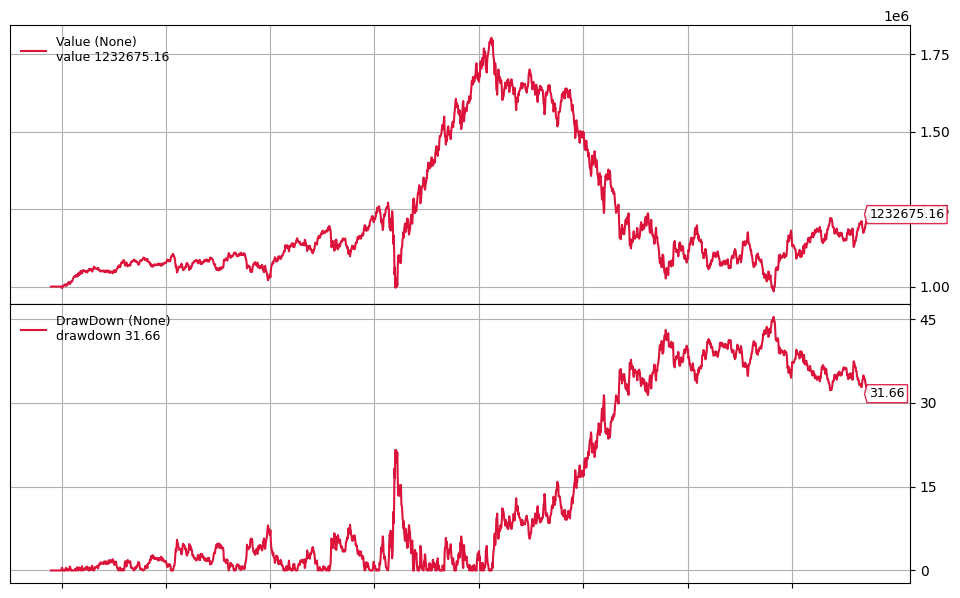


2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: BUY COMPLETE, 131.42

2022-04-01T00:00:00: SELL COMPLETE, 99.25

2022-04-01T00:00:00: SELL COMPLETE, 51.92

2022-04-01T00:00:00: BUY COMPLETE, 129.32

2022-04-01T00:00:00: BUY COMPLETE, 4.91

2022-04-01T00:00:00: BUY COMPLETE, 195.62

2022-04-01T00:00:00: SELL COMPLETE, 48.18

2022-04-01T00:00:00: SELL COMPLETE, 50.32
backtest.plot: 1004-3029
2021-01-04T00:00:00: Order Status: Margin 
MP> worker: Process-28 processed 24 data


2021-01-04T00:00:00: Order Status: Margin 

 running: Process-28, (28,)
 created: Process-28:4, (28, 4)

bt_worker: MinRisk,Q,MAD == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU

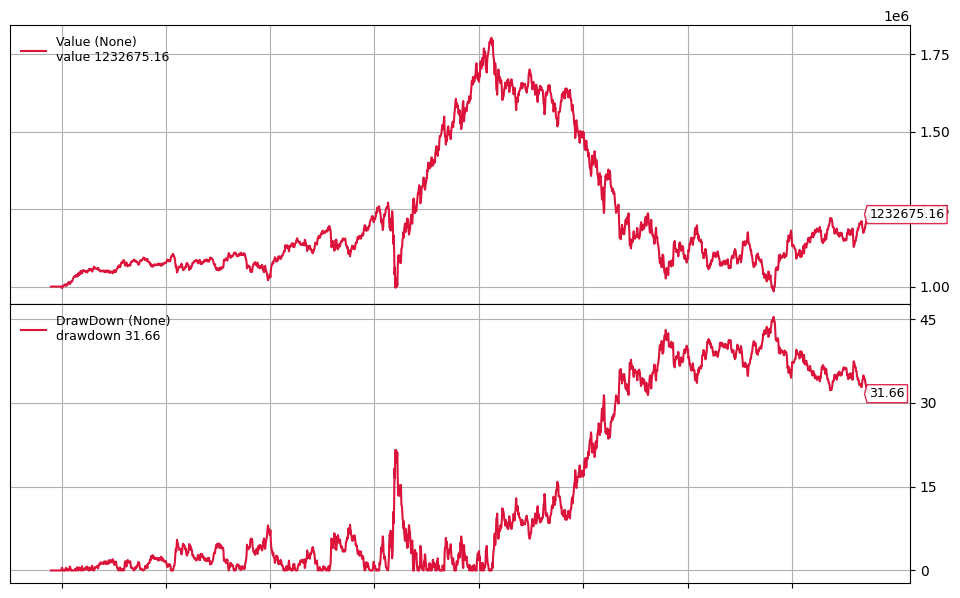

MP> worker: Process-16 processed 21 data


2021-01-04T00:00:00: SELL COMPLETE, 4191.94
2022-07-01T00:00:00: Order Status: Margin 
 running: Process-16, (16,)
 created: Process-16:4, (16, 4)

2022-07-01T00:00:00: Order Status: Margin 




2022-07-01T00:00:00: Order Status: Margin 
2023-04-03T00:00:00: BUY COMPLETE, 12.10

bt_worker: MinRisk,Q,EDaR == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-16

2023-04-03T00:00:00: BUY COMPLETE, 30.01


2022-0

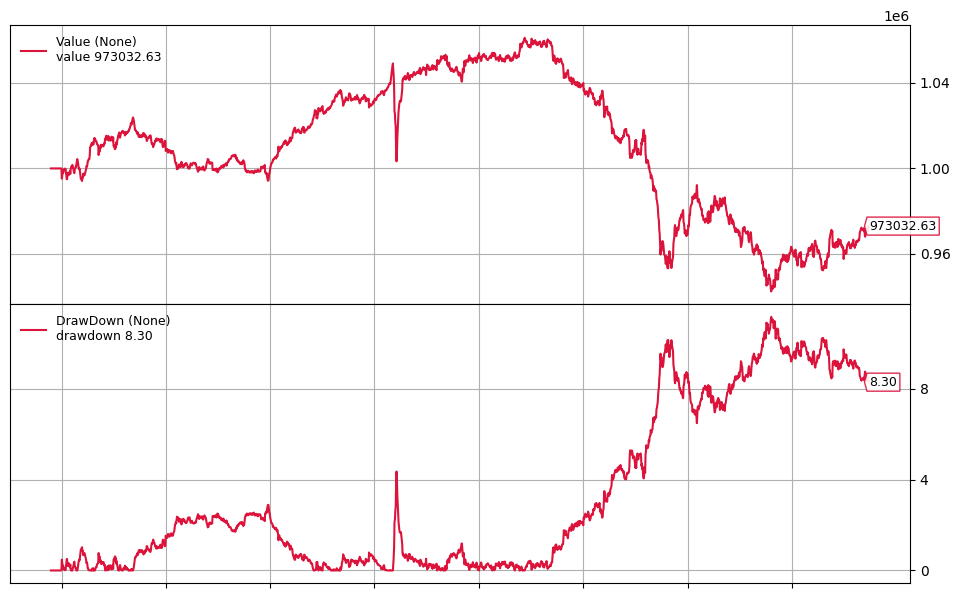



2021-04-01T00:00:00: Order Status: Margin MP> worker: Process-20 processed 26 data

2023-07-03T00:00:00: SELL COMPLETE, 79.45


2023-07-03T00:00:00: BUY COMPLETE, 10.81


2023-07-03T00:00:00: SELL COMPLETE, 34.06
2021-04-01T00:00:00: BUY COMPLETE, 3.94 running: Process-20, (20,)
 created: Process-20:4, (20, 4)


2021-04-01T00:00:00: SELL COMPLETE, 158.35


2021-04-01T00:00:00: BUY COMPLETE, 90.79

2021-04-01T00:00:00: SELL COMPLETE, 122.35

2021-04-01T00:00:00: BUY COMPLETE, 138.98bt_worker: MinRisk,Q,CVaR == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.

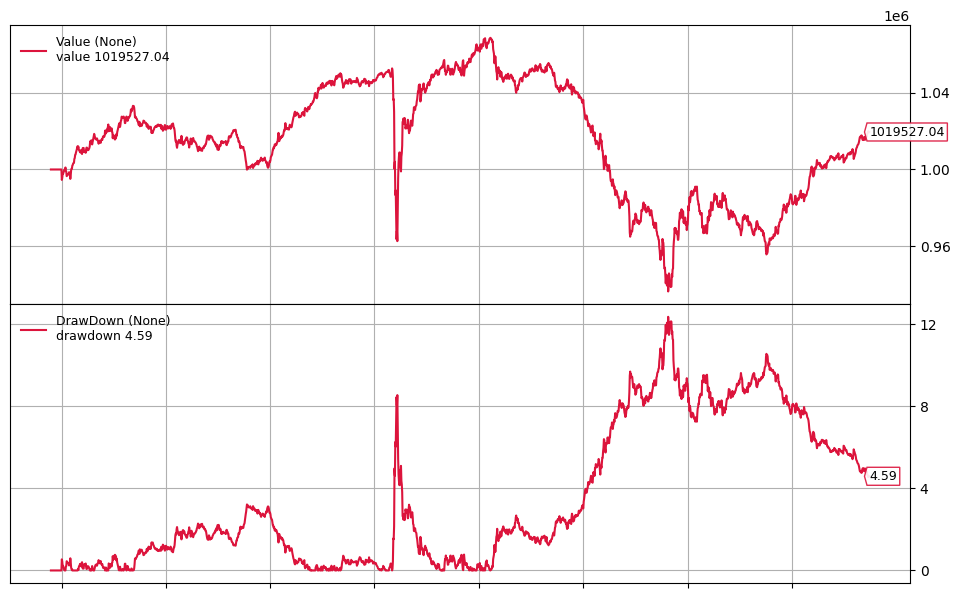



2023-07-03T00:00:00: Order Status: Margin 

2022-10-03T00:00:00: BUY COMPLETE, 156.22

2022-10-03T00:00:00: SELL COMPLETE, 22.83

2022-10-03T00:00:00: SELL COMPLETE, 125.88

2022-10-03T00:00:00: SELL COMPLETE, 49.33

2022-10-03T00:00:00: SELL COMPLETE, 46.25

2022-10-03T00:00:00: BUY COMPLETE, 46.34MP> worker: Process-18 processed 19 data


2022-10-03T00:00:00: SELL COMPLETE, 129.63
 running: Process-18, (18,)
 created: Process-18:4, (18, 4)


bt_worker: Sharpe,S,CDaR == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 

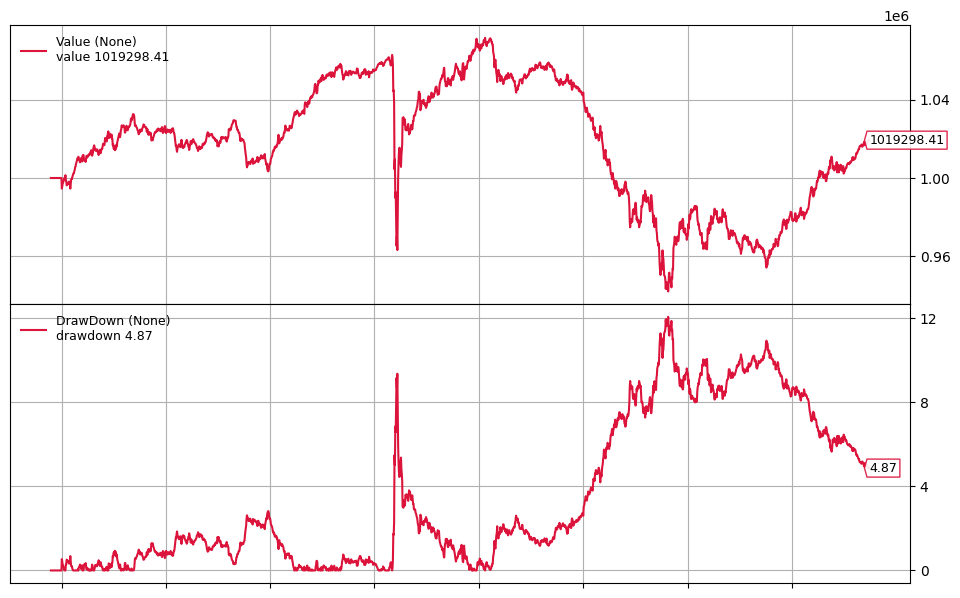




2023-01-03T00:00:00: Order Status: Margin 

2023-01-03T00:00:00: Order Status: Margin 

2023-01-03T00:00:00: Order Status: Margin 

2021-07-01T00:00:00: BUY COMPLETE, 99.93MP> worker: Process-30 processed 20 data

 running: Process-30, (30,)
 created: Process-30:4, (30, 4)


2021-07-01T00:00:00: SELL COMPLETE, 165.82

2021-07-01T00:00:00: SELL COMPLETE, 26.50

2021-07-01T00:00:00: SELL COMPLETE, 55.07
2023-01-03T00:00:00: Order Status: Margin 

2021-07-01T00:00:00: BUY COMPLETE, 133.96



2021-07-01T00:00:00: BUY COMPLETE, 210.81bt_worker: MaxRet,Q,UCI == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.

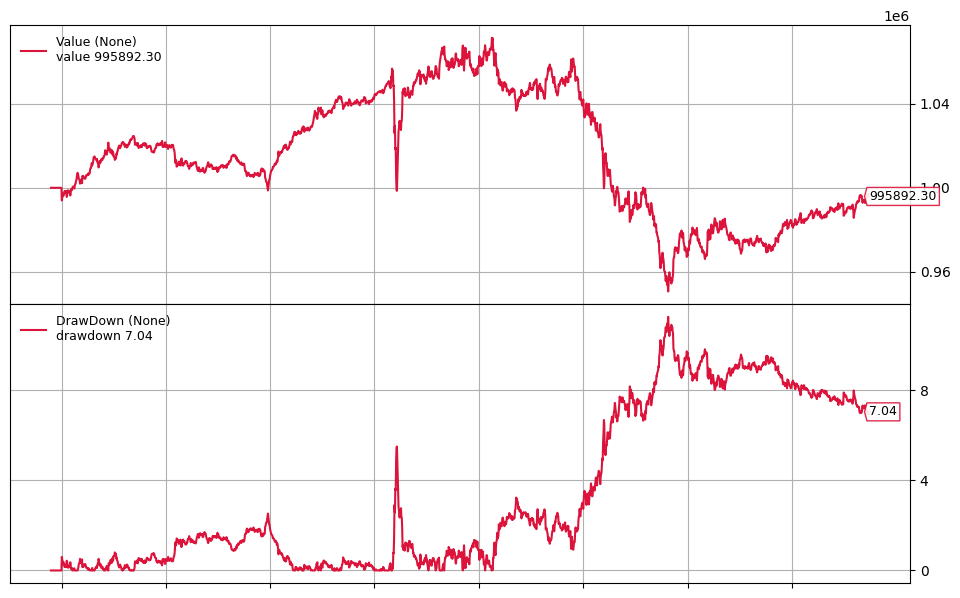

MP> worker: Process-23 processed 22 data

2024-01-02T00:00:00: Order Status: Margin 

2024-01-02T00:00:00: Order Status: Margin 

2024-01-02T00:00:00: SELL COMPLETE, 15.52


2024-01-02T00:00:00: SELL COMPLETE, 32.44 running: Process-23, (23,)
 created: Process-23:4, (23, 4)


2024-01-02T00:00:00: SELL COMPLETE, 51.54

2024-01-02T00:00:00: BUY COMPLETE, 191.89

2024-01-02T00:00:00: SELL COMPLETE, 467.65

2024-01-02T00:00:00: SELL COMPLETE, 34.01


2024-01-02T00:00:00: SELL COMPLETE, 67.22bt_worker: MaxRet,S,FLPM == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'IS

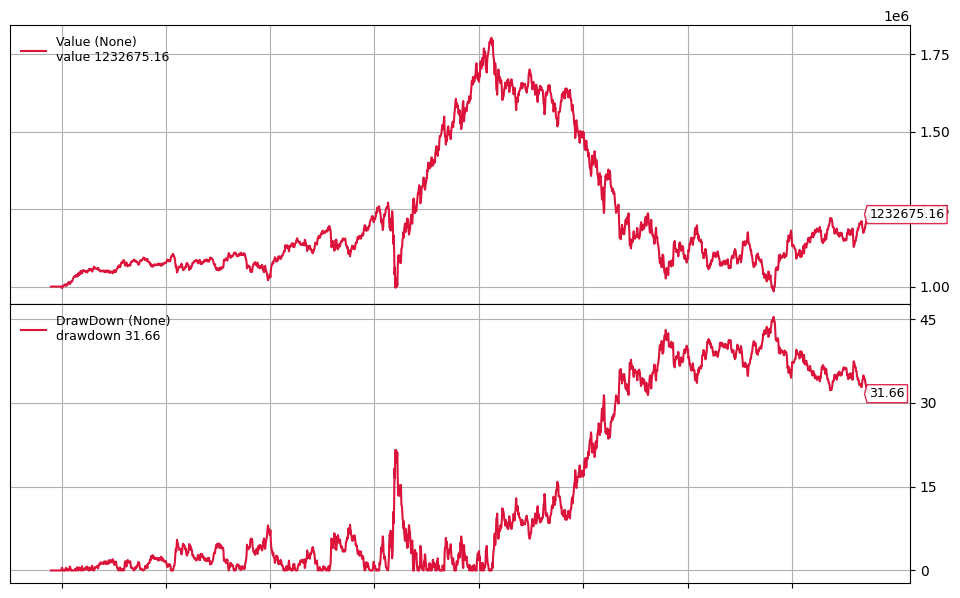

MP> worker: Process-24 processed 27 data

 running: Process-24, (24,)
 created: Process-24:4, (24, 4)

bt_worker: MaxRet,S,WR == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-24

bt_worker: MaxRet,S,WR == 0/41 Process-24

backtest:  start=1004 - end=3029



2022-07-01T00:00:00: Order Status: Margin 

2022-07-01T00:00:00: Order Status: Margin 

2022-07-01T00:00:00: Order Status: Margin 

2022-07-01T00:00:00: Order Status: Margin 

2024-07-01T00:00:

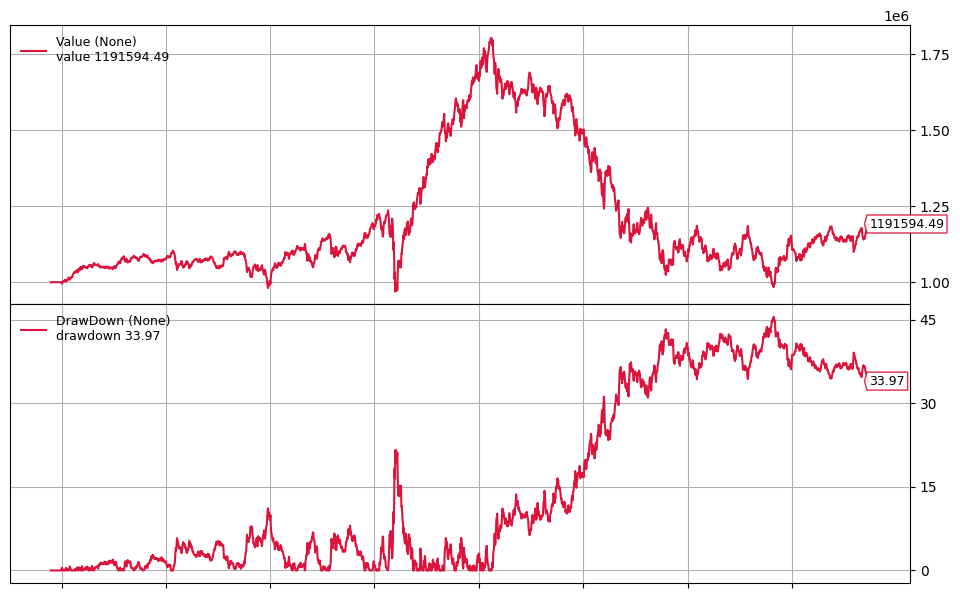



2022-07-01T00:00:00: SELL COMPLETE, 5.18
MP> worker: Process-17 processed 23 data

 running: Process-17, (17,)
 created: Process-17:4, (17, 4)

2022-07-01T00:00:00: SELL COMPLETE, 129.04


2022-07-01T00:00:00: SELL COMPLETE, 98.78

2022-07-01T00:00:00: SELL COMPLETE, 50.05bt_worker: Sharpe,Q,MV == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-17




2022-07-01T00:00:00: SELL COMPLETE, 128.94bt_worker: Sharpe,Q,MV == 0/42 Process-17



2024-07-01

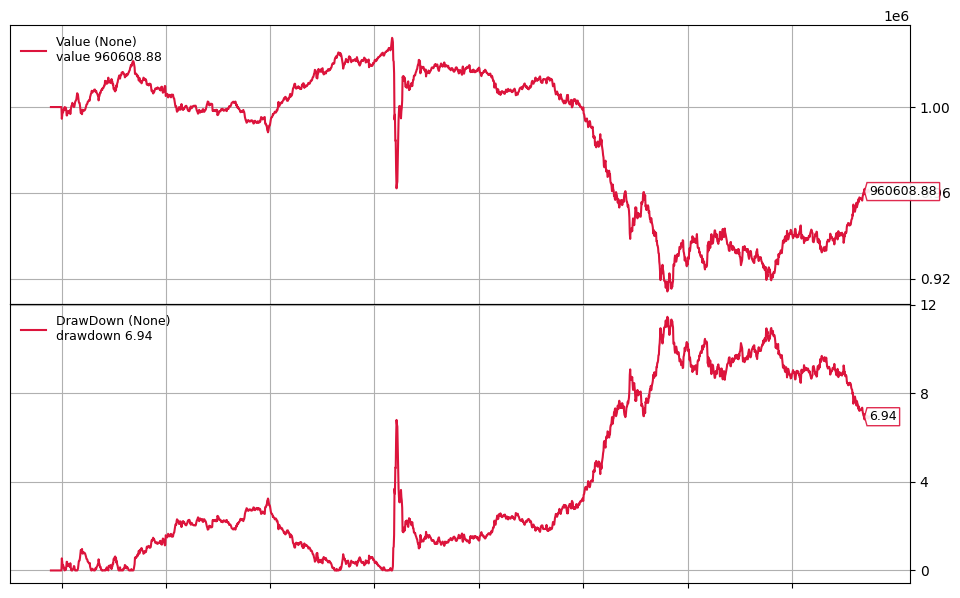

MP> worker: Process-26 processed 29 data

 running: Process-26, (26,)
 created: Process-26:4, (26, 4)

bt_worker: Sharpe,S,MSV == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-26

bt_worker: Sharpe,S,MSV == 0/43 Process-26

backtest:  start=1004 - end=3029


2023-04-03T00:00:00: Order Status: Margin 

2023-04-03T00:00:00: Order Status: Margin 

2023-04-03T00:00:00: Order Status: Margin 

2023-04-03T00:00:00: Order Status: Margin 

2023-04-03T00:00

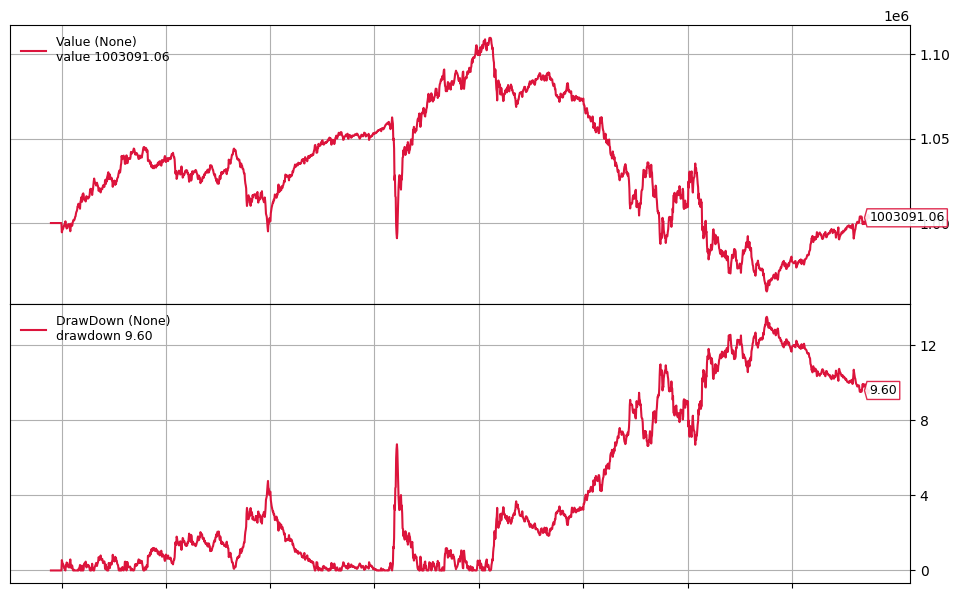



2023-07-03T00:00:00: SELL COMPLETE, 46.61MP> worker: Process-22 processed 25 data

 running: Process-22, (22,)
 created: Process-22:4, (22, 4)

bt_worker: Sharpe,Q,MAD == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-22

bt_worker: Sharpe,Q,MAD == 0/44 Process-22


backtest:  start=1004 - end=3029


2023-07-03T00:00:00: BUY COMPLETE, 46.57

2023-07-03T00:00:00: SELL COMPLETE, 4973.00

2023-07-03T00:00:00: SELL COMPLETE, 598.00

2023-07-03T00:00:

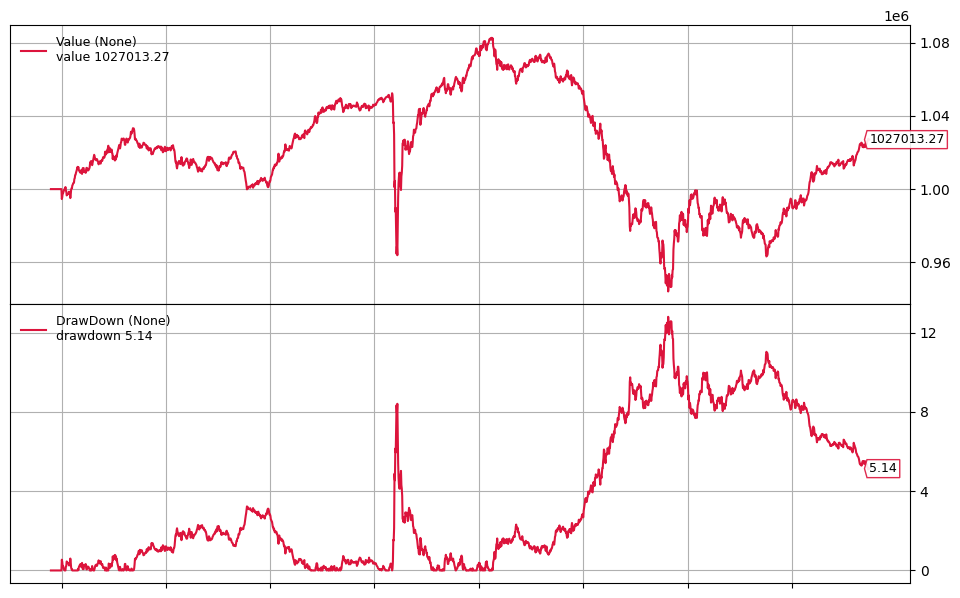

MP> worker: Process-29 processed 30 data

 running: Process-29, (29,)
 created: Process-29:4, (29, 4)

bt_worker: MaxRet,S,ADD == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-29

bt_worker: MaxRet,S,ADD == 0/45 Process-29

backtest:  start=1004 - end=3029

MP> received data 30
length of datas: 55
init(key: assets)
init(N/A) _assets(55): ['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P00

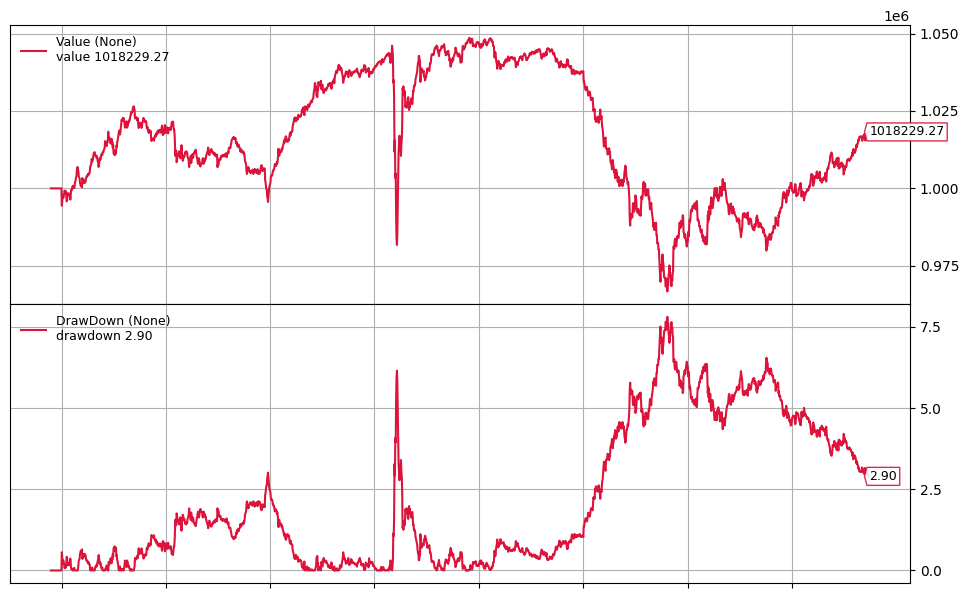


init>> assets[16]-1810.HK in weights
init>> assets[17]-3175.HK in weights
init>> assets[18]-3187.HK in weights

2017-07-03T00:00:00: Order Status: Margin init>> assets[19]-9988.HK in weights


2017-07-03T00:00:00: Order Status: Margin 

2017-07-03T00:00:00: Order Status: Margin 
MP> worker: Process-21 processed 32 data

2018-01-02T00:00:00: Order Status: Margin 
2017-07-03T00:00:00: Order Status: Margin 

init>> assets[20]-ADDYY in weights
2017-10-02T00:00:00: BUY COMPLETE, 4.89
2018-01-02T00:00:00: Order Status: Margin 
2017-07-03T00:00:00: Order Status: Margin 
init>> assets[21]-AGGU.L in weights


2017-10-02T00:00:00: SELL COMPLETE, 4.83init>> assets[22]-ARKG in weights


2017-10-02T00:00:00: BUY COMPLETE, 9.85

init>> assets[23]-ARKK in weights
2017-10-02T00:00:00: SELL COMPLETE, 115.00


2017-10-02T00:00:00: BUY COMPLETE, 28.46init>> assets[24]-BABA in weights
2017-07-03T00:00:00: Order Status: Margin 



2017-10-02T00:00:00: BUY COMPLETE, 97.63init>> assets[25]-CSBGU7.SW in weig

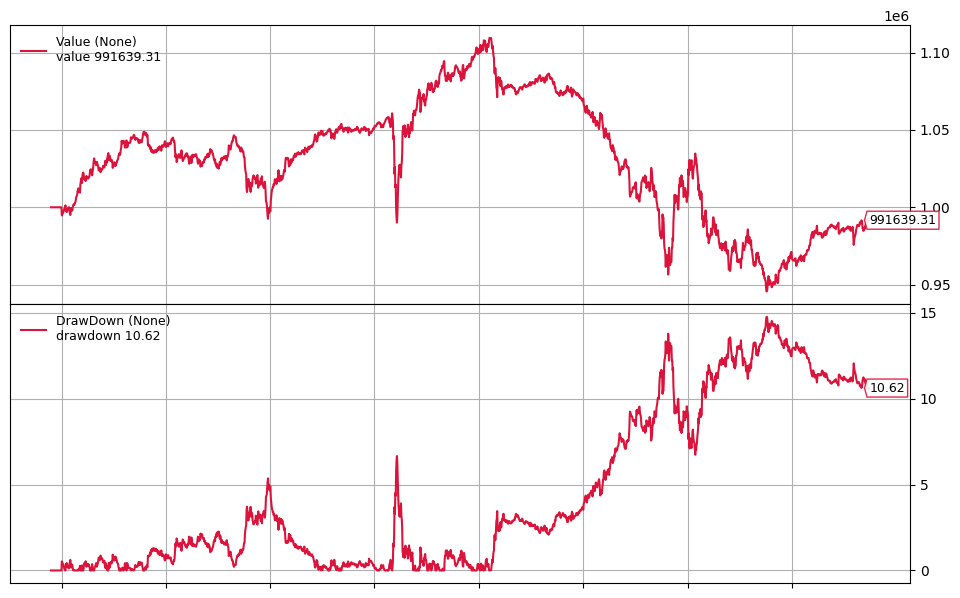



2017-07-03T00:00:00: BUY COMPLETE, 28.41

2018-07-02T00:00:00: Order Status: Margin MP> worker: Process-19 processed 31 data



2018-07-02T00:00:00: Order Status: Margin 
 running: Process-19, (19,)
 created: Process-19:5, (19, 5)


2018-07-02T00:00:00: Order Status: Margin 

2018-07-02T00:00:00: Order Status: Margin 

2018-07-02T00:00:00: Order Status: Margin 

2017-07-03T00:00:00: BUY COMPLETE, 99.19
2018-07-02T00:00:00: Order Status: Margin 


2017-07-03T00:00:00: SELL COMPLETE, 105.10
2018-07-02T00:00:00: Order Status: Margin 


2017-07-03T00:00:00: BUY COMPLETE, 31.10

2017-07-03T00:00:00: BUY COMPLETE, 105.96
2018-07-02T00:00:00: Order Status: Margin 
bt_worker: Sharpe,S,MDD == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', '

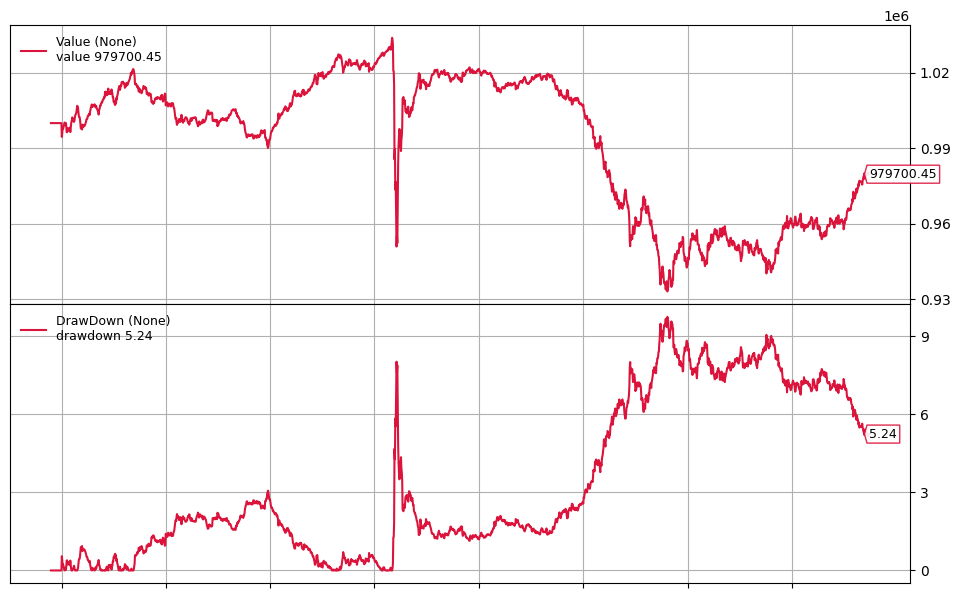



2019-07-01T00:00:00: SELL COMPLETE, 117.28

2019-07-01T00:00:00: SELL COMPLETE, 3695.00

2019-07-01T00:00:00: BUY COMPLETE, 606.50

2019-07-01T00:00:00: BUY COMPLETE, 92.48
MP> worker: Process-27 processed 33 data


2019-07-01T00:00:00: BUY COMPLETE, 110.46
 running: Process-27, (27,)
 created: Process-27:5, (27, 5)

2019-07-01T00:00:00: BUY COMPLETE, 50.25


2017-01-03T00:00:00: BUY COMPLETE, 4.10

2017-01-03T00:00:00: BUY COMPLETE, 77.84

2017-01-03T00:00:00: BUY COMPLETE, 122.10

2017-01-03T00:00:00: BUY COMPLETE, 24.96

2017-01-03T00:00:00: BUY COMPLETE, 28.07

2017-01-03T00:00:00: BUY COMPLETE, 132.32

2017-01-03T00:00:00: BUY COMPLETE, 193.44

2017-01-03T00:00:00: BUY COMPLETE, 52.45

2017-01-03T00:00:00: BUY COMPLETE, 50.00

2017-01-03T00:00:00: BUY COMPLETE, 102.45

2017-01-03T00:00:00: BUY COMPLETE, 3056.20
bt_worker: MinRisk,Q,MDD == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0

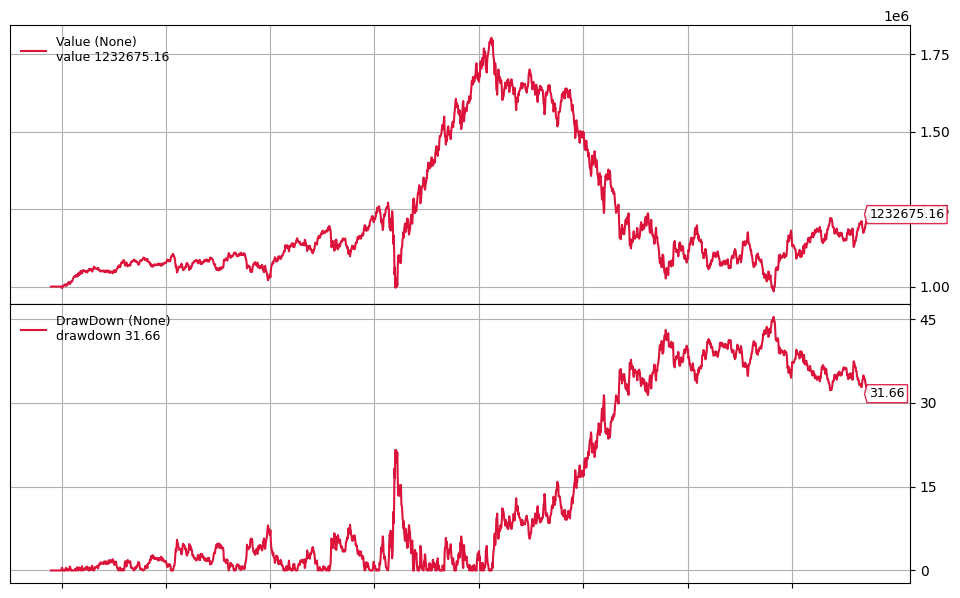


2022-07-01T00:00:00: BUY COMPLETE, 13.73
2022-07-01T00:00:00: Order Status: Margin 

2020-10-01T00:00:00: BUY COMPLETE, 100.60

2020-10-01T00:00:00: BUY COMPLETE, 179.50

2021-10-01T00:00:00: SELL COMPLETE, 3.59
2020-10-01T00:00:00: SELL COMPLETE, 89.19


2022-07-01T00:00:00: SELL COMPLETE, 86.70
2021-10-01T00:00:00: BUY COMPLETE, 2.84

MP> worker: Process-24 processed 41 data

2022-07-01T00:00:00: BUY COMPLETE, 31.82

2023-04-03T00:00:00: Order Status: Margin 

2022-07-01T00:00:00: Order Status: Margin 
 running: Process-24, (24,)
 created: Process-24:5, (24, 5)

2021-10-01T00:00:00: SELL COMPLETE, 5.04
2023-04-03T00:00:00: Order Status: Margin 




2023-04-03T00:00:00: Order Status: Margin 
2021-10-01T00:00:00: SELL COMPLETE, 99.92


2023-04-03T00:00:00: Order Status: Margin 
2021-10-01T00:00:00: BUY COMPLETE, 26.58

2023-04-03T00:00:00: Order Status: Margin bt_worker: MaxRet,S,EDaR == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0

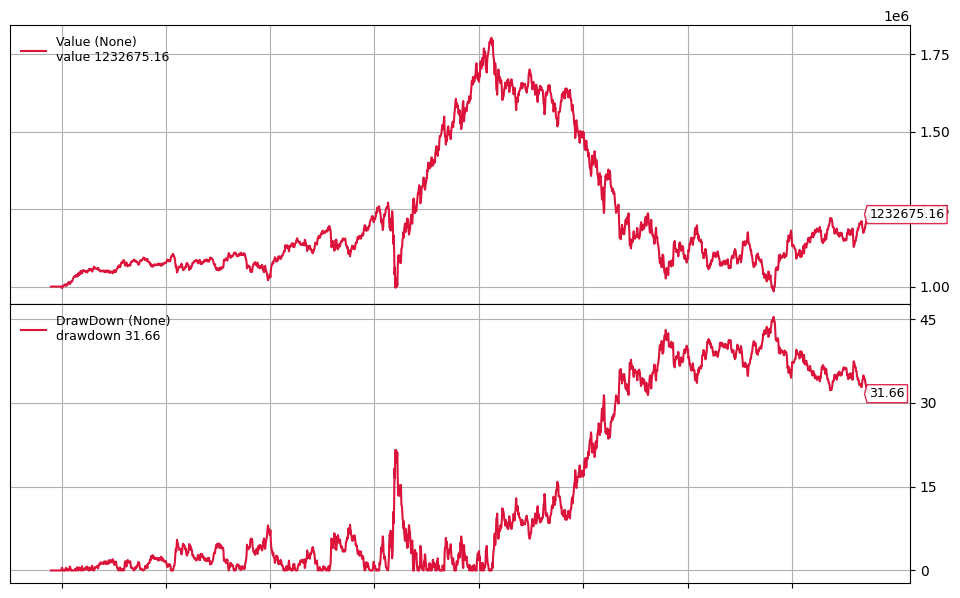


2024-07-01T00:00:00: BUY COMPLETE, 85.63

2024-07-01T00:00:00: BUY COMPLETE, 66.18

2024-07-01T00:00:00: BUY COMPLETE, 44.23

2023-07-03T00:00:00: Order Status: Margin 

2024-07-01T00:00:00: BUY COMPLETE, 183.30
2023-07-03T00:00:00: Order Status: Margin 

2023-07-03T00:00:00: Order Status: Margin 

2023-07-03T00:00:00: Order Status: Margin MP> worker: Process-23 processed 40 data


 running: Process-23, (23,)
 created: Process-23:5, (23, 5)


2023-07-03T00:00:00: Order Status: Margin bt_worker: MaxRet,Q,EDaR == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG

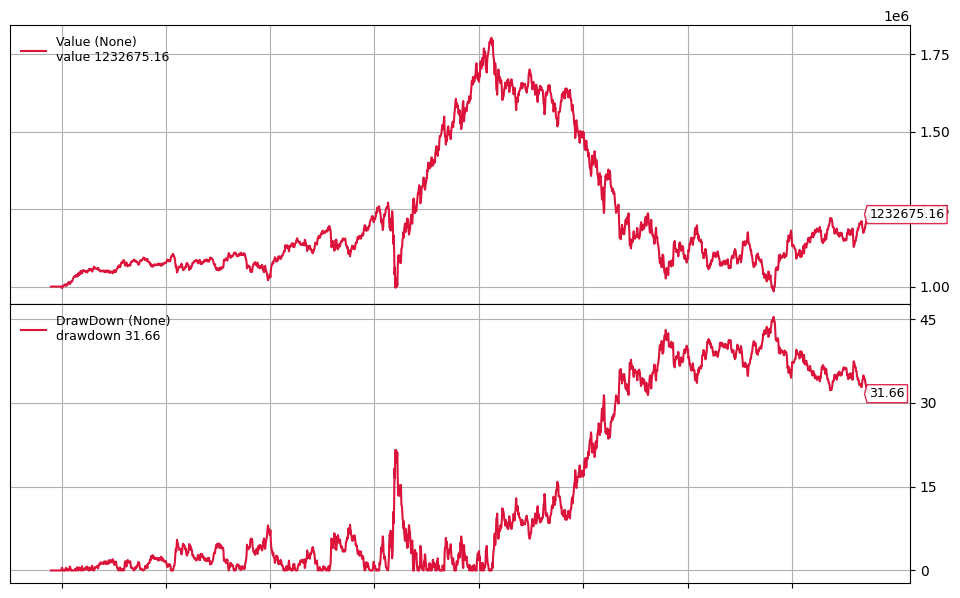



2022-01-03T00:00:00: SELL COMPLETE, 53.75


2022-01-03T00:00:00: SELL COMPLETE, 50.31
2021-04-01T00:00:00: Order Status: Margin 

2022-01-03T00:00:00: BUY COMPLETE, 157.49

2021-04-01T00:00:00: Order Status: Margin 


2021-04-01T00:00:00: Order Status: Margin 

2021-04-01T00:00:00: Order Status: Margin 

2021-04-01T00:00:00: Order Status: Margin MP> worker: Process-29 processed 45 data


 running: Process-29, (29,)
 created: Process-29:5, (29, 5)

2021-04-01T00:00:00: Order Status: Margin 
bt_worker: MaxRet,Q,MSV == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L',

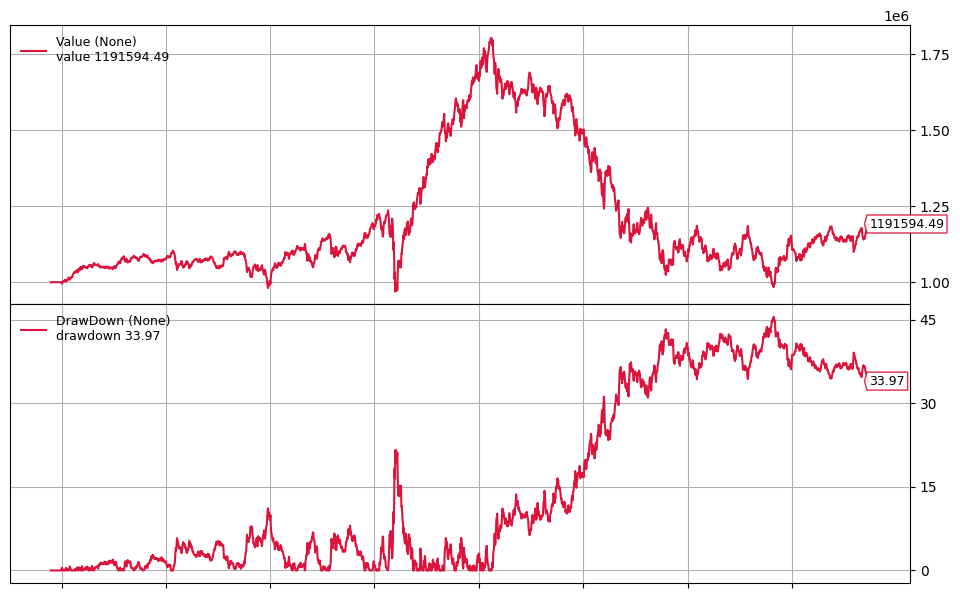



2022-01-03T00:00:00: BUY COMPLETE, 5099.32


2022-01-03T00:00:00: BUY COMPLETE, 1410.00
2021-04-01T00:00:00: Order Status: Margin 


2022-01-03T00:00:00: BUY COMPLETE, 28.93
2021-04-01T00:00:00: Order Status: Margin 

2022-10-03T00:00:00: BUY COMPLETE, 4543.60
2022-01-03T00:00:00: SELL COMPLETE, 110.40


2022-01-03T00:00:00: BUY COMPLETE, 50.27
2022-10-03T00:00:00: BUY COMPLETE, 977.86


2022-10-03T00:00:00: SELL COMPLETE, 50.40

2023-10-02T00:00:00: Order Status: Margin 
MP> worker: Process-25 processed 34 data

2021-04-01T00:00:00: Order Status: Margin 

 running: Process-25, (25,)
 created: Process-25:5, (25, 5)

bt_worker: MaxRet,Q,MAD == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD

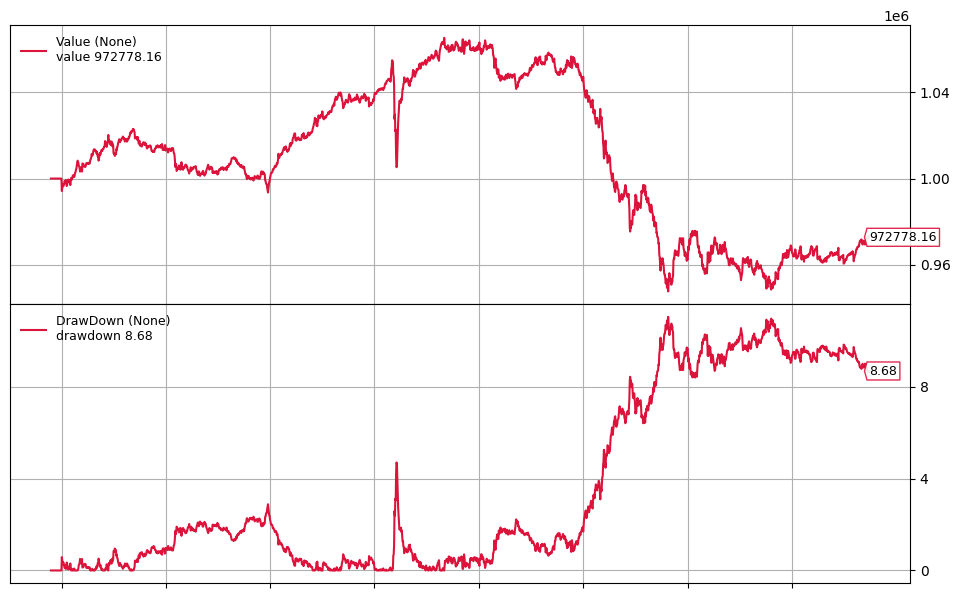

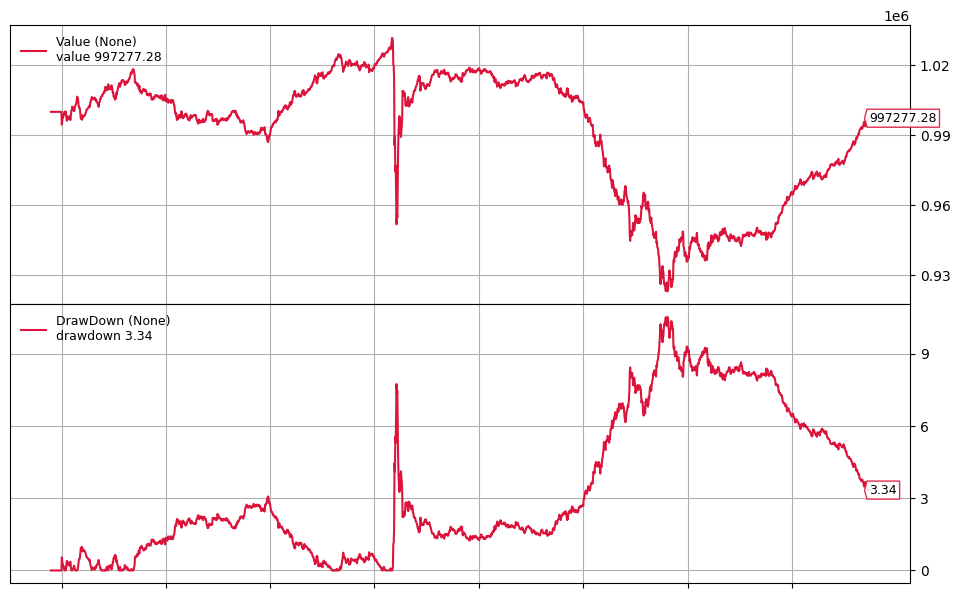


2021-04-01T00:00:00: SELL COMPLETE, 122.35

2021-04-01T00:00:00: BUY COMPLETE, 138.98

2021-04-01T00:00:00: SELL COMPLETE, 99.97

2021-04-01T00:00:00: SELL COMPLETE, 26.19

2021-04-01T00:00:00: BUY COMPLETE, 87.97

2021-04-01T00:00:00: SELL COMPLETE, 207.07MP> worker: Process-28 processed 35 data

2023-10-02T00:00:00: Order Status: Margin 

2023-10-02T00:00:00: Order Status: Margin 

2023-10-02T00:00:00: Order Status: Margin 
MP> worker: Process-16 processed 36 data

2023-10-02T00:00:00: Order Status: Margin 



2023-10-02T00:00:00: Order Status: Margin 

2023-10-02T00:00:00: Order Status: Margin  running: Process-28, (28,)
 created: Process-28:5, (28, 5)


2023-10-02T00:00:00: Order Status: Margin 

2023-10-02T00:00:00: Order Status: Margin 


bt_worker: MaxRet,Q,CVaR == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q

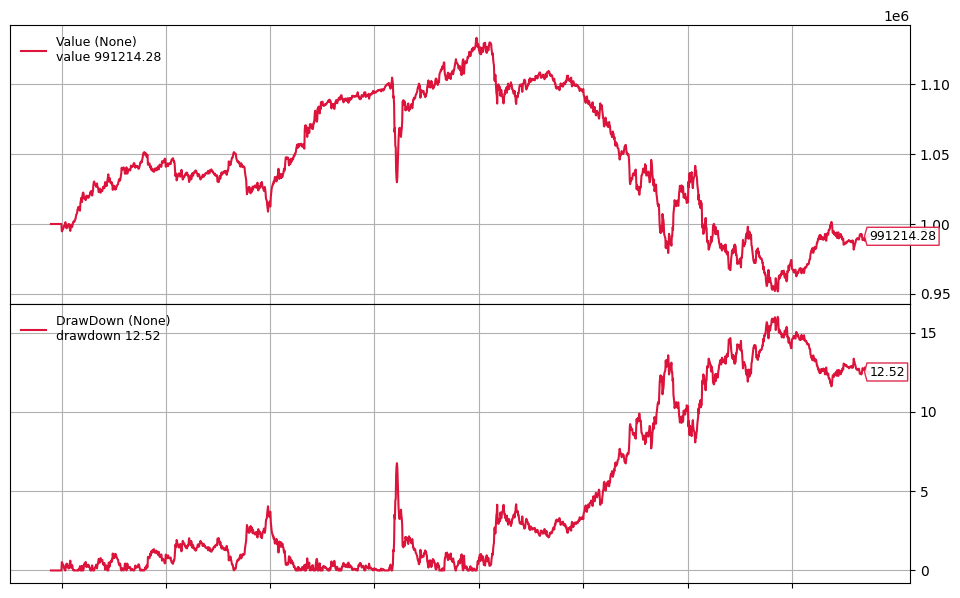


2023-01-03T00:00:00: Order Status: Margin 
MP> worker: Process-18 processed 38 data

 running: Process-18, (18,)
 created: Process-18:5, (18, 5)


2023-01-03T00:00:00: Order Status: Margin 

2023-01-03T00:00:00: Order Status: Margin 

2023-01-03T00:00:00: Order Status: Margin 

2023-01-03T00:00:00: Order Status: Margin 

2023-01-03T00:00:00: Order Status: Margin 

2023-01-03T00:00:00: Order Status: Margin 

2023-01-03T00:00:00: Order Status: Margin 

2023-01-03T00:00:00: Order Status: Margin 
bt_worker: MaxRet,S,SLPM == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.

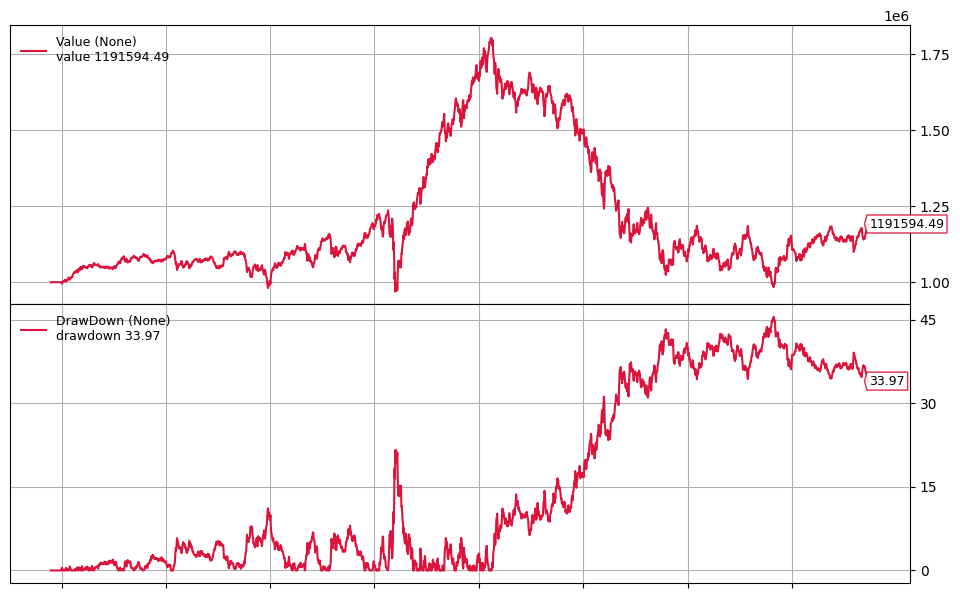



2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 

2021-10-01T00:00:00: SELL COMPLETE, 99.92
2023-04-03T00:00:00: Order Status: Margin 

2021-10-01T00:00:00: SELL COMPLETE, 26.51MP> worker: Process-30 processed 39 data




2023-04-03T00:00:00: Order Status: Margin  running: Process-30, (30,)
 created: Process-30:5, (30, 5)



2023-04-03T00:00:00: Order Status: Margin 

2023-04-03T00:00:00: Order Status: Margin 

2023-04-03T00:00:00: Order Status: Margin 
bt_worker: MinRisk,Q,SLPM == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L'

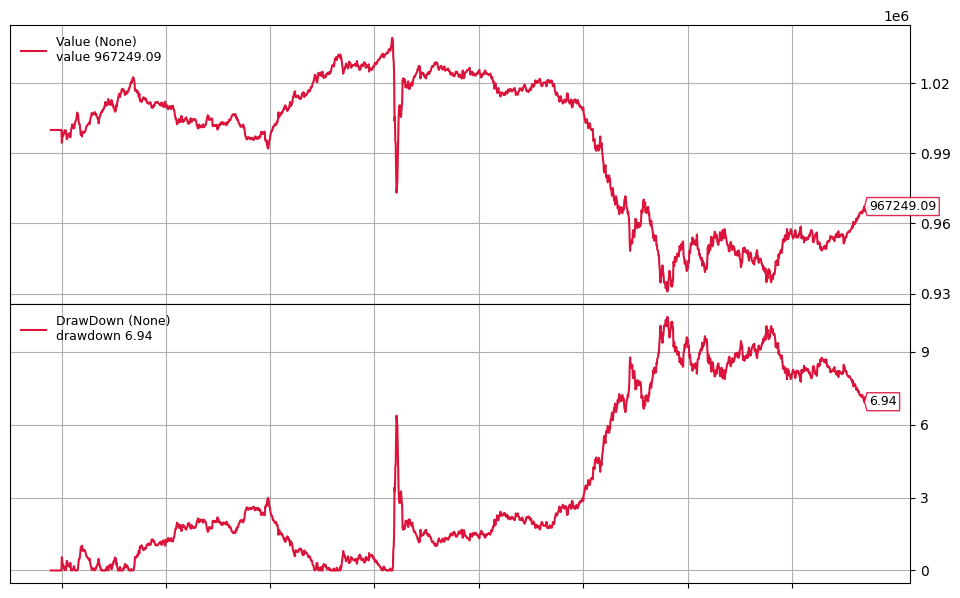



2024-01-02T00:00:00: Order Status: Margin MP> worker: Process-20 processed 37 data

 running: Process-20, (20,)
 created: Process-20:5, (20, 5)

bt_worker: MinRisk,Q,ADD == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-20

bt_worker: MinRisk,Q,ADD == 0/57 Process-20



2023-01-03T00:00:00: Order Status: Margin 
2024-01-02T00:00:00: Order Status: Margin backtest:  start=1004 - end=3029




2024-01-02T00:00:00: Order Status: Margin 
2023-01-03T00:

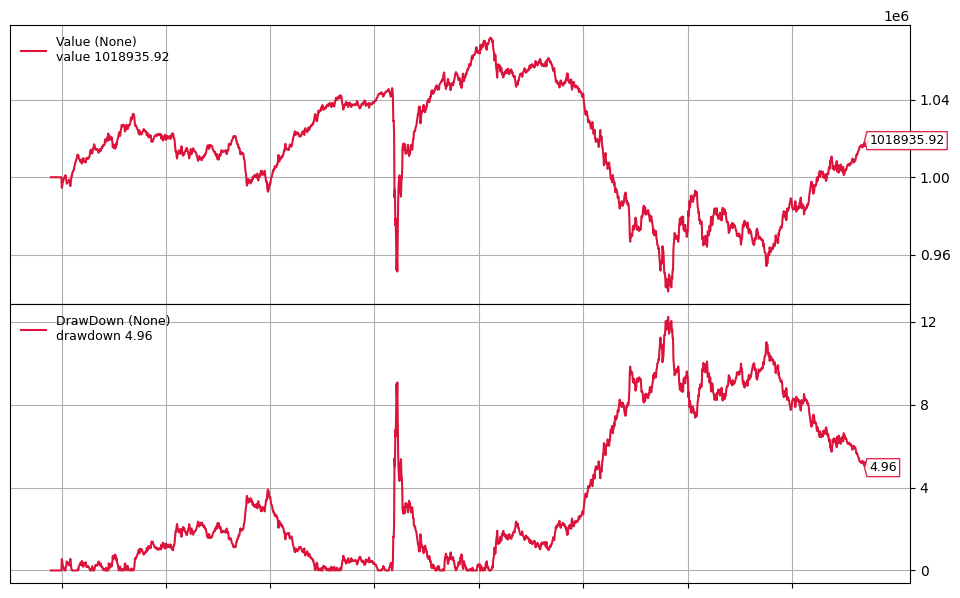

MP> worker: Process-17 processed 42 data

 running: Process-17, (17,)
 created: Process-17:5, (17, 5)

bt_worker: MaxRet,S,UCI == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-17


2023-10-02T00:00:00: Order Status: Margin 
bt_worker: MaxRet,S,UCI == 0/58 Process-17

2023-10-02T00:00:00: Order Status: Margin 


2023-10-02T00:00:00: Order Status: Margin backtest:  start=1004 - end=3029


2023-10-02T00:00:00: Order Status: Margin 

2023-10-02T00:00:

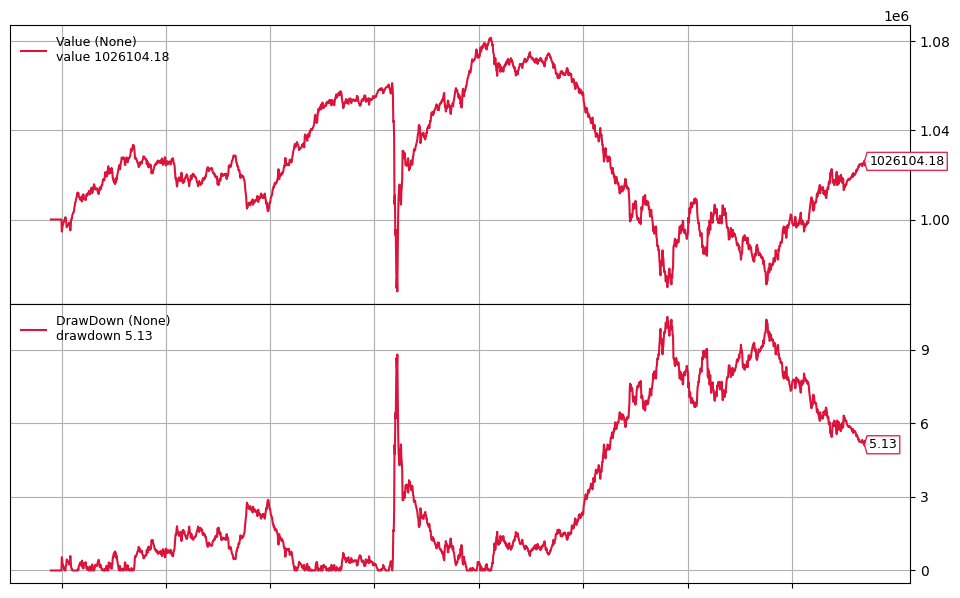

MP> worker: Process-26 processed 43 data

 running: Process-26, (26,)
 created: Process-26:5, (26, 5)

bt_worker: MinRisk,Q,MV == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-26

bt_worker: MinRisk,Q,MV == 0/59 Process-26

backtest:  start=1004 - end=3029


2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00

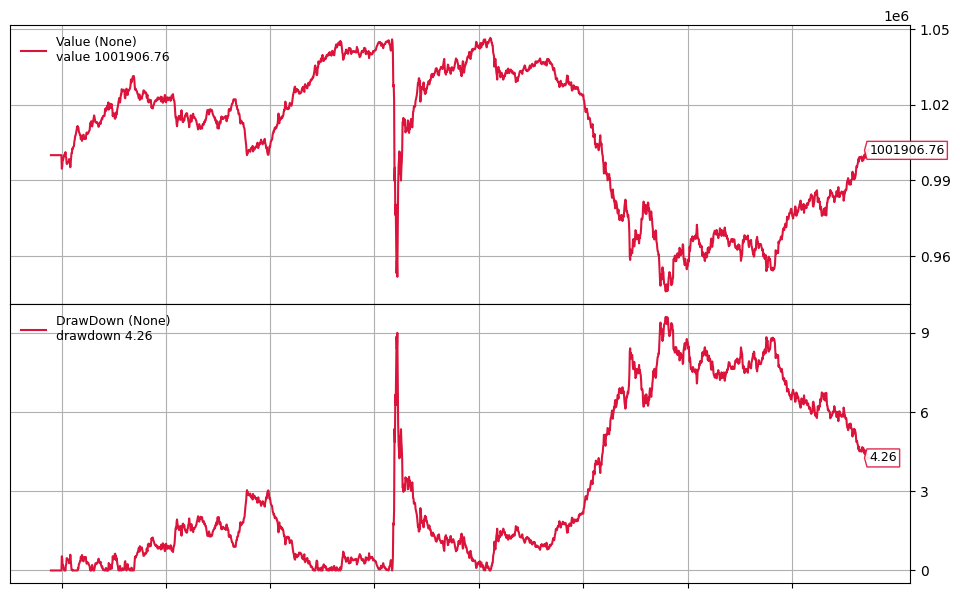

MP> worker: Process-22 processed 44 data

 running: Process-22, (22,)
 created: Process-22:5, (22, 5)

bt_worker: Sharpe,Q,WR == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-22

bt_worker: Sharpe,Q,WR == 0/60 Process-22

backtest:  start=1004 - end=3029

MP> received data 44
length of datas: 55
init(key: assets)
init(N/A) _assets(55): ['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000

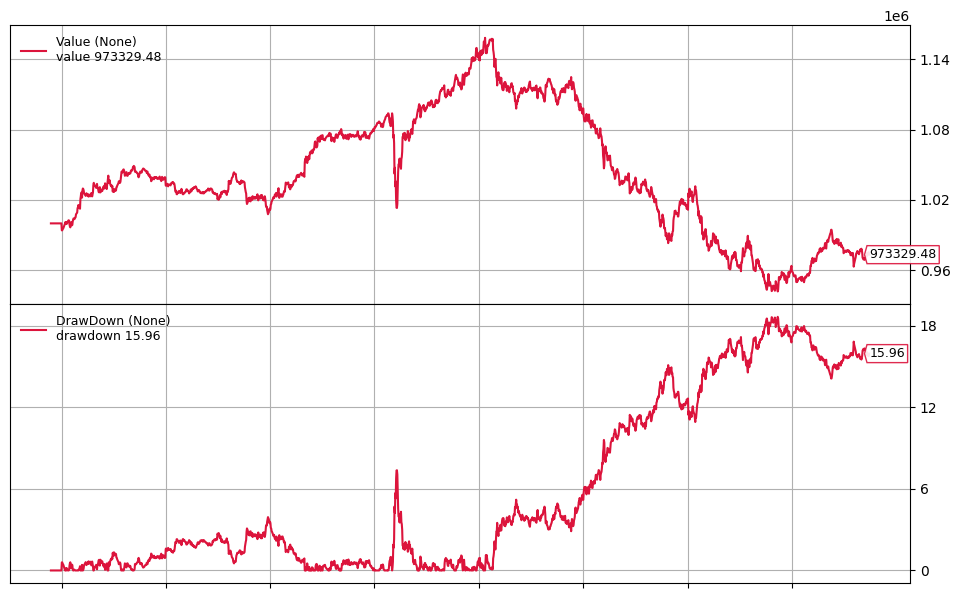



2020-10-01T00:00:00: SELL COMPLETE, 293.78

2020-10-01T00:00:00: BUY COMPLETE, 179.50

2020-10-01T00:00:00: BUY COMPLETE, 6.12MP> worker: Process-19 processed 47 data



2020-10-01T00:00:00: BUY COMPLETE, 113.40 running: Process-19, (19,)
 created: Process-19:6, (19, 6)


2020-10-01T00:00:00: BUY COMPLETE, 3943.62
2019-01-02T00:00:00: Order Status: Margin 



2019-01-02T00:00:00: Order Status: Margin 
2020-10-01T00:00:00: SELL COMPLETE, 1721.50

2019-01-02T00:00:00: Order Status: Margin bt_worker: MinRisk,S,CDaR == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 

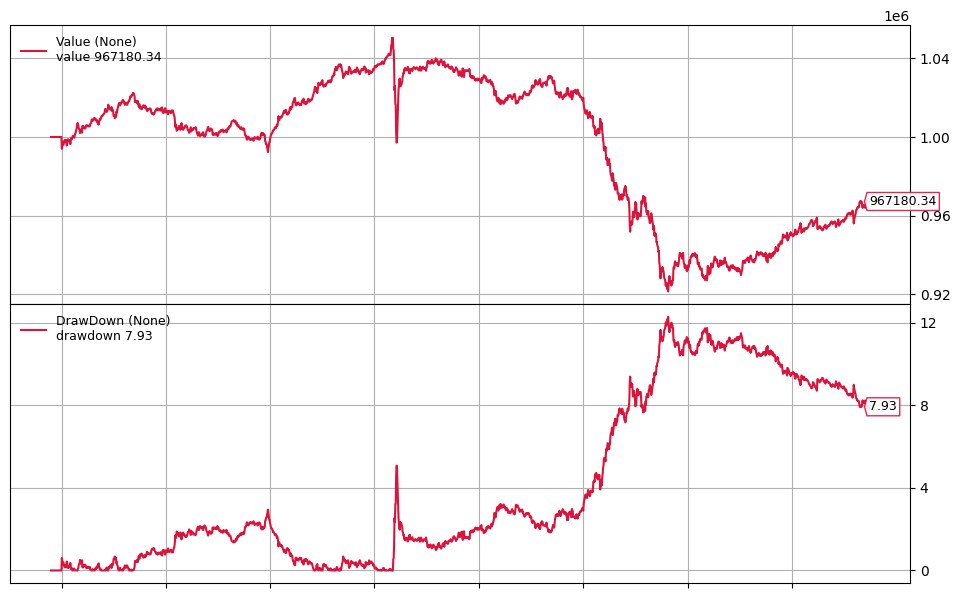


2021-07-01T00:00:00: SELL COMPLETE, 4647.00

2021-07-01T00:00:00: BUY COMPLETE, 1579.99

2024-01-02T00:00:00: Order Status: Margin 
MP> worker: Process-27 processed 48 data

2024-01-02T00:00:00: Order Status: Margin 
 running: Process-27, (27,)
 created: Process-27:6, (27, 6)


2024-01-02T00:00:00: Order Status: Margin 

2024-01-02T00:00:00: Order Status: Margin 

2024-01-02T00:00:00: Order Status: Margin 

2019-01-02T00:00:00: Order Status: Margin 
bt_worker: Sharpe,S,ADD == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.M

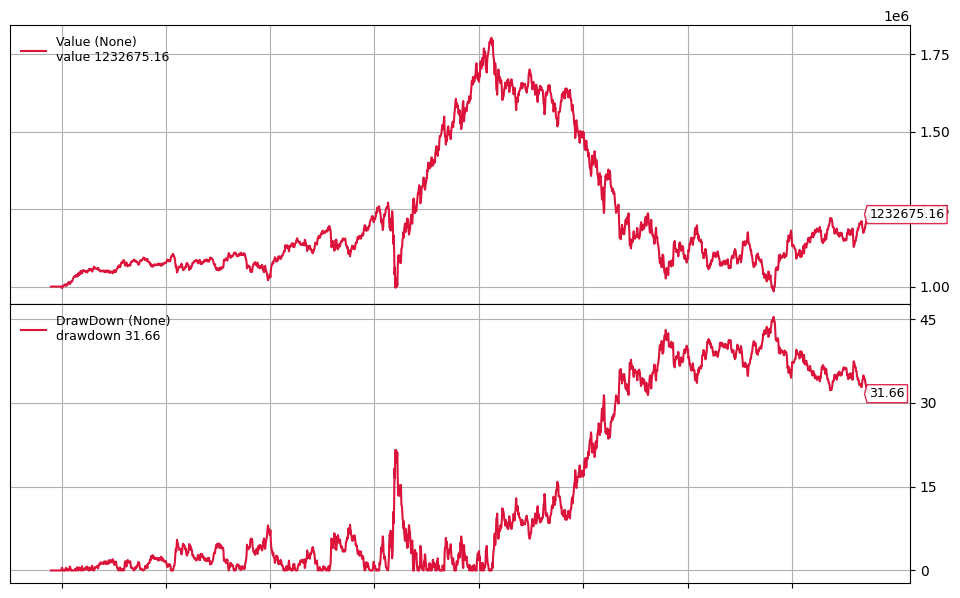



2017-10-02T00:00:00: Order Status: Margin 

2017-01-03T00:00:00: Order Status: Margin init>> assets[17]-3175.HK in weights

2017-01-03T00:00:00: BUY COMPLETE, 25.28

MP> worker: Process-24 processed 49 data

2017-10-02T00:00:00: Order Status: Margin 

2017-10-02T00:00:00: Order Status: Margin init>> assets[18]-3187.HK in weights

2020-01-02T00:00:00: SELL COMPLETE, 33.83
2021-01-04T00:00:00: SELL COMPLETE, 182.86


2019-01-02T00:00:00: Order Status: Margin  running: Process-24, (24,)
 created: Process-24:6, (24, 6)

2020-01-02T00:00:00: SELL COMPLETE, 50.39


2021-01-04T00:00:00: SELL COMPLETE, 93.73

2019-01-02T00:00:00: Order Status: Margin 
2020-01-02T00:00:00: SELL COMPLETE, 216.54


bt_worker: MinRisk,Q,MSV == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.H

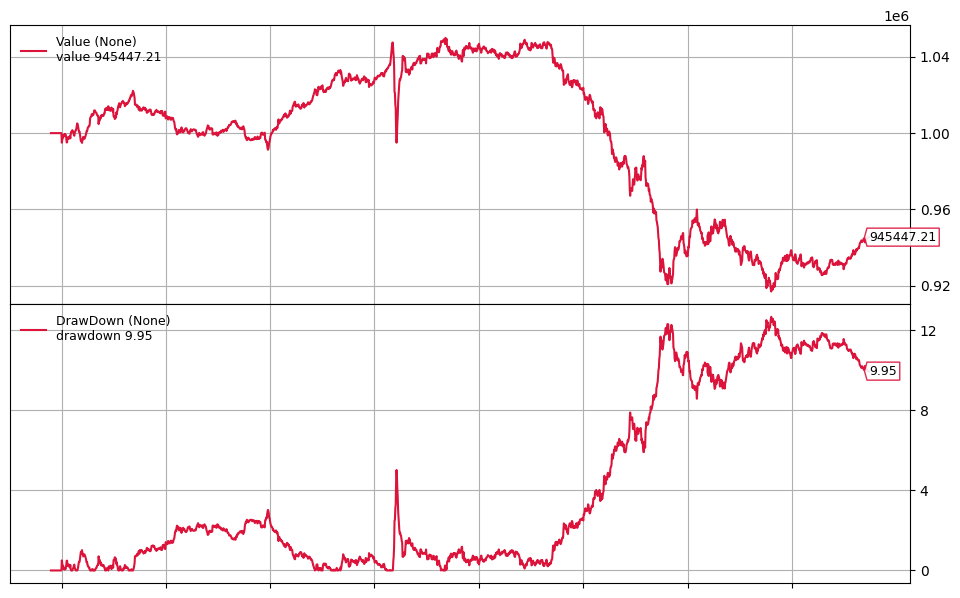


2020-01-02T00:00:00: SELL COMPLETE, 50.39
2019-04-01T00:00:00: SELL COMPLETE, 10.37


2020-01-02T00:00:00: SELL COMPLETE, 216.54
2019-04-01T00:00:00: SELL COMPLETE, 122.52



2019-04-01T00:00:00: SELL COMPLETE, 33.08
2020-01-02T00:00:00: BUY COMPLETE, 700.99


MP> worker: Process-21 processed 46 data


2018-04-02T00:00:00: SELL COMPLETE, 51.80
 running: Process-21, (21,)
 created: Process-21:6, (21, 6)

2018-04-02T00:00:00: BUY COMPLETE, 49.32bt_worker: MinRisk,S,UCI == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'L

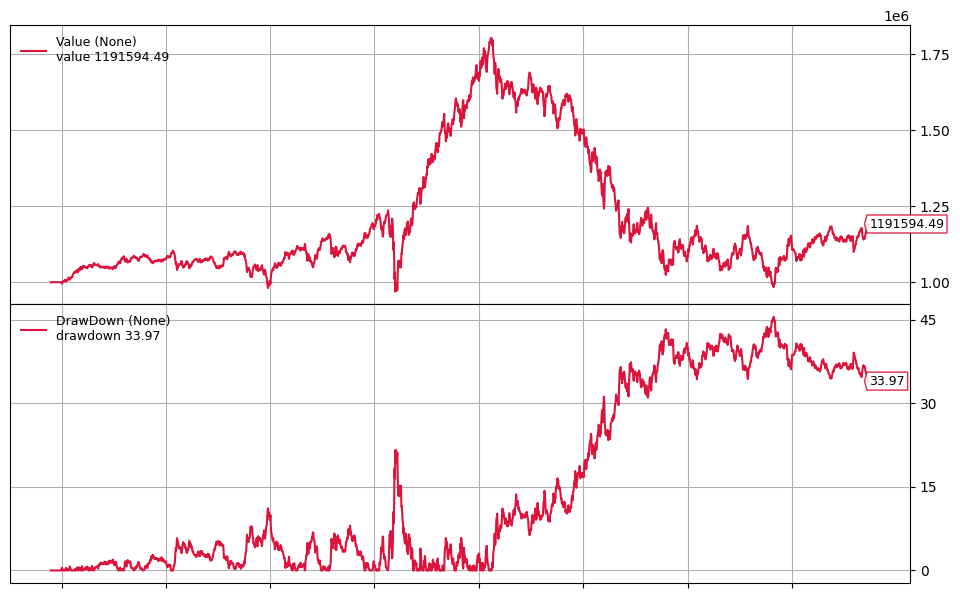


2021-10-01T00:00:00: SELL COMPLETE, 66.51
2017-07-03T00:00:00: SELL COMPLETE, 25.16
2020-04-01T00:00:00: SELL COMPLETE, 26.42

2017-07-03T00:00:00: SELL COMPLETE, 98.77


MP> worker: Process-25 processed 52 data


2020-04-01T00:00:00: SELL COMPLETE, 110.83
2021-10-01T00:00:00: SELL COMPLETE, 45.27

2021-10-01T00:00:00: SELL COMPLETE, 145.48

2021-10-01T00:00:00: SELL COMPLETE, 4691.15

2021-10-01T00:00:00: SELL COMPLETE, 1436.78
 running: Process-25, (25,)
 created: Process-25:6, (25, 6)


2020-04-01T00:00:00: BUY COMPLETE, 50.31

bt_worker: MinRisk,Q,FLPM == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDT

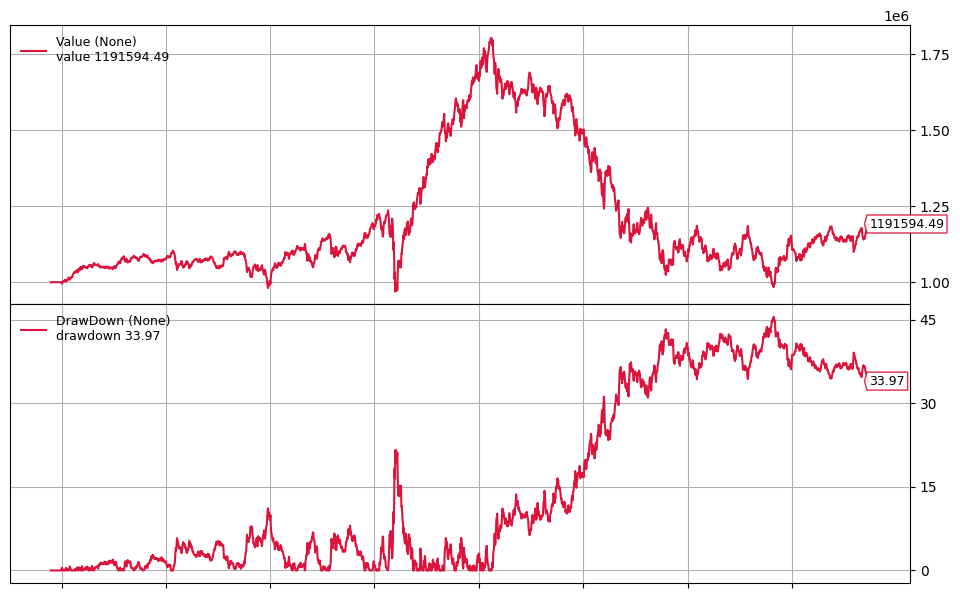



2024-07-01T00:00:00: SELL COMPLETE, 181.63

2024-07-01T00:00:00: SELL COMPLETE, 5897.00

2024-07-01T00:00:00: SELL COMPLETE, 36.88
MP> worker: Process-23 processed 50 data

 running: Process-23, (23,)
 created: Process-23:6, (23, 6)

2021-04-01T00:00:00: Order Status: Margin 


2021-04-01T00:00:00: Order Status: Margin bt_worker: Sharpe,S,MV == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-23

bt_worker: Sharpe,S,MV == 0/66 Process-23


backtest

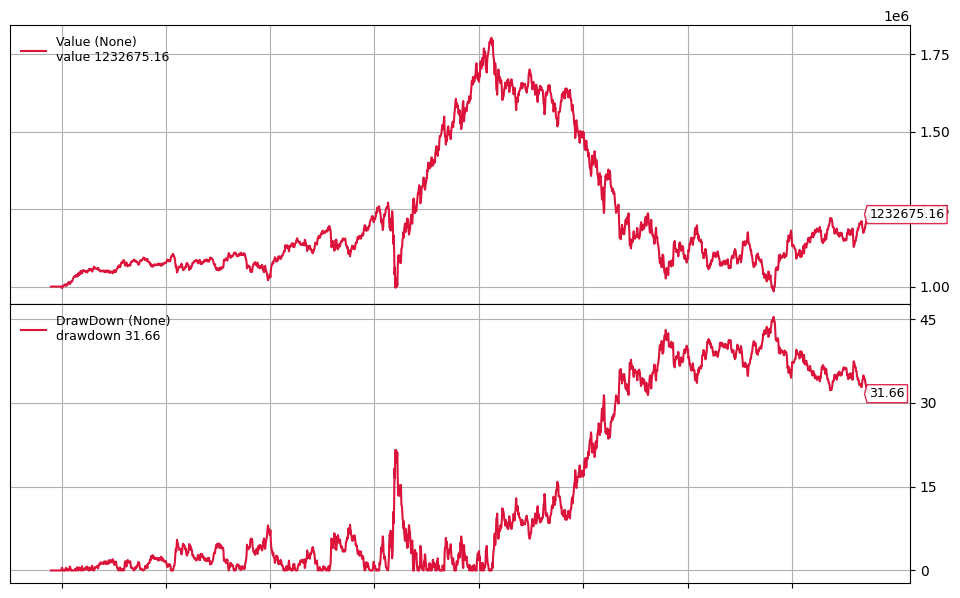




2021-04-01T00:00:00: BUY COMPLETE, 5.11
2017-07-03T00:00:00: BUY COMPLETE, 4.83
2021-10-01T00:00:00: BUY COMPLETE, 51.06

2018-10-01T00:00:00: Order Status: Margin 
MP> worker: Process-16 processed 54 data


2017-07-03T00:00:00: SELL COMPLETE, 4.50


2021-04-01T00:00:00: BUY COMPLETE, 138.98
2018-10-01T00:00:00: SELL COMPLETE, 18.07
 running: Process-16, (16,)
 created: Process-16:6, (16, 6)



2017-07-03T00:00:00: BUY COMPLETE, 10.25

2018-10-01T00:00:00: BUY COMPLETE, 5.09
2023-01-03T00:00:00: Order Status: Margin 
2021-04-01T00:00:00: SELL COMPLETE, 99.97

2017-07-03T00:00:00: SELL COMPLETE, 95.84
bt_worker: MinRisk,S,CVaR == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'H

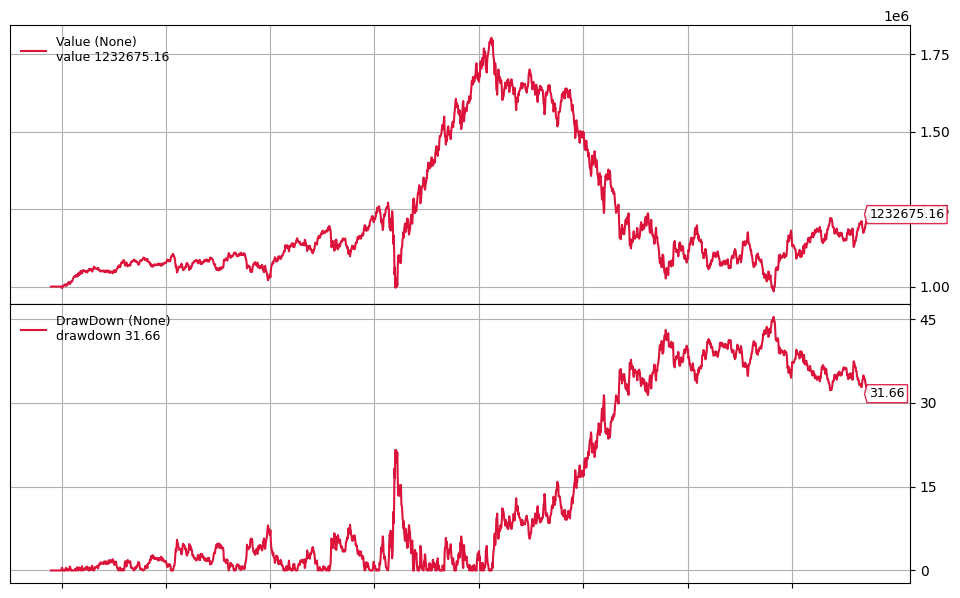



2018-04-02T00:00:00: SELL COMPLETE, 100.25

2022-01-03T00:00:00: Order Status: Margin 
2018-04-02T00:00:00: SELL COMPLETE, 108.54


2018-04-02T00:00:00: BUY COMPLETE, 3122.53
2022-01-03T00:00:00: Order Status: Margin 


2022-01-03T00:00:00: Order Status: Margin 

2018-04-02T00:00:00: SELL COMPLETE, 111.62MP> worker: Process-18 processed 55 data



2022-01-03T00:00:00: Order Status: Margin  running: Process-18, (18,)
 created: Process-18:6, (18, 6)

2018-04-02T00:00:00: SELL COMPLETE, 110.23



2022-01-03T00:00:00: Order Status: Margin 


2022-01-03T00:00:00: Order Status: Margin 
2022-07-01T00:00:00: SELL COMPLETE, 98.78

2018-04-02T00:00:00: BUY COMPLETE, 50.23
2022-01-03T00:00:00: Order Status: Margin 

2022-07-01T00:00:00: BUY COMPLETE, 167.98


2022-07-01T00:00:00: SELL COMPLETE, 24.00

2022-07-01T00:00:00: SELL COMPLETE, 79.33

2022-07-01T00:00:00: SELL COMPLETE, 50.05bt_worker: MaxRet,Q,EVaR == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P0

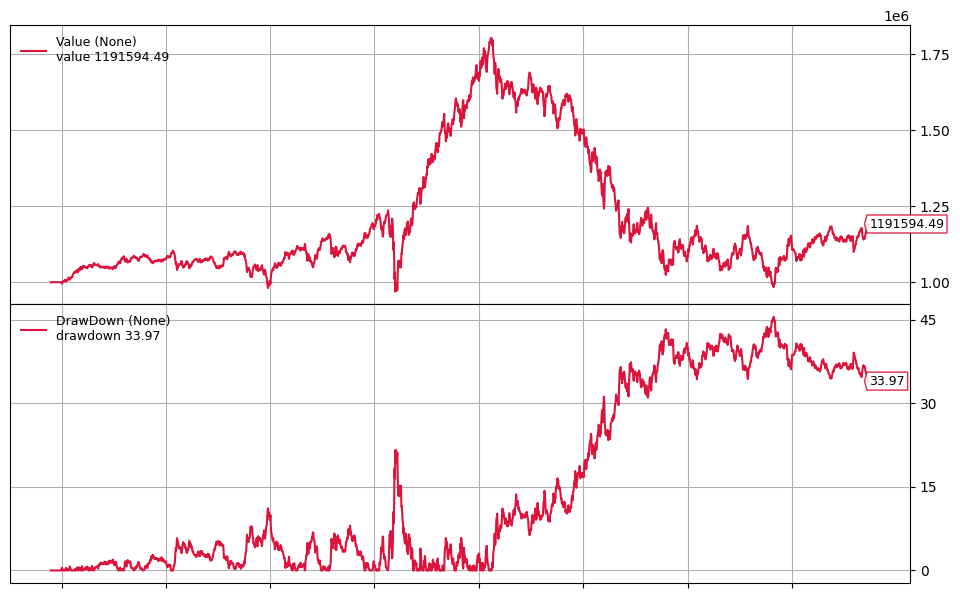


2022-10-03T00:00:00: Order Status: Margin 

2022-10-03T00:00:00: Order Status: Margin 

2022-10-03T00:00:00: SELL COMPLETE, 4.03


2022-10-03T00:00:00: BUY COMPLETE, 6.55

2022-10-03T00:00:00: BUY COMPLETE, 124.64
2018-07-02T00:00:00: Order Status: Margin 


2018-07-02T00:00:00: Order Status: Margin MP> received data 55

2022-10-03T00:00:00: SELL COMPLETE, 99.37

2019-10-01T00:00:00: Order Status: Margin 

2022-10-03T00:00:00: SELL COMPLETE, 155.23

2019-10-01T00:00:00: BUY COMPLETE, 4.99

2019-10-01T00:00:00: BUY COMPLETE, 3.87

2018-07-02T00:00:00: Order Status: Margin 

2019-10-01T00:00:00: SELL COMPLETE, 132.34
2018-07-02T00:00:00: Order Status: Margin 


2019-10-01T00:00:00: SELL COMPLETE, 100.91
2018-07-02T00:00:00: Order Status: Margin 

2019-10-01T00:00:00: SELL COMPLETE, 26.18

2019-10-01T00:00:00: BUY COMPLETE, 87.96


2019-10-01T00:00:00: SELL COMPLETE, 29.52
2018-07-02T00:00:00: Order Status: Margin 


2019-10-01T00:00:00: BUY COMPLETE, 132.08
2024-04-01T00:00:00: Order St

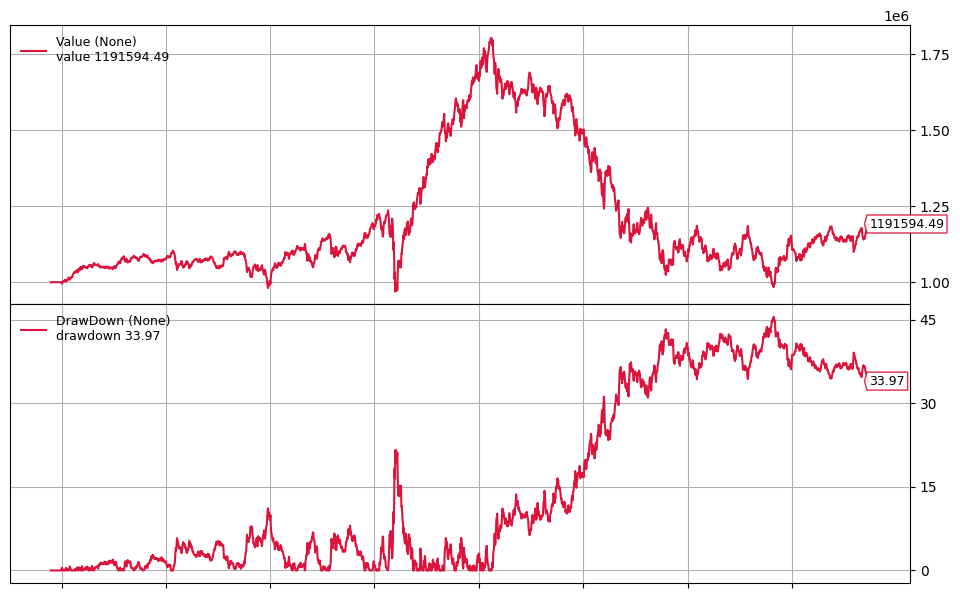


2020-10-01T00:00:00: Order Status: Margin 

MP> worker: Process-28 processed 53 data

2020-10-01T00:00:00: Order Status: Margin 

2023-10-02T00:00:00: BUY COMPLETE, 49.64
2020-10-01T00:00:00: Order Status: Margin 



2020-10-01T00:00:00: Order Status: Margin 
2023-10-02T00:00:00: SELL COMPLETE, 45.57

2023-10-02T00:00:00: BUY COMPLETE, 46.19

2020-10-01T00:00:00: SELL COMPLETE, 15.90 running: Process-28, (28,)
 created: Process-28:6, (28, 6)

bt_worker: MinRisk,S,EDaR == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', '

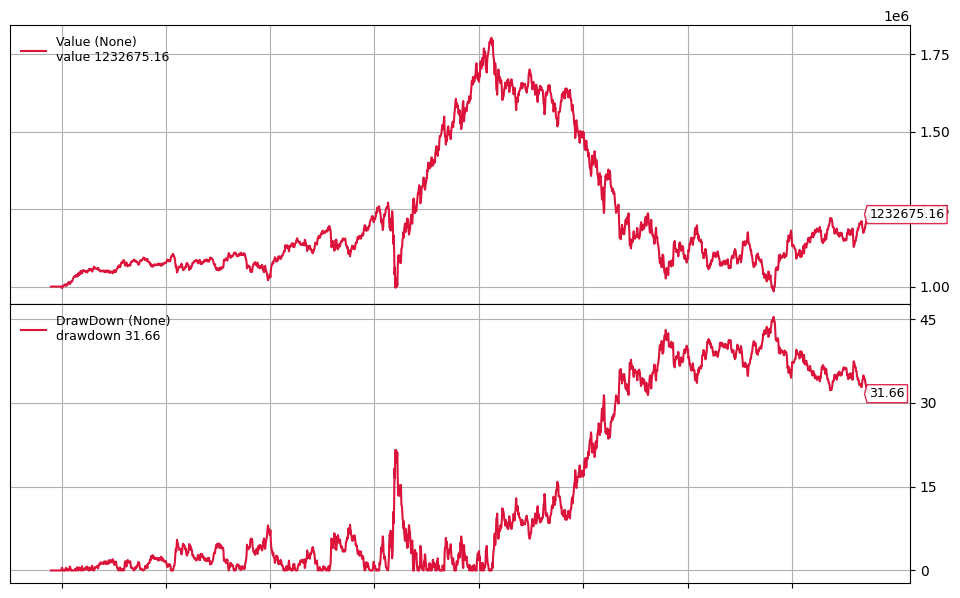


2023-10-02T00:00:00: Order Status: Margin 

2023-10-02T00:00:00: Order Status: Margin 

2023-10-02T00:00:00: Order Status: Margin 
MP> worker: Process-17 processed 58 data

 running: Process-17, (17,)
 created: Process-17:6, (17, 6)

bt_worker: MaxRet,Q,CDaR == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-17

bt_worker: MaxRet,Q,CDaR == 0/71 Process-17

2023-10-02T00:00:00: Order Status: Margin 


2024-07-01T00:00:00: SELL COMPLETE, 51.00
backte

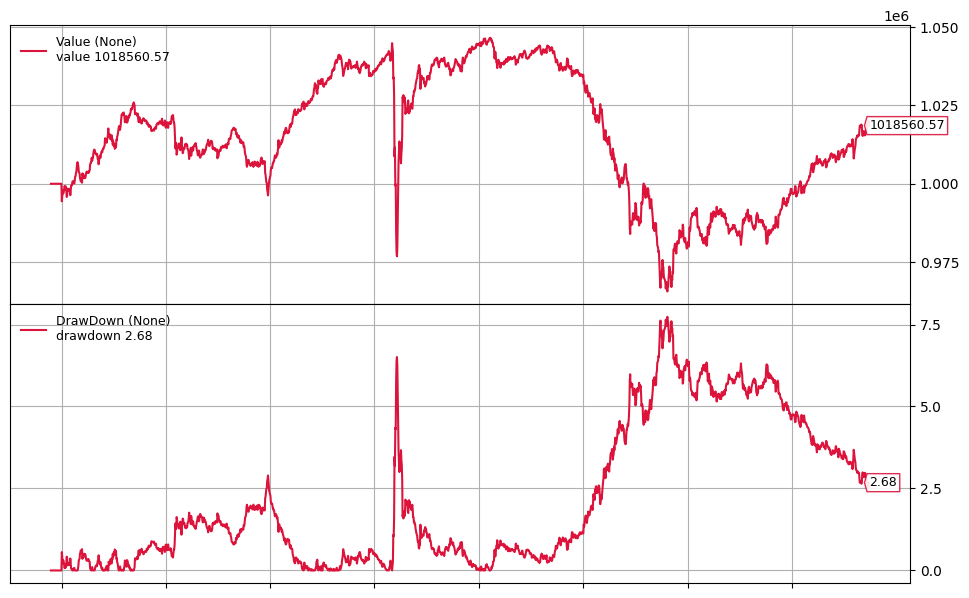



2022-04-01T00:00:00: Order Status: Margin MP> worker: Process-20 processed 57 data


2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status: Margin 


2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: SELL COMPLETE, 12.82

2022-04-01T00:00:00: SELL COMPLETE, 3.36

2022-04-01T00:00:00: SELL COMPLETE, 2.80

2022-04-01T00:00:00: SELL COMPLETE, 4.75

2022-04-01T00:00:00: BUY COMPLETE, 7.27

2020-10-01T00:00:00: Order Status: Margin 
 running: Process-20, (20,)
 created: Proce

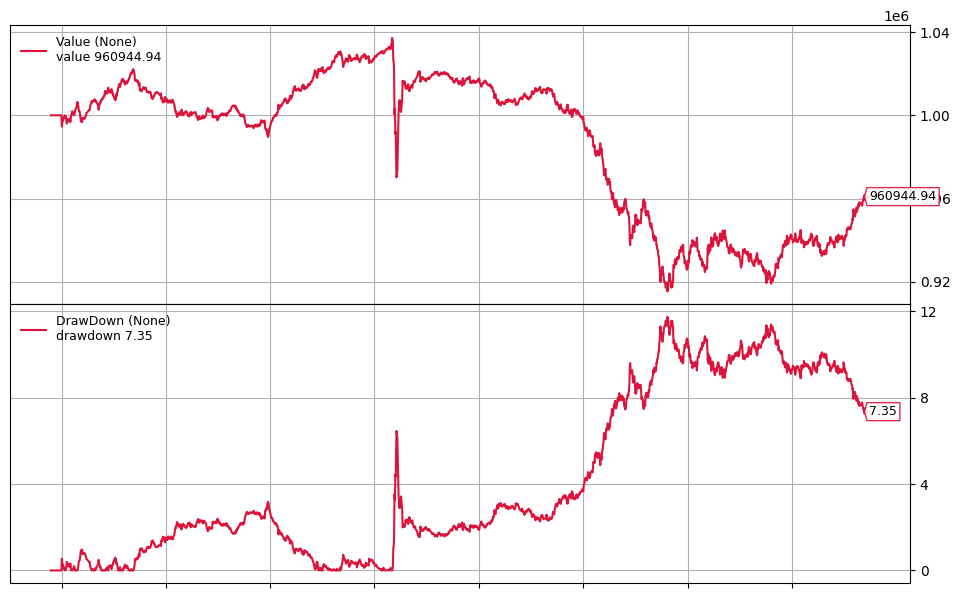


2022-10-03T00:00:00: Order Status: Margin 
MP> worker: Process-30 processed 56 data


2021-07-01T00:00:00: Order Status: Margin 
 running: Process-30, (30,)
 created: Process-30:6, (30, 6)


2022-10-03T00:00:00: Order Status: Margin 
2021-07-01T00:00:00: Order Status: Margin 

2021-07-01T00:00:00: Order Status: Margin 
bt_worker: Sharpe,Q,CVaR == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-30


2021-07-01T00:00:00: Order Status: Margin 

bt_wor

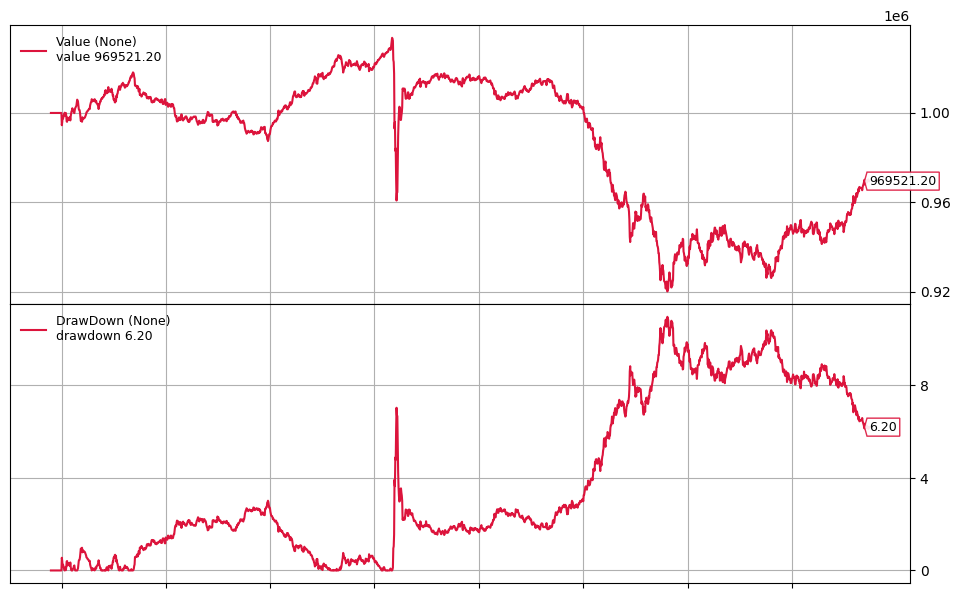

MP> worker: Process-26 processed 59 data

 running: Process-26, (26,)
 created: Process-26:6, (26, 6)

bt_worker: MinRisk,Q,CDaR == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-26

bt_worker: MinRisk,Q,CDaR == 0/74 Process-26

backtest:  start=1004 - end=3029

backtest.plot: 1004-3029
MP> received data 59


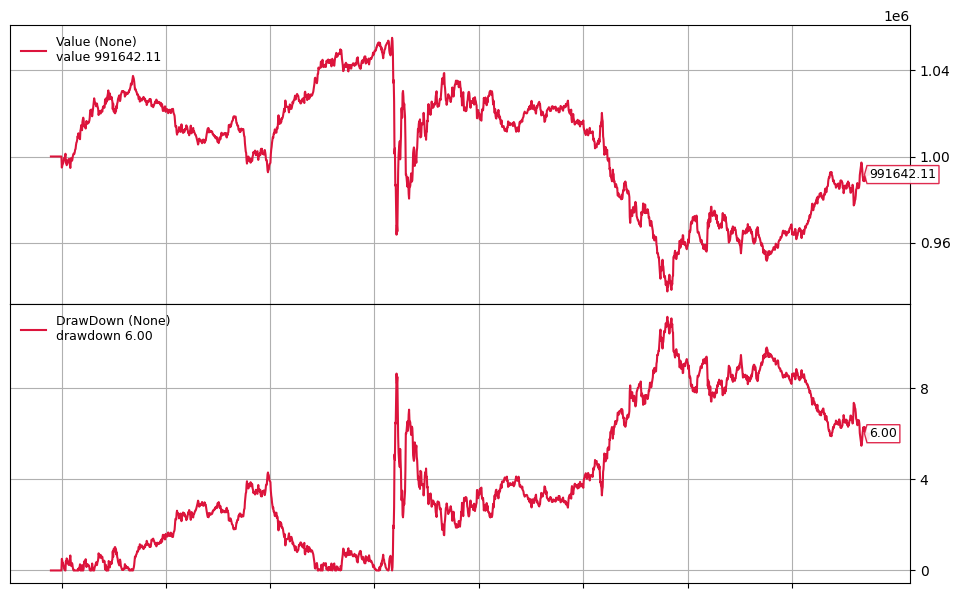

MP> worker: Process-22 processed 60 data

 running: Process-22, (22,)
 created: Process-22:6, (22, 6)

bt_worker: Sharpe,S,EDaR == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-22

bt_worker: Sharpe,S,EDaR == 0/75 Process-22

backtest:  start=1004 - end=3029

MP> received data 60
length of datas: 55
init(key: assets)length of datas: 55
init(N/A) _assets(55): ['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0'

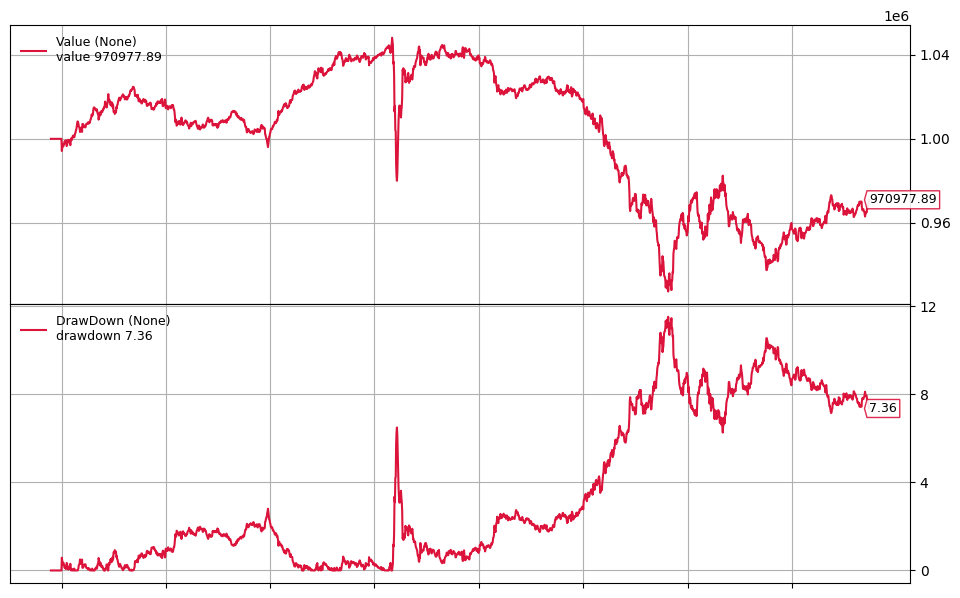




init>> assets[42]-ISAG.L in weights
init>> assets[43]-ISTB in weights
init>> assets[44]-IVE in weights
init>> assets[45]-IWRD.L in weights
init>> assets[46]-JDN.MX in weightsinit>> assets[39]-IGIL.L in weights
init>> assets[47]-LQDE.L in weights
init>> assets[48]-METV in weights
init>> assets[49]-PAVE in weights
init>> assets[50]-SDHY.L in weightsMP> worker: Process-19 processed 61 data

init>> assets[51]-SHV in weights


2021-01-04T00:00:00: BUY COMPLETE, 100.01
 running: Process-19, (19,)
 created: Process-19:7, (19, 7)

2021-01-04T00:00:00: BUY COMPLETE, 27.40

2021-01-04T00:00:00: SELL COMPLETE, 86.01


2021-01-04T00:00:00: SELL COMPLETE, 56.11


2021-01-04T00:00:00: BUY COMPLETE, 134.70bt_worker: Sharpe,Q,EDaR == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '99

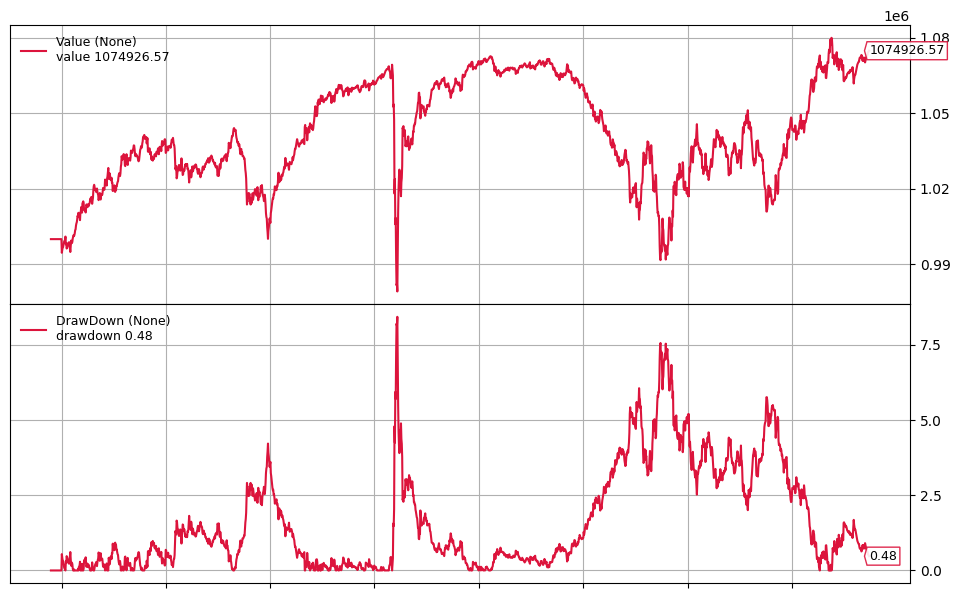


2022-01-03T00:00:00: Order Status: Margin 

2022-01-03T00:00:00: Order Status: Margin 
MP> worker: Process-27 processed 62 data

2022-01-03T00:00:00: Order Status: Margin 


 running: Process-27, (27,)
 created: Process-27:7, (27, 7)

bt_worker: Sharpe,S,EVaR == weight.length:16,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-27


2017-07-03T00:00:00: BUY COMPLETE, 28.41bt_worker: Sharpe,S,EVaR == 0/77 Process-27

backtest:  start=1004 - end=3029


2022-01-03T00:00

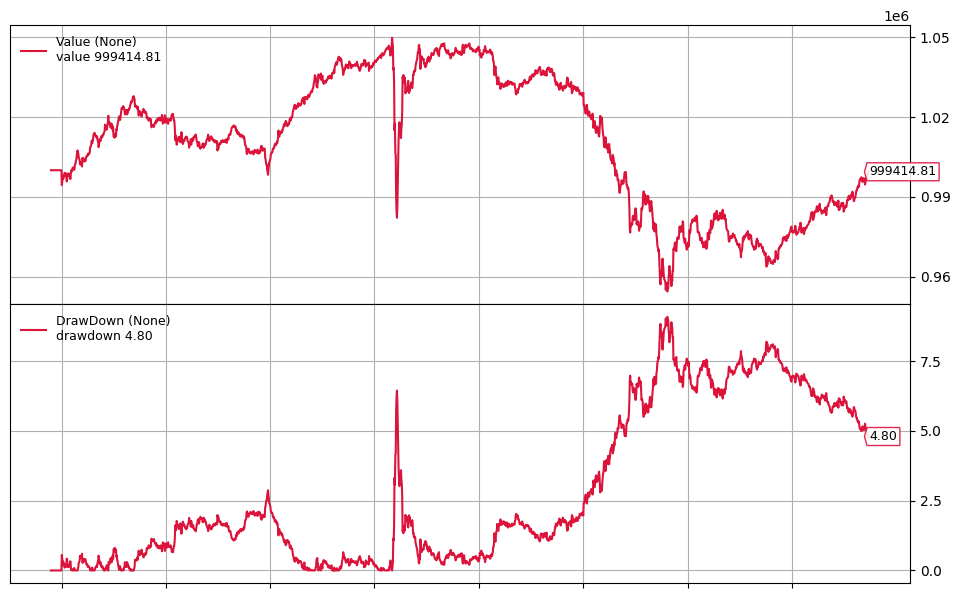


2023-01-03T00:00:00: Order Status: Margin 

2024-07-01T00:00:00: Order Status: Margin MP> worker: Process-21 processed 64 data


2023-01-03T00:00:00: Order Status: Margin 

 running: Process-21, (21,)
 created: Process-21:7, (21, 7)

2023-01-03T00:00:00: Order Status: Margin 

2024-07-01T00:00:00: Order Status: Margin 

2023-01-03T00:00:00: Order Status: Margin 

bt_worker: Sharpe,Q,EVaR == weight.length:32,,['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']  Process-21

2023-0

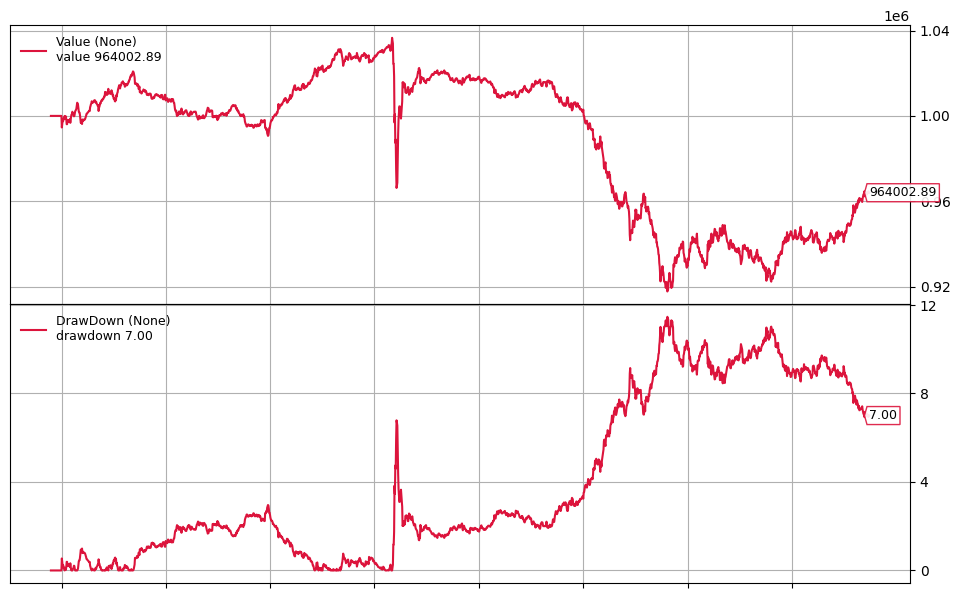


2019-04-01T00:00:00: BUY COMPLETE, 127.46

2019-04-01T00:00:00: BUY COMPLETE, 100.90

2019-04-01T00:00:00: BUY COMPLETE, 25.13MP> worker: Process-24 processed 63 data


MP> worker: Process-24 existed. 78 data processed

2019-04-01T00:00:00: BUY COMPLETE, 131.38


2019-04-01T00:00:00: BUY COMPLETE, 196.73

2019-04-01T00:00:00: BUY COMPLETE, 52.66

2019-04-01T00:00:00: BUY COMPLETE, 49.73

2019-04-01T00:00:00: BUY COMPLETE, 3467.00

2019-04-01T00:00:00: BUY COMPLETE, 607.50

2019-04-01T00:00:00: SELL COMPLETE, 93.16

2019-04-01T00:00:00: BUY COMPLETE, 110.37

2019-04-01T00:00:00: BUY COMPLETE, 50.27

2021-07-01T00:00:00: Order Status: Margin 

2021-07-01T00:00:00: Order Status: Margin 

2021-07-01T00:00:00: Order Status: Margin 

2021-07-01T00:00:00: BUY COMPLETE, 2.93

2021-07-01T00:00:00: BUY COMPLETE, 5.16

2024-01-02T00:00:00: Order Status: Margin 
2021-07-01T00:00:00: SELL COMPLETE, 139.68

2021-07-01T00:00:00: BUY COMPLETE, 99.93

2021-07-01T00:00:00: SELL COMPLETE, 26.50

2021-07

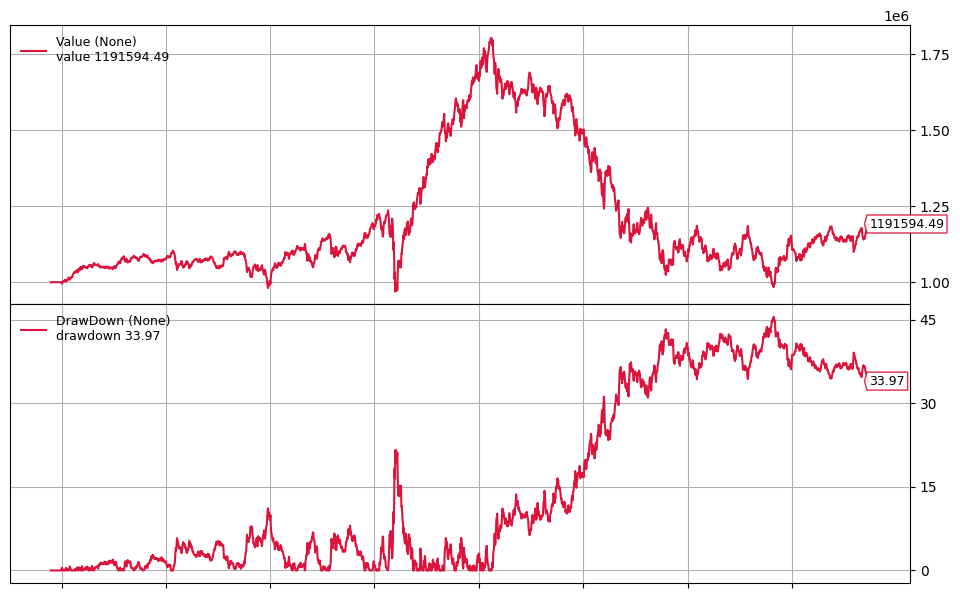


2024-01-02T00:00:00: Order Status: Margin 

MP> worker: Process-18 processed 68 data

MP> worker: Process-18 existed. 78 data processed




2019-04-01T00:00:00: BUY COMPLETE, 52.66
2024-01-02T00:00:00: BUY COMPLETE, 191.89


2019-04-01T00:00:00: BUY COMPLETE, 49.73
2024-01-02T00:00:00: BUY COMPLETE, 128.54


2019-04-01T00:00:00: SELL COMPLETE, 3449.00
2024-01-02T00:00:00: BUY COMPLETE, 51.18

2019-04-01T00:00:00: BUY COMPLETE, 607.50

2024-01-02T00:00:00: SELL COMPLETE, 47.43

2019-04-01T00:00:00: BUY COMPLETE, 93.65
2018-07-02T00:00:00: Order Status: Margin 



2019-04-01T00:00:00: BUY COMPLETE, 110.37
2018-07-02T00:00:00: BUY COMPLETE, 5.26


2019-04-01T00:00:00: Order Status: Margin 
2018-07-02T00:00:00: SELL COMPLETE, 4.78

2022-07-01T00:00:00: Order Status: Margin 

2019-01-02T00:00:00: Order Status: Margin 

2022-07-01T00:00:00: Order Status: Margin 
2024-01-02T00:00:00: SELL COMPLETE, 467.65
2019-01-02T00:00:00: Order Status: Margin 




2018-07-02T00:00:00: BUY COMPLETE, 107.2

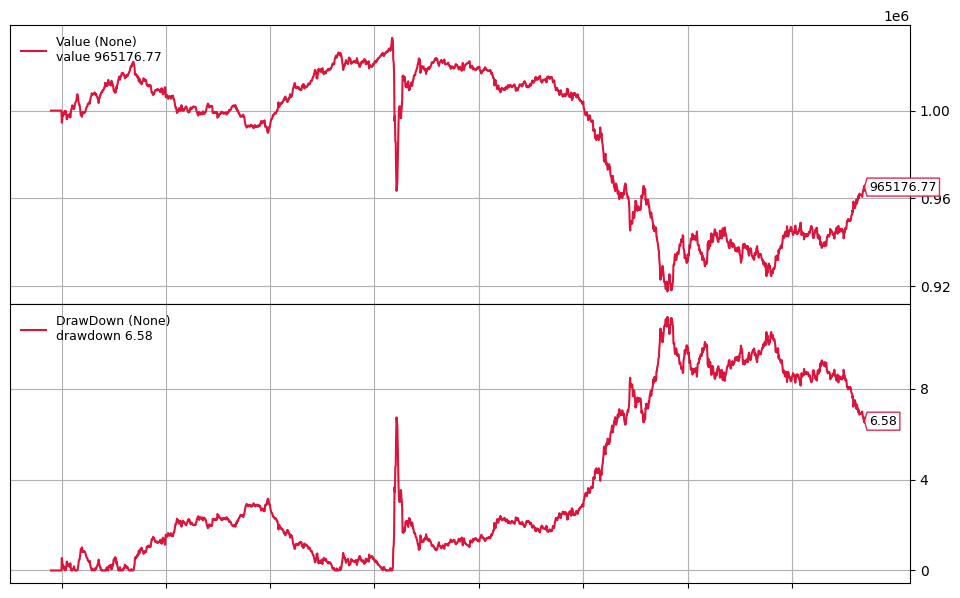

MP> worker: Process-16 processed 67 data

MP> worker: Process-16 existed. 78 data processed


2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 

2024-04-01T00:00:00: Order Status: Margin 
2024-07-01T00:00:00: Order Status: Margin 


2024-07-01T00:00:00: SELL COMPLETE, 1.91
2024-04-01T00:00:00: Order Status: Margin 


2024-04-01T00:00:00: Order Status: Margin 

2024-07-01T00:00:00: SELL COMPLETE, 18.42
2024-04-01T00:00:00: Order Status: Margin 


2024-04-01T00:00:00: Order Status: Margin 
2024-07-01T00:00:00: BUY COMPLETE, 15.07


2024-07-01T00:00:00: SELL COMPL

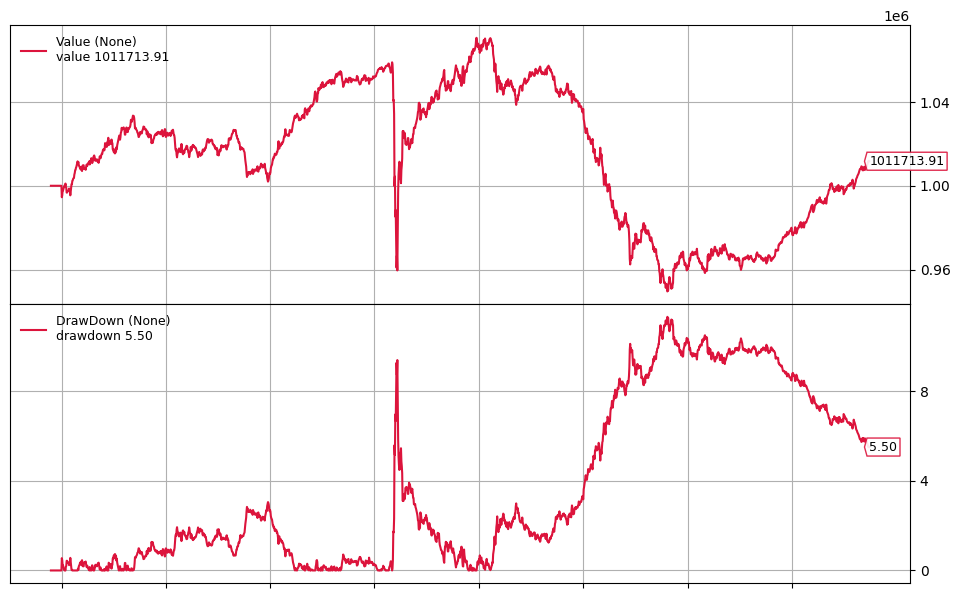




2020-07-01T00:00:00: Order Status: Margin 
2020-07-01T00:00:00: BUY COMPLETE, 216.55


2020-07-01T00:00:00: Order Status: Margin 

2020-07-01T00:00:00: BUY COMPLETE, 167.06
2020-07-01T00:00:00: Order Status: Margin 

2020-07-01T00:00:00: BUY COMPLETE, 6.11

2020-07-01T00:00:00: Order Status: Margin 
MP> worker: Process-23 processed 66 data


2020-07-01T00:00:00: BUY COMPLETE, 109.13

2020-07-01T00:00:00: Order Status: Margin 

2020-07-01T00:00:00: Order Status: Margin 

2020-07-01T00:00:00: SELL COMPLETE, 3.54
MP> worker: Process-23 existed. 78 data processed

2020-07-01T00:00:00: BUY COMPLETE, 3785.15



2020-07-01T00:00:00: SELL COMPLETE, 5.98
2020-07-01T00:00:00: SELL COMPLETE, 1383.05


2020-07-01T00:00:00: Order Status: Margin 
2020-07-01T00:00:00: SELL COMPLETE, 71.33


2020-07-01T00:00:00: SELL COMPLETE, 214.74

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status:

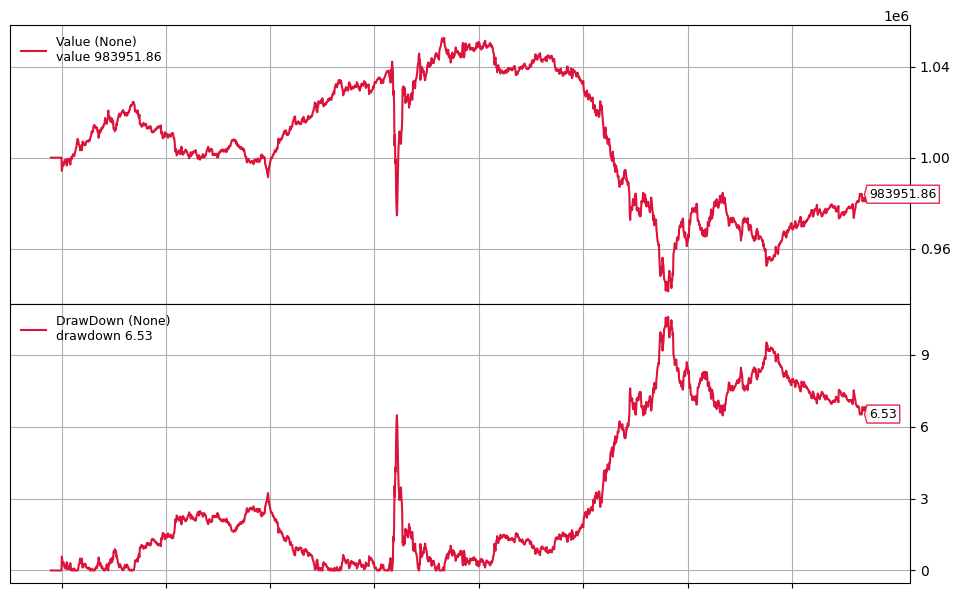

MP> worker: Process-26 processed 74 data

2023-04-03T00:00:00: Order Status: Margin 

2023-04-03T00:00:00: Order Status: Margin 

MP> worker: Process-26 existed. 78 data processed

2023-04-03T00:00:00: Order Status: Margin 


2021-07-01T00:00:00: Order Status: Margin 
2023-04-03T00:00:00: Order Status: Margin 


2021-07-01T00:00:00: SELL COMPLETE, 3.96

2023-04-03T00:00:00: Order Status: Margin 
2021-07-01T00:00:00: BUY COMPLETE, 93.26

2023-04-03T00:00:00: BUY COMPLETE, 1.80

2023-04-03T00:00:00: SELL COMPLETE, 127.83

2021-07-01T00:00:00: SELL COMPLETE, 130.10

2021-07-01T00:00:00: SELL COMPLETE, 139.68

2021-10-01T00:00:00: Order Status: Margin 
2021-07-01T00:00:00: BUY COMPLETE, 99.93


2021-10-01T00:00:00: BUY COMPLETE, 158.61
2021-07-01T00:00:00: BUY COMPLETE, 26.55


2021-07-01T00:00:00: SELL COMPLETE, 55.07
2021-10-01T00:00:00: BUY COMPLETE, 75.08


2021-07-01T00:00:00: BUY COMPLETE, 133.96
2021-10-01T00:00:00: BUY COMPLETE, 111.45

2021-10-01T00:00:00: SELL COMPLETE, 146.35

2

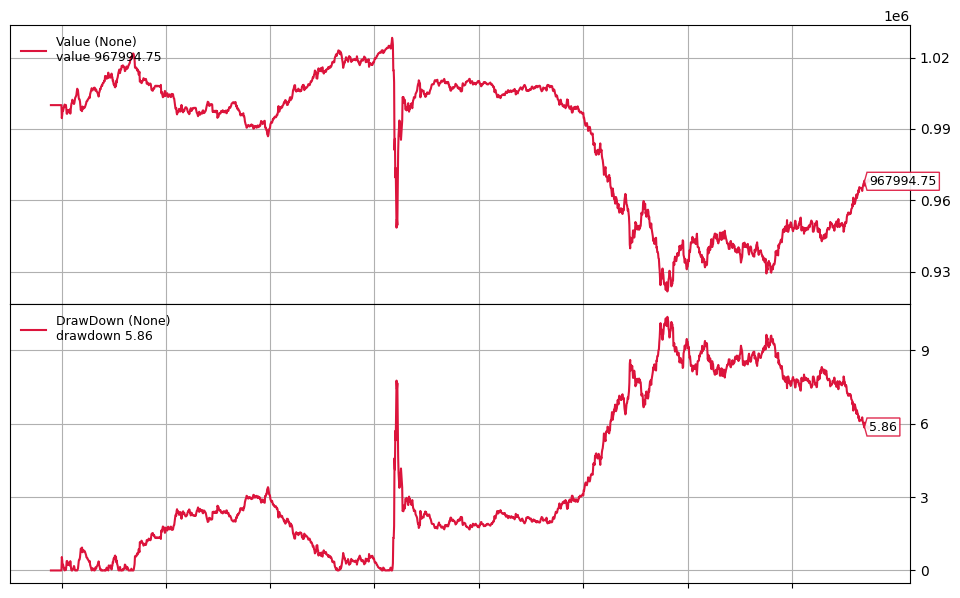


MP> worker: Process-25 processed 65 data

MP> worker: Process-25 existed. 78 data processed


2021-10-01T00:00:00: SELL COMPLETE, 3.59

2021-10-01T00:00:00: SELL COMPLETE, 74.59

2021-10-01T00:00:00: SELL COMPLETE, 110.46

2021-10-01T00:00:00: SELL COMPLETE, 139.76

2021-10-01T00:00:00: SELL COMPLETE, 99.92

2021-10-01T00:00:00: SELL COMPLETE, 26.51

2021-10-01T00:00:00: SELL COMPLETE, 55.04

2021-10-01T00:00:00: SELL COMPLETE, 133.76

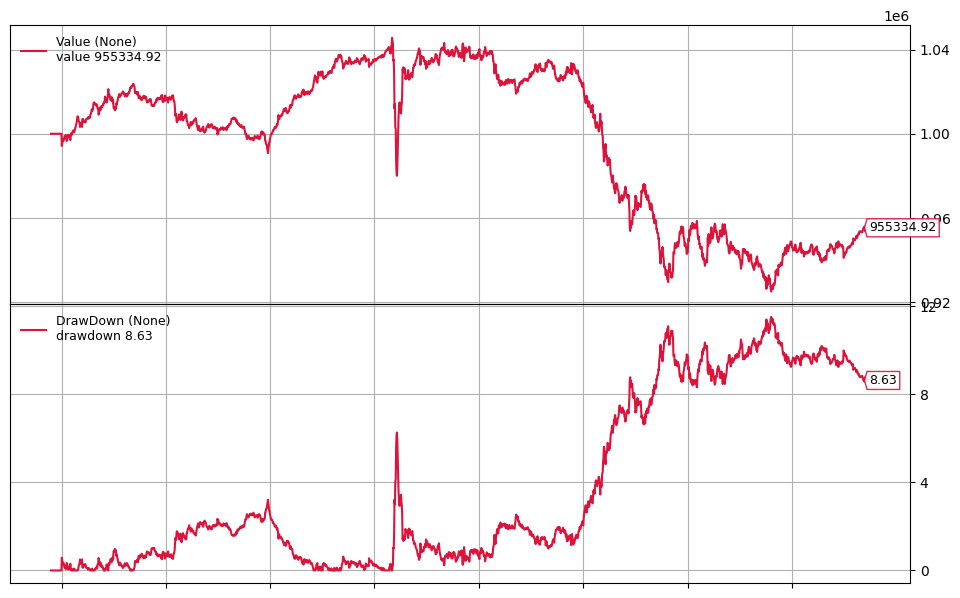



2021-10-01T00:00:00: SELL COMPLETE, 210.97

2021-10-01T00:00:00: SELL COMPLETE, 54.60

2021-10-01T00:00:00: SELL COMPLETE, 45.27

2021-10-01T00:00:00: SELL COMPLETE, 51.03

2021-10-01T00:00:00: BUY COMPLETE, 4733.55

2021-10-01T00:00:00: BUY COMPLETE, 25.60
MP> worker: Process-28 processed 70 data


2021-10-01T00:00:00: SELL COMPLETE, 110.46MP> worker: Process-28 existed. 78 data processed



2021-10-01T00:00:00: BUY COMPLETE, 50.28
MP> received data 74
MP> received data 65
MP> received data 70

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: Order Status: Margin 

2022-04-01T00:00:00: BUY COMPLETE, 118.19

2022-04-01T00:00:00: BUY COMPLETE, 46.69

2022-04-01T00:00:00: BUY COMPLETE, 67.10

2022-04-01T00:00:00: SELL COMPLETE, 4.86

2022-04-01T00:00:00: SELL COMPLETE, 57.69

2022-04-01T00:00:00: SELL COMPLETE, 155.42

2022-04-01T00:00:00: SELL COMPLETE, 4957.60

2022-04-01T00:00:00: BUY COMPLETE, 1180.00

2023-10-02T00:00:00:

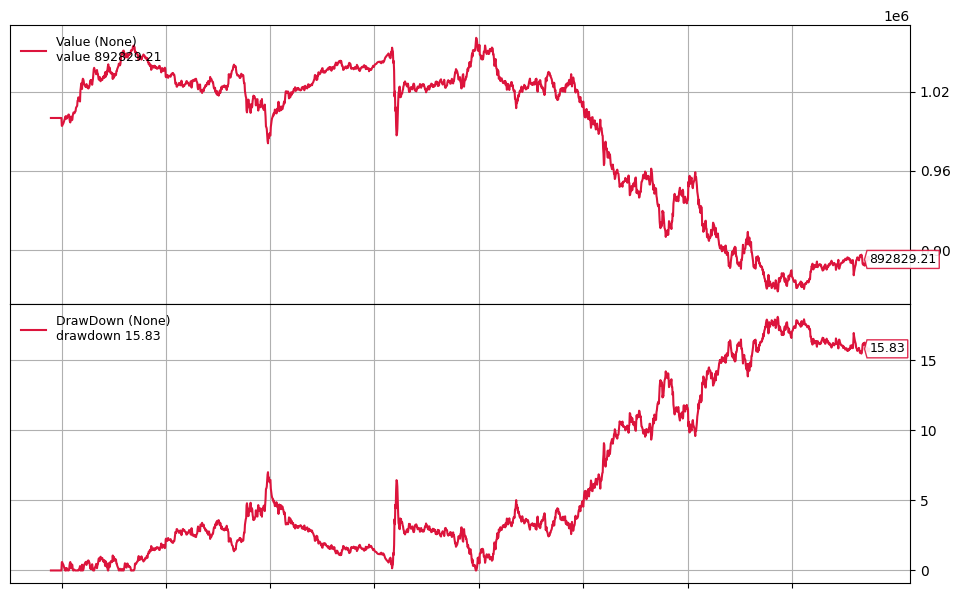

MP> worker: Process-29 processed 69 data

MP> worker: Process-29 existed. 78 data processed


2024-07-01T00:00:00: Order Status: Margin 

2024-07-01T00:00:00: BUY COMPLETE, 15.07

2024-07-01T00:00:00: SELL COMPLETE, 16.36

2024-07-01T00:00:00: SELL COMPLETE, 7.39

2024-07-01T00:00:00: SELL COMPLETE, 44.05

2024-07-01T00:00:00: BUY COMPLETE, 85.63

2024-07-01T00:00:00: BUY COMPLETE, 66.18

2024-07-01T00:00:00: BUY COMPLETE, 44.23

2024-07-01T00:00:00: BUY COMPLETE, 183.30

2024-07-01T00:00:00: BUY COMPLETE, 37.21

2020-01-02T00:00:00: Order Status: Margin 

2020-01-02T00:00:00: BUY COMPLETE, 8.66
2023-10-02T00:00:00: Order Status: Margin 


2020-01-02T00:00:00: SELL COMPLETE, 162.75
2023-10-02T00:00:00: Order Status: Margin 


2020-01-02T00:00:00: BUY COMPLETE, 50.64
2023-10-02T00:00:00: Order Status: Margin 


2023-10-02T00:00:00: Order Status: Margin 
2020-01-02T00:00:00: SELL COMPLETE, 132.40


2023-10-02T00:00:00: Order Status: Margin 
2020-01-02T00:00:00: BUY COMPLETE, 100.21


202

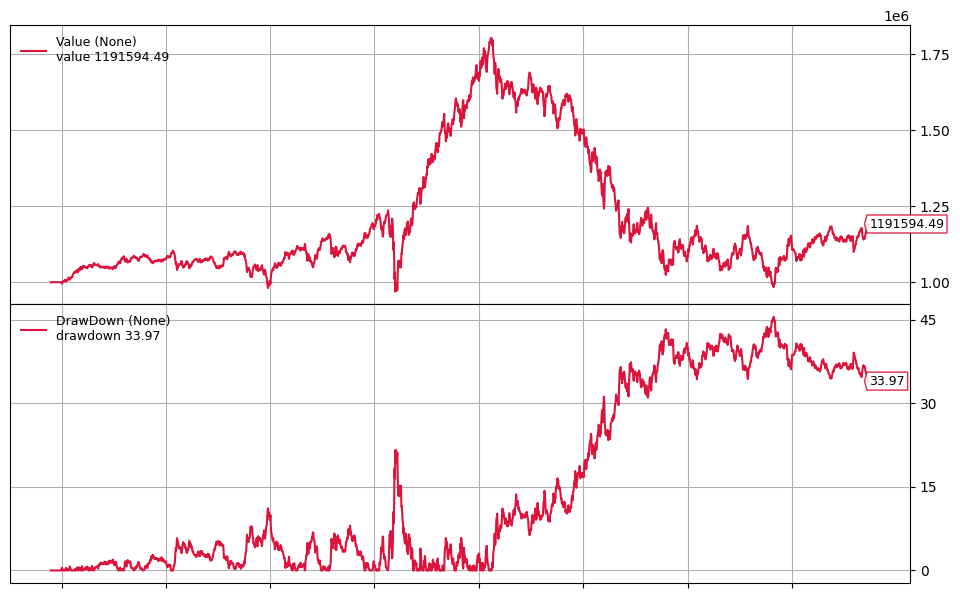

backtest.plot: 1004-3029
MP> worker: Process-17 processed 71 data

MP> worker: Process-17 existed. 78 data processed



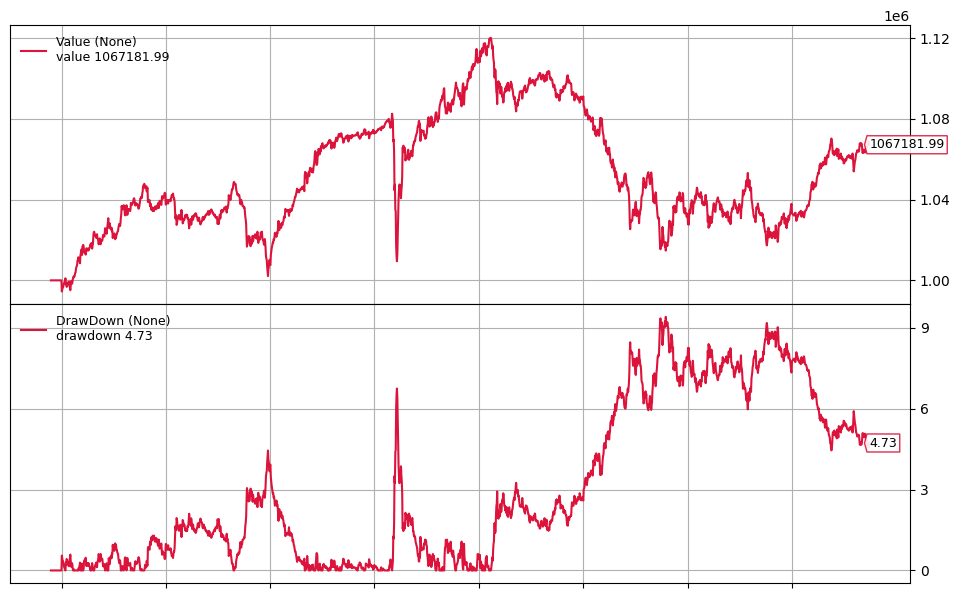

MP> worker: Process-20 processed 72 data

MP> worker: Process-20 existed. 78 data processed


2021-07-01T00:00:00: BUY COMPLETE, 93.26

2021-07-01T00:00:00: SELL COMPLETE, 130.10

2021-07-01T00:00:00: BUY COMPLETE, 99.93

2021-07-01T00:00:00: BUY COMPLETE, 26.55

2021-07-01T00:00:00: BUY COMPLETE, 55.12

2021-07-01T00:00:00: SELL COMPLETE, 133.92

2021-07-01T00:00:00: SELL COMPLETE, 5.33

2021-07-01T00:00:00: BUY COMPLETE, 210.81

2021-07-01T00:00:00: SELL COMPLETE, 51.20

2021-07-01T00:00:00: BUY COMPLETE, 148.68

2021-07-01T00:00:00: BUY COMPLETE, 4675.00

2021-07-01T00:00:00: BUY COMPLETE, 1579.99

2021-07-01T00:00:00: SELL COMPLETE, 110.48

2021-07-01T00:00:00: Order Status: Margin 

2022-01-03T00:00:00: Order Status: Margin 

2022-01-03T00:00:00: BUY COMPLETE, 5.68

2022-01-03T00:00:00: SELL COMPLETE, 61.40

2022-01-03T00:00:00: SELL COMPLETE, 95.52

2022-01-03T00:00:00: SELL COMPLETE, 137.92

2022-01-03T00:00:00: SELL COMPLETE, 99.41

2022-01-03T00:00:00: SELL COMPLETE, 26.22MP> 

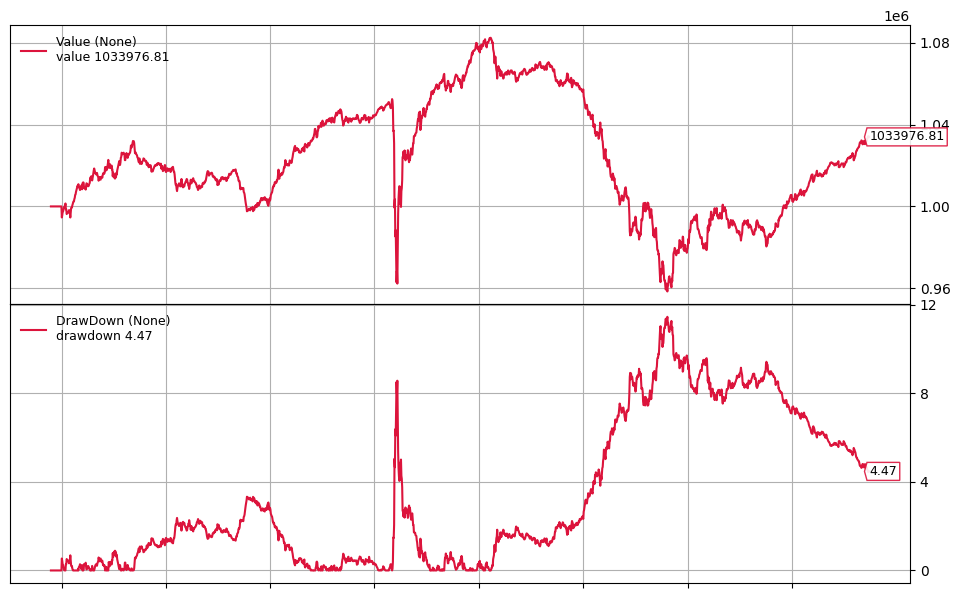

MP> worker: Process-30 processed 73 data

MP> worker: Process-30 existed. 78 data processed


2022-07-01T00:00:00: Order Status: Margin 

2022-07-01T00:00:00: Order Status: Margin 

2022-07-01T00:00:00: Order Status: Margin 

2022-07-01T00:00:00: BUY COMPLETE, 8.22

2022-07-01T00:00:00: SELL COMPLETE, 5.18

2022-07-01T00:00:00: BUY COMPLETE, 99.28

2022-07-01T00:00:00: SELL COMPLETE, 50.05

2022-07-01T00:00:00: SELL COMPLETE, 128.94

2022-07-01T00:00:00: SELL COMPLETE, 186.40

2022-07-01T00:00:00: BUY COMPLETE, 47.44

2022-07-01T00:00:00: SELL COMPLETE, 47.41

2022-07-01T00:00:00: BUY COMPLETE, 138.07

2022-07-01T00:00:00: SELL COMPLETE, 4460.59

2022-07-01T00:00:00: BUY COMPLETE, 1335.00

2022-07-01T00:00:00: SELL COMPLETE, 110.02

2022-07-01T00:00:00: BUY COMPLETE, 50.47

2023-01-03T00:00:00: Order Status: Margin 

2023-01-03T00:00:00: Order Status: Margin 

2023-01-03T00:00:00: Order Status: Margin 

2023-01-03T00:00:00: Order Status: Margin 

2023-01-03T00:00:00: Order Status: Marg

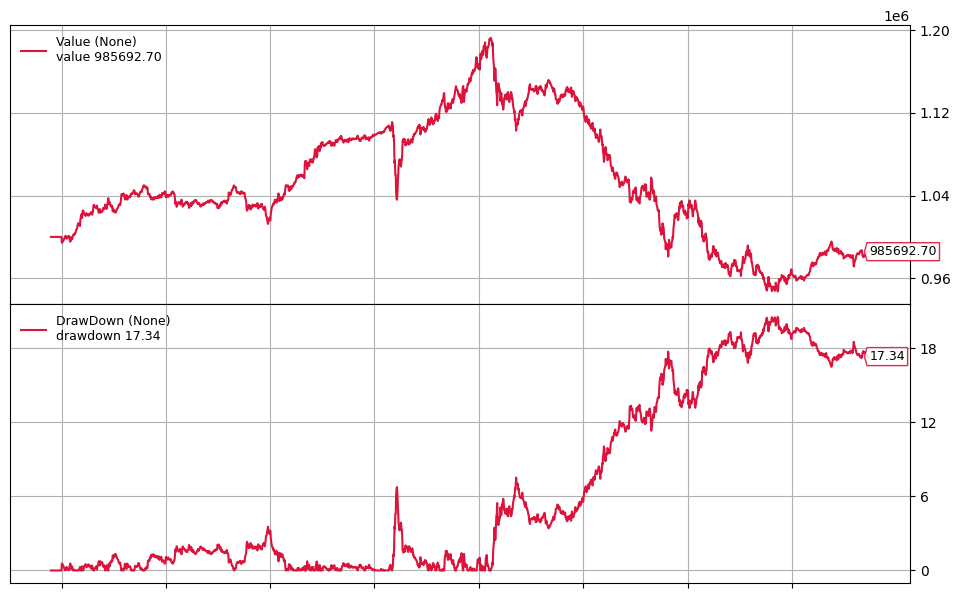

MP> worker: Process-22 processed 75 data

MP> worker: Process-22 existed. 78 data processed

MP> received data 75
length of datas: 55
init(key: assets)
init(N/A) _assets(55): ['0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']
init>> assets[0]-0341.HK in weights
init>> assets[1]-0405.HK in weights
init>> assets[2]-0737.HK in weights
init>> assets[3]-0P00001DU6 in weights
init>> assets[4]-0P00002C5C in weights
init>> assets[5]-0P00006OXK.T in weights
init>> assets[6]-0P0000UIC0 in

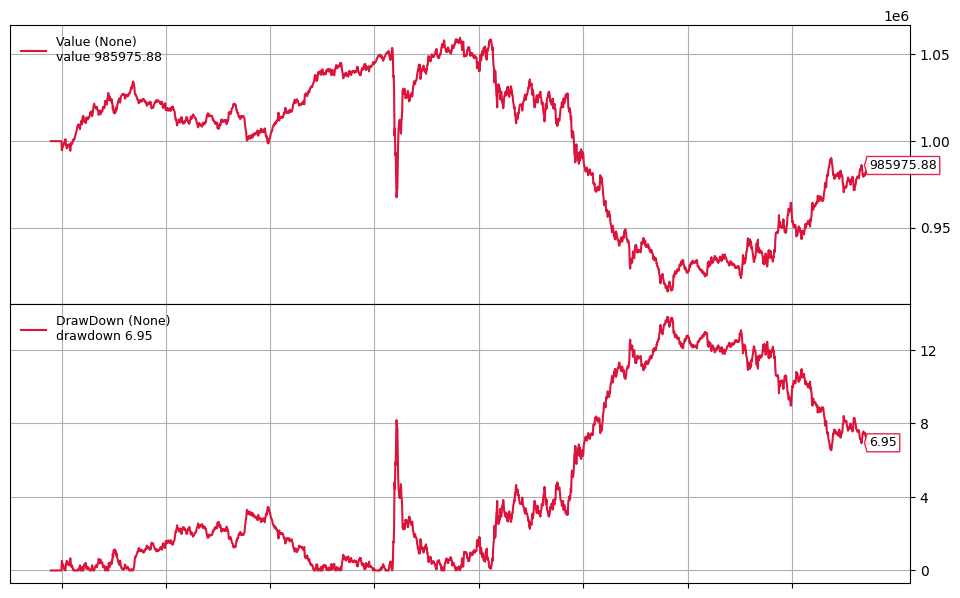


2018-10-01T00:00:00: Order Status: Margin MP> worker: Process-27 processed 77 data



2018-10-01T00:00:00: SELL COMPLETE, 5.05MP> worker: Process-27 existed. 78 data processed



2018-10-01T00:00:00: SELL COMPLETE, 123.48

2018-10-01T00:00:00: BUY COMPLETE, 48.48

2018-10-01T00:00:00: BUY COMPLETE, 122.04

2018-10-01T00:00:00: SELL COMPLETE, 100.51

2018-10-01T00:00:00: BUY COMPLETE, 24.30

2018-10-01T00:00:00: BUY COMPLETE, 28.11

2018-10-01T00:00:00: BUY COMPLETE, 129.76

2018-10-01T00:00:00: BUY COMPLETE, 51.74

2018-10-01T00:00:00: BUY COMPLETE, 48.90

2018-10-01T00:00:00: SELL COMPLETE, 116.03

2018-10-01T00:00:00: SELL COMPLETE, 3559.00

2018-10-01T00:00:00: SELL COMPLETE, 109.85

2018-10-01T00:00:00: BUY COMPLETE, 94.25

2018-10-01T00:00:00: BUY COMPLETE, 110.27

2019-01-02T00:00:00: Order Status: Margin 

2019-01-02T00:00:00: SELL COMPLETE, 4.94

2019-01-02T00:00:00: BUY COMPLETE, 11.00

2019-01-02T00:00:00: BUY COMPLETE, 105.56

2019-01-02T00:00:00: SELL COMPLETE, 36.23

2019

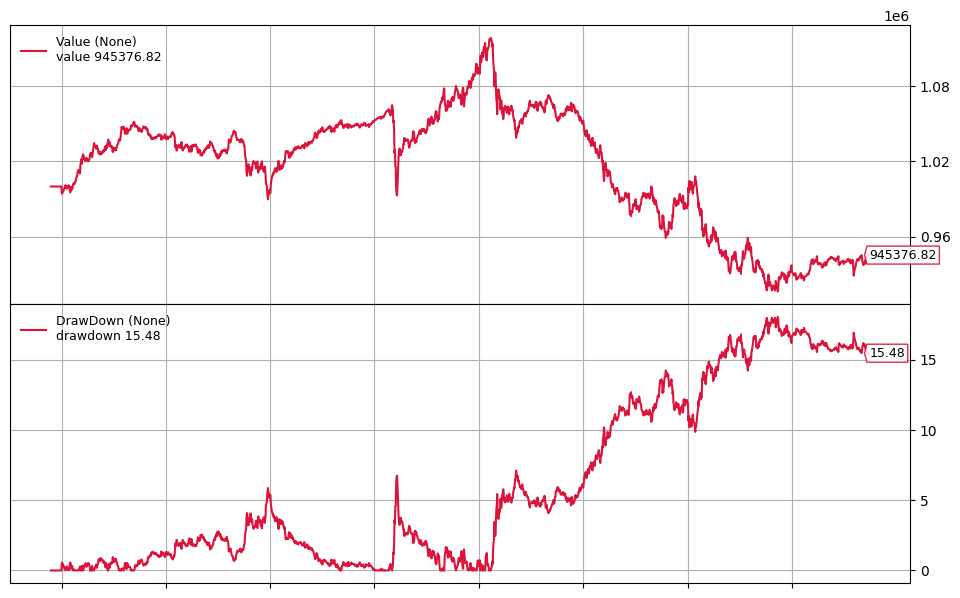

MP> worker: Process-19 processed 76 data

MP> worker: Process-19 existed. 78 data processed


2019-04-01T00:00:00: SELL COMPLETE, 5.51

2019-04-01T00:00:00: SELL COMPLETE, 10.37

2019-04-01T00:00:00: SELL COMPLETE, 122.52

2019-04-01T00:00:00: SELL COMPLETE, 47.08

2019-04-01T00:00:00: BUY COMPLETE, 127.46

2019-04-01T00:00:00: BUY COMPLETE, 100.90

2019-04-01T00:00:00: SELL COMPLETE, 121.79

2019-04-01T00:00:00: BUY COMPLETE, 25.13

2019-04-01T00:00:00: BUY COMPLETE, 28.68

2019-04-01T00:00:00: BUY COMPLETE, 131.38

2019-04-01T00:00:00: BUY COMPLETE, 52.66

2019-04-01T00:00:00: BUY COMPLETE, 49.73

2019-04-01T00:00:00: BUY COMPLETE, 3467.00

2019-04-01T00:00:00: BUY COMPLETE, 113.94

2019-04-01T00:00:00: SELL COMPLETE, 93.16

2019-04-01T00:00:00: BUY COMPLETE, 110.37

2019-04-01T00:00:00: BUY COMPLETE, 50.27
MP> received data 77
MP> received data 76

2019-07-01T00:00:00: Order Status: Margin 

2019-07-01T00:00:00: Order Status: Margin 

2019-07-01T00:00:00: Order Status: Margin 

2019

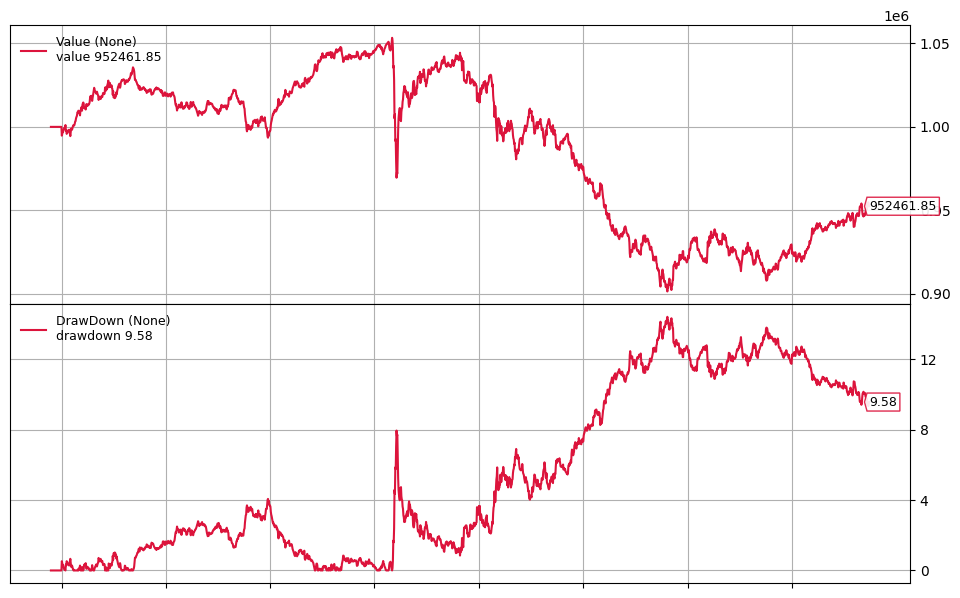

MP> worker: Process-21 processed 78 data

MP> worker: Process-21 existed. 78 data processed

MP> received data 78
MP> total 78 results received
CPU times: user 17.3 s, sys: 8.56 s, total: 25.9 s
Wall time: 3min 28s


In [51]:
%%time

# Run with a specified number of CPUs

bt_results = run_pool_v2(parameters, bt_worker)


In [52]:
print(parameters[0]['weights'].columns.to_list())

['Date', '0341.HK', '0405.HK', '0737.HK', '0P00001DU6', '0P00002C5C', '0P00006OXK.T', '0P0000UIC0', '0P0000VP5F', '0P0000YVJG', '0P0000Z5AZ', '0P0000ZJFK', '0P00013N6C', '0P0001DFIZ', '0P0001DHN3', '0P0001Q87U', '1186.HK', '1810.HK', '3175.HK', '3187.HK', '9988.HK', 'ADDYY', 'AGGU.L', 'ARKG', 'ARKK', 'BABA', 'CSBGU7.SW', 'ERND.L', 'GLD', 'GOVT', 'HYGH', 'HYLD.L', 'HYMB', 'IAGG', 'IBIT', 'IBTS.SW', 'IDEV', 'IDTL.L', 'IDTM.L', 'IEMB.L', 'IGIL.L', 'IGSB', 'IHYU.L', 'ISAG.L', 'ISTB', 'IVE', 'IWRD.L', 'JDN.MX', 'LQDE.L', 'METV', 'PAVE', 'SDHY.L', 'SHV', 'TFLO', 'USO', 'ZM']


In [53]:
display(BM_metric_list)

[{'Risk_measure': 'SPY',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.3228743946348118,
  'CAGR': 0.08196282546187791,
  'Sharpe Ratio': 0.605347150704247},
 {'Risk_measure': '^HSI',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.5494292603503544,
  'CAGR': -0.01175825798599421,
  'Sharpe Ratio': -0.024920167720875627},
 {'Risk_measure': 'QQQ',
  'Objective': 'N/A',
  'R_Interval': 'N/A',
  'Max DrawDown': 0.37031081594835447,
  'CAGR': 0.12635141897178034,
  'Sharpe Ratio': 0.6157275175540328}]

bt_results.length = 78
batches.length = 1
bt_results.length = 78
('Sharpe', 'S', 'WR')
obj=Sharpe,r=S,rm=WR
0341.HK          0.0
0405.HK          0.0
0737.HK       0.0563
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0451
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.0
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0758
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.0
IVE              0.0
IWRD.L        0.0927
JDN.MX           0.0
LQDE.L           0.0
PAVE          0.0161
SDHY.L           0.0
SHV       

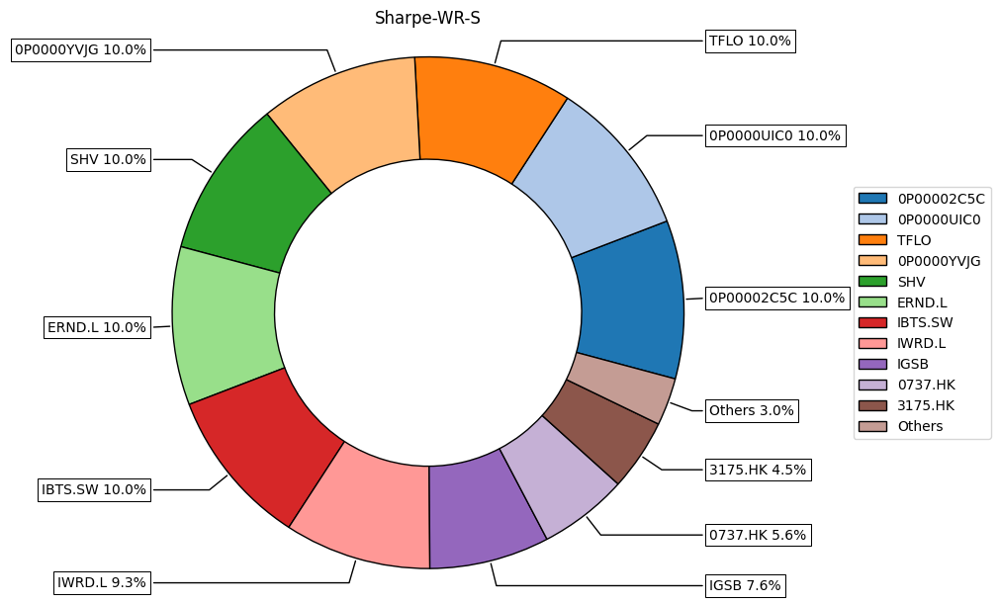

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0563
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0758
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.159
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'WR',
 'Objective': 'Sharpe',
 'R_Interval': 'S',
 'Max DrawDown': 0.1440662773551629,
 'CAGR': 8.616475520034276e-05,
 'Sharpe Ratio': 0.01797825063770154}

batches.length = 1
bt_results.length = 78
('MaxRet', 'S', 'CVaR')
obj=MaxRet,r=S,rm=CVaR
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.1
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.0
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 2964, dtype: object


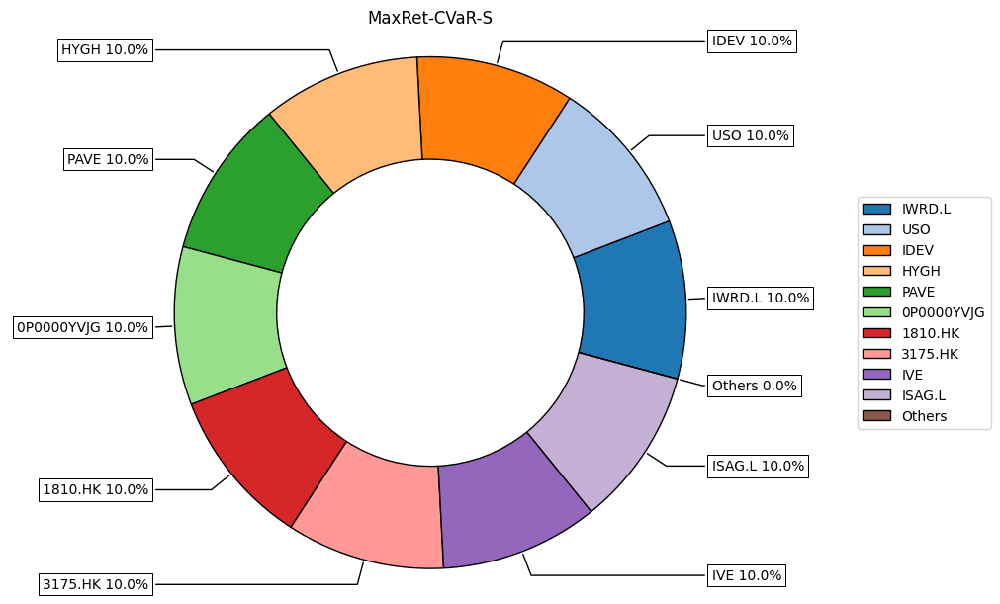

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.3
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'CVaR',
 'Objective': 'MaxRet',
 'R_Interval': 'S',
 'Max DrawDown': 0.4542907064943648,
 'CAGR': 0.017974507271115894,
 'Sharpe Ratio': 0.193202134261516}

batches.length = 1
bt_results.length = 78
('Sharpe', 'Q', 'FLPM')
obj=Sharpe,r=Q,rm=FLPM
0341.HK          0.0
0405.HK          0.0
0737.HK       0.0007
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.1
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0063
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0532
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0354
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV     

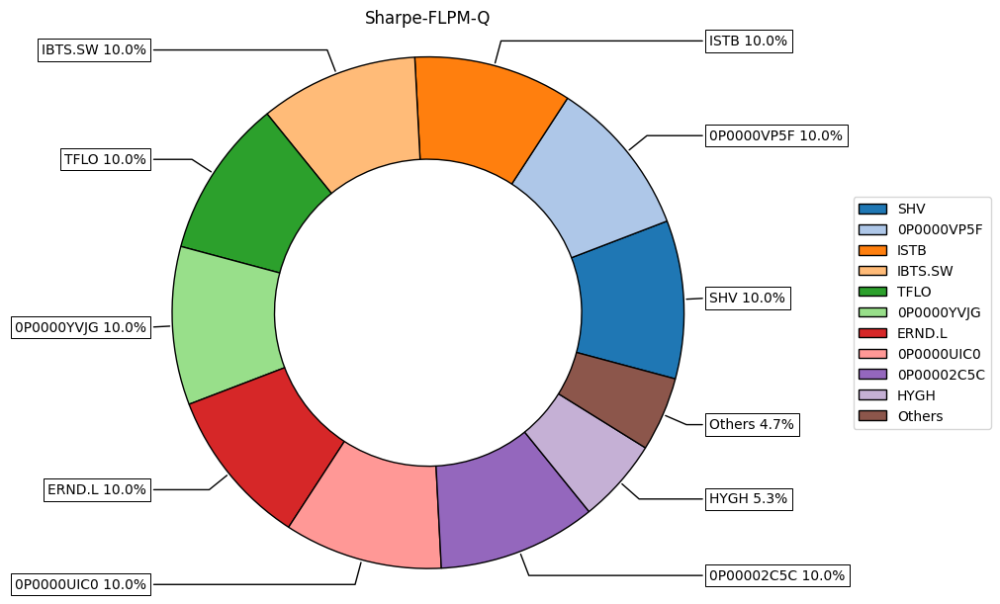

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0007
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.1
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0354
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1108
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'FLPM',
 'Objective': 'Sharpe',
 'R_Interval': 'Q',
 'Max DrawDown': 0.10911594612940136,
 'CAGR': 0.0021028037930694147,
 'Sharpe Ratio': 0.08840394961916945}

batches.length = 1
bt_results.length = 78
('MinRisk', 'S', 'MAD')
obj=MinRisk,r=S,rm=MAD
0341.HK          0.0
0405.HK       0.0001
0737.HK       0.0001
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.1
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK       0.0003
1810.HK          0.0
3175.HK       0.0016
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0168
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0812
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV              0.1
TFLO    

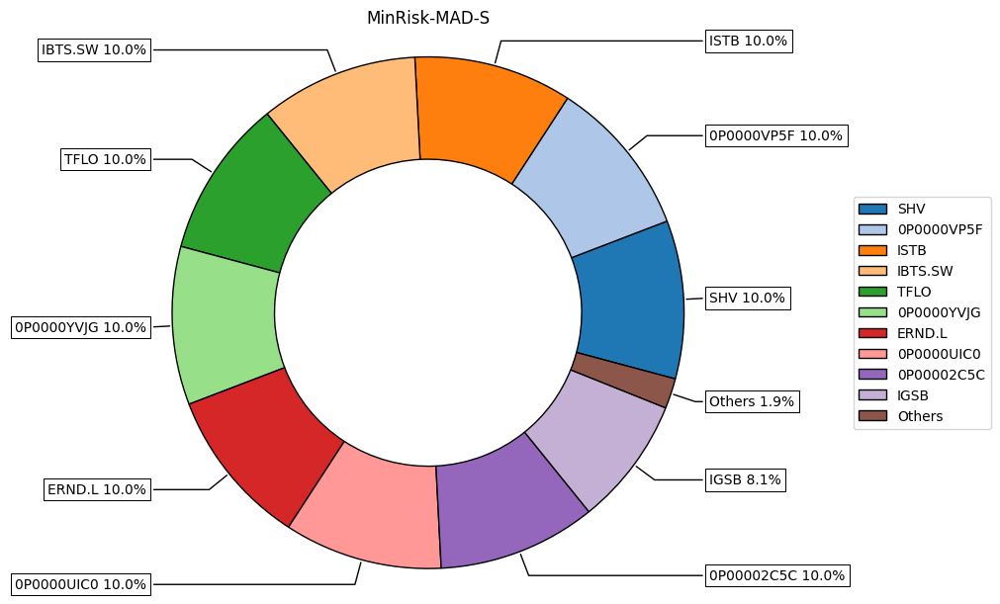

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0001
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0001
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.1
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0812
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1017
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'MAD',
 'Objective': 'MinRisk',
 'R_Interval': 'S',
 'Max DrawDown': 0.0995860560605363,
 'CAGR': -0.0008194165690535696,
 'Sharpe Ratio': -0.020329929068962468}

batches.length = 1
bt_results.length = 78
('MaxRet', 'S', 'CDaR')
obj=MaxRet,r=S,rm=CDaR
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.1
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.0
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 2964, dtype: object


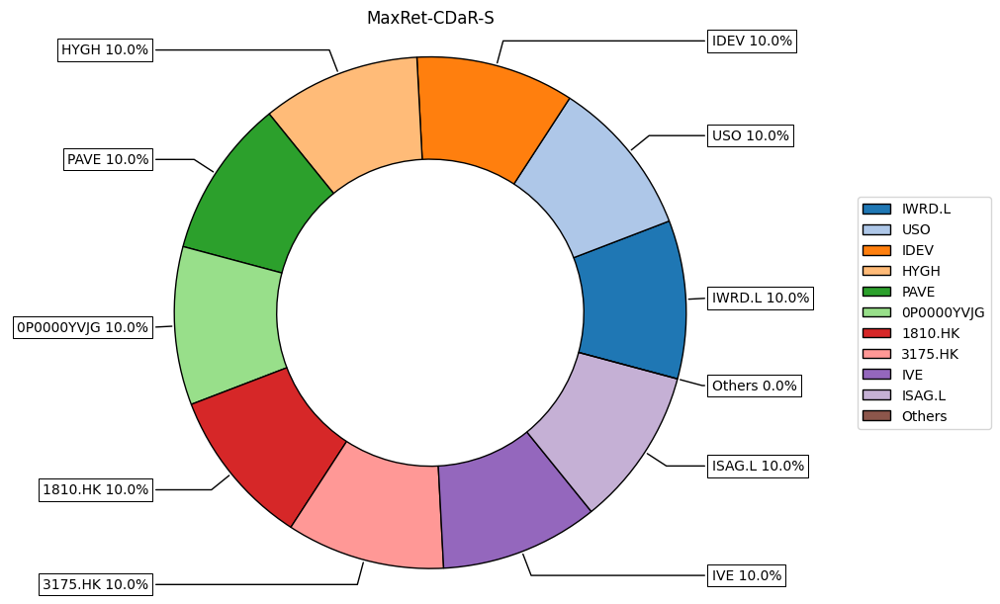

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.3
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'CDaR',
 'Objective': 'MaxRet',
 'R_Interval': 'S',
 'Max DrawDown': 0.4542907064943648,
 'CAGR': 0.017974507271115894,
 'Sharpe Ratio': 0.193202134261516}

batches.length = 1
bt_results.length = 78
('MinRisk', 'S', 'MV')
obj=MinRisk,r=S,rm=MV
0341.HK          0.0
0405.HK          0.0
0737.HK        0.001
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.1
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK        0.002
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0057
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0911
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV              0.1
TFLO      

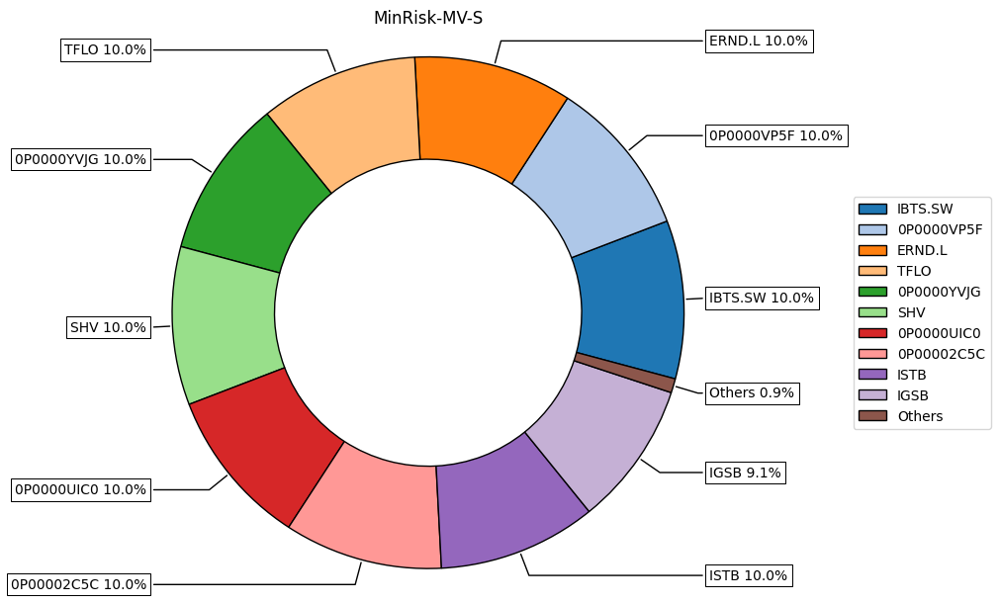

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.001
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.1
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0911
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1022
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'MV',
 'Objective': 'MinRisk',
 'R_Interval': 'S',
 'Max DrawDown': 0.10328417843522636,
 'CAGR': -0.0012122581865662068,
 'Sharpe Ratio': -0.036431699102504066}

batches.length = 1
bt_results.length = 78
('Sharpe', 'S', 'SLPM')
obj=Sharpe,r=S,rm=SLPM
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F    0.0502
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0119
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0596
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0583
IVE              0.0
IWRD.L        0.0108
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV              0.1
TFLO    

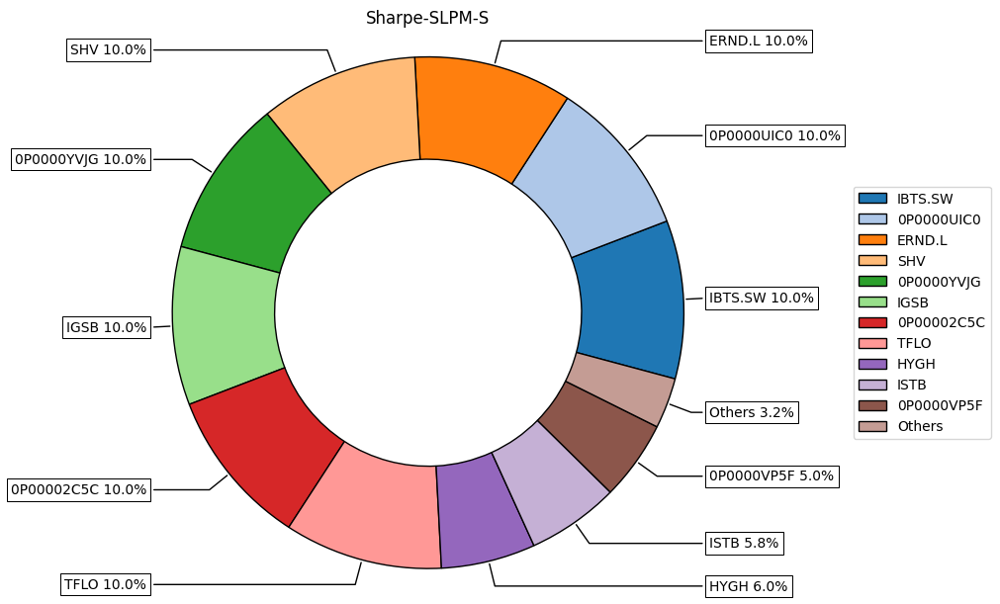

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0502
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1211
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0502


{'Risk_measure': 'SLPM',
 'Objective': 'Sharpe',
 'R_Interval': 'S',
 'Max DrawDown': 0.10322228666773363,
 'CAGR': 0.003288587123858636,
 'Sharpe Ratio': 0.13761617969841233}

batches.length = 1
bt_results.length = 78
('MaxRet', 'S', 'MSV')
obj=MaxRet,r=S,rm=MSV
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.1
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.0
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 2964, dtype: object


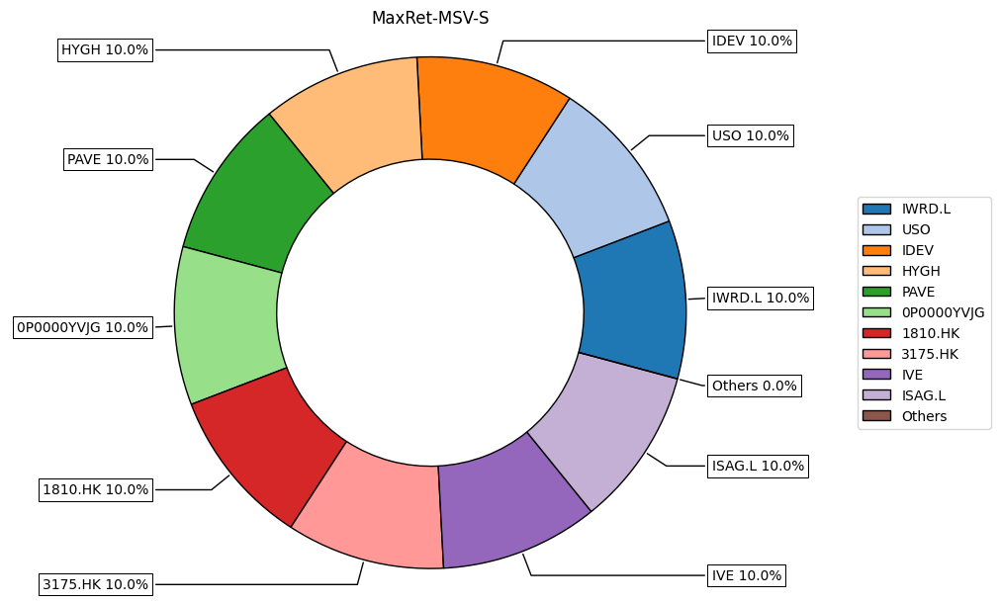

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.3
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'MSV',
 'Objective': 'MaxRet',
 'R_Interval': 'S',
 'Max DrawDown': 0.4542907064943648,
 'CAGR': 0.017974507271115894,
 'Sharpe Ratio': 0.193202134261516}

batches.length = 1
bt_results.length = 78
('MaxRet', 'Q', 'MDD')
obj=MaxRet,r=Q,rm=MDD
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.0
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
3187.HK       0.0
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.1
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 3029, dtype: object


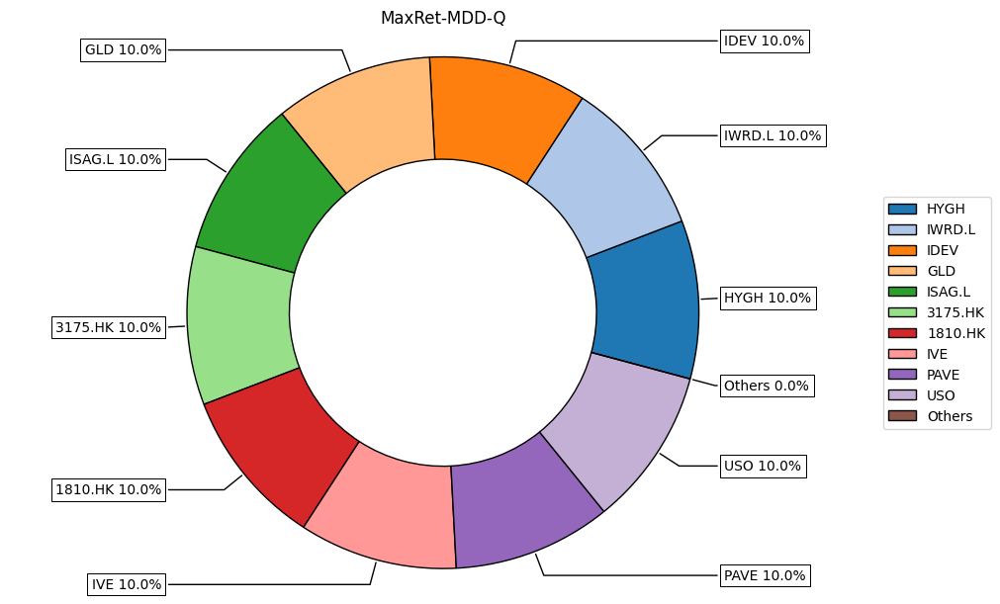

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.1
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.2
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'MDD',
 'Objective': 'MaxRet',
 'R_Interval': 'Q',
 'Max DrawDown': 0.45501882780938785,
 'CAGR': 0.015063605915950596,
 'Sharpe Ratio': 0.17014133987540994}

batches.length = 1
bt_results.length = 78
('MaxRet', 'Q', 'SLPM')
obj=MaxRet,r=Q,rm=SLPM
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.0
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
3187.HK       0.0
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.1
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 3029, dtype: object


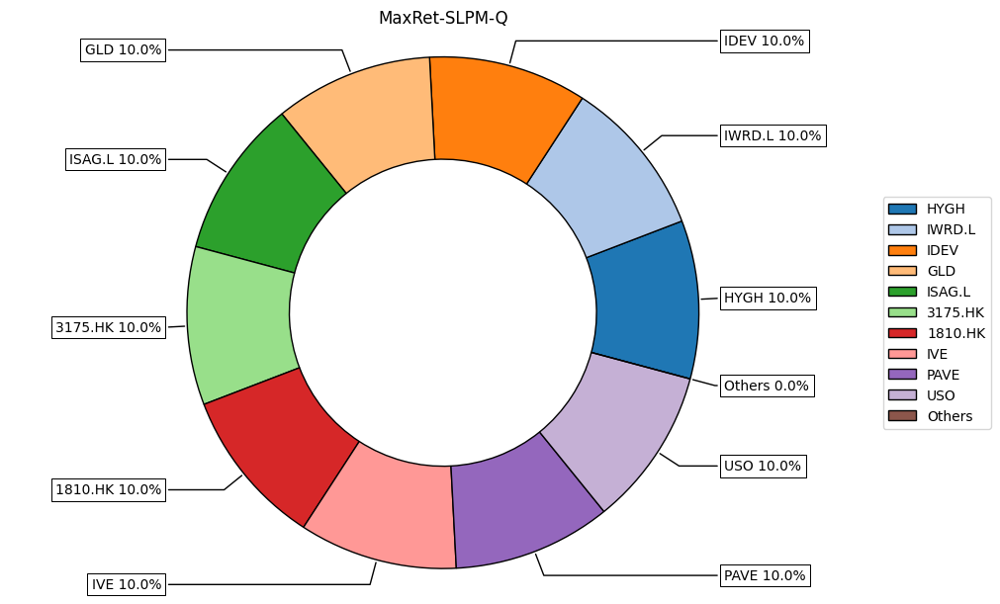

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.1
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.2
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'SLPM',
 'Objective': 'MaxRet',
 'R_Interval': 'Q',
 'Max DrawDown': 0.45501882780938785,
 'CAGR': 0.015063605915950596,
 'Sharpe Ratio': 0.17014133987540994}

batches.length = 1
bt_results.length = 78
('MinRisk', 'Q', 'WR')
obj=MinRisk,r=Q,rm=WR
0341.HK          0.0
0405.HK       0.0334
0737.HK        0.032
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0    0.0911
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK          0.0
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.0
HYLD.L           0.0
HYMB             0.0
IAGG          0.0372
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV       

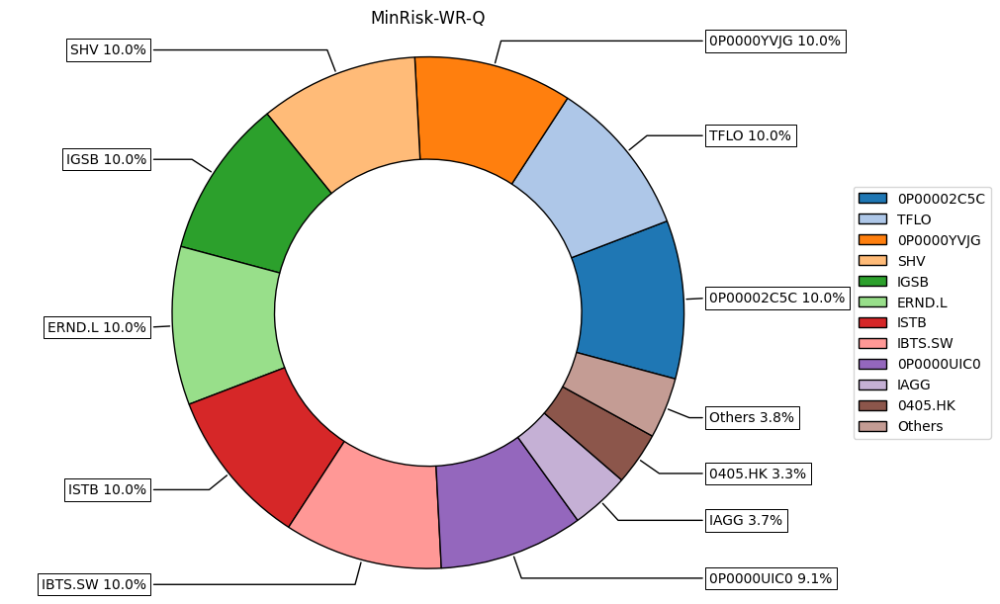

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0334
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.032
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0911
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1064
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'WR',
 'Objective': 'MinRisk',
 'R_Interval': 'Q',
 'Max DrawDown': 0.14576287091938372,
 'CAGR': -0.006000085049114054,
 'Sharpe Ratio': -0.20875402691517722}

batches.length = 1
bt_results.length = 78
('MaxRet', 'Q', 'ADD')
obj=MaxRet,r=Q,rm=ADD
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.0
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
3187.HK       0.0
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.1
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 3029, dtype: object


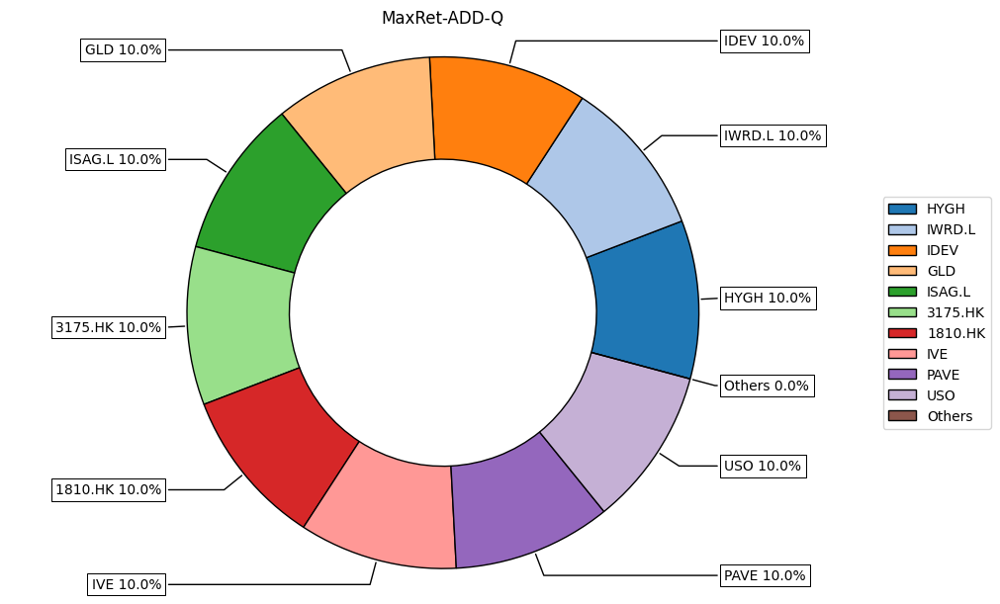

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.1
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.2
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'ADD',
 'Objective': 'MaxRet',
 'R_Interval': 'Q',
 'Max DrawDown': 0.45501882780938785,
 'CAGR': 0.015063605915950596,
 'Sharpe Ratio': 0.17014133987540994}

batches.length = 1
bt_results.length = 78
('Sharpe', 'S', 'MAD')
obj=Sharpe,r=S,rm=MAD
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F    0.0998
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0071
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0572
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB           0.031
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV              0.1
TFLO      

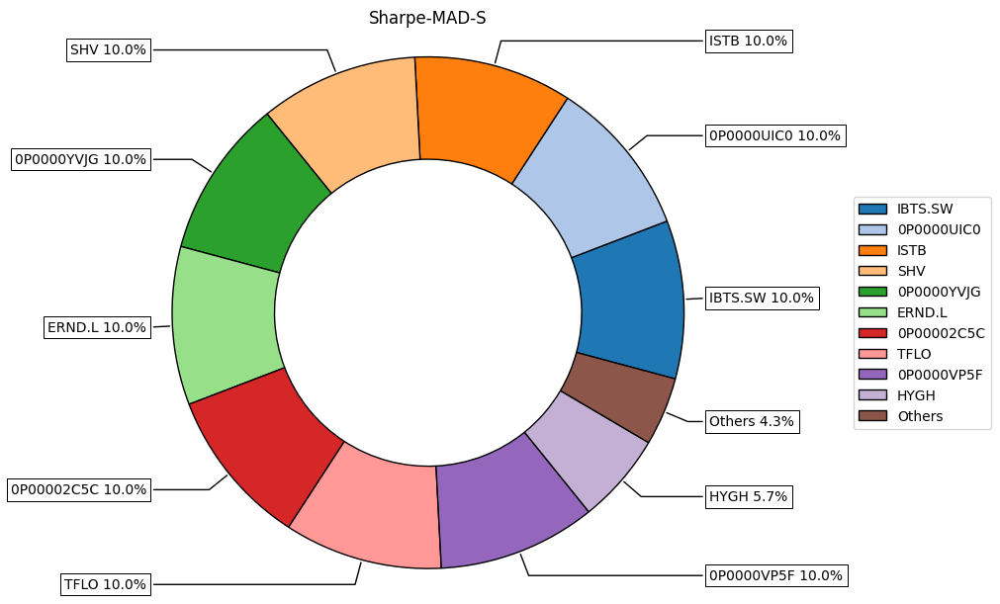

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0998
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.031
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1121
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0998


{'Risk_measure': 'MAD',
 'Objective': 'Sharpe',
 'R_Interval': 'S',
 'Max DrawDown': 0.090527528295166,
 'CAGR': 0.004063308096363656,
 'Sharpe Ratio': 0.16531856255706065}

batches.length = 1
bt_results.length = 78
('Sharpe', 'Q', 'ADD')
obj=Sharpe,r=Q,rm=ADD
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK       0.0032
1810.HK          0.0
3175.HK       0.0141
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.1
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0001
IVE              0.0
IWRD.L        0.0077
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L        0.0552
SHV       

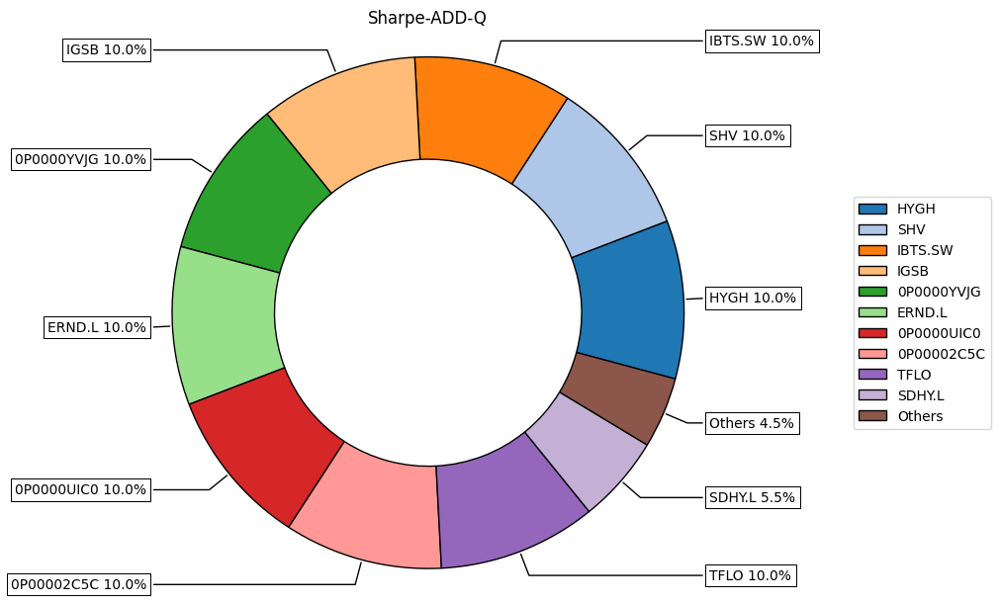

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1338
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'ADD',
 'Objective': 'Sharpe',
 'R_Interval': 'Q',
 'Max DrawDown': 0.12139501236258479,
 'CAGR': -0.0023073164215345063,
 'Sharpe Ratio': -0.06581333386843383}

batches.length = 1
bt_results.length = 78
('MaxRet', 'Q', 'FLPM')
obj=MaxRet,r=Q,rm=FLPM
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.0
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
3187.HK       0.0
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.1
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 3029, dtype: object


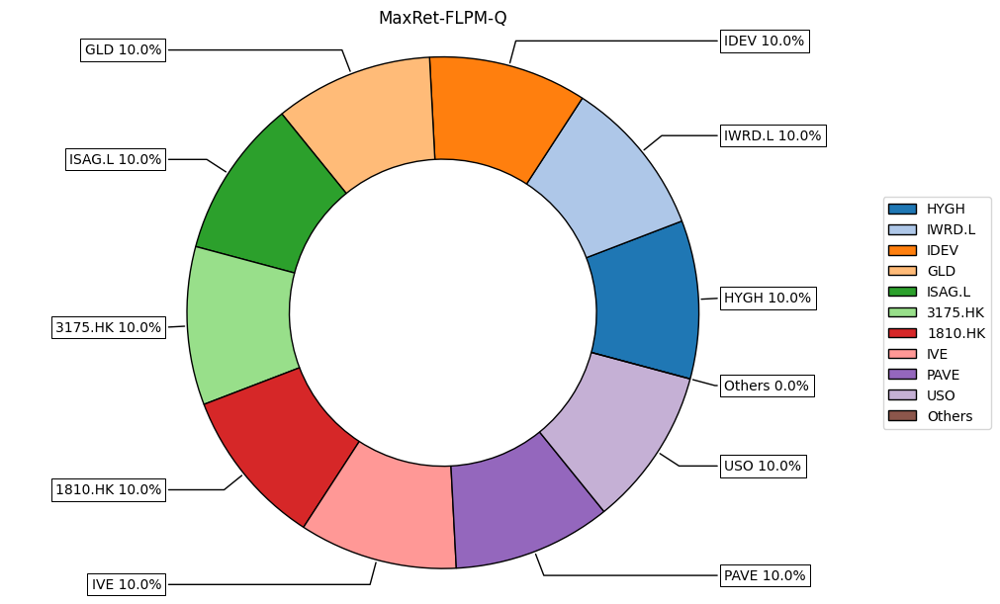

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.1
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.2
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'FLPM',
 'Objective': 'MaxRet',
 'R_Interval': 'Q',
 'Max DrawDown': 0.45501882780938785,
 'CAGR': 0.015063605915950596,
 'Sharpe Ratio': 0.17014133987540994}

batches.length = 1
bt_results.length = 78
('MinRisk', 'S', 'EVaR')
obj=MinRisk,r=S,rm=EVaR
0341.HK          0.0
0405.HK       0.0081
0737.HK       0.0153
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0    0.0649
0P0000VP5F    0.0267
0P0000YVJG    0.0999
0P0001DHN3    0.0001
1186.HK          0.0
1810.HK          0.0
3175.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L        0.0002
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW     0.0009
ERND.L           0.1
GLD              0.0
GOVT          0.0001
HYGH             0.0
HYLD.L           0.0
HYMB             0.0
IAGG          0.0775
IBTS.SW       0.0999
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0993
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0993
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV              0.1
TFLO  

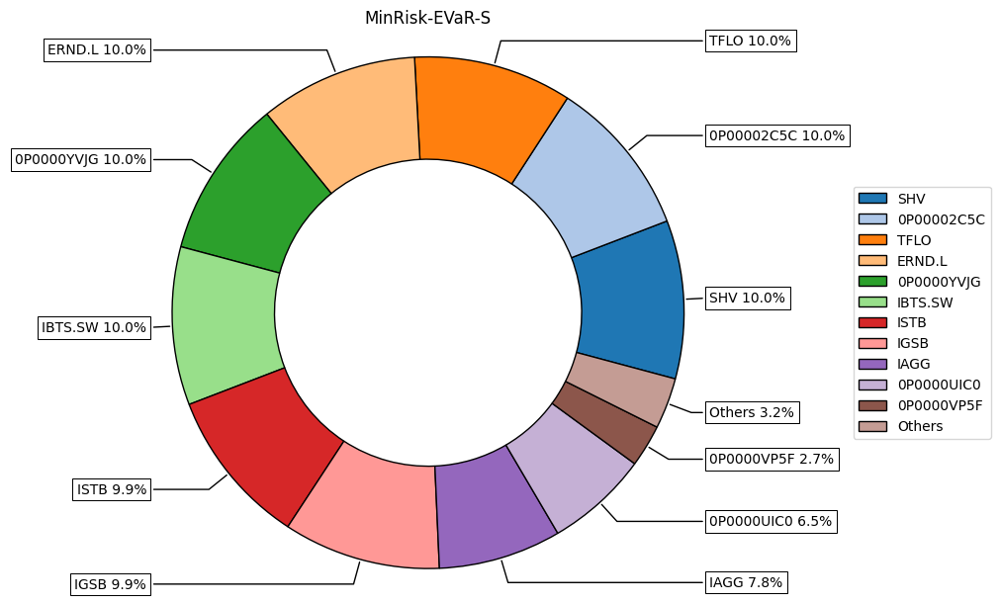

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0081
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0153
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0649
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0267
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0999
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0994
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1073
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0267


{'Risk_measure': 'EVaR',
 'Objective': 'MinRisk',
 'R_Interval': 'S',
 'Max DrawDown': 0.11867015576969411,
 'CAGR': -0.003313076804422022,
 'Sharpe Ratio': -0.10940494207371694}

batches.length = 1
bt_results.length = 78
('MinRisk', 'S', 'MSV')
obj=MinRisk,r=S,rm=MSV
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0    0.0928
0P0000VP5F    0.0916
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK        0.002
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW     0.0017
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0112
HYLD.L           0.0
HYMB             0.0
IAGG          0.0007
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV              0.1
TFLO    

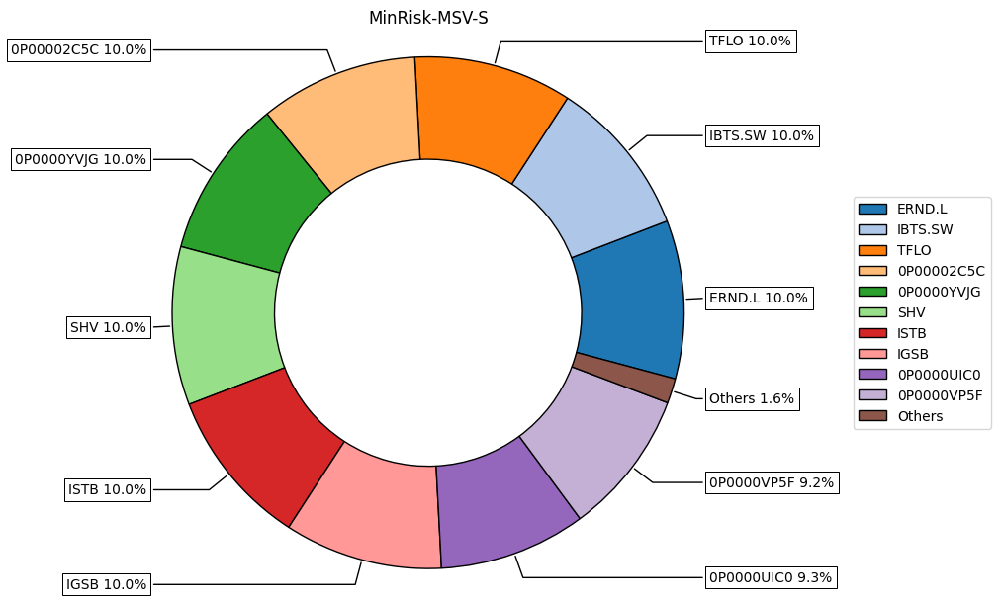

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0928
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0916
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.102
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0916


{'Risk_measure': 'MSV',
 'Objective': 'MinRisk',
 'R_Interval': 'S',
 'Max DrawDown': 0.11050855683595426,
 'CAGR': -0.0030052617120804575,
 'Sharpe Ratio': -0.10999319509890705}

batches.length = 1
bt_results.length = 78
('MinRisk', 'Q', 'UCI')
obj=MinRisk,r=Q,rm=UCI
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.0
0P0000YVJG    0.0948
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0103
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.1
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0509
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0521
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L        0.0691
SHV     

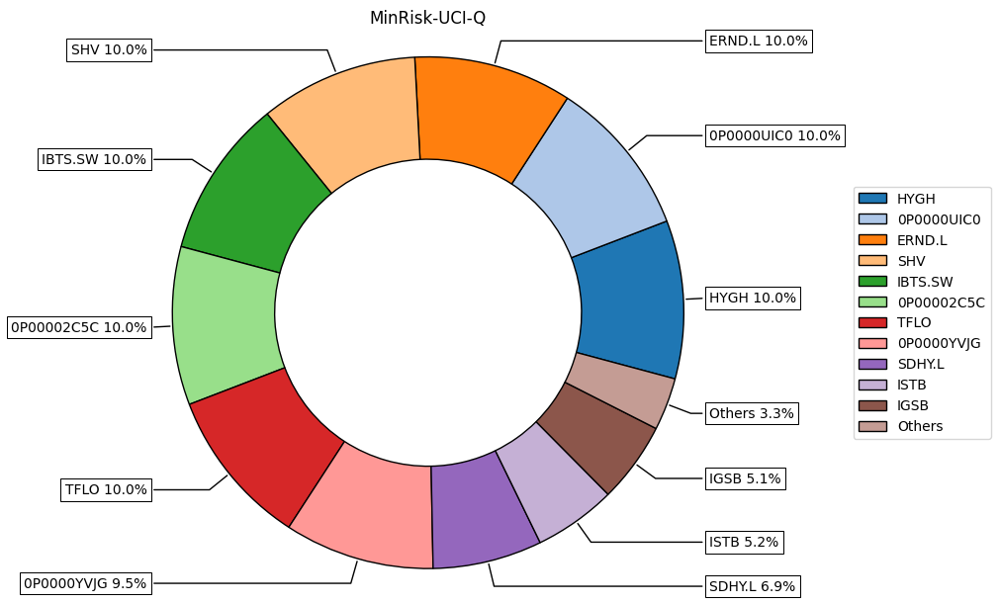

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0948
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0509
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1279
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'UCI',
 'Objective': 'MinRisk',
 'R_Interval': 'Q',
 'Max DrawDown': 0.08626224462329374,
 'CAGR': -0.0006771114033471426,
 'Sharpe Ratio': -0.021960059326665383}

batches.length = 1
bt_results.length = 78
('Sharpe', 'S', 'FLPM')
obj=Sharpe,r=S,rm=FLPM
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.1
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0071
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0591
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0301
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0987
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV              0.1
TFLO    

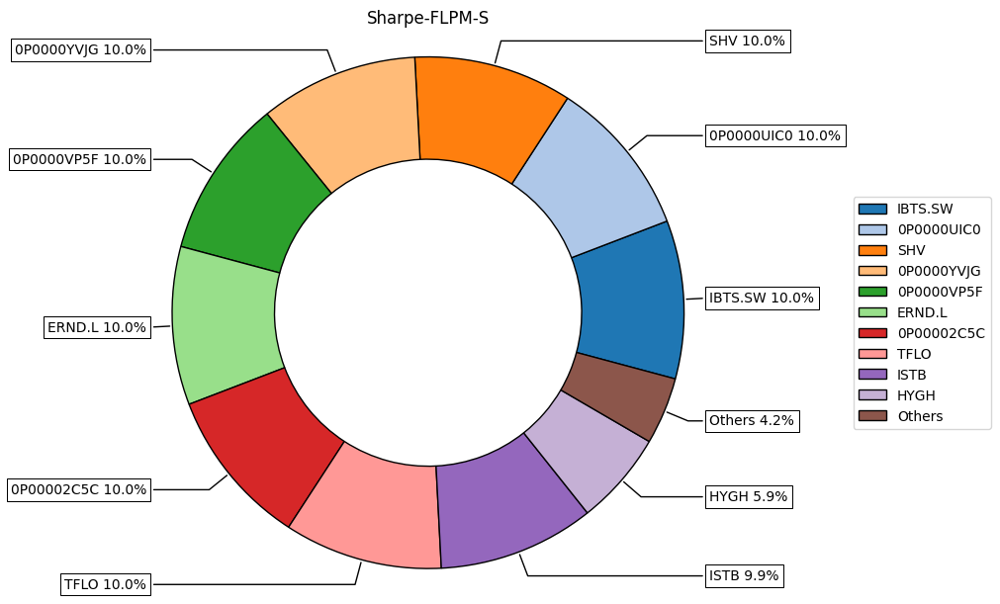

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.1
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0301
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1122
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'FLPM',
 'Objective': 'Sharpe',
 'R_Interval': 'S',
 'Max DrawDown': 0.09796615208242952,
 'CAGR': 0.0008829229023989352,
 'Sharpe Ratio': 0.04633952836185149}

batches.length = 1
bt_results.length = 78
('MaxRet', 'S', 'EVaR')
obj=MaxRet,r=S,rm=EVaR
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.1
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.0
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 2964, dtype: object


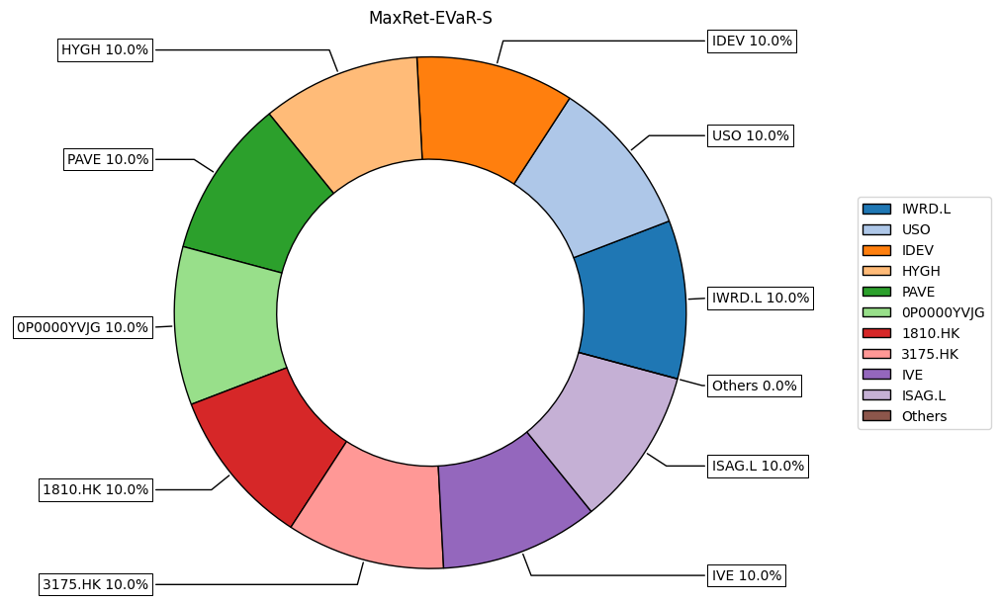

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.3
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'EVaR',
 'Objective': 'MaxRet',
 'R_Interval': 'S',
 'Max DrawDown': 0.4542907064943648,
 'CAGR': 0.017974507271115894,
 'Sharpe Ratio': 0.193202134261516}

batches.length = 1
bt_results.length = 78
('MaxRet', 'S', 'MDD')
obj=MaxRet,r=S,rm=MDD
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.1
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.0
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 2964, dtype: object


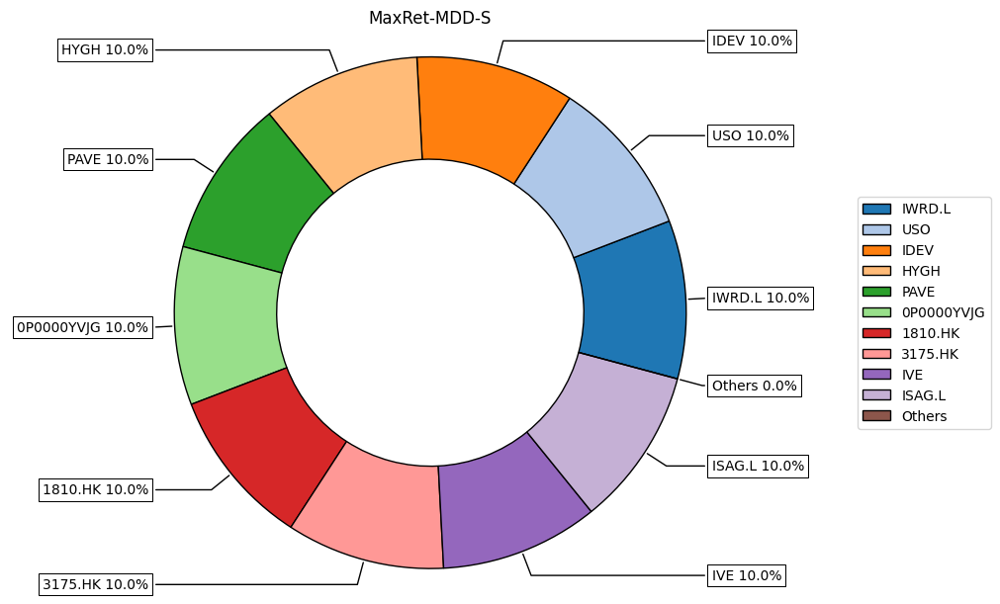

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.3
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'MDD',
 'Objective': 'MaxRet',
 'R_Interval': 'S',
 'Max DrawDown': 0.4542907064943648,
 'CAGR': 0.017974507271115894,
 'Sharpe Ratio': 0.193202134261516}

batches.length = 1
bt_results.length = 78
('MinRisk', 'S', 'WR')
obj=MinRisk,r=S,rm=WR
0341.HK          0.0
0405.HK       0.0334
0737.HK        0.032
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0    0.0911
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.0
HYLD.L           0.0
HYMB             0.0
IAGG          0.0372
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV              0.1
TFLO      

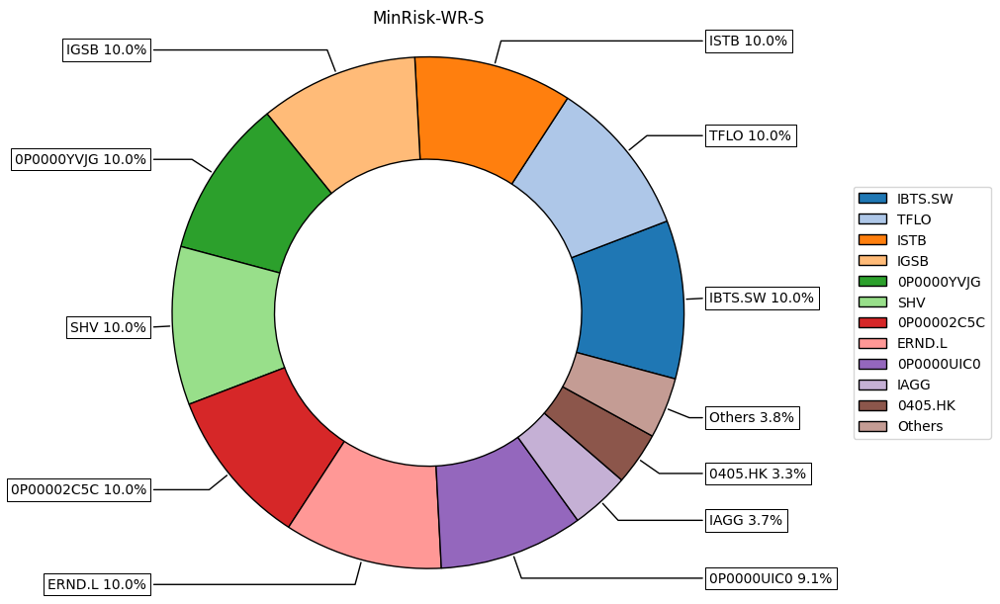

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0334
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.032
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0911
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1064
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'WR',
 'Objective': 'MinRisk',
 'R_Interval': 'S',
 'Max DrawDown': 0.11178321653932384,
 'CAGR': -0.0020073577218640603,
 'Sharpe Ratio': -0.07202014149569001}

batches.length = 1
bt_results.length = 78
('Sharpe', 'Q', 'MSV')
obj=Sharpe,r=Q,rm=MSV
0341.HK          0.0
0405.HK          0.0
0737.HK       0.0001
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F    0.0629
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK       0.0004
1810.HK          0.0
3175.HK       0.0085
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0497
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0663
IVE              0.0
IWRD.L        0.0045
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV       

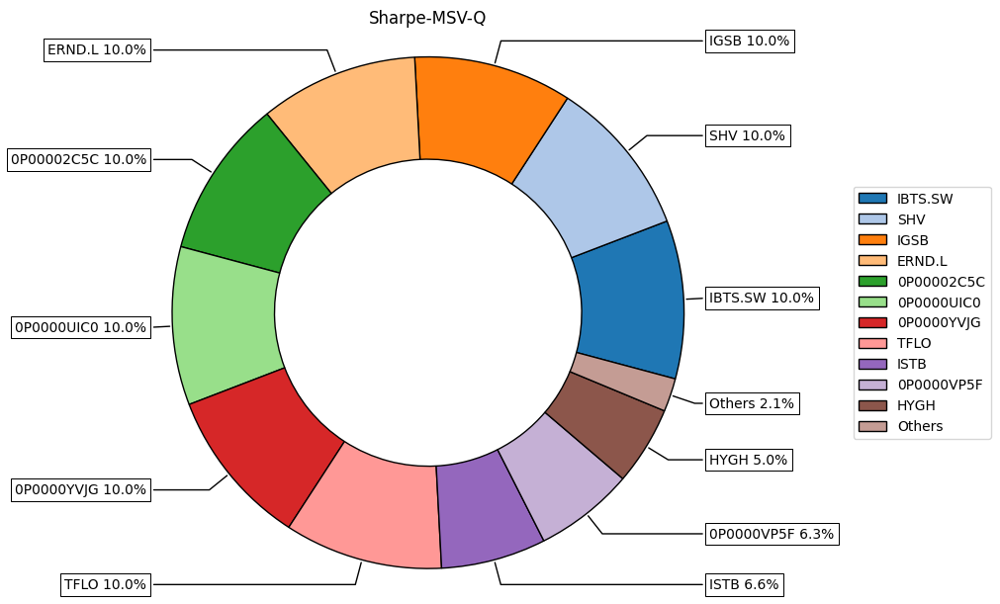

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0001
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0629
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.116
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0629


{'Risk_measure': 'MSV',
 'Objective': 'Sharpe',
 'R_Interval': 'Q',
 'Max DrawDown': 0.12360977260331431,
 'CAGR': 0.0016667548443735666,
 'Sharpe Ratio': 0.07550570512495852}

batches.length = 1
bt_results.length = 78
('Sharpe', 'S', 'CVaR')
obj=Sharpe,r=S,rm=CVaR
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F    0.0438
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0102
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0474
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0787
IVE              0.0
IWRD.L        0.0117
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV              0.1
TFLO    

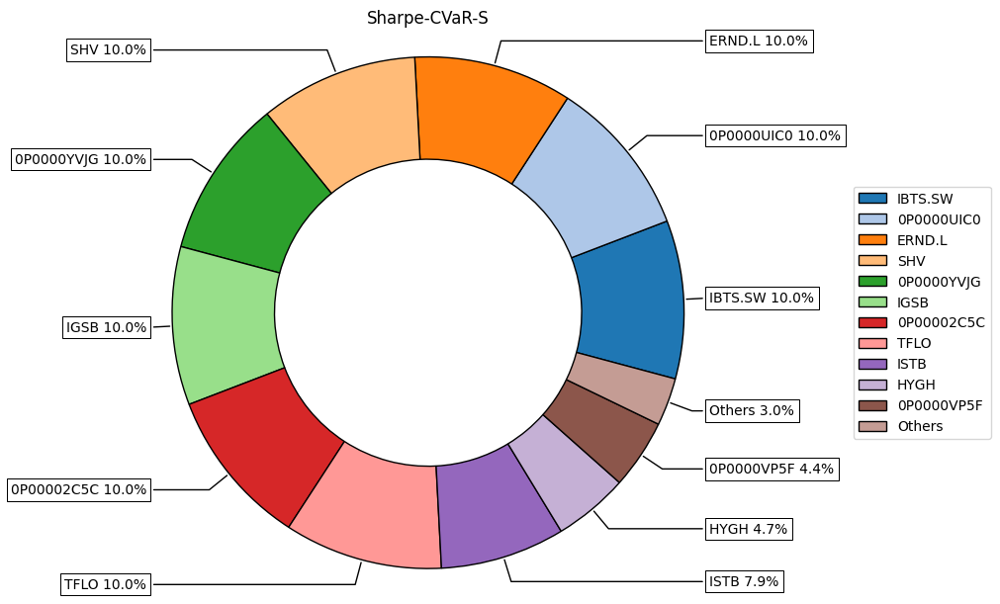

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0438
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1184
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0438


{'Risk_measure': 'CVaR',
 'Objective': 'Sharpe',
 'R_Interval': 'S',
 'Max DrawDown': 0.12076302434915968,
 'CAGR': 0.0016427910485081573,
 'Sharpe Ratio': 0.07088897558033773}

batches.length = 1
bt_results.length = 78
('MinRisk', 'S', 'MDD')
obj=MinRisk,r=S,rm=MDD
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0    0.0264
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0155
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.1
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0259
IVE              0.0
IWRD.L        0.0177
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.1
SHV              0.1
TFLO    

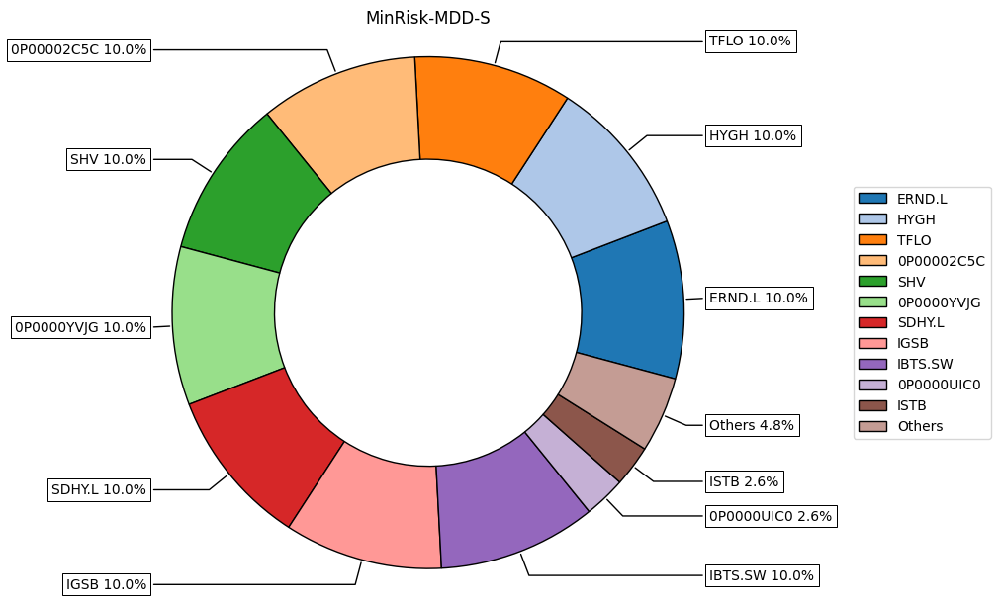

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0264
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.13
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'MDD',
 'Objective': 'MinRisk',
 'R_Interval': 'S',
 'Max DrawDown': 0.11260525235518827,
 'CAGR': -0.00023374813870819335,
 'Sharpe Ratio': 0.0044926678613720706}

batches.length = 1
bt_results.length = 78
('MaxRet', 'S', 'MV')
obj=MaxRet,r=S,rm=MV
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.1
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.0
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 2964, dtype: object


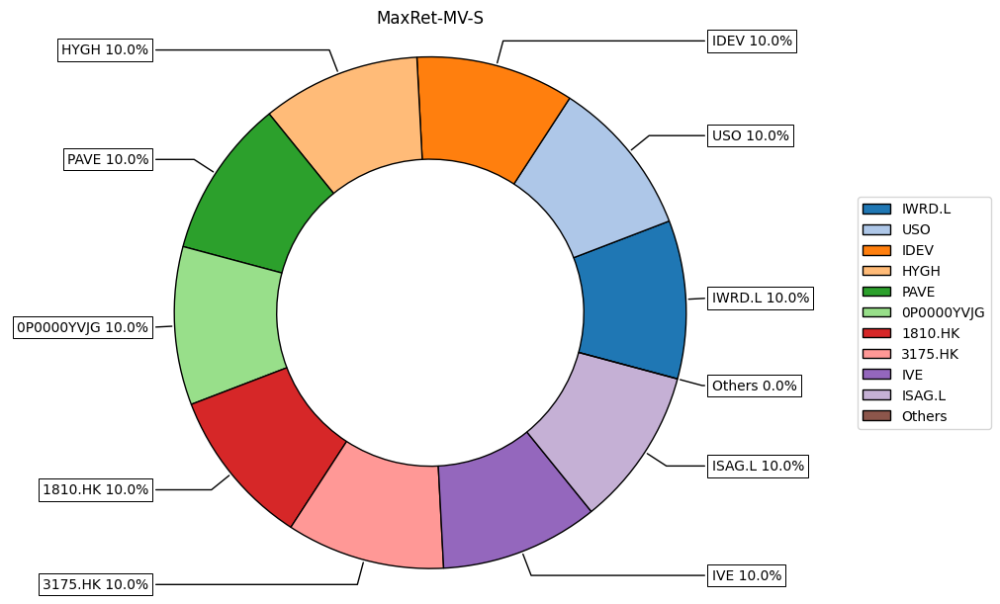

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.3
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'MV',
 'Objective': 'MaxRet',
 'R_Interval': 'S',
 'Max DrawDown': 0.4542907064943648,
 'CAGR': 0.017974507271115894,
 'Sharpe Ratio': 0.193202134261516}

batches.length = 1
bt_results.length = 78
('MaxRet', 'Q', 'WR')
obj=MaxRet,r=Q,rm=WR
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.0
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
3187.HK       0.0
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.1
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 3029, dtype: object


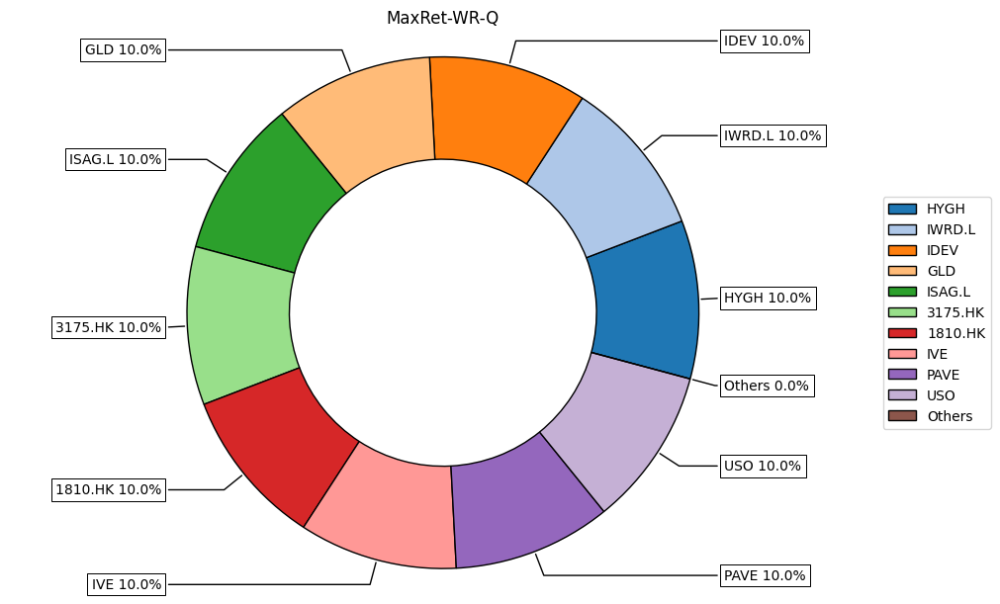

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.1
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.2
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'WR',
 'Objective': 'MaxRet',
 'R_Interval': 'Q',
 'Max DrawDown': 0.45501882780938785,
 'CAGR': 0.015063605915950596,
 'Sharpe Ratio': 0.17014133987540994}

batches.length = 1
bt_results.length = 78
('MinRisk', 'S', 'SLPM')
obj=MinRisk,r=S,rm=SLPM
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0    0.0915
0P0000VP5F     0.088
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0028
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0149
HYLD.L           0.0
HYMB             0.0
IAGG          0.0021
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV              0.1
TFLO  

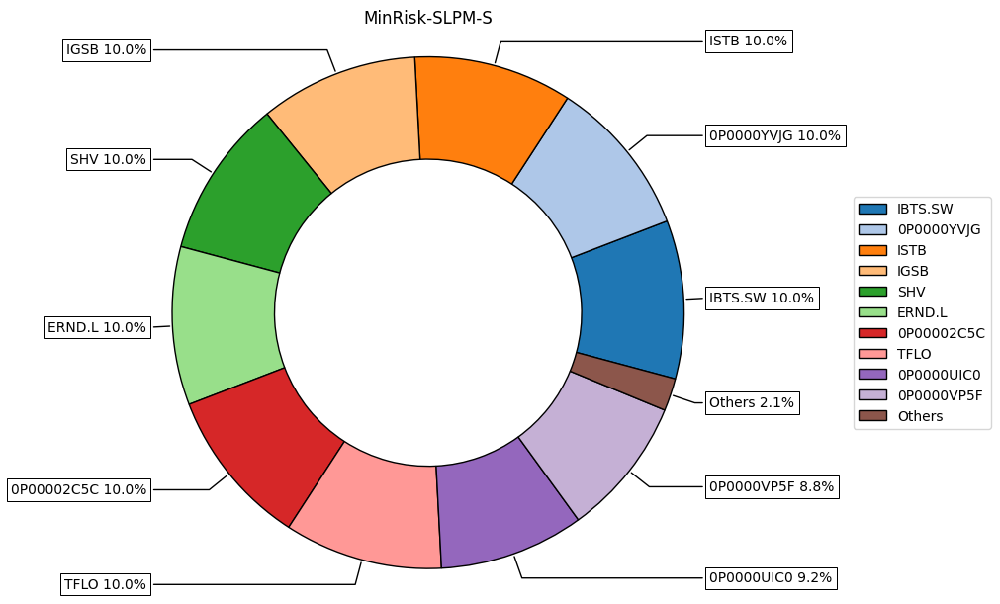

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0915
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.088
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1035
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.088


{'Risk_measure': 'SLPM',
 'Objective': 'MinRisk',
 'R_Interval': 'S',
 'Max DrawDown': 0.11451138367209458,
 'CAGR': -0.003243815498659101,
 'Sharpe Ratio': -0.11626540501633391}

batches.length = 1
bt_results.length = 78
('Sharpe', 'Q', 'UCI')
obj=Sharpe,r=Q,rm=UCI
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0148
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.1
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0409
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.0
IVE              0.0
IWRD.L         0.017
JDN.MX        0.0011
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.1
SHV       

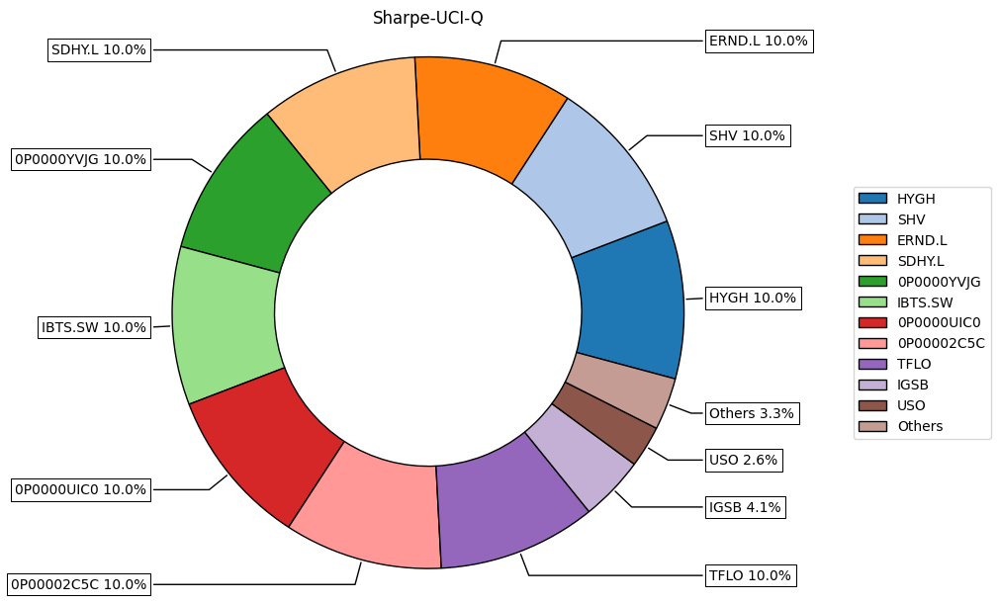

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0011
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0409
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1411
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'UCI',
 'Objective': 'Sharpe',
 'R_Interval': 'Q',
 'Max DrawDown': 0.13529624205479665,
 'CAGR': 0.0003657227291515758,
 'Sharpe Ratio': 0.02754836928785791}

batches.length = 1
bt_results.length = 78
('Sharpe', 'Q', 'SLPM')
obj=Sharpe,r=Q,rm=SLPM
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F    0.0573
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK       0.0006
1810.HK          0.0
3175.HK       0.0091
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD           0.0004
GOVT             0.0
HYGH          0.0489
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0698
IVE              0.0
IWRD.L        0.0059
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV     

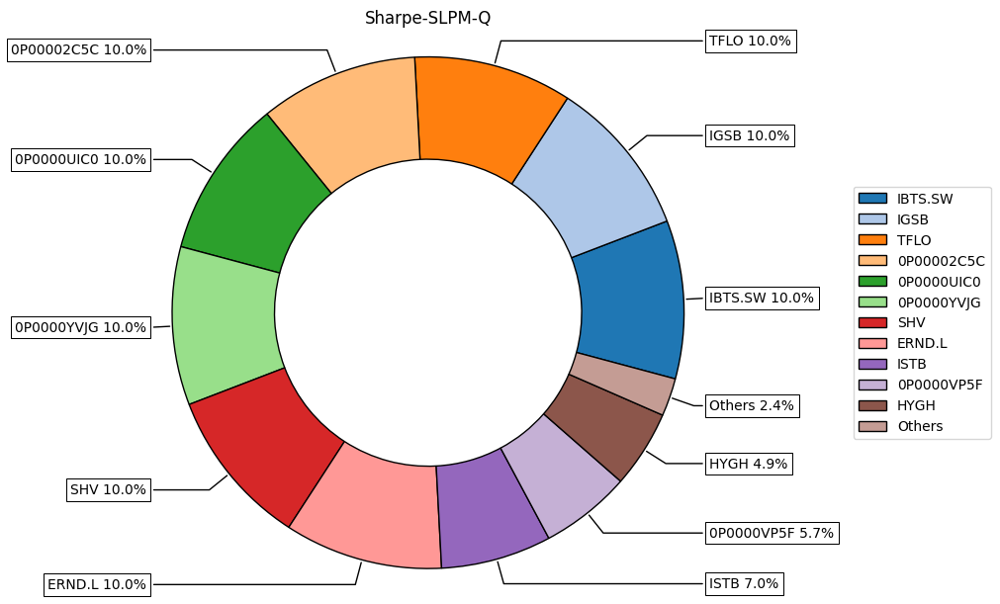

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0573
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0004
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.117
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0573


{'Risk_measure': 'SLPM',
 'Objective': 'Sharpe',
 'R_Interval': 'Q',
 'Max DrawDown': 0.12796190635254037,
 'CAGR': 0.002276387608912337,
 'Sharpe Ratio': 0.09407348298231796}

batches.length = 1
bt_results.length = 78
('MinRisk', 'S', 'ADD')
obj=MinRisk,r=S,rm=ADD
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0096
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.1
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0276
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L        0.0125
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L        0.0334
SHV              0.1
TFLO    

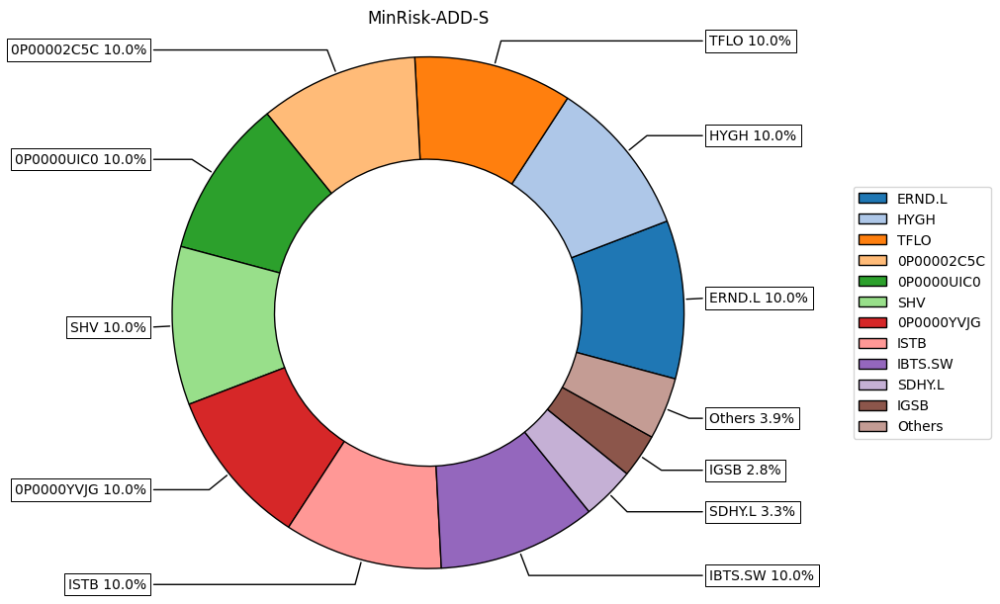

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0276
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1266
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'ADD',
 'Objective': 'MinRisk',
 'R_Interval': 'S',
 'Max DrawDown': 0.07812268660577497,
 'CAGR': 0.0015734376138120103,
 'Sharpe Ratio': 0.0829062309950677}

batches.length = 1
bt_results.length = 78
('Sharpe', 'Q', 'CDaR')
obj=Sharpe,r=Q,rm=CDaR
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0261
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.1
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0221
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.0
IVE              0.0
IWRD.L         0.032
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.1
SHV     

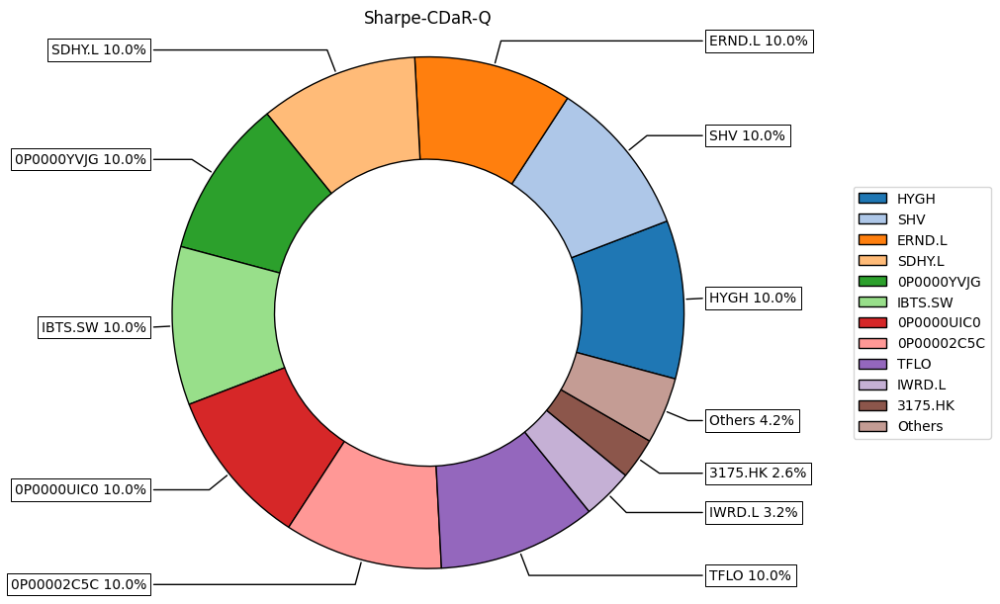

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0221
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1459
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'CDaR',
 'Objective': 'Sharpe',
 'R_Interval': 'Q',
 'Max DrawDown': 0.14770252844929688,
 'CAGR': -0.0006256736823091428,
 'Sharpe Ratio': -0.001143773540608766}

batches.length = 1
bt_results.length = 78
('MinRisk', 'S', 'FLPM')
obj=MinRisk,r=S,rm=FLPM
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.1
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0027
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0213
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0755
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV              0.1
TFLO  

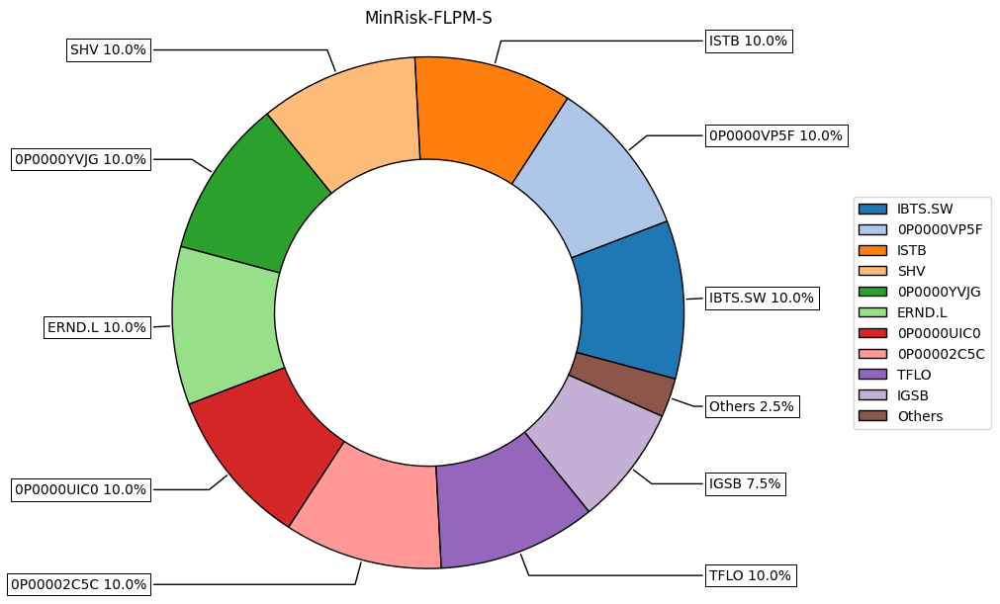

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.1
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0755
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1033
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'FLPM',
 'Objective': 'MinRisk',
 'R_Interval': 'S',
 'Max DrawDown': 0.09748497760726618,
 'CAGR': -0.0016103551475843384,
 'Sharpe Ratio': -0.05925580419649285}

batches.length = 1
bt_results.length = 78
('MaxRet', 'S', 'WR')
obj=MaxRet,r=S,rm=WR
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.1
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.0
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 2964, dtype: object


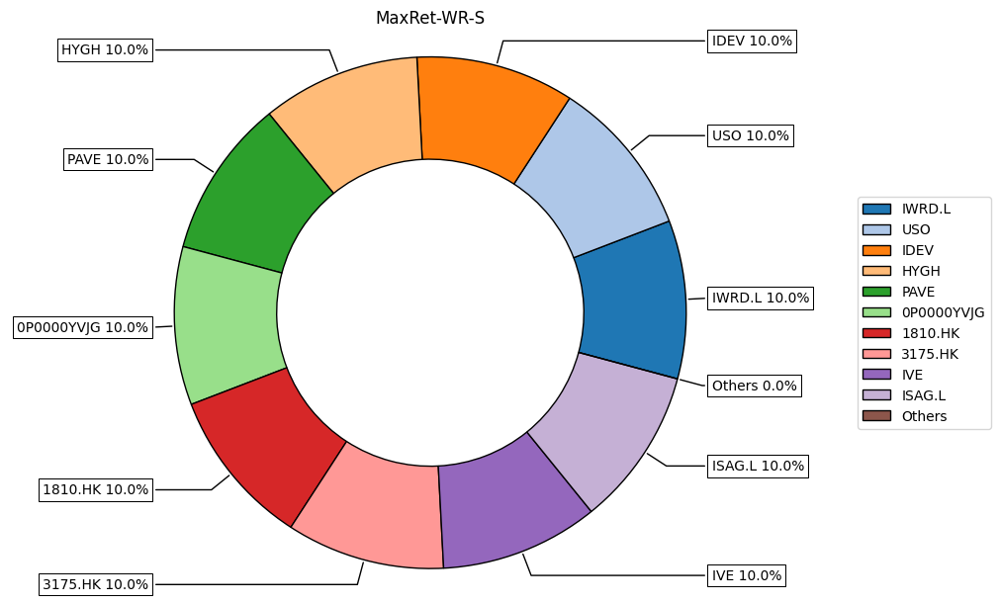

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.3
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'WR',
 'Objective': 'MaxRet',
 'R_Interval': 'S',
 'Max DrawDown': 0.4542907064943648,
 'CAGR': 0.017974507271115894,
 'Sharpe Ratio': 0.193202134261516}

batches.length = 1
bt_results.length = 78
('MaxRet', 'S', 'FLPM')
obj=MaxRet,r=S,rm=FLPM
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.1
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.0
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 2964, dtype: object


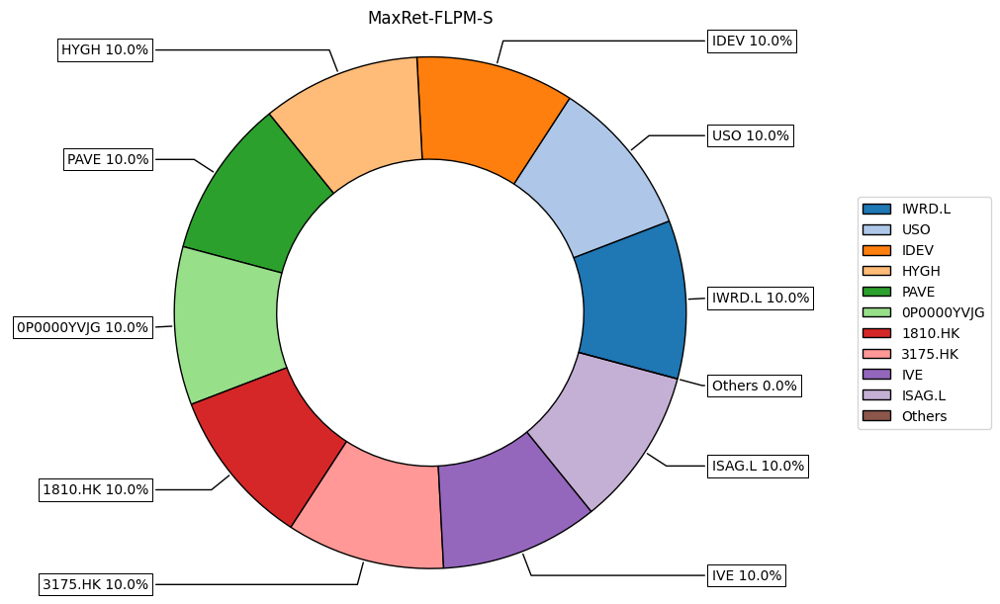

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.3
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'FLPM',
 'Objective': 'MaxRet',
 'R_Interval': 'S',
 'Max DrawDown': 0.4542907064943648,
 'CAGR': 0.017974507271115894,
 'Sharpe Ratio': 0.193202134261516}

batches.length = 1
bt_results.length = 78
('MaxRet', 'S', 'ADD')
obj=MaxRet,r=S,rm=ADD
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.1
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.0
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 2964, dtype: object


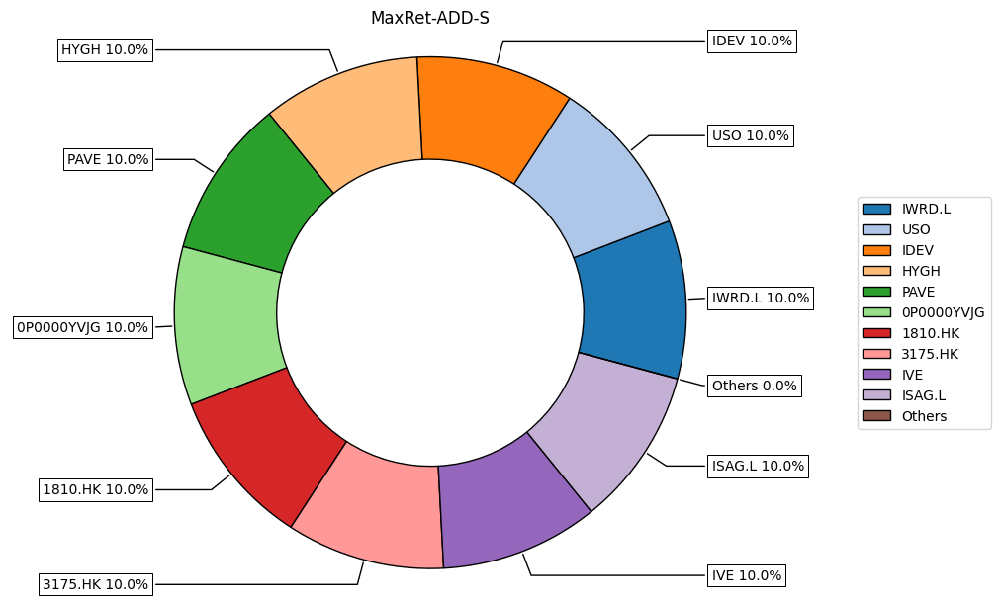

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.3
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'ADD',
 'Objective': 'MaxRet',
 'R_Interval': 'S',
 'Max DrawDown': 0.4542907064943648,
 'CAGR': 0.017974507271115894,
 'Sharpe Ratio': 0.193202134261516}

batches.length = 1
bt_results.length = 78
('MaxRet', 'Q', 'MV')
obj=MaxRet,r=Q,rm=MV
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.0
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
3187.HK       0.0
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.1
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 3029, dtype: object


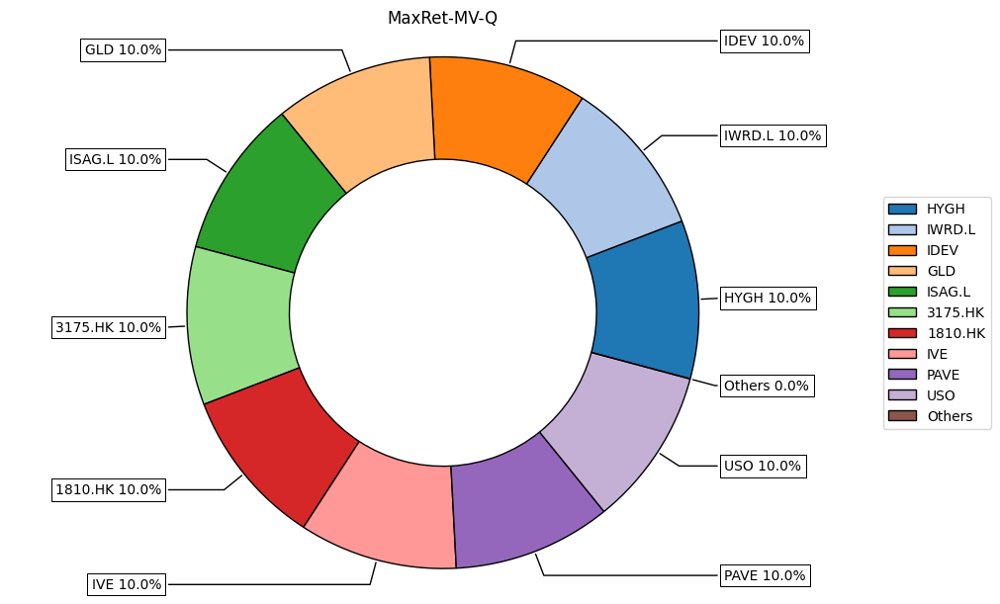

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.1
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.2
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'MV',
 'Objective': 'MaxRet',
 'R_Interval': 'Q',
 'Max DrawDown': 0.45501882780938785,
 'CAGR': 0.015063605915950596,
 'Sharpe Ratio': 0.17014133987540994}

batches.length = 1
bt_results.length = 78
('MinRisk', 'Q', 'MAD')
obj=MinRisk,r=Q,rm=MAD
0341.HK          0.0
0405.HK          0.0
0737.HK       0.0002
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.1
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK       0.0005
1810.HK          0.0
3175.HK       0.0012
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0214
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0759
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV     

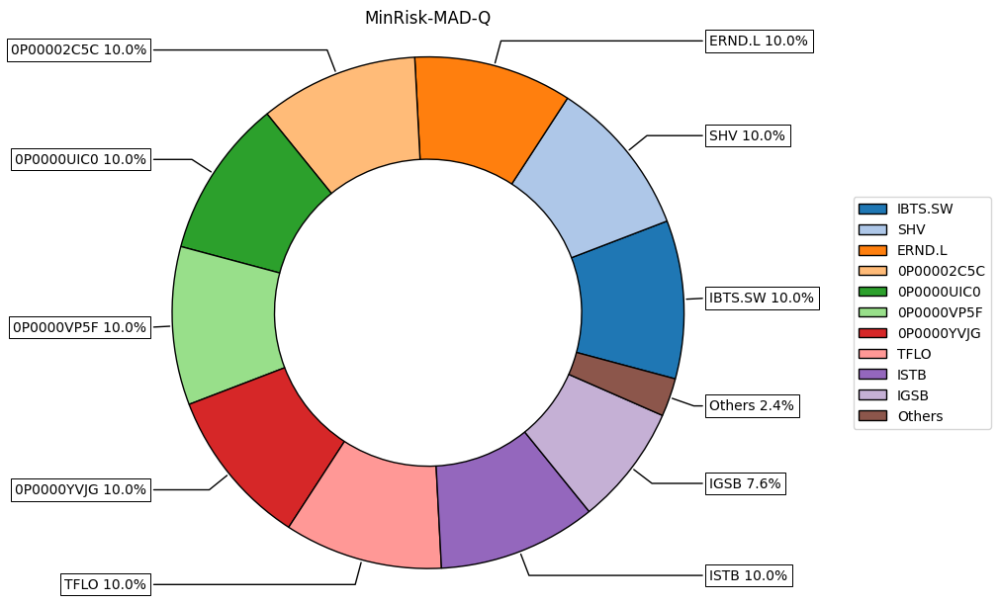

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0002
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.1
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0759
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.102
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'MAD',
 'Objective': 'MinRisk',
 'R_Interval': 'Q',
 'Max DrawDown': 0.1053988964225431,
 'CAGR': -0.00018302003264702662,
 'Sharpe Ratio': 0.006084345411864445}

batches.length = 1
bt_results.length = 78
('MinRisk', 'Q', 'EDaR')
obj=MinRisk,r=Q,rm=EDaR
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0     0.098
0P0000VP5F       0.0
0P0000YVJG    0.0997
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0154
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0999
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0238
IHYU.L           0.0
ISAG.L           0.0
ISTB           0.051
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L        0.0939
SHV   

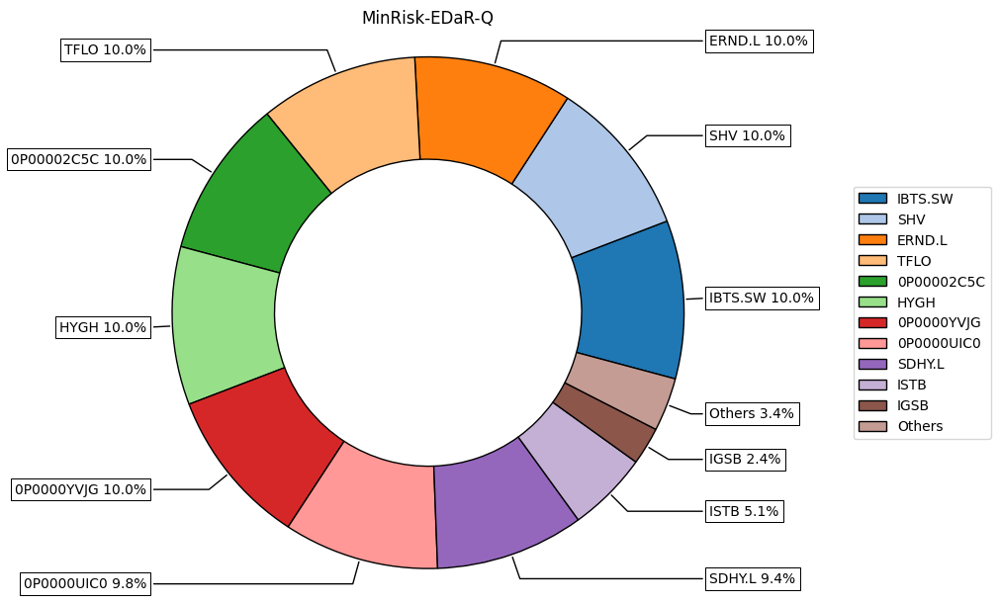

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.098
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0997
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0238
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1334
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'EDaR',
 'Objective': 'MinRisk',
 'R_Interval': 'Q',
 'Max DrawDown': 0.11033655785098256,
 'CAGR': -0.00221803801996098,
 'Sharpe Ratio': -0.06553463595668757}

batches.length = 1
bt_results.length = 78
('Sharpe', 'S', 'CDaR')
obj=Sharpe,r=S,rm=CDaR
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0312
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.1
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.0
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.0
IVE              0.0
IWRD.L        0.0937
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L        0.0499
SHV              0.1
TFLO    

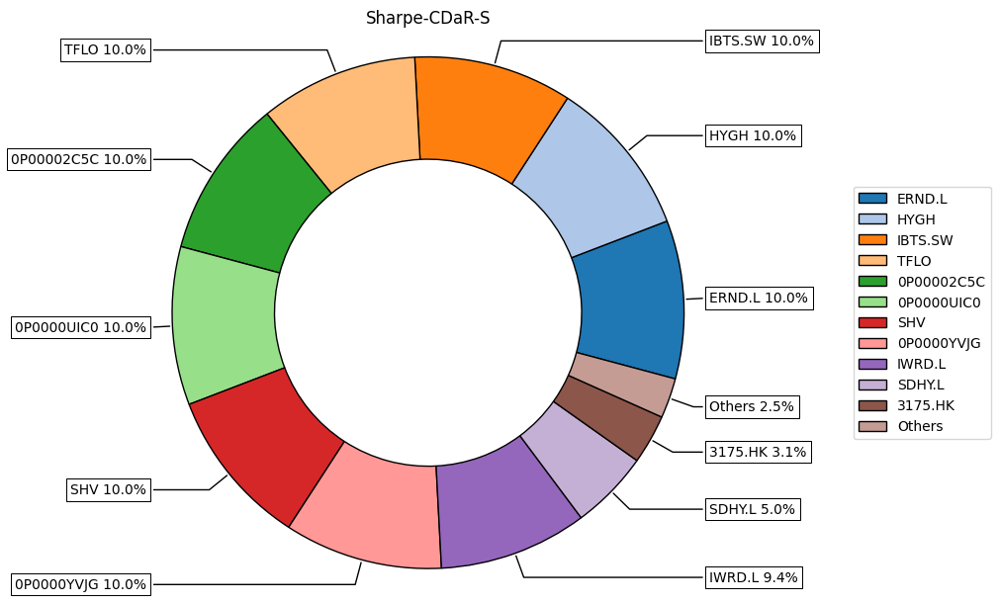

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1564
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'CDaR',
 'Objective': 'Sharpe',
 'R_Interval': 'S',
 'Max DrawDown': 0.1599554433741031,
 'CAGR': -0.0006690746819645316,
 'Sharpe Ratio': 0.0019362218733131392}

batches.length = 1
bt_results.length = 78
('MaxRet', 'Q', 'UCI')
obj=MaxRet,r=Q,rm=UCI
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.0
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
3187.HK       0.0
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.1
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 3029, dtype: object


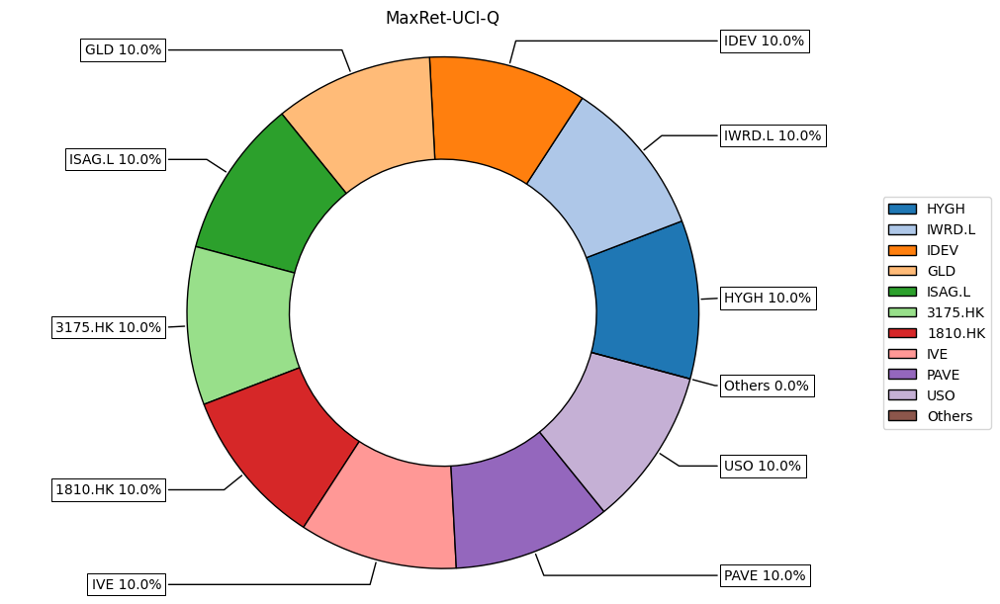

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.1
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.2
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'UCI',
 'Objective': 'MaxRet',
 'R_Interval': 'Q',
 'Max DrawDown': 0.45501882780938785,
 'CAGR': 0.015063605915950596,
 'Sharpe Ratio': 0.17014133987540994}

batches.length = 1
bt_results.length = 78
('MinRisk', 'Q', 'CVaR')
obj=MinRisk,r=Q,rm=CVaR
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F    0.0868
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0016
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0206
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0895
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV   

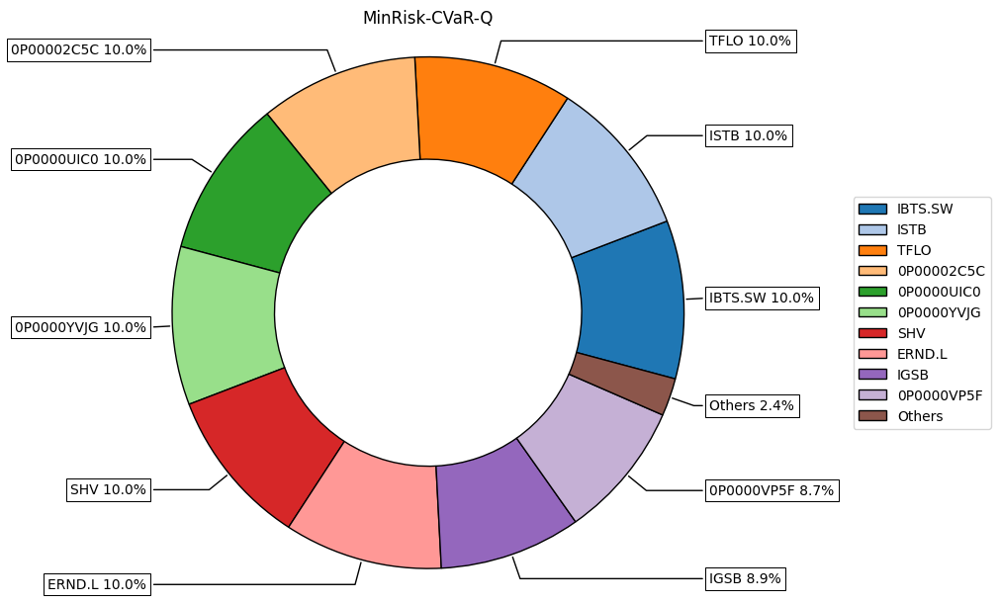

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0868
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0895
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1032
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0868


{'Risk_measure': 'CVaR',
 'Objective': 'MinRisk',
 'R_Interval': 'Q',
 'Max DrawDown': 0.10438675519507519,
 'CAGR': -0.002730250884539639,
 'Sharpe Ratio': -0.10365846326619746}

batches.length = 1
bt_results.length = 78
('Sharpe', 'Q', 'MV')
obj=Sharpe,r=Q,rm=MV
0341.HK          0.0
0405.HK          0.0
0737.HK       0.0014
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F     0.083
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK       0.0003
1810.HK          0.0
3175.HK        0.009
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0481
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0478
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L        0.0033
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV         

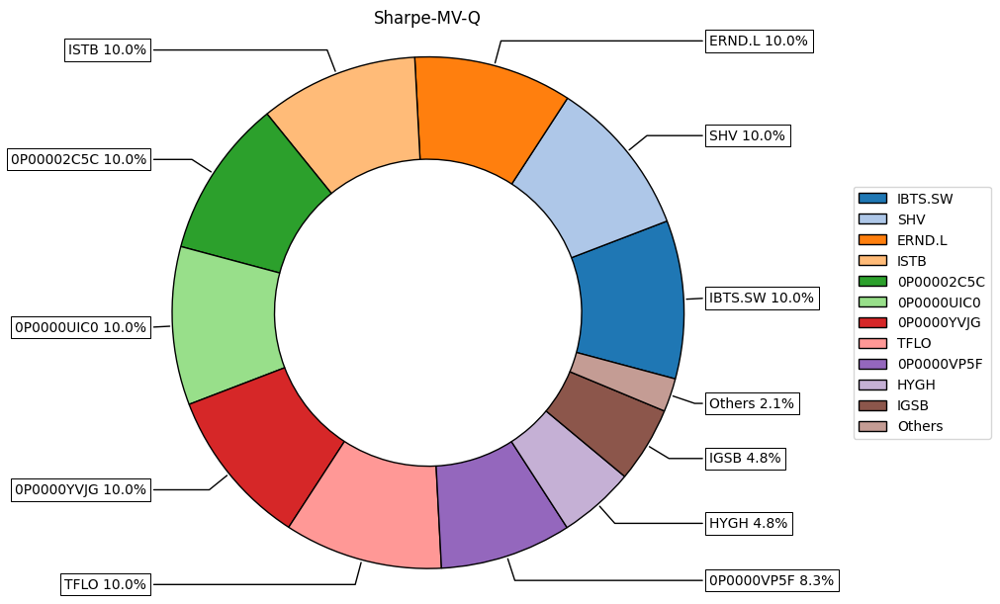

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0014
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.083
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0478
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1161
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.083


{'Risk_measure': 'MV',
 'Objective': 'Sharpe',
 'R_Interval': 'Q',
 'Max DrawDown': 0.1223245950917124,
 'CAGR': 0.0016210858730453899,
 'Sharpe Ratio': 0.07146119549141967}

batches.length = 1
bt_results.length = 78
('Sharpe', 'S', 'MSV')
obj=Sharpe,r=S,rm=MSV
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F    0.0547
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0112
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0592
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0566
IVE              0.0
IWRD.L        0.0095
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV              0.1
TFLO      

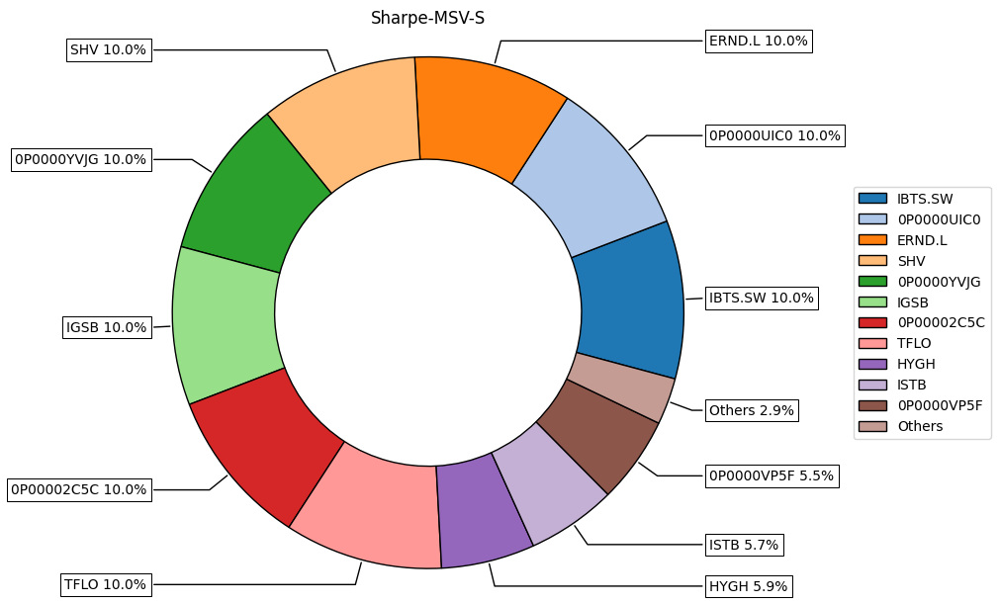

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0547
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1199
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0547


{'Risk_measure': 'MSV',
 'Objective': 'Sharpe',
 'R_Interval': 'S',
 'Max DrawDown': 0.10352569751507185,
 'CAGR': 0.0021944000696635384,
 'Sharpe Ratio': 0.09774002318609258}

batches.length = 1
bt_results.length = 78
('Sharpe', 'Q', 'MAD')
obj=Sharpe,r=Q,rm=MAD
0341.HK          0.0
0405.HK          0.0
0737.HK       0.0008
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.1
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0053
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0514
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB           0.038
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV       

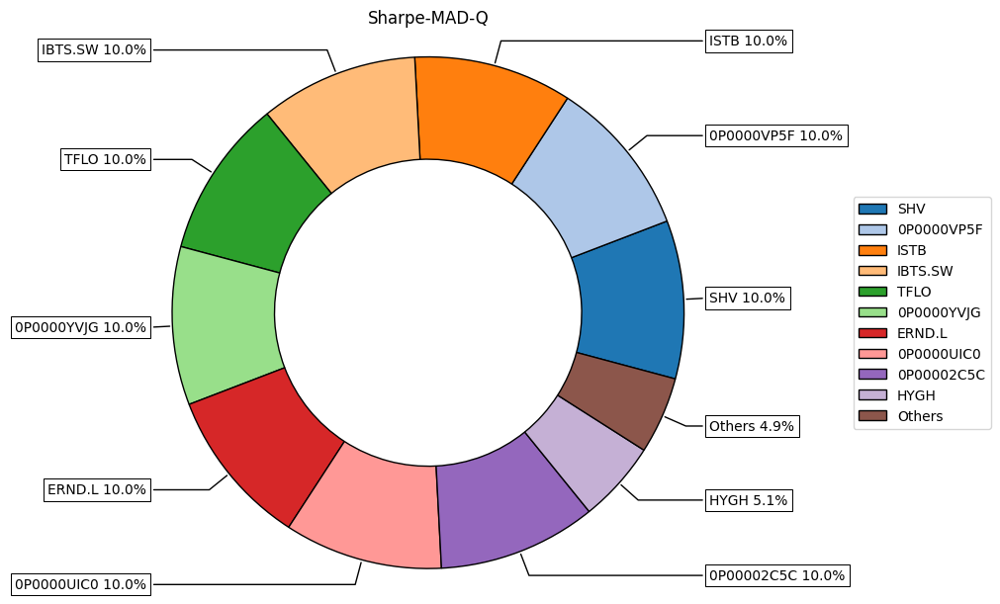

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0008
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.1
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.038
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1098
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'MAD',
 'Objective': 'Sharpe',
 'R_Interval': 'Q',
 'Max DrawDown': 0.09603925909825424,
 'CAGR': 0.0002674232243553525,
 'Sharpe Ratio': 0.02357810583933139}

batches.length = 1
bt_results.length = 78
('Sharpe', 'S', 'MDD')
obj=Sharpe,r=S,rm=MDD
0341.HK         0.0
0405.HK         0.0
0737.HK         0.0
0P00001DU6      0.0
0P00002C5C      0.1
0P0000UIC0    0.034
0P0000VP5F      0.0
0P0000YVJG      0.1
0P0001DHN3      0.0
1186.HK         0.0
1810.HK         0.0
3175.HK       0.066
9988.HK         0.0
ADDYY           0.0
AGGU.L          0.0
ARKG            0.0
ARKK            0.0
BABA            0.0
CSBGU7.SW       0.0
ERND.L          0.1
GLD             0.0
GOVT            0.0
HYGH            0.1
HYLD.L          0.0
HYMB            0.0
IAGG            0.0
IBTS.SW         0.1
IDEV            0.0
IDTL.L          0.0
IDTM.L          0.0
IEMB.L          0.0
IGIL.L          0.0
IGSB            0.0
IHYU.L          0.0
ISAG.L          0.0
ISTB            0.0
IVE             0.0
IWRD.L          0.1
JDN.MX          0.0
LQDE.L          0.0
PAVE            0.0
SDHY.L          0.1
SHV             0.1
TFLO            0.1
USO             0.0
ZM           

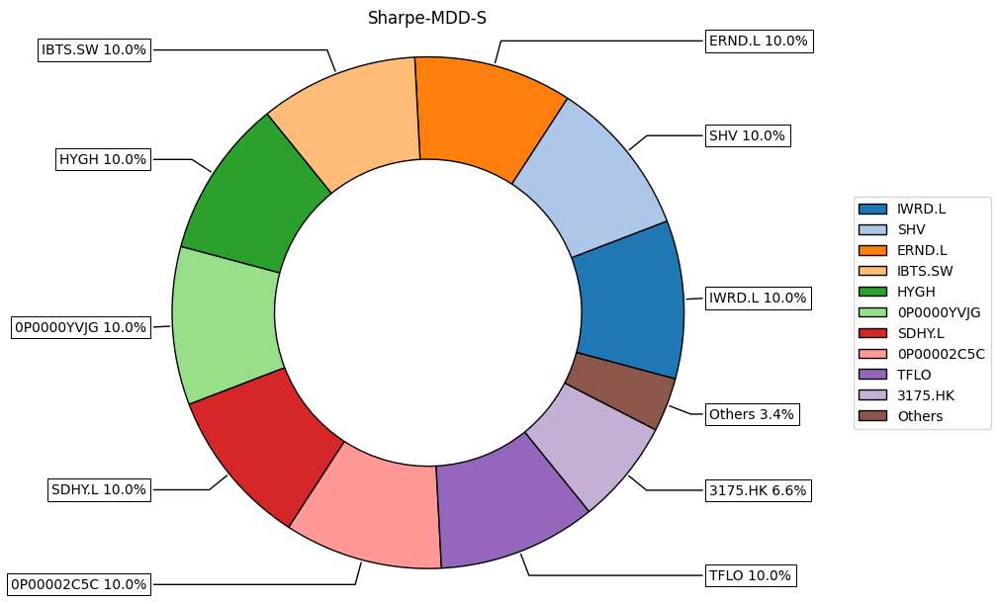

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.034
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.166
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'MDD',
 'Objective': 'Sharpe',
 'R_Interval': 'S',
 'Max DrawDown': 0.18669938486307092,
 'CAGR': -0.0021986398265563326,
 'Sharpe Ratio': -0.034159972707586195}

batches.length = 1
bt_results.length = 78
('MinRisk', 'Q', 'MDD')
obj=MinRisk,r=Q,rm=MDD
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0    0.0264
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0155
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.1
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0259
IVE              0.0
IWRD.L        0.0177
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.1
SHV     

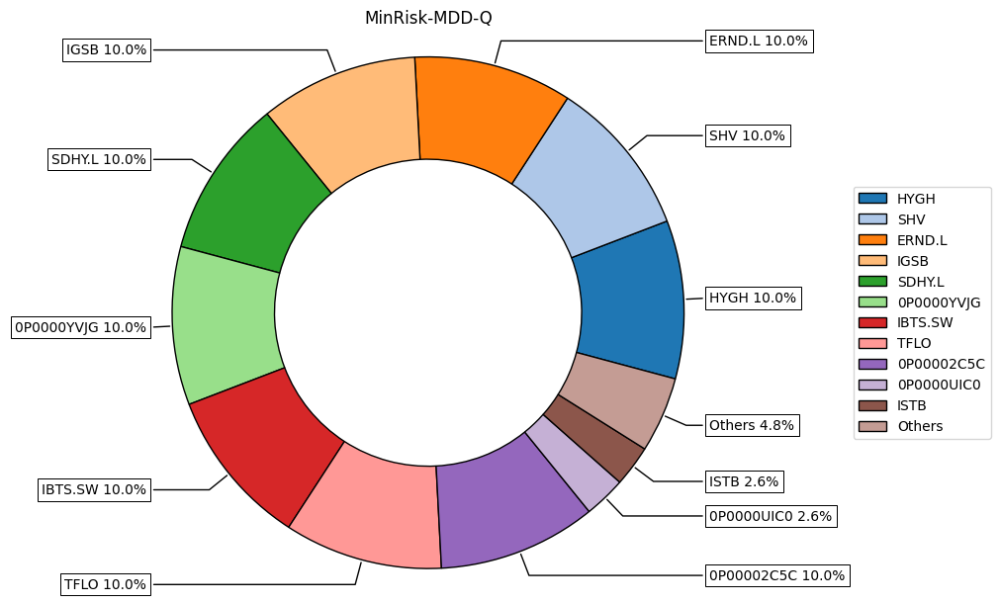

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0264
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.13
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'MDD',
 'Objective': 'MinRisk',
 'R_Interval': 'Q',
 'Max DrawDown': 0.12286118776704127,
 'CAGR': -0.0026639369926741018,
 'Sharpe Ratio': -0.0771946169051327}

batches.length = 1
bt_results.length = 78
('MaxRet', 'S', 'EDaR')
obj=MaxRet,r=S,rm=EDaR
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.1
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.0
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 2964, dtype: object


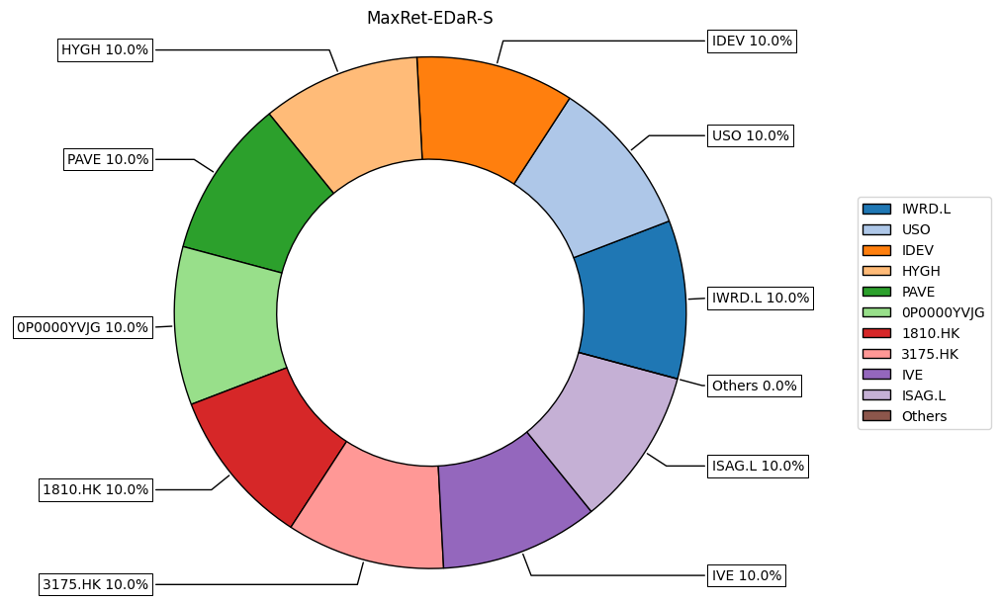

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.3
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'EDaR',
 'Objective': 'MaxRet',
 'R_Interval': 'S',
 'Max DrawDown': 0.4542907064943648,
 'CAGR': 0.017974507271115894,
 'Sharpe Ratio': 0.193202134261516}

batches.length = 1
bt_results.length = 78
('MinRisk', 'Q', 'EVaR')
obj=MinRisk,r=Q,rm=EVaR
0341.HK          0.0
0405.HK       0.0079
0737.HK       0.0152
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0    0.0645
0P0000VP5F    0.0292
0P0000YVJG    0.0999
0P0001DHN3    0.0001
1186.HK          0.0
1810.HK          0.0
3175.HK          0.0
3187.HK       0.0001
9988.HK          0.0
ADDYY            0.0
AGGU.L        0.0002
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW      0.001
ERND.L           0.1
GLD              0.0
GOVT          0.0001
HYGH             0.0
HYLD.L           0.0
HYMB             0.0
IAGG          0.0754
IBTS.SW       0.0999
IDEV             0.0
IDTL.L           0.0
IDTM.L        0.0001
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0993
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0993
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV   

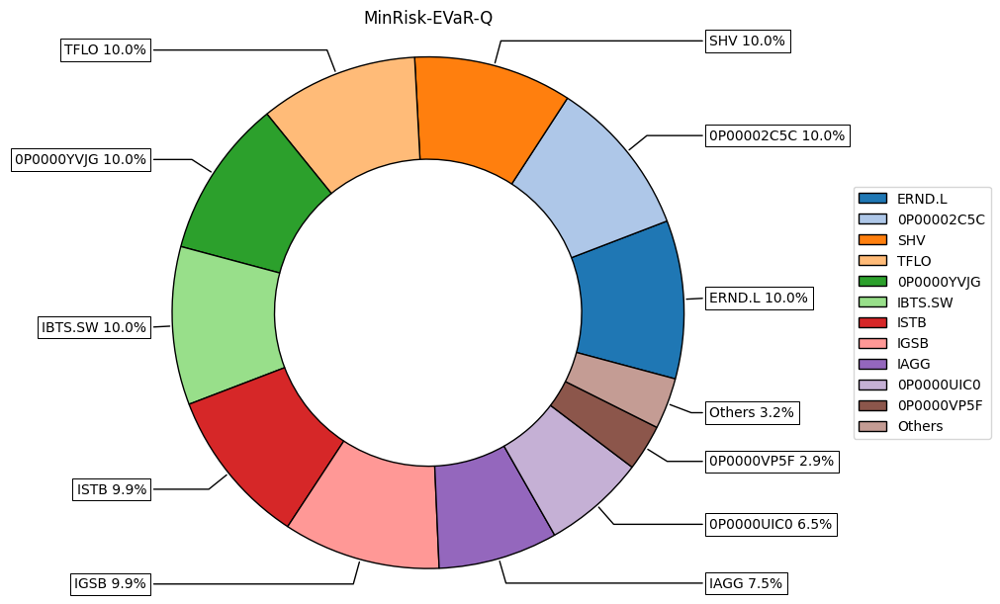

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0079
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0152
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0645
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0292
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0999
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0994
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1075
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0292


{'Risk_measure': 'EVaR',
 'Objective': 'MinRisk',
 'R_Interval': 'Q',
 'Max DrawDown': 0.1266761061142117,
 'CAGR': -0.004558947864077731,
 'Sharpe Ratio': -0.14887244690508933}

batches.length = 1
bt_results.length = 78
('MaxRet', 'Q', 'MAD')
obj=MaxRet,r=Q,rm=MAD
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.0
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
3187.HK       0.0
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.1
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 3029, dtype: object


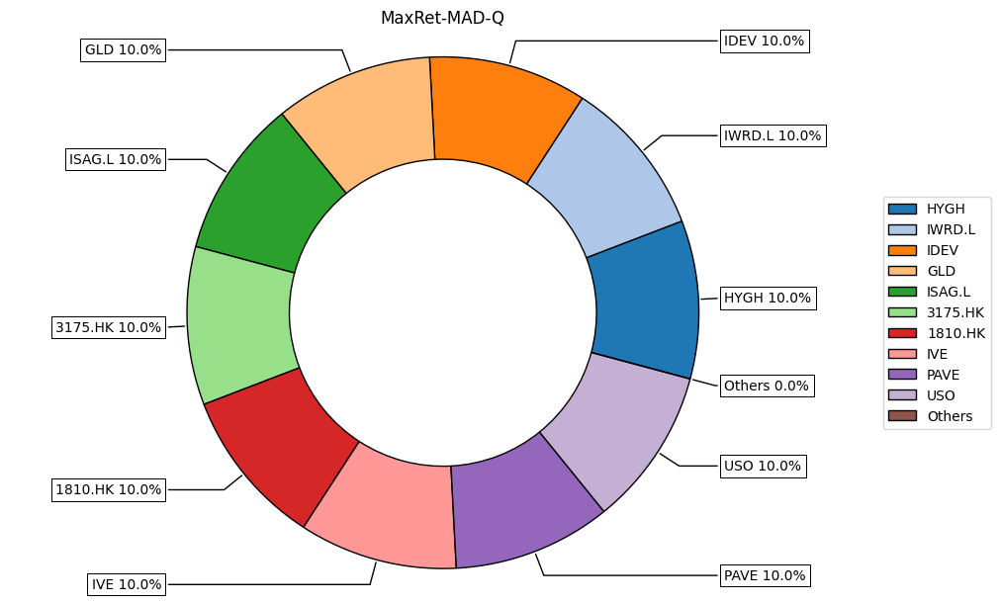

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.1
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.2
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'MAD',
 'Objective': 'MaxRet',
 'R_Interval': 'Q',
 'Max DrawDown': 0.45501882780938785,
 'CAGR': 0.015063605915950596,
 'Sharpe Ratio': 0.17014133987540994}

batches.length = 1
bt_results.length = 78
('MaxRet', 'Q', 'EDaR')
obj=MaxRet,r=Q,rm=EDaR
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.0
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
3187.HK       0.0
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.1
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 3029, dtype: object


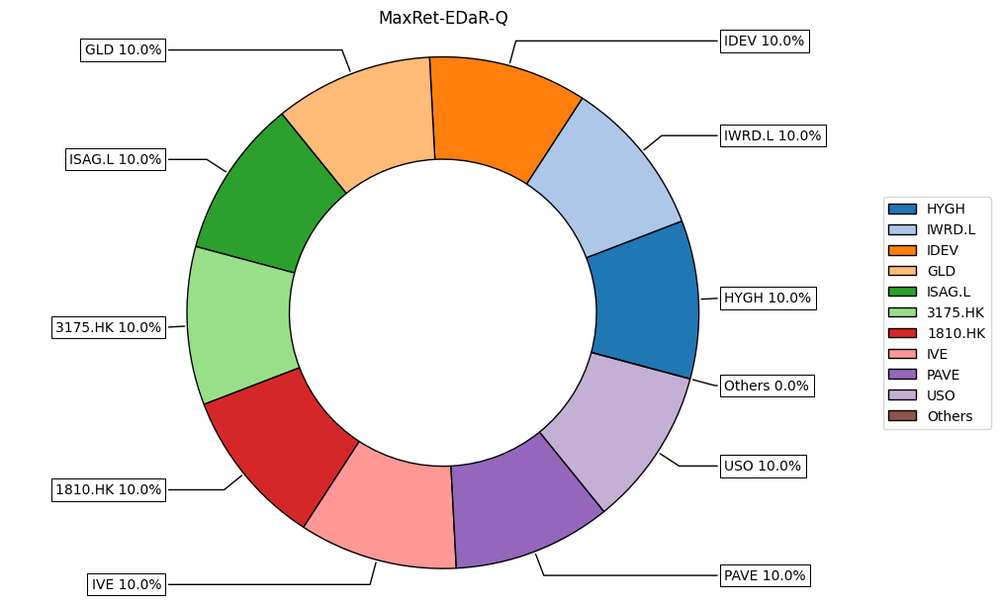

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.1
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.2
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'EDaR',
 'Objective': 'MaxRet',
 'R_Interval': 'Q',
 'Max DrawDown': 0.45501882780938785,
 'CAGR': 0.015063605915950596,
 'Sharpe Ratio': 0.17014133987540994}

batches.length = 1
bt_results.length = 78
('MaxRet', 'S', 'MAD')
obj=MaxRet,r=S,rm=MAD
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.1
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.0
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 2964, dtype: object


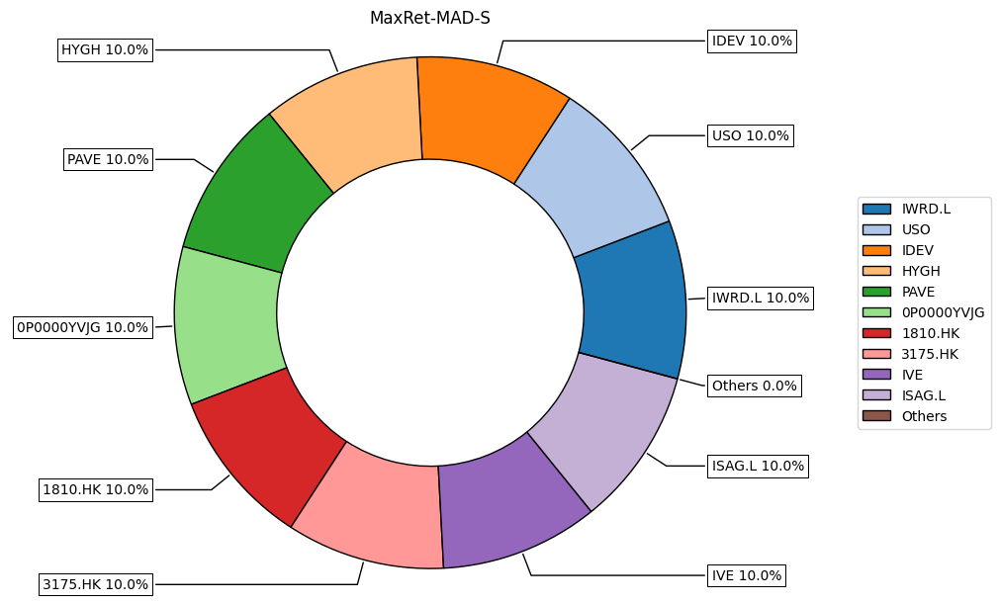

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.3
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'MAD',
 'Objective': 'MaxRet',
 'R_Interval': 'S',
 'Max DrawDown': 0.4542907064943648,
 'CAGR': 0.017974507271115894,
 'Sharpe Ratio': 0.193202134261516}

batches.length = 1
bt_results.length = 78
('MaxRet', 'S', 'SLPM')
obj=MaxRet,r=S,rm=SLPM
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.1
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.0
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 2964, dtype: object


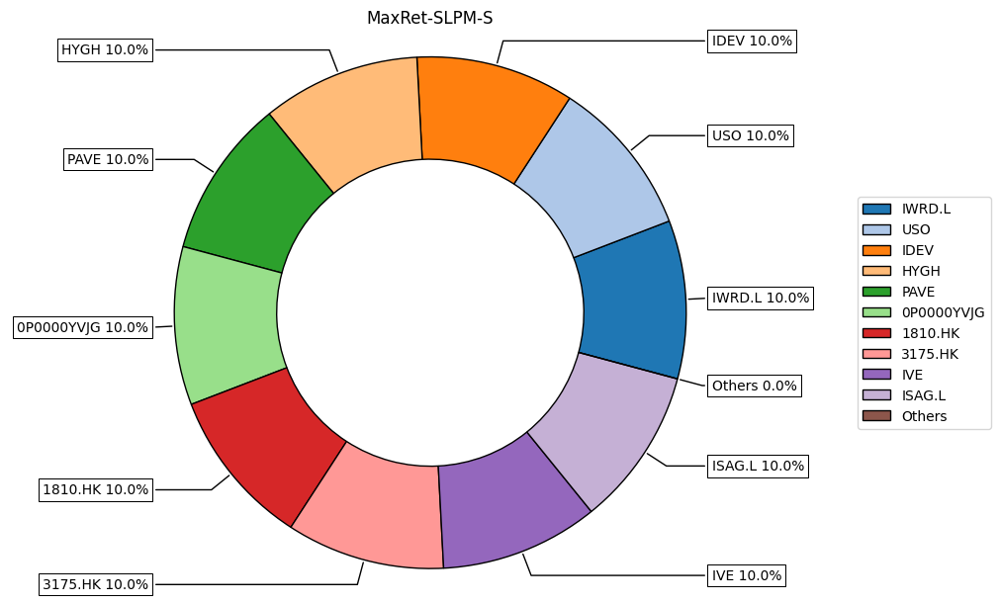

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.3
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'SLPM',
 'Objective': 'MaxRet',
 'R_Interval': 'S',
 'Max DrawDown': 0.4542907064943648,
 'CAGR': 0.017974507271115894,
 'Sharpe Ratio': 0.193202134261516}

batches.length = 1
bt_results.length = 78
('MaxRet', 'Q', 'MSV')
obj=MaxRet,r=Q,rm=MSV
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.0
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
3187.HK       0.0
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.1
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 3029, dtype: object


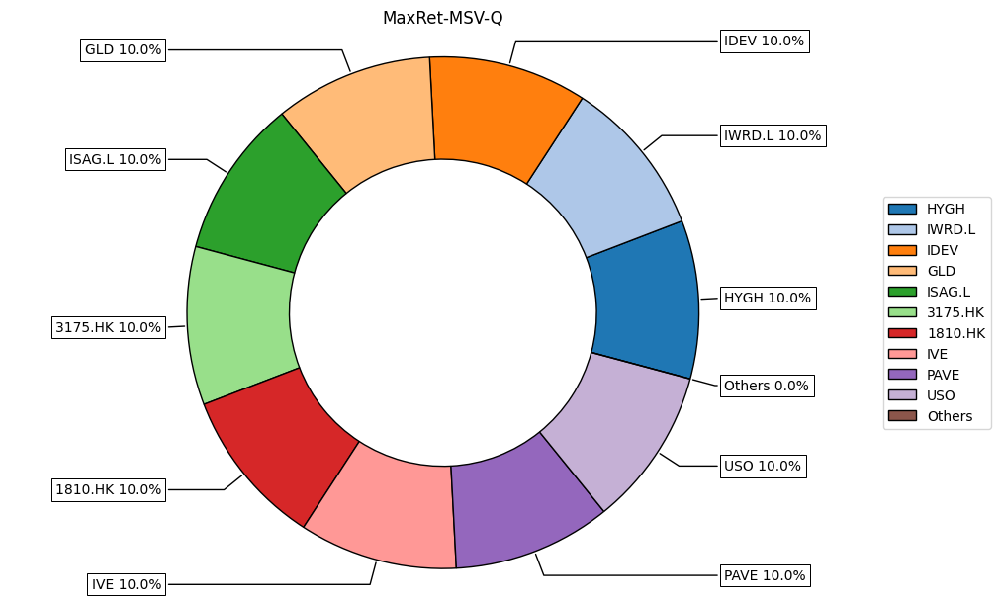

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.1
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.2
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'MSV',
 'Objective': 'MaxRet',
 'R_Interval': 'Q',
 'Max DrawDown': 0.45501882780938785,
 'CAGR': 0.015063605915950596,
 'Sharpe Ratio': 0.17014133987540994}

batches.length = 1
bt_results.length = 78
('MaxRet', 'Q', 'CVaR')
obj=MaxRet,r=Q,rm=CVaR
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.0
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
3187.HK       0.0
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.1
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 3029, dtype: object


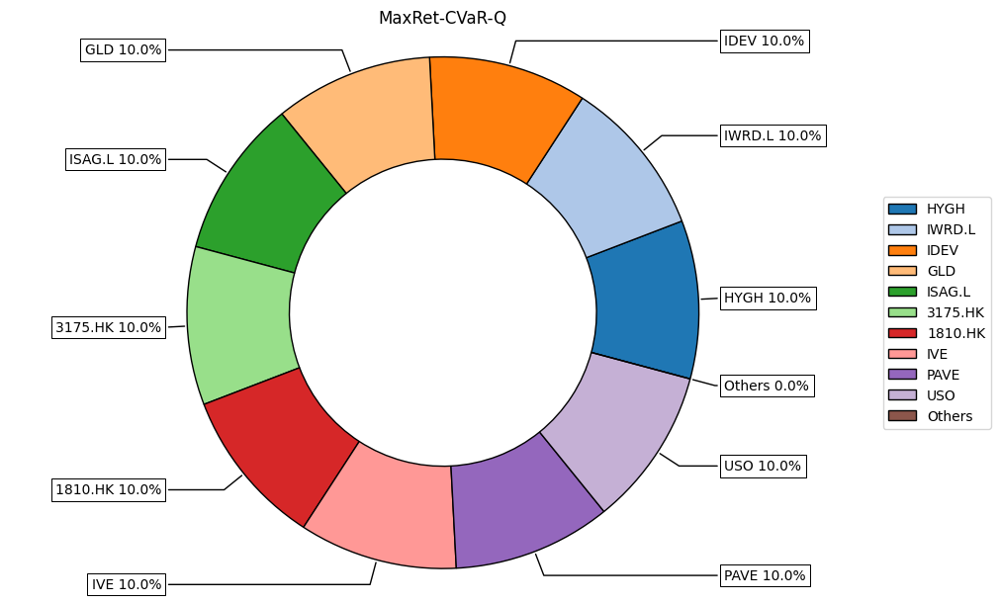

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.1
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.2
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'CVaR',
 'Objective': 'MaxRet',
 'R_Interval': 'Q',
 'Max DrawDown': 0.45501882780938785,
 'CAGR': 0.015063605915950596,
 'Sharpe Ratio': 0.17014133987540994}

batches.length = 1
bt_results.length = 78
('MaxRet', 'S', 'UCI')
obj=MaxRet,r=S,rm=UCI
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.1
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.0
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 2964, dtype: object


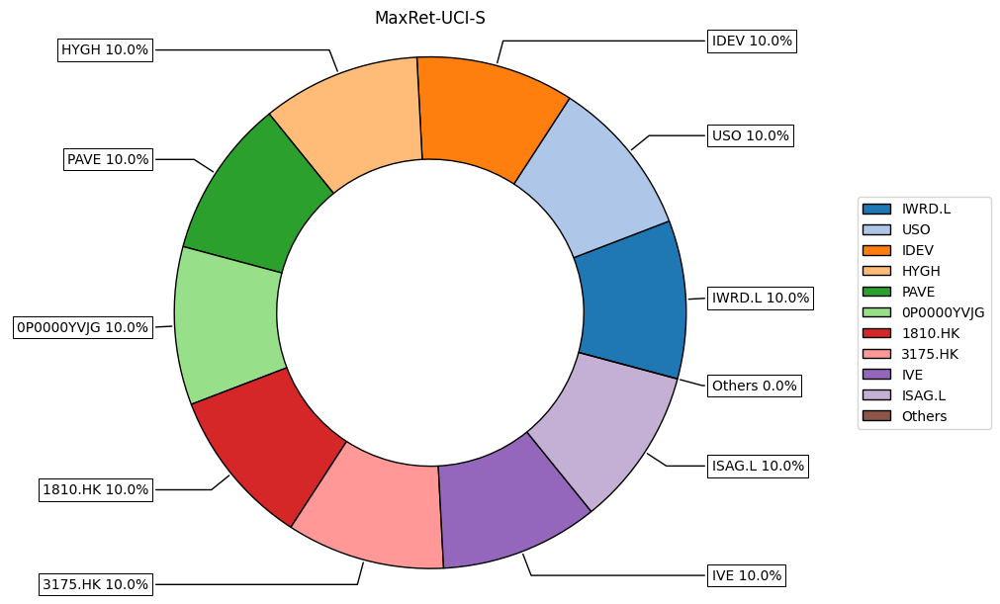

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.3
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'UCI',
 'Objective': 'MaxRet',
 'R_Interval': 'S',
 'Max DrawDown': 0.4542907064943648,
 'CAGR': 0.017974507271115894,
 'Sharpe Ratio': 0.193202134261516}

batches.length = 1
bt_results.length = 78
('MinRisk', 'Q', 'ADD')
obj=MinRisk,r=Q,rm=ADD
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0097
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.1
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0266
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L        0.0121
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L        0.0345
SHV     

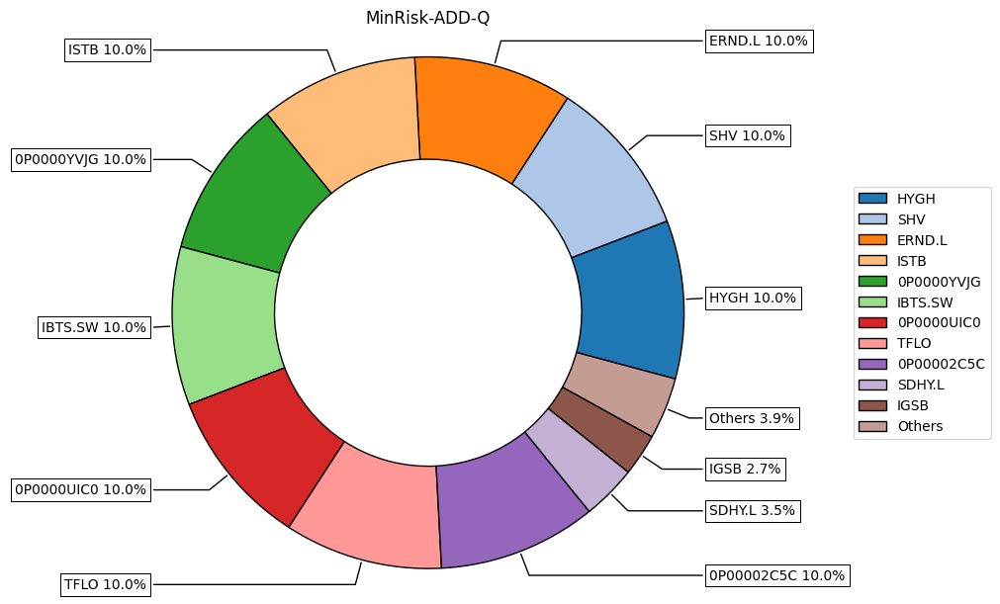

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0266
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1267
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'ADD',
 'Objective': 'MinRisk',
 'R_Interval': 'Q',
 'Max DrawDown': 0.07734470016561415,
 'CAGR': 0.0016168348000968273,
 'Sharpe Ratio': 0.0863018356484441}

batches.length = 1
bt_results.length = 78
('MinRisk', 'Q', 'SLPM')
obj=MinRisk,r=Q,rm=SLPM
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0      0.09
0P0000VP5F    0.0903
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0026
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH           0.016
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV   

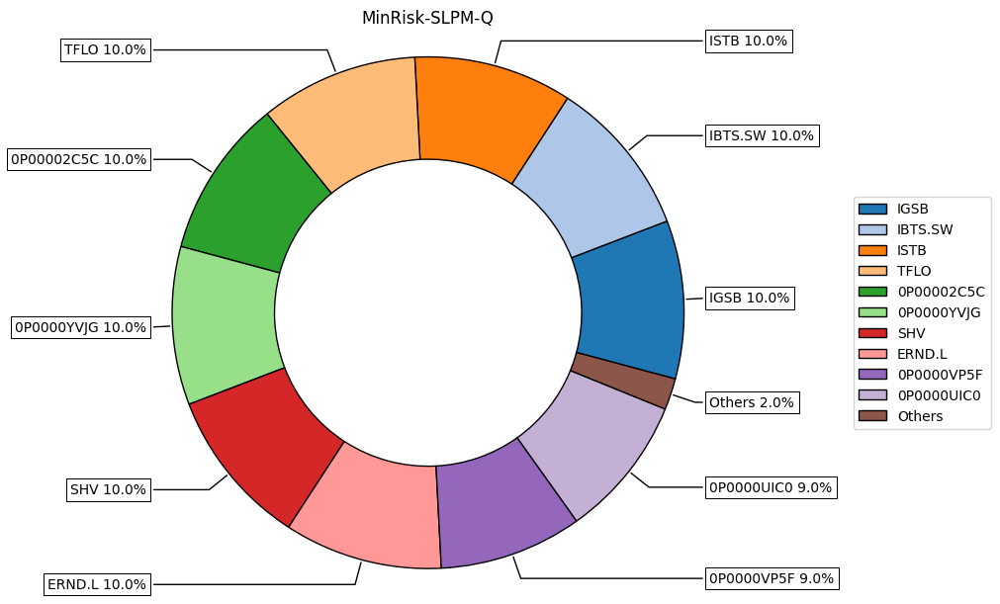

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.09
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0903
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1038
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0903


{'Risk_measure': 'SLPM',
 'Objective': 'MinRisk',
 'R_Interval': 'Q',
 'Max DrawDown': 0.11745447720136068,
 'CAGR': -0.0032076243289499468,
 'Sharpe Ratio': -0.11312266253604694}

batches.length = 1
bt_results.length = 78
('MinRisk', 'Q', 'MV')
obj=MinRisk,r=Q,rm=MV
0341.HK          0.0
0405.HK          0.0
0737.HK       0.0008
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.1
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK       0.0001
1810.HK          0.0
3175.HK       0.0018
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0105
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB           0.086
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV       

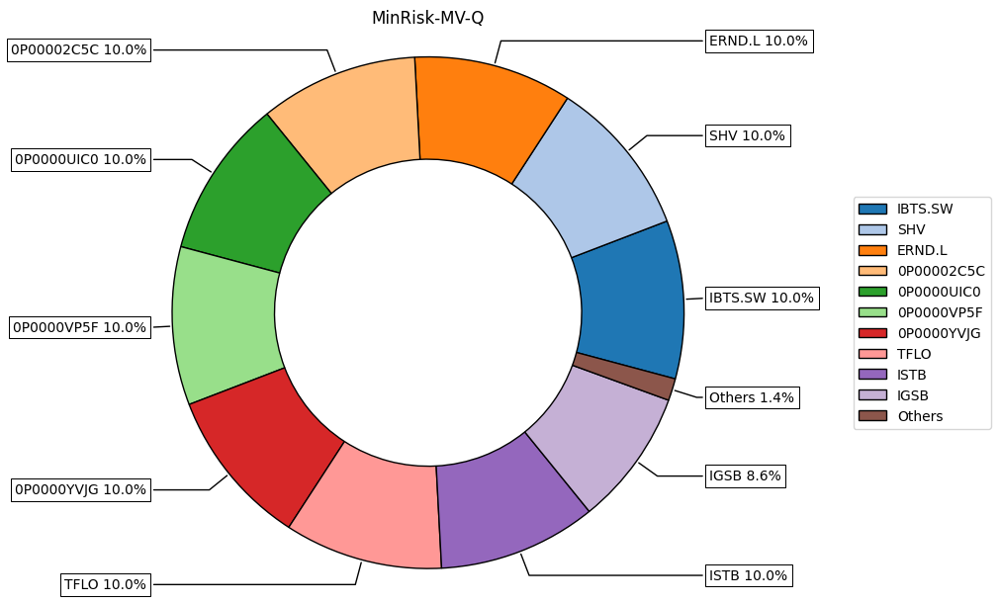

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0008
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.1
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.086
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1025
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'MV',
 'Objective': 'MinRisk',
 'R_Interval': 'Q',
 'Max DrawDown': 0.10970343958940511,
 'CAGR': -0.0024744331271721503,
 'Sharpe Ratio': -0.08954807728696616}

batches.length = 1
bt_results.length = 78
('Sharpe', 'Q', 'WR')
obj=Sharpe,r=Q,rm=WR
0341.HK          0.0
0405.HK          0.0
0737.HK       0.0519
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0469
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.0
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0836
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.0
IVE              0.0
IWRD.L        0.0774
JDN.MX           0.0
LQDE.L           0.0
PAVE          0.0245
SDHY.L           0.0
SHV         

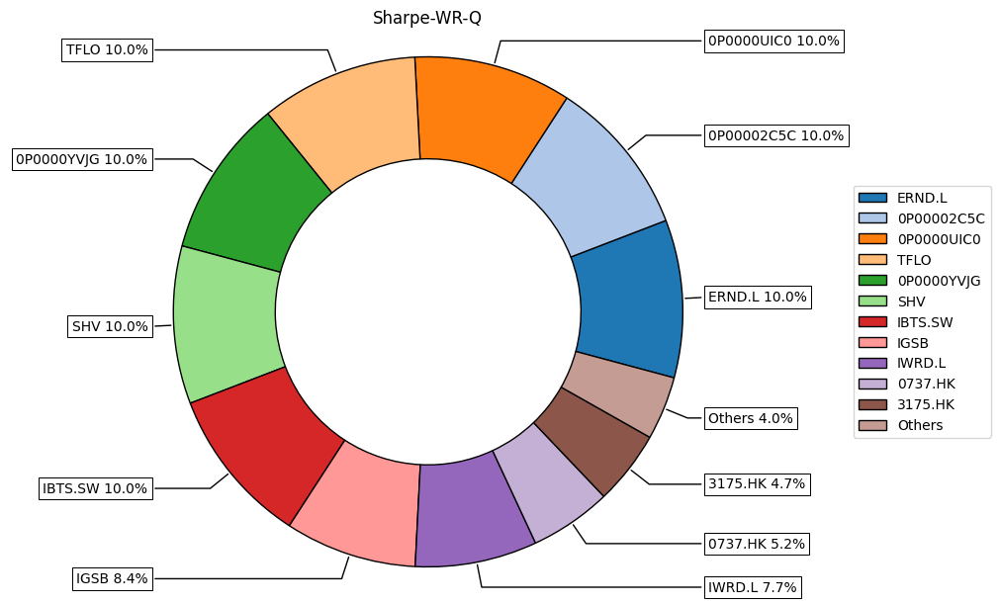

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0519
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0836
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1626
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'WR',
 'Objective': 'Sharpe',
 'R_Interval': 'Q',
 'Max DrawDown': 0.11126828845932261,
 'CAGR': -0.0006447650826294203,
 'Sharpe Ratio': -0.010982461230156395}

batches.length = 1
bt_results.length = 78
('MinRisk', 'S', 'CDaR')
obj=MinRisk,r=S,rm=CDaR
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0107
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.1
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0116
IVE              0.0
IWRD.L        0.0019
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L        0.0521
SHV              0.1
TFLO  

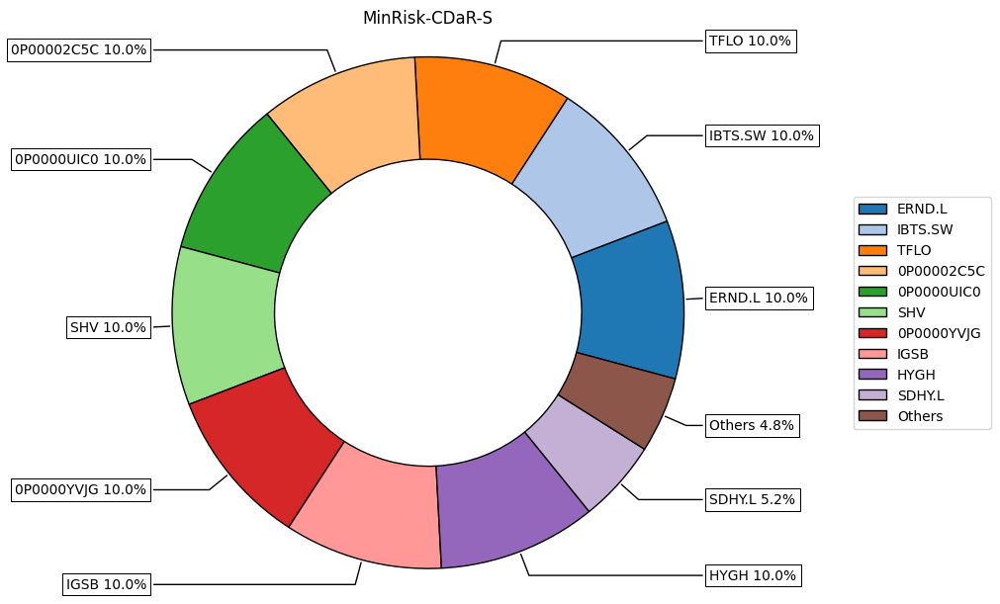

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1344
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'CDaR',
 'Objective': 'MinRisk',
 'R_Interval': 'S',
 'Max DrawDown': 0.1152048330894137,
 'CAGR': -0.0022906003050046507,
 'Sharpe Ratio': -0.08777504831470115}

batches.length = 1
bt_results.length = 78
('Sharpe', 'S', 'ADD')
obj=Sharpe,r=S,rm=ADD
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK       0.0031
1810.HK          0.0
3175.HK       0.0126
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.1
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0827
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.0
IVE              0.0
IWRD.L        0.0173
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L        0.0592
SHV              0.1
TFLO      

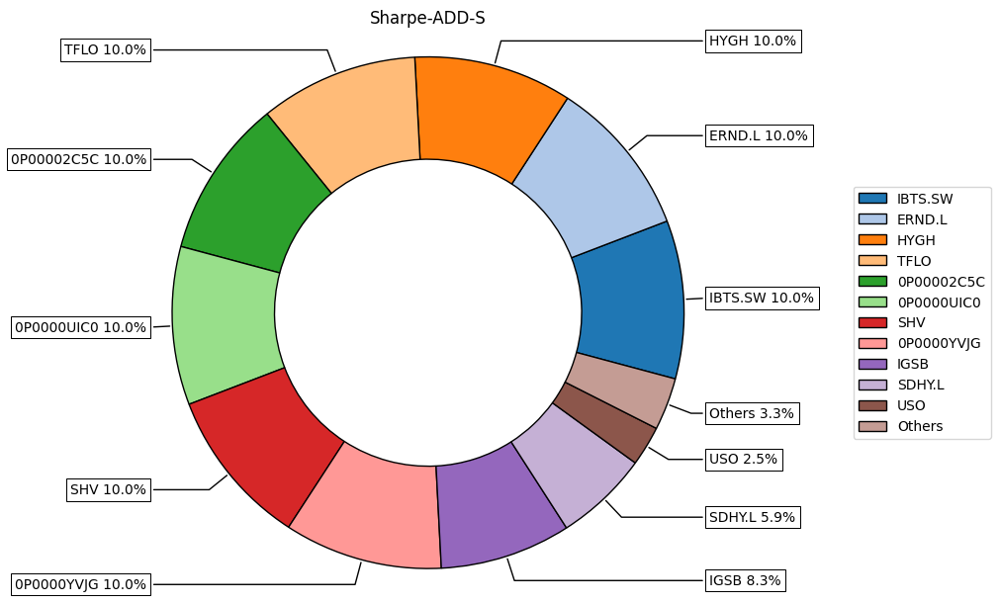

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0827
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1378
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'ADD',
 'Objective': 'Sharpe',
 'R_Interval': 'S',
 'Max DrawDown': 0.0843187717189339,
 'CAGR': 0.006113335387530883,
 'Sharpe Ratio': 0.2506167421896868}

batches.length = 1
bt_results.length = 78
('MinRisk', 'S', 'UCI')
obj=MinRisk,r=S,rm=UCI
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.0
0P0000YVJG    0.0998
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK         0.01
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.1
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0874
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0194
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L        0.0597
SHV              0.1
TFLO    

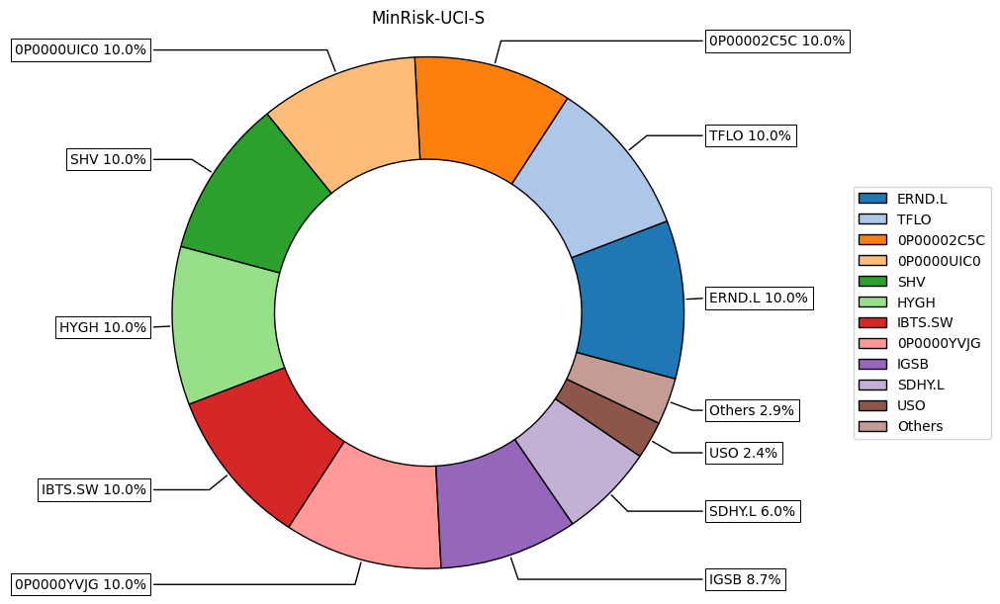

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0998
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0874
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1335
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'UCI',
 'Objective': 'MinRisk',
 'R_Interval': 'S',
 'Max DrawDown': 0.09089508523847899,
 'CAGR': 4.973641317701707e-05,
 'Sharpe Ratio': 0.013633832828738741}

batches.length = 1
bt_results.length = 78
('MinRisk', 'Q', 'MSV')
obj=MinRisk,r=Q,rm=MSV
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0    0.0918
0P0000VP5F    0.0929
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0019
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0129
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV     

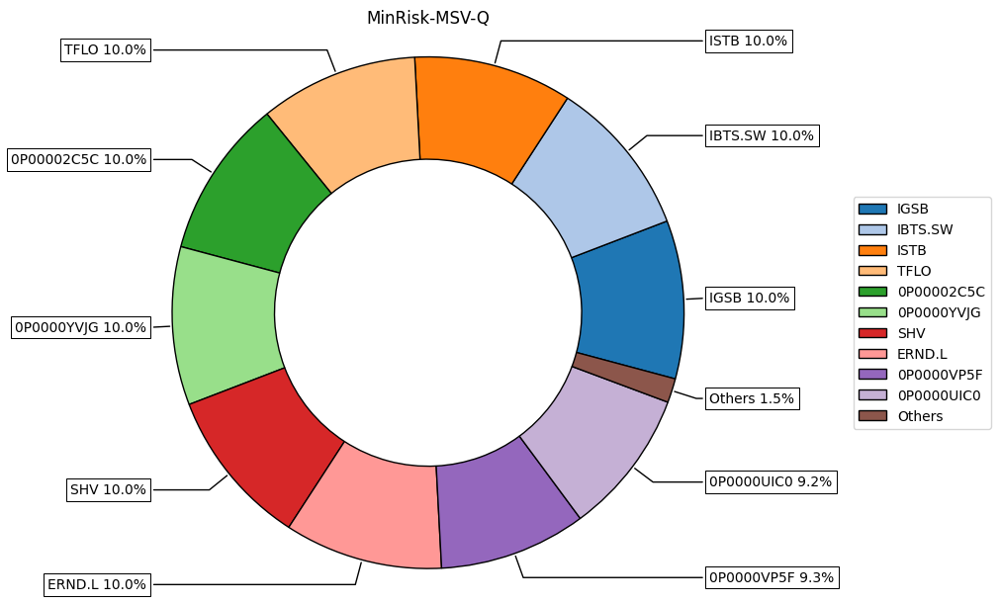

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0918
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0929
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1023
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0929


{'Risk_measure': 'MSV',
 'Objective': 'MinRisk',
 'R_Interval': 'Q',
 'Max DrawDown': 0.11464445242077492,
 'CAGR': -0.00294360897571133,
 'Sharpe Ratio': -0.10341599325011708}

batches.length = 1
bt_results.length = 78
('MaxRet', 'Q', 'EVaR')
obj=MaxRet,r=Q,rm=EVaR
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.0
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
3187.HK       0.0
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.1
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 3029, dtype: object


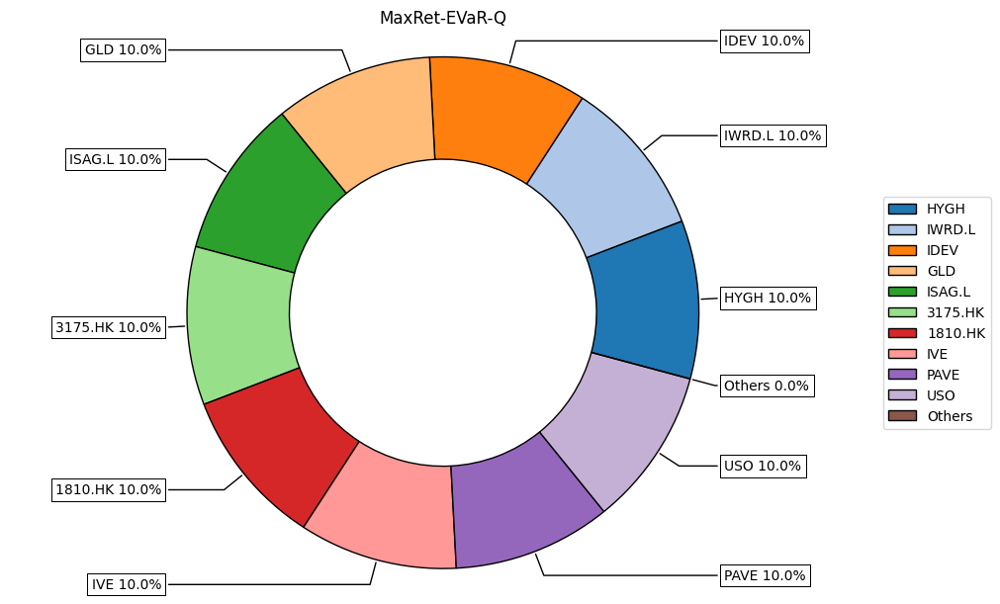

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.1
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.2
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'EVaR',
 'Objective': 'MaxRet',
 'R_Interval': 'Q',
 'Max DrawDown': 0.45501882780938785,
 'CAGR': 0.015063605915950596,
 'Sharpe Ratio': 0.17014133987540994}

batches.length = 1
bt_results.length = 78
('MinRisk', 'S', 'CVaR')
obj=MinRisk,r=S,rm=CVaR
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F    0.0747
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0025
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0228
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV              0.1
TFLO  

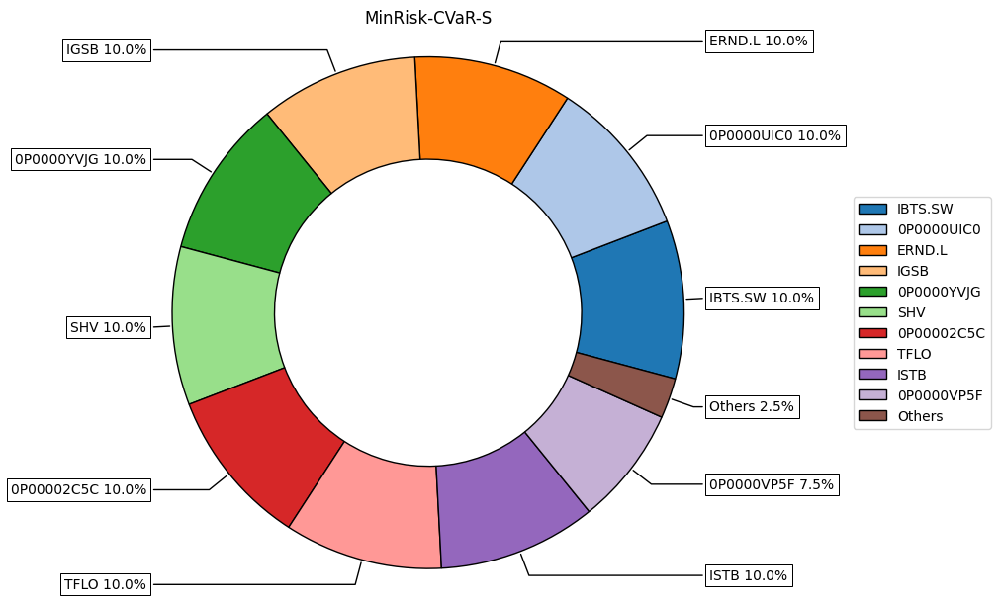

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0747
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1025
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0747


{'Risk_measure': 'CVaR',
 'Objective': 'MinRisk',
 'R_Interval': 'S',
 'Max DrawDown': 0.11179015674277813,
 'CAGR': -0.002845906297232798,
 'Sharpe Ratio': -0.102239250089221}

batches.length = 1
bt_results.length = 78
('Sharpe', 'S', 'MV')
obj=Sharpe,r=S,rm=MV
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F    0.0753
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0117
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0547
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0548
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0873
IVE              0.0
IWRD.L         0.008
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV              0.1
TFLO        

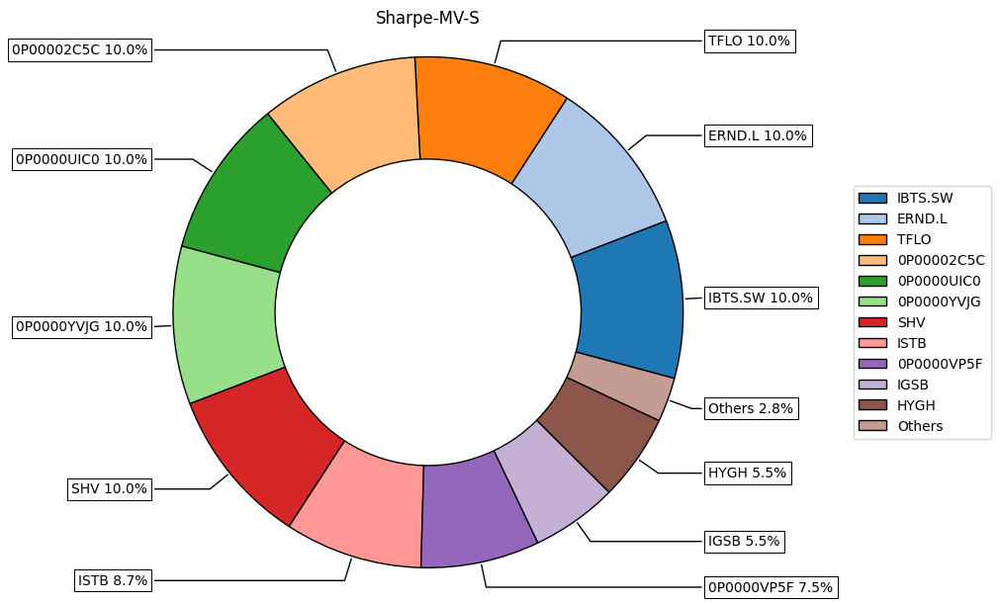

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0753
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0548
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.12
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0753


{'Risk_measure': 'MV',
 'Objective': 'Sharpe',
 'R_Interval': 'S',
 'Max DrawDown': 0.11310382736770067,
 'CAGR': 0.0010308419414059244,
 'Sharpe Ratio': 0.049461335841698095}

batches.length = 1
bt_results.length = 78
('MinRisk', 'Q', 'CDaR')
obj=MinRisk,r=Q,rm=CDaR
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0107
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.1
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0116
IVE              0.0
IWRD.L        0.0019
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L        0.0521
SHV   

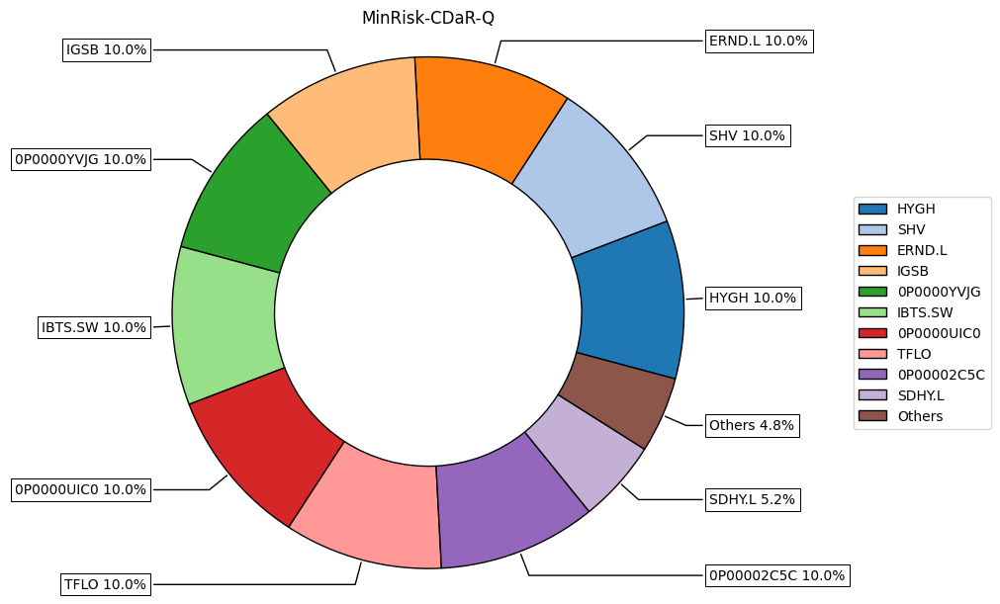

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1344
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'CDaR',
 'Objective': 'MinRisk',
 'R_Interval': 'Q',
 'Max DrawDown': 0.10582685613830177,
 'CAGR': -0.0012528114261233167,
 'Sharpe Ratio': -0.03915969524479883}

batches.length = 1
bt_results.length = 78
('MinRisk', 'Q', 'FLPM')
obj=MinRisk,r=Q,rm=FLPM
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.1
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK       0.0006
1810.HK          0.0
3175.HK       0.0022
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH          0.0247
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0716
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.1
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV   

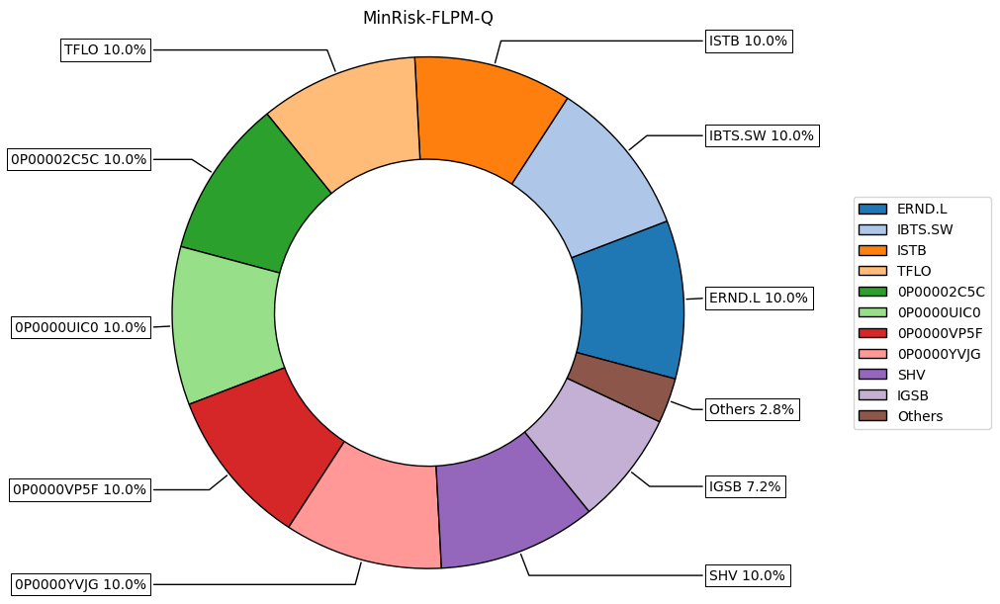

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.1
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0716
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1031
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'FLPM',
 'Objective': 'MinRisk',
 'R_Interval': 'Q',
 'Max DrawDown': 0.10365210971529676,
 'CAGR': -0.0026077141091837477,
 'Sharpe Ratio': -0.10325756213447435}

batches.length = 1
bt_results.length = 78
('MinRisk', 'S', 'EDaR')
obj=MinRisk,r=S,rm=EDaR
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0    0.0991
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0148
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.1
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0218
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0571
IVE              0.0
IWRD.L           0.0
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L        0.0885
SHV              0.1
TFLO  

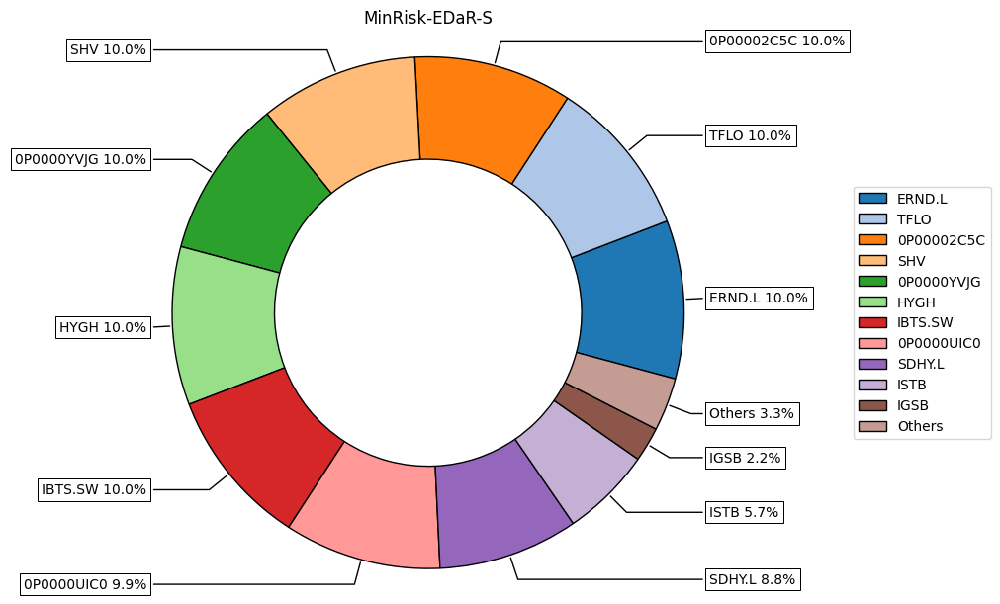

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0991
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0218
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1335
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'EDaR',
 'Objective': 'MinRisk',
 'R_Interval': 'S',
 'Max DrawDown': 0.11519650194110519,
 'CAGR': -0.0037383759518407676,
 'Sharpe Ratio': -0.12618571434243153}

batches.length = 1
bt_results.length = 78
('Sharpe', 'Q', 'MDD')
obj=Sharpe,r=Q,rm=MDD
0341.HK         0.0
0405.HK         0.0
0737.HK         0.0
0P00001DU6      0.0
0P00002C5C      0.1
0P0000UIC0    0.034
0P0000VP5F      0.0
0P0000YVJG      0.1
0P0001DHN3      0.0
1186.HK         0.0
1810.HK         0.0
3175.HK       0.066
3187.HK         0.0
9988.HK         0.0
ADDYY           0.0
AGGU.L          0.0
ARKG            0.0
ARKK            0.0
BABA            0.0
CSBGU7.SW       0.0
ERND.L          0.1
GLD             0.0
GOVT            0.0
HYGH            0.1
HYLD.L          0.0
HYMB            0.0
IAGG            0.0
IBTS.SW         0.1
IDEV            0.0
IDTL.L          0.0
IDTM.L          0.0
IEMB.L          0.0
IGIL.L          0.0
IGSB            0.0
IHYU.L          0.0
ISAG.L          0.0
ISTB            0.0
IVE             0.0
IWRD.L          0.1
JDN.MX          0.0
LQDE.L          0.0
PAVE            0.0
SDHY.L          0.1
SHV             0.1
TFLO            0.1
USO          

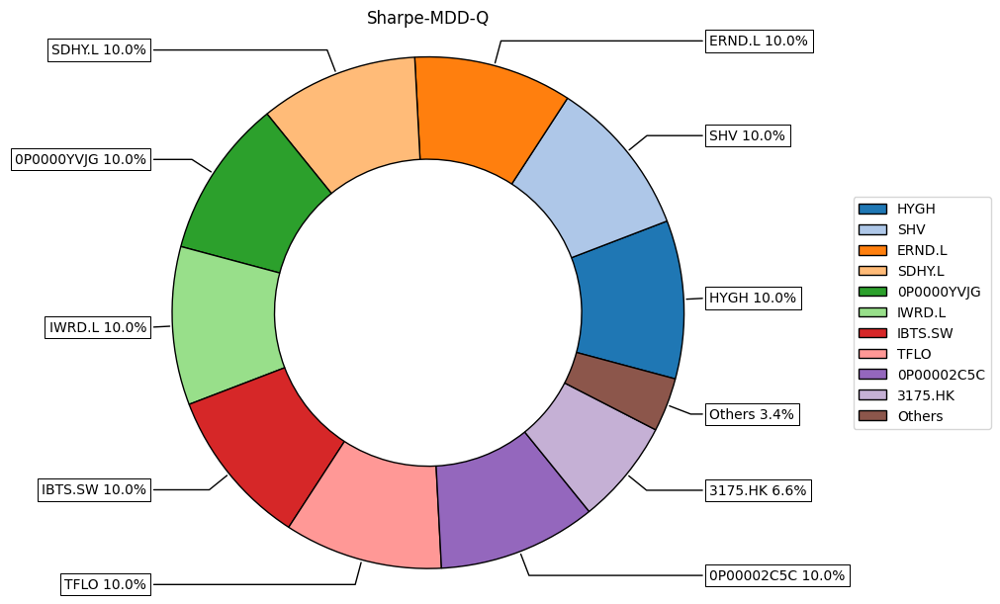

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.034
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.166
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'MDD',
 'Objective': 'Sharpe',
 'R_Interval': 'Q',
 'Max DrawDown': 0.1811567431415535,
 'CAGR': -0.009302549483701733,
 'Sharpe Ratio': -0.24081029588138333}

batches.length = 1
bt_results.length = 78
('MaxRet', 'Q', 'CDaR')
obj=MaxRet,r=Q,rm=CDaR
0341.HK       0.0
0405.HK       0.0
0737.HK       0.0
0P00001DU6    0.0
0P00002C5C    0.0
0P0000UIC0    0.0
0P0000VP5F    0.0
0P0000YVJG    0.0
0P0001DHN3    0.0
1186.HK       0.0
1810.HK       0.1
3175.HK       0.1
3187.HK       0.0
9988.HK       0.0
ADDYY         0.0
AGGU.L        0.0
ARKG          0.0
ARKK          0.0
BABA          0.0
CSBGU7.SW     0.0
ERND.L        0.0
GLD           0.1
GOVT          0.0
HYGH          0.1
HYLD.L        0.0
HYMB          0.0
IAGG          0.0
IBTS.SW       0.0
IDEV          0.1
IDTL.L        0.0
IDTM.L        0.0
IEMB.L        0.0
IGIL.L        0.0
IGSB          0.0
IHYU.L        0.0
ISAG.L        0.1
ISTB          0.0
IVE           0.1
IWRD.L        0.1
JDN.MX        0.0
LQDE.L        0.0
PAVE          0.1
SDHY.L        0.0
SHV           0.0
TFLO          0.0
USO           0.1
ZM            0.0
Name: 3029, dtype: object


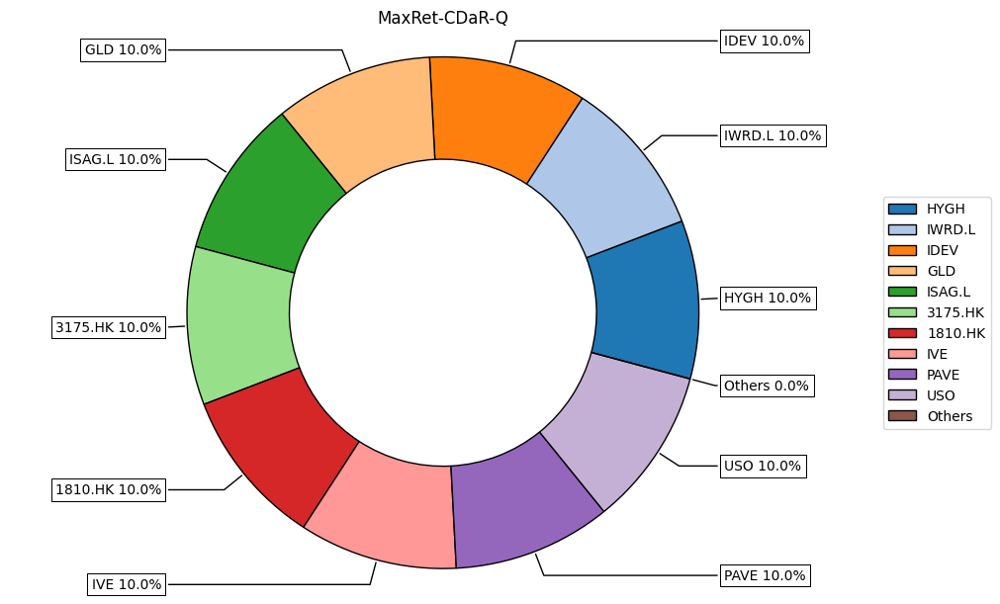

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.0
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.0
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.1
Cash,Cash,Fund,USD,1.000000,0.0
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.1
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.2
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.1


{'Risk_measure': 'CDaR',
 'Objective': 'MaxRet',
 'R_Interval': 'Q',
 'Max DrawDown': 0.45501882780938785,
 'CAGR': 0.015063605915950596,
 'Sharpe Ratio': 0.17014133987540994}

batches.length = 1
bt_results.length = 78
('Sharpe', 'S', 'UCI')
obj=Sharpe,r=S,rm=UCI
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0181
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.1
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB          0.0286
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.0
IVE              0.0
IWRD.L        0.0274
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.1
SHV              0.1
TFLO      

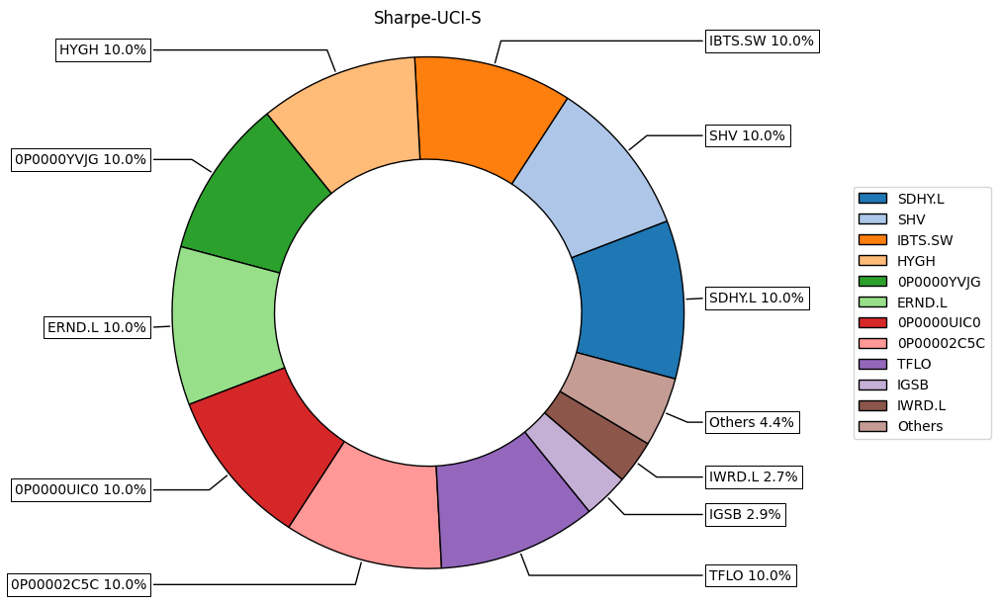

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0286
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1439
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'UCI',
 'Objective': 'Sharpe',
 'R_Interval': 'S',
 'Max DrawDown': 0.09410055584537465,
 'CAGR': 0.005533951469166745,
 'Sharpe Ratio': 0.19468054907689947}

batches.length = 1
bt_results.length = 78
('Sharpe', 'Q', 'CVaR')
obj=Sharpe,r=Q,rm=CVaR
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F    0.0582
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0073
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD           0.0019
GOVT             0.0
HYGH          0.0408
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0794
IVE              0.0
IWRD.L        0.0066
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.0
SHV     

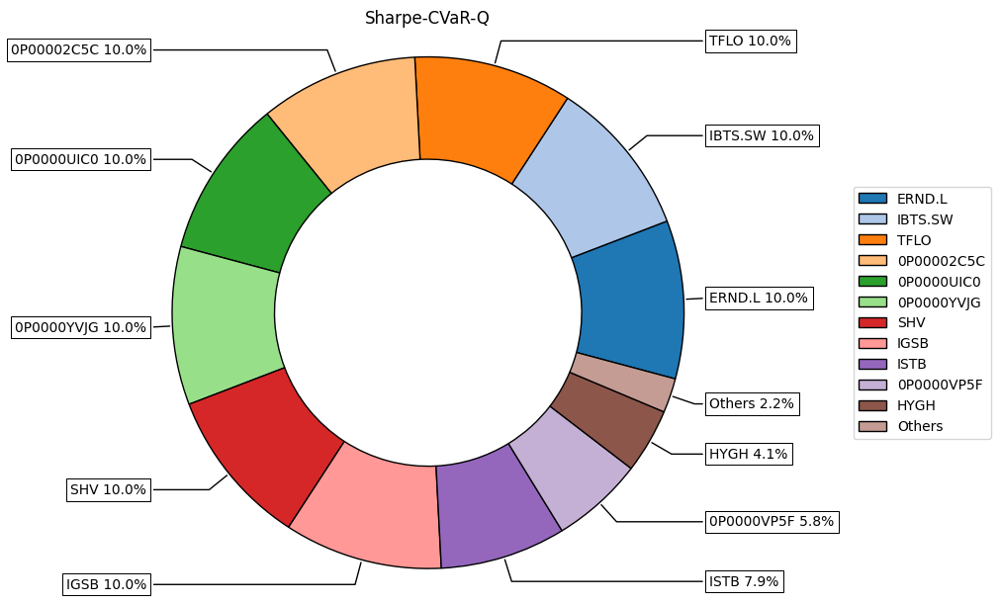

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0582
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0019
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1132
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0582


{'Risk_measure': 'CVaR',
 'Objective': 'Sharpe',
 'R_Interval': 'Q',
 'Max DrawDown': 0.11451510691380204,
 'CAGR': 0.0028270467392282465,
 'Sharpe Ratio': 0.11102952243822904}

batches.length = 1
bt_results.length = 78
('Sharpe', 'S', 'EDaR')
obj=Sharpe,r=S,rm=EDaR
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0388
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.1
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.0
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.0
IVE              0.0
IWRD.L           0.1
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L        0.0406
SHV              0.1
TFLO    

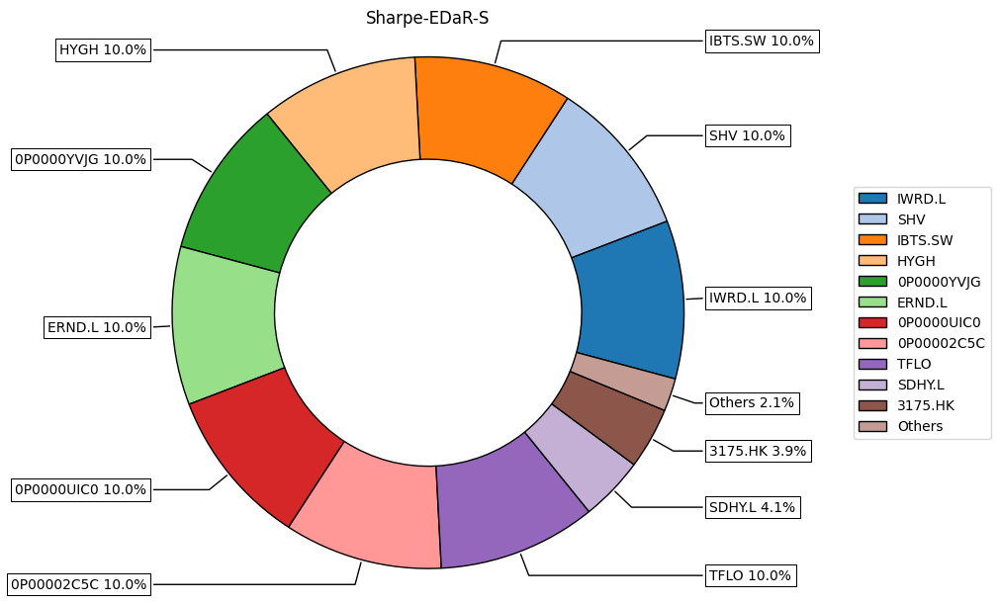

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1595
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'EDaR',
 'Objective': 'Sharpe',
 'R_Interval': 'S',
 'Max DrawDown': 0.20560460387664176,
 'CAGR': -0.0011300999032529736,
 'Sharpe Ratio': -0.0017159250297598847}

batches.length = 1
bt_results.length = 78
('Sharpe', 'S', 'EVaR')
obj=Sharpe,r=S,rm=EVaR
0341.HK          0.0
0405.HK          0.0
0737.HK       0.0178
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0    0.0851
0P0000VP5F    0.0292
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0392
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.0
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0218
IVE              0.0
IWRD.L        0.0368
JDN.MX           0.0
LQDE.L           0.0
PAVE          0.0477
SDHY.L           0.0
SHV              0.1
TFLO    

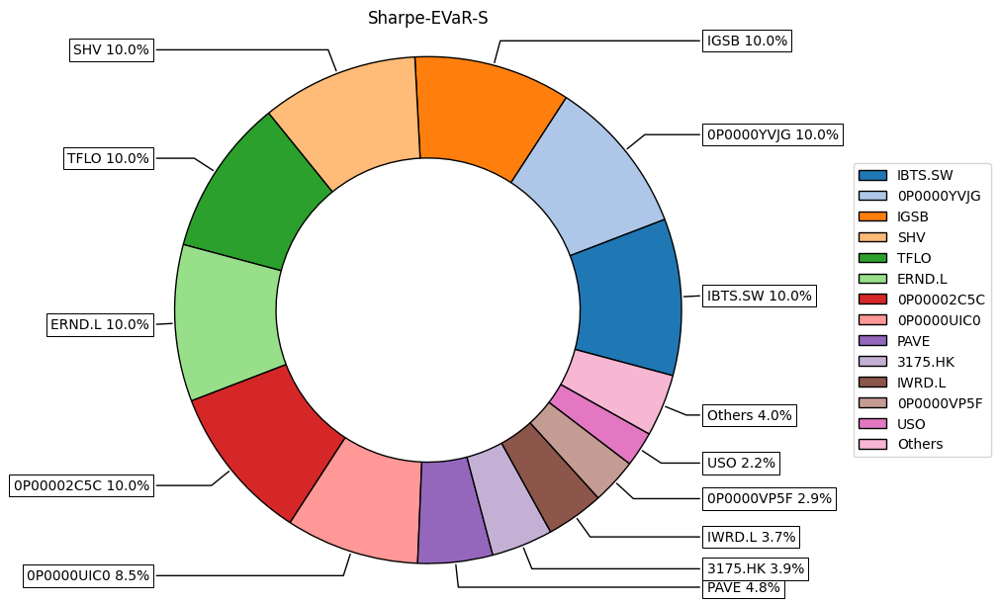

,Class,Sector,Type,Currency,Rate,2964
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0178
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.0851
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0292
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,2964
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1616
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0292


{'Risk_measure': 'EVaR',
 'Objective': 'Sharpe',
 'R_Interval': 'S',
 'Max DrawDown': 0.13806611926626852,
 'CAGR': -0.001133450429317772,
 'Sharpe Ratio': -0.019680083203293123}

batches.length = 1
bt_results.length = 78
('Sharpe', 'Q', 'EDaR')
obj=Sharpe,r=Q,rm=EDaR
0341.HK          0.0
0405.HK          0.0
0737.HK          0.0
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0       0.1
0P0000VP5F       0.0
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0327
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD              0.0
GOVT             0.0
HYGH             0.1
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.0
IHYU.L           0.0
ISAG.L           0.0
ISTB             0.0
IVE              0.0
IWRD.L        0.0494
JDN.MX           0.0
LQDE.L           0.0
PAVE             0.0
SDHY.L           0.1
SHV     

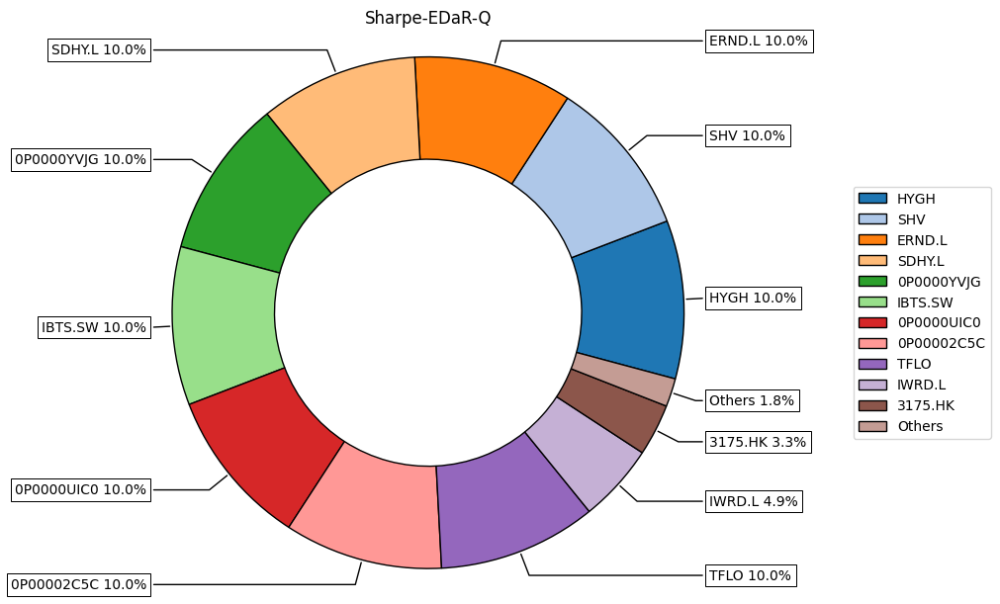

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.1
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.0
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.0
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1505
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0


{'Risk_measure': 'EDaR',
 'Objective': 'Sharpe',
 'R_Interval': 'Q',
 'Max DrawDown': 0.18067790149283203,
 'CAGR': -0.0045909954342092715,
 'Sharpe Ratio': -0.11058409365952972}

batches.length = 1
bt_results.length = 78
('Sharpe', 'Q', 'EVaR')
obj=Sharpe,r=Q,rm=EVaR
0341.HK          0.0
0405.HK          0.0
0737.HK       0.0243
0P00001DU6       0.0
0P00002C5C       0.1
0P0000UIC0     0.081
0P0000VP5F    0.0203
0P0000YVJG       0.1
0P0001DHN3       0.0
1186.HK          0.0
1810.HK          0.0
3175.HK       0.0315
3187.HK          0.0
9988.HK          0.0
ADDYY            0.0
AGGU.L           0.0
ARKG             0.0
ARKK             0.0
BABA             0.0
CSBGU7.SW        0.0
ERND.L           0.1
GLD            0.011
GOVT             0.0
HYGH             0.0
HYLD.L           0.0
HYMB             0.0
IAGG             0.0
IBTS.SW          0.1
IDEV             0.0
IDTL.L           0.0
IDTM.L           0.0
IEMB.L           0.0
IGIL.L           0.0
IGSB             0.1
IHYU.L           0.0
ISAG.L           0.0
ISTB          0.0341
IVE              0.0
IWRD.L        0.0388
JDN.MX           0.0
LQDE.L           0.0
PAVE          0.0363
SDHY.L           0.0
SHV     

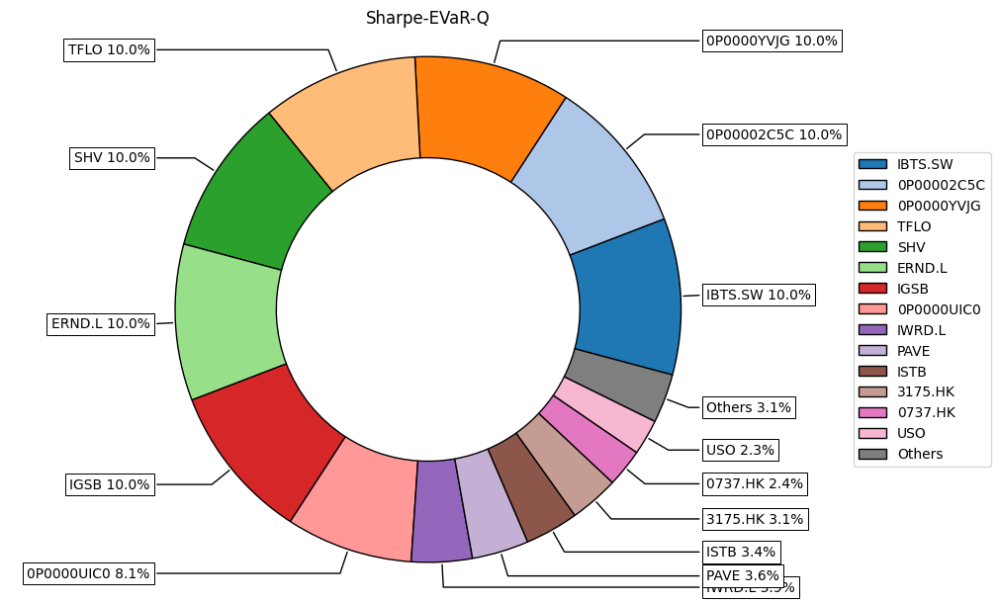

,Class,Sector,Type,Currency,Rate,3029
0341.HK,Equity,Consumer Defensive,Stock,HKD,0.128205,0.0
0405.HK,Equity,Real Estate,RIT,HKD,0.128205,0.0
0737.HK,Equity,Industrials,Stock,HKD,0.128205,0.0243
0P00001DU6,Equity,Technology,Fund,USD,1.000000,0.0
0P00002C5C,Cash,Cash,Fund,USD,1.000000,0.1
0P00006OXK.T,Equity,Industrials,Fund,JPY,0.006600,NaN
0P0000UIC0,Fixed Income,Municipal,Fund,USD,1.000000,0.081
0P0000VP5F,Fixed Income,Financial Services,Fund,USD,1.000000,0.0203
0P0000YVJG,Fixed Income,Energy,Fund,USD,1.000000,0.1
0P0000Z5AZ,Equity,Index,Fund,USD,1.000000,NaN


,Class,Type,Currency,Rate,3029
Sector,,,,,
Agency,Fixed Income,ETF,USD,1.000000,0.0
Basic Materials,Commodity,ETF,USD,1.000000,0.011
Cash,Cash,Fund,USD,1.000000,0.1
Consumer Cyclical,EquityEquityEquity,StockStockStock,HKDUSDUSD,2.128205,0.0
Consumer Defensive,EquityEquityEquity,StockETFStock,HKDUSDMXN,1.178205,0.0
Corporate,Fixed IncomeFixed IncomeFixed IncomeFixed Inco...,Fund Fund ETFETFETFETF,USDUSDUSDUSDUSDUSD,6.000000,0.1
ETF,Crypto,ETF,USD,1.000000,0
Energy,Fixed IncomeCommodity Commodity,Fund ETFETF,USDHKDUSD,2.128205,0.1542
Financial Services,Fixed IncomeEquityEquity,Fund Fund ETF,USDUSDUSD,3.000000,0.0203


{'Risk_measure': 'EVaR',
 'Objective': 'Sharpe',
 'R_Interval': 'Q',
 'Max DrawDown': 0.1442434572427367,
 'CAGR': -0.003974452745492989,
 'Sharpe Ratio': -0.12831086651368426}

In [54]:
check_flag=True

print(f'bt_results.length = {len(bt_results)}')
metric_list=[]
for batches in bt_results:
    print(f'batches.length = {len(batches)}')
    for result in batches:
        print(f'bt_results.length = {len(bt_results)}')
        aKey = result['keys']
        print(aKey)
        obj, r, rm = aKey
        print(f'obj={obj},r={r},rm={rm}')
        if len(result['Dret']):
            # print(result['Dret'])
            result['Dret'].round(4).to_csv(f"DailyRet_{obj}_{r}_{rm}.csv", index=False)
        if len(result['w']) > 0:
            w=result['w'].iloc[-1,:].dropna()
            print(w)
            if check_flag:
                # We need matplotlib >= 3.3.0 to use this function
                ax = rp.plot_pie(w=w, title=f'{obj}-{rm}-{r}', others=0.05, nrow=25, cmap = "tab20",
                                height=6, width=10, ax=None)
                # w.plot.pie(subplots=True, figsize=(8, 8))
                plt.show()
            ############################################################
            # Composition per Industry
            ############################################################
            w_classes = pd.concat([asset_classes.set_index('Assets'), w], axis=1)
            display(w_classes)
            w_classes = w_classes.groupby(['Sector']).sum()
            # w_classes.columns = ['weights']  
            display(w_classes)
        if result['metric'] is not None:
            display(result['metric'])
            metric_list.append(result['metric'])


In [55]:
BM_metric_list_df = pd.DataFrame(BM_metric_list)
metric_df = pd.DataFrame(metric_list)
metric_df = metric_df.sort_values(by=['CAGR','Sharpe Ratio'], ascending=False)
full_metric = pd.concat([BM_metric_list_df, metric_df])
display(full_metric.head(15))

,Risk_measure,Objective,R_Interval,Max DrawDown,CAGR,Sharpe Ratio
0,SPY,N/A,N/A,0.322874,0.081963,0.605347
1,^HSI,N/A,N/A,0.549429,-0.011758,-0.024920
2,QQQ,N/A,N/A,0.370311,0.126351,0.615728
1,CVaR,MaxRet,S,0.454291,0.017975,0.193202
4,CDaR,MaxRet,S,0.454291,0.017975,0.193202
7,MSV,MaxRet,S,0.454291,0.017975,0.193202
19,EVaR,MaxRet,S,0.454291,0.017975,0.193202
20,MDD,MaxRet,S,0.454291,0.017975,0.193202
25,MV,MaxRet,S,0.454291,0.017975,0.193202
33,WR,MaxRet,S,0.454291,0.017975,0.193202


In [56]:
full_metric.to_csv("Port_Metric.csv", index=False)
constraints.to_csv("Constraints.csv", index=False)

In [57]:
display(metric_df[metric_df['R_Interval']=='Q'].sort_values(by=['Sharpe Ratio','CAGR'], ascending=False))

,Risk_measure,Objective,R_Interval,Max DrawDown,CAGR,Sharpe Ratio
8,MDD,MaxRet,Q,0.455019,0.015064,0.170141
9,SLPM,MaxRet,Q,0.455019,0.015064,0.170141
11,ADD,MaxRet,Q,0.455019,0.015064,0.170141
14,FLPM,MaxRet,Q,0.455019,0.015064,0.170141
26,WR,MaxRet,Q,0.455019,0.015064,0.170141
36,MV,MaxRet,Q,0.455019,0.015064,0.170141
40,UCI,MaxRet,Q,0.455019,0.015064,0.170141
49,MAD,MaxRet,Q,0.455019,0.015064,0.170141
50,EDaR,MaxRet,Q,0.455019,0.015064,0.170141
53,MSV,MaxRet,Q,0.455019,0.015064,0.170141


In [58]:
display(metric_df[metric_df['R_Interval']=='S'].sort_values(by=['Sharpe Ratio','CAGR'], ascending=False))

,Risk_measure,Objective,R_Interval,Max DrawDown,CAGR,Sharpe Ratio
61,ADD,Sharpe,S,0.084319,0.006113,0.250617
72,UCI,Sharpe,S,0.094101,0.005534,0.194681
1,CVaR,MaxRet,S,0.454291,0.017975,0.193202
4,CDaR,MaxRet,S,0.454291,0.017975,0.193202
7,MSV,MaxRet,S,0.454291,0.017975,0.193202
19,EVaR,MaxRet,S,0.454291,0.017975,0.193202
20,MDD,MaxRet,S,0.454291,0.017975,0.193202
25,MV,MaxRet,S,0.454291,0.017975,0.193202
33,WR,MaxRet,S,0.454291,0.017975,0.193202
34,FLPM,MaxRet,S,0.454291,0.017975,0.193202
